In [2]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import normalize
import matplotlib.pyplot as plt
import sklearn
from xgboost import XGBRegressor
from numpy import int64
import pickle
from sklearn.svm import SVC
import seaborn as sn

np.random.seed(0)

# Elastic Net

In [81]:
import matplotlib.pyplot as plt

def applyLimitOnRemainedFeatures(totalDf, cutoff=0):
    
    tgt = totalDf.pop('VFD')
    fDf = totalDf
    
    # Create correlation matrix
    corr_matrix = fDf.corr().abs()

    # Select upper triangle of correlation matrix
    upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(np.bool))

    # print(upper)

    # Find index of feature columns with correlation greater than 0.95
    to_drop = [column for column in upper.columns if any(upper[column] > 0.8)]

#     print(to_drop)
    # print(len(to_drop))

    # Drop correlated features 
    featuresDf_nonCorr = fDf.drop(to_drop, axis=1)
#     featuresDf_nonCorr = fDf

#     print(featuresDf_nonCorr)
    print(featuresDf_nonCorr.shape)
#     print(featuresDf_nonCorr.columns)

    from sklearn.linear_model import ElasticNetCV

#     ElasticNetModel = ElasticNetCV(cv=10, random_state=42)
    ElasticNetModel = ElasticNetCV(random_state=42)
    ElasticNetModel.fit(featuresDf_nonCorr, tgt)

    # Assigns weight to each feature
    coefs = ElasticNetModel.coef_
#     print(coefs)
    # print(len(coefs))
#     print(fsDf.shape)

    # Make a dictionary of the metabolites and their weights
    remainedCols = {featuresDf_nonCorr.columns[i]:coefs[i] for i in range(featuresDf_nonCorr.shape[1]) if abs(coefs[i]) > cutoff}

    # Sort the dictionary of non zero values
    remainedColsSorted = sorted({x:y for x,y in remainedCols.items() if y!=0}.items(), key=lambda x: x[1])

#     print(remainedCols)
#     print(remainedColsSorted)


    # extrac    # extract keys and vals to plot in a bar chart
    # keys and vals to plot in a bar chart
    keys = []
    vals = []
    geneKeys = []
    geneVals = []
    for i in range(1,len(remainedCols)+1):
        keys.append(str(remainedColsSorted[-i][0]))
        vals.append(remainedColsSorted[-i][1])

#     print(len(keys))
    print(keys)
    print(vals)
    
    # Drop the low score columns
    featuresDfReduced = fDf[keys]
    print(featuresDfReduced.shape)
    
    plt.figure(figsize=(10,6))
    plt.xticks(rotation=90)
    plt.bar(keys, vals)
    plt.ylabel('Normalized ElasticNet Importance Coefs')

    plt.savefig('figs/topFeatures_' + str(cutoff) + '.pdf')
    
    featuresDfReducedSmoteTotal = featuresDfReduced
    featuresDfReducedSmoteTotal['VFD'] = tgt
    
    return keys, featuresDfReducedSmoteTotal

# Demographic Data

In [82]:
# read target and new features from the new demographic data
demographicDfMetabolites = pd.read_csv('data/raw/DemographicDataTAAminoAcids_Modified.csv').set_index('Study ID')

len(demographicDfMetabolites.index)

74

In [83]:
# read target and new features from the new demographic data
demographicDfNanostring = pd.read_csv('data/raw/Nanostring_AIR_PICU_ClinicalData.csv').set_index('Study ID')

len(demographicDfNanostring.index)

52

In [84]:
## Find the indices common in both demographic datasets
commonDemographicIndex = set(demographicDfNanostring.index) & set(demographicDfMetabolites.index)

In [85]:
commonDemographicIndex

# Because demographicDfNanostring has more completecolumns, for now we move on with it
demographicDf = demographicDfNanostring.loc[demographicDfNanostring.index.isin(commonDemographicIndex)]

In [86]:
demographicDf.head(52)

,IDKEY,StudyName,Age_months,Age_years,Sex,Race,Ethnicity,PRISM,PELOD,PARDS,...,VFD,Vent_Days,Vent_>7d,VRP_V1,VRP_V2,Resp Bacteria Species_1,Resp Bacteria Species_2,OtherRespSpecies,PICU_LOS,Hosp_LOS
Study ID,,,,,,,,,,,,,,,,,,,,,
21,19,PNA,0.23,0.02,Male,White,Non-Hispanic,9,7,No,...,26,2,No,NaN,NaN,Not Assessed,NaN,NaN,6,8
22,20,PNA,6.40,0.53,Female,Unknown,Hispanic,12,2,No,...,25,3,No,NaN,NaN,Not Assessed,NaN,NaN,6,9
23,21,PNA,5.07,0.42,Female,Black,Non-Hispanic,6,3,No,...,27,1,No,NaN,NaN,Not Assessed,NaN,NaN,2,10
25,22,PNA,10.27,0.84,Male,Declined,Non-Hispanic,14,7,Yes,...,27,1,No,Rhinovirus,NaN,Not Assessed,NaN,NaN,3,4
27,23,PNA,63.80,5.24,Male,Black,Non-Hispanic,16,13,No,...,27,1,No,NaN,NaN,Not Assessed,NaN,NaN,3,4
29,25,PNA,1.03,0.08,Male,Black,Non-Hispanic,7,6,Yes,...,17,11,Yes,RSV,NaN,Moraxella catarrhalis,NaN,NaN,14,17
32,28,PNA,7.67,0.63,Female,White,Non-Hispanic,12,10,Yes,...,22,6,No,Rhinovirus,NaN,Gram neg rods,NaN,NaN,9,13
33,29,PNA,1.33,0.11,Female,White,Non-Hispanic,8,7,No,...,21,7,Yes,RSV,Rhinovirus,MSSA,Moraxella catarrhalis,NaN,8,13
34,30,PNA,19.60,1.61,Female,White,Non-Hispanic,6,8,No,...,25,3,No,NaN,NaN,Not Assessed,NaN,NaN,7,12


In [87]:
demographicDf.shape

(52, 30)

## Choose the Columns that Make Sense

In [88]:
# Separate Cat Columns and Num Columns
# catColumns = ['Sex', 'Race', 'ECMO', 'Infection Status']
catColumns = ['Sex', 'Race', 'ECMO', 'Infection Status']
numColumns = ['Age_years', 'PRISM', 'PELOD']

# Use the column names to make new df
catDf = demographicDf[catColumns]
numDf = demographicDf[numColumns]

# Normalize the values
from sklearn.preprocessing import normalize
numDfNormal = normalize(numDf.values, axis=0, norm='l1')

numDf = pd.DataFrame(data=numDfNormal, columns=numColumns)


# Replace the Num Columns in the DF
demographicDfModified = demographicDf
demographicDfModified[numColumns] = numDf

In [89]:
numDf.columns

Index(['Age_years', 'PRISM', 'PELOD'], dtype='object')

In [90]:
demographicDfModified

,IDKEY,StudyName,Age_months,Age_years,Sex,Race,Ethnicity,PRISM,PELOD,PARDS,...,VFD,Vent_Days,Vent_>7d,VRP_V1,VRP_V2,Resp Bacteria Species_1,Resp Bacteria Species_2,OtherRespSpecies,PICU_LOS,Hosp_LOS
Study ID,,,,,,,,,,,,,,,,,,,,,
21,19,PNA,0.23,0.107366,Male,White,Non-Hispanic,0.045455,0.046243,No,...,26,2,No,NaN,NaN,Not Assessed,NaN,NaN,6,8
22,20,PNA,6.40,0.029320,Female,Unknown,Hispanic,0.033724,0.034682,No,...,25,3,No,NaN,NaN,Not Assessed,NaN,NaN,6,9
23,21,PNA,5.07,0.007304,Female,Black,Non-Hispanic,0.010264,0.023121,No,...,27,1,No,NaN,NaN,Not Assessed,NaN,NaN,2,10
25,22,PNA,10.27,0.001148,Male,Declined,Non-Hispanic,0.027859,0.026012,Yes,...,27,1,No,Rhinovirus,NaN,Not Assessed,NaN,NaN,3,4
27,23,PNA,63.80,0.026503,Male,Black,Non-Hispanic,0.017595,0.020231,No,...,27,1,No,NaN,NaN,Not Assessed,NaN,NaN,3,4
29,25,PNA,1.03,0.018155,Male,Black,Non-Hispanic,0.023460,0.014451,Yes,...,17,11,Yes,RSV,NaN,Moraxella catarrhalis,NaN,NaN,14,17
32,28,PNA,7.67,0.011373,Female,White,Non-Hispanic,0.023460,0.014451,Yes,...,22,6,No,Rhinovirus,NaN,Gram neg rods,NaN,NaN,9,13
33,29,PNA,1.33,0.002504,Female,White,Non-Hispanic,0.013196,0.017341,No,...,21,7,Yes,RSV,Rhinovirus,MSSA,Moraxella catarrhalis,NaN,8,13
34,30,PNA,19.60,0.020764,Female,White,Non-Hispanic,0.002933,0.008671,No,...,25,3,No,NaN,NaN,Not Assessed,NaN,NaN,7,12


## OneHardEncoder

In [91]:
from sklearn.preprocessing import OneHotEncoder
catDfEncoded = pd.get_dummies(catDf)

catDfEncoded['Race_BlackMixed'] = catDfEncoded['Race_Black'] + catDfEncoded['Race_Mixed']
catDfEncoded['Race_UnknownDeclined'] = catDfEncoded['Race_Unknown'] + catDfEncoded['Race_Declined']

catDfEncoded = catDfEncoded.drop(['Sex_Male', 'Race_Black', 'Race_Mixed', 'Race_Unknown', 'Race_Declined', 'ECMO_No'], axis = 1).astype('double')

In [92]:
catDfEncoded

,Sex_Female,Race_White,ECMO_Yes,Infection Status_Bacterial,Infection Status_Co,Infection Status_None,Infection Status_Viral,Race_BlackMixed,Race_UnknownDeclined
Study ID,,,,,,,,,
21,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
22,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0
23,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0
25,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0
27,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0
29,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0
32,1.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
33,1.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
34,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0


In [93]:
demographicDfModified.columns

# # Drop Unnecessary Columns
# demographicDfModified = demographicDfModified.drop(catColumns, axis = 1)

# Bring Encoded DF into demographicDfModified
demographicDfModified[catDfEncoded.columns] = catDfEncoded

In [94]:
usefulDemographicCols = list(numDf.columns)

usefulDemographicCols.extend(list(catDfEncoded.columns))

print(usefulDemographicCols)

['Age_years', 'PRISM', 'PELOD', 'Sex_Female', 'Race_White', 'ECMO_Yes', 'Infection Status_Bacterial', 'Infection Status_Co', 'Infection Status_None', 'Infection Status_Viral', 'Race_BlackMixed', 'Race_UnknownDeclined']


In [95]:
demographicDfModified = demographicDfModified[usefulDemographicCols]
demographicDfModified['VFD'] = demographicDf.VFD

<ipython-input-95-a65a53c7bb44>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  demographicDfModified['VFD'] = demographicDf.VFD


In [96]:
demographicDfModified.head()

,Age_years,PRISM,PELOD,Sex_Female,Race_White,ECMO_Yes,Infection Status_Bacterial,Infection Status_Co,Infection Status_None,Infection Status_Viral,Race_BlackMixed,Race_UnknownDeclined,VFD
Study ID,,,,,,,,,,,,,
21,0.107366,0.045455,0.046243,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,26
22,0.029320,0.033724,0.034682,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,25
23,0.007304,0.010264,0.023121,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,27
25,0.001148,0.027859,0.026012,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,27
27,0.026503,0.017595,0.020231,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,27


In [283]:
demographicDfModified.shape

(52, 13)

# NanoString Data

In [97]:
samples_35_73 = pd.read_csv('data/raw/AFI22366-63900_nSolver Raw Data_Batch 2 3 4_081920.csv').drop(['Accession #', 'Class Name', 'Species Name', 'Annotation'], axis=1).set_index('Probe Name').transpose()
samples_19_34 = pd.read_csv('data/raw/AFI22366-63900_nSolver Raw Data_Batch1_081220.csv').drop(['Accession #', 'Class Name', 'Species Name', 'Annotation'], axis=1).set_index('Probe Name').transpose()
samples_74_77 = pd.read_csv('data/raw/AFL12366-63900_nSolver Raw Data_Batch5_082120.csv').drop(['Accession #', 'Class Name', 'Species Name', 'Annotation'], axis=1).set_index('Probe Name').transpose()

In [98]:
samples_35_73.head()

Probe Name,ABCB1,ABL1,ADA,AHR,AICDA,AIRE,APP,ARG1,ARG2,ARHGDIB,...,NEG_E,NEG_F,NEG_G,NEG_H,POS_A,POS_B,POS_C,POS_D,POS_E,POS_F
20200818_209055911221_AFI22366-0037.1-JG-62_01.RCC,28,67,220,1432,14,56,398,571,86,5535,...,12,29,11,8,29032,12507,3525,750,73,61
20200818_209055911221_AFI22366-0038.1-JG-63_02.RCC,13,316,1371,2177,9,226,505,768,616,4813,...,27,41,8,4,39547,17991,5135,1114,114,83
20200818_209055911221_AFI22366-0039.1-JG-64_03.RCC,25,224,799,1007,16,250,439,60,181,1854,...,25,32,4,8,36820,17201,4839,985,136,83
20200818_209055911221_AFI22366-0040.1-JG-65_04.RCC,8,6,2,2,5,2,18,5,1,26,...,13,36,4,2,41663,19203,5490,1077,125,91
20200818_209055911221_AFI22366-0041.1-JG-66_05.RCC,19,59,398,961,9,98,254,111,108,4265,...,14,24,13,20,26213,11924,3387,675,88,64


In [99]:
modifiedIndex1 = [int(ID.split('.')[0].split('-')[-1]) for ID in samples_35_73.index]
modifiedIndex2 = [int(ID.split('.')[0].split('-')[-1]) for ID in samples_19_34.index]
modifiedIndex3 = [int(ID.split('.')[0].split('-')[-1]) for ID in samples_74_77.index]

In [100]:
print(modifiedIndex1)
print(modifiedIndex2)
print(modifiedIndex3)

[37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]
[49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60]


In [101]:
samples_35_73['StudyIDUniversal'] = modifiedIndex1
samples_35_73 = samples_35_73.set_index('StudyIDUniversal')

samples_19_34['StudyIDUniversal'] = modifiedIndex2
samples_19_34 = samples_19_34.set_index('StudyIDUniversal')

samples_74_77['StudyIDUniversal'] = modifiedIndex3
samples_74_77 = samples_74_77.set_index('StudyIDUniversal')

In [102]:
nanoStringDf = pd.concat([samples_35_73, samples_19_34, samples_74_77])
nanoStringDfReady = nanoStringDf[nanoStringDf.index.isin(demographicDf.index)]

In [285]:
nanoStringDf.shape

(60, 608)

In [295]:
nanoStringDf.describe().transpose().head(10)

,count,mean,std,min,25%,50%,75%,max
Probe Name,,,,,,,,
ABCB1,60.0,12.616667,10.557497,1.0,5.75,11.0,17.25,69.0
ABL1,60.0,43.783333,63.866676,1.0,4.00,18.5,59.00,316.0
ADA,60.0,309.883333,389.624943,2.0,18.75,209.0,400.75,1991.0
AHR,60.0,871.333333,883.648516,1.0,48.75,602.5,1338.00,3001.0
AICDA,60.0,8.950000,5.120332,1.0,5.00,8.0,11.25,29.0
AIRE,60.0,32.033333,57.911963,1.0,6.00,11.5,17.25,250.0
APP,60.0,319.883333,307.139680,6.0,20.75,307.5,506.00,1408.0
ARG1,60.0,359.450000,572.934150,1.0,6.00,110.5,394.00,2217.0
ARG2,60.0,73.216667,96.111533,1.0,7.75,52.0,100.00,616.0


# Metabolite Data

In [104]:
# severity is in this dataset
metabolitesData = pd.read_csv('data/raw/TAAminoAcids_ClinicalData_Complete.csv').set_index('StudyID')
metabolitesData = metabolitesData.drop(['KEY', 'StudyName', 'PARDS', 'VFD', 'VFD>20', 'Batch', 'ID_2', 'Severity'], axis = 1)

metabolitesData.head()

,1-Methyl-histidine,3-Hydroxy-tyrosine,3-Methyl-histidine,4-Aminobenzoic acid,4-Aminobutyric acid,4-Hydroxyproline,Alanine,Alanyl-alanine,α-Aminoadipic acid,α-Aminobutyric acid,...,Proline-hydroxyproline,Pyroglutamic acid,Sarcosine,Seleno-methionine,Serine,Thiaproline,Threonine,Tryptophan,Tyrosine,Valine
StudyID,,,,,,,,,,,,,,,,,,,,,
PNA-TA 1,4.989,0.643,5.508,18.428,0.076,0.561,53.283,4.656,2.512,3.883,...,0.061,21.385,11.016,0.039,61.795,36.060,2.482,2.825,27.828,42.493
PNA-TA 3,4.963,0.111,5.289,5.197,0.050,0.218,15.607,3.284,2.606,2.729,...,NaN,9.090,1.498,0.022,17.686,18.094,0.879,1.218,0.416,10.437
PNA-TA 4,5.025,1.192,5.949,4.018,1.291,0.911,21.790,4.123,2.694,2.706,...,0.153,19.967,3.175,0.014,23.225,47.810,2.411,0.322,3.298,9.503
PNA-TA 5,4.963,0.348,5.291,5.037,0.275,0.415,9.058,3.374,2.637,1.814,...,0.031,11.444,4.596,0.016,11.708,13.081,0.829,0.424,4.274,4.384
PNA-TA 7,4.991,1.312,6.084,52.437,1.854,1.323,199.054,16.603,2.759,10.559,...,0.200,96.173,47.416,0.022,242.470,21.405,22.816,19.653,92.021,128.494


In [286]:
metabolitesData.shape

(74, 50)

In [291]:
metabolitesDataDescription = metabolitesData.describe().transpose()
metabolitesDataDescription.to_csv('data/processed/VFD/metabolitesDataDescription.csv')

In [293]:
metabolitesDataDescription.head(10)

,count,mean,std,min,25%,50%,75%,max
1-Methyl-histidine,73.0,3.337945,2.385287,0.003,0.14400,4.9690,5.01100,5.917
3-Hydroxy-tyrosine,69.0,14.249522,62.435750,0.033,0.75300,1.7730,4.95200,507.366
3-Methyl-histidine,74.0,15.451946,11.286740,5.224,5.59975,8.0955,29.27800,34.183
4-Aminobenzoic acid,74.0,36.245905,44.710172,0.669,5.07700,13.8425,57.67200,225.882
4-Aminobutyric acid,71.0,1.126944,2.413330,0.019,0.22450,0.4610,1.19350,14.705
4-Hydroxyproline,73.0,1.604027,2.173459,0.015,0.44000,0.8910,2.16000,14.828
Alanine,74.0,139.780608,195.181353,0.738,20.79700,57.8860,198.18300,1275.274
Alanyl-alanine,74.0,10.296216,15.533538,1.841,3.11325,3.9720,11.65550,101.488
α-Aminoadipic acid,71.0,2.034676,1.617972,0.002,0.19900,2.5660,2.73100,8.424
α-Aminobutyric acid,74.0,16.139189,30.441329,0.185,2.45200,4.3225,14.85425,183.962


In [105]:
# Create a modified Study ID index to match the other datasets
batch1 = ['PNA-TA 1', 'PNA-TA 3', 'PNA-TA 4', 'PNA-TA 5', 'PNA-TA 7', 'PNA-TA 9',
       'PNA-TA 10', 'PNA-TA 11', 'PNA-TA 12', 'PNA-TA 13', 'PNA-TA 14',
       'PNA-TA 15', 'PNA-TA 17', 'PNA-TA 18', 'PNA-TA 20', 'PNA-TA 21',
       'PNA-TA 22', 'PNA-TA 23', 'PNA-TA 25', 'PNA-TA 27', 'PNA-TA 28',
       'PNA-TA 29', 'PNA-TA 30', 'PNA-TA 31', 'PNA-TA 32', 'PNA-TA 33',
       'PNA-TA 34', 'PNA-TA 35', 'PNA-TA 36', 'PNA-TA 37', 'PNA-TA 38',
       'PNA-TA 39', 'PNA-TA 40', 'PNA-TA 41', 'PNA-TA 42', 'PNA-TA 43',
       'PNA-TA 44', 'PNA-TA 45', 'PNA-TA 46', 'PNA-TA 47', 'PNA-TA 48',
       'PNA-TA 49', 'PNA-TA 50', 'PNA-TA 51', 'PNA-TA 52', 'PNA-TA 53',
       'PNA-TA 54', 'PNA -TA 55']

metabolitesDataReduced = metabolitesData.loc[metabolitesData.index.isin(batch1)]
modifiedIndex = [int(ID.split(' ')[-1]) for ID in batch1]

metabolitesDataReduced['StudyIDUniversal'] = modifiedIndex

metabolitesDataReduced = metabolitesDataReduced.set_index('StudyIDUniversal')

metabolitesDataReduced.shape

<ipython-input-105-7655ea3e250f>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  metabolitesDataReduced['StudyIDUniversal'] = modifiedIndex


(48, 50)

In [107]:
metabolitesDataReduced.columns

Index(['1-Methyl-histidine', '3-Hydroxy-tyrosine', '3-Methyl-histidine',
       '4-Aminobenzoic acid', '4-Aminobutyric acid', '4-Hydroxyproline',
       'Alanine', 'Alanyl-alanine', 'α-Aminoadipic acid',
       'α-Aminobutyric acid', 'Anserine', 'Arginine', 'Asparagine',
       'Aspartic acid', 'β-Alanine', 'β-Aminobutyric acid',
       'β-Aminoisobutyric acid', 'Carnosine', 'Citrulline', 'Cysteine',
       'Cystine', 'Ethanolamine', 'γ-Glutamyl-ε-lysine', 'Glutamic acid',
       'Glutamine', 'Glycine', 'Glycine-proline', 'Histamine', 'Histidine',
       'Homocystine', 'Homoserine', 'Isoleucine', 'Leucine', 'Lysine',
       'Methionine', 'Methionine sulfoxide', 'Ornithine', 'Phenylalanine',
       'Pipecolic acid', 'Proline', 'Proline-hydroxyproline',
       'Pyroglutamic acid', 'Sarcosine', 'Seleno-methionine', 'Serine',
       'Thiaproline', 'Threonine', 'Tryptophan', 'Tyrosine', 'Valine'],
      dtype='object')

In [108]:
notWanted = ['1-Methyl-histidine', 'α-Aminoadipic acid', 'Carnosine','Anserine', 'Histamine', \
             'Sarcosine', 'Thiaproline', 'Homocystine', '3-Methyl-histidine']
metabolitesDataReduced = metabolitesDataReduced.drop(notWanted,axis = 1)

In [109]:
metabolitesDataReduced.shape

(48, 41)

In [110]:
metabolitesDataReduced.index

Int64Index([ 1,  3,  4,  5,  7,  9, 10, 11, 12, 13, 14, 15, 17, 18, 20, 21, 22,
            23, 25, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41,
            42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55],
           dtype='int64', name='StudyIDUniversal')

In [111]:
demographicDf.index

Int64Index([21, 22, 23, 25, 27, 29, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44,
            45, 46, 48, 49, 51, 52, 53, 54, 55,  1,  2,  3,  4,  5,  6,  7,  8,
             9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25,
            26],
           dtype='int64', name='Study ID')

In [279]:
noDemographic = list(set(metabolitesDataReduced.index) - set(demographicDf.index))

In [280]:
noDemographic

[35, 43, 47, 50, 28, 30, 31]

In [281]:
noMetabolite = list(set(demographicDf.index) - set(metabolitesDataReduced.index))

In [282]:
noMetabolite

[2, 6, 8, 16, 19, 24, 26]

In [112]:
metabolitesDataReady = metabolitesDataReduced.loc[metabolitesDataReduced.index.isin(demographicDf.index)]

In [113]:
metabolitesDataReady.fillna(metabolitesDataReady.median(), inplace=True)

/opt/conda/lib/python3.8/site-packages/pandas/core/series.py:4530: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().fillna(


In [114]:
metabolitesDataReady.shape

(41, 41)

In [115]:
metabolitesDataReady.index

Int64Index([ 1,  3,  4,  5,  7,  9, 10, 11, 12, 13, 14, 15, 17, 18, 20, 21, 22,
            23, 25, 27, 29, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46,
            48, 49, 51, 52, 53, 54, 55],
           dtype='int64', name='StudyIDUniversal')

# Combine all the Three Datasets

## Not Normalized

In [116]:
# This method combines and sorts them all with the index (Nano String and Metabolites are not normalized)
nanoStringAndMetabolitesDf = nanoStringDfReady.join(metabolitesDataReady, how="inner")
combinedDfNotNormalized = nanoStringAndMetabolitesDf.join(demographicDfModified, how="inner")

In [117]:
combinedDfNotNormalized.to_csv('data/processed/VFD/CombinedDataset/combinedDfNotNormalized.csv')

## Normalized

In [118]:
nanoStringAndMetabolitesDf = nanoStringDfReady.join(metabolitesDataReady, how="inner")

# Normalize the values
from sklearn.preprocessing import normalize
nanoStringAndMetabolitesDfNormalizedValues = normalize(nanoStringAndMetabolitesDf.values, axis=1, norm='l1')

In [119]:
nanoStringAndMetabolitesDfNormalized = pd.DataFrame(data=nanoStringAndMetabolitesDfNormalizedValues, columns=nanoStringAndMetabolitesDf.columns)

In [120]:
combinedDfNormalized = nanoStringAndMetabolitesDfNormalized.join(demographicDfModified, how="inner")

In [121]:
combinedDfNormalized.to_csv('data/processed/VFD/CombinedDataset/combinedDfNormalized.csv')

In [391]:
combinedDfNormalized.head()

,ABCB1,ABL1,ADA,AHR,AICDA,AIRE,APP,ARG1,ARG2,ARHGDIB,...,Sex_Female,Race_White,ECMO_Yes,Infection Status_Bacterial,Infection Status_Co,Infection Status_None,Infection Status_Viral,Race_BlackMixed,Race_UnknownDeclined,VFD
Unnamed: 0,,,,,,,,,,,,,,,,,,,,,
1,0.000014,0.000328,0.001425,0.002262,0.000009,0.000235,0.000525,0.000798,0.000640,0.005002,...,1.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,21
2,0.000030,0.000267,0.000953,0.001201,0.000019,0.000298,0.000524,0.000072,0.000216,0.002211,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,21
3,0.000101,0.000076,0.000025,0.000025,0.000063,0.000025,0.000228,0.000063,0.000013,0.000329,...,1.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,19
4,0.000013,0.000041,0.000278,0.000671,0.000006,0.000068,0.000177,0.000078,0.000075,0.002980,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,23
5,0.000065,0.000185,0.000152,0.000087,0.000044,0.000120,0.000131,0.000185,0.000076,0.001677,...,1.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,24


# Start Regression

In [351]:
import seaborn as sns
from sklearn.feature_selection import RFE
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import KFold
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import RepeatedKFold
from sklearn.model_selection import cross_val_predict

from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Lasso
from sklearn.linear_model import ElasticNet
from sklearn.tree import DecisionTreeRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import GradientBoostingRegressor

def compareRegressions(featuresDataFrameTrain, featuresDataFrameTest = ''):
    
    tgt = featuresDataFrameTrain.pop('VFD')
    fDf = featuresDataFrameTrain

    X = fDf.values
    y = tgt.values.ravel()
    
    regressionResults = pd.DataFrame()
    
    if isinstance(featuresDataFrameTest, pd.DataFrame):
        tgtTest = featuresDataFrameTest.pop('VFD')
        fDfTest = featuresDataFrameTest[featuresDataFrameTrain.columns]

        XTest = fDfTest.values
        yTest = tgtTest.values.ravel()
        
        regressionResults['test'] = yTest
    else:
        regressionResults['test'] = y

    # print(y)

    pipelines = []
    pipelines.append(('ScaledLR', Pipeline([('Scaler', StandardScaler()),('LR',LinearRegression())])))
    pipelines.append(('ScaledLASSO', Pipeline([('Scaler', StandardScaler()),('LASSO', Lasso())])))
    pipelines.append(('ScaledEN', Pipeline([('Scaler', StandardScaler()),('EN', ElasticNet())])))
    pipelines.append(('ScaledKNN', Pipeline([('Scaler', StandardScaler()),('KNN', KNeighborsRegressor())])))
    pipelines.append(('ScaledCART', Pipeline([('Scaler', StandardScaler()),('CART', DecisionTreeRegressor())])))
    pipelines.append(('ScaledGBM', Pipeline([('Scaler', StandardScaler()),('GBM', GradientBoostingRegressor())])))
    pipelines.append(('SVM', Pipeline([('Scaler', StandardScaler()),('svc', SVC())])))

    results = []
    names = []


    for name, model in pipelines:
        kfold = RepeatedKFold(n_splits=5, n_repeats=5, random_state=1)
        cv_results = cross_val_score(model, X, y, cv=kfold, scoring='neg_mean_absolute_error')
        if not isinstance(featuresDataFrameTest, pd.DataFrame):
            y_pred_regress = cross_val_predict(model, X, y, cv=3)
        else:
            print('here------')
#             print(XTest)
#             print(XTest.shape)
#             print(yTest)
            y_pred_regress = cross_val_predict(model, XTest, yTest, cv=3)
            print(y_pred_regress)
        results.append(cv_results)
        names.append(name)
#         msg = "%s: %f (%f) %f" % (name, cv_results.mean(), cv_results.std(), model.score())
        print(name + ':')
        print('\tMean: \t' + str(cv_results.mean()))
        print('\tSTD: \t' + str(cv_results.std()))
#         print(model.score())

        regressionResults[name] = y_pred_regress
    #     print(y_pred_regress)
#         print(msg)

    # print(regressionResults)
    regressionResultsSorted = regressionResults.sort_values(by = 'test')
#     regressionResultsSorted = regressionResults
    
#     print(regressionResultsSorted)

    XLimit = [-10,50]
    YLimit = [-10,50]
    
    xLine = np.arange(XLimit[0], XLimit[1])
    yLine = xLine


    # Plot the figures
    for method in regressionResultsSorted.drop('test', axis = 1).columns:
        
        from sklearn.metrics import mean_squared_error
        from sklearn.metrics import r2_score
        
        mse = mean_squared_error(regressionResultsSorted['test'].values, regressionResultsSorted[str(method)].values)
        coefficient_of_dermination = r2_score(regressionResultsSorted['test'].values, regressionResultsSorted[str(method)].values)


        print(method)
        print('MSE: \t\t\t' + str(mse))
        print('R-Squared Score: \t' + str(coefficient_of_dermination))
#         print(regressionResultsSorted[regressionResultsSorted[str(method)] > 20][method].count())

        plt.figure(figsize=[10,10])
#         plt.plot(regressionResultsSorted['test'].values, label = 'test')
#         plt.plot(regressionResultsSorted[str(method)].values, label = str(method))
        
        plt.scatter(regressionResultsSorted['test'].values,regressionResultsSorted[str(method)].values, c='crimson')
        plt.plot(xLine, yLine)
        
        plt.xlim([0, 40])
#         plt.ylim(YLimit)
        
        plt.ylabel('Predicted Values',fontweight="bold", fontsize=14)
        plt.xlabel('Actual Values',fontweight="bold", fontsize=14)
        plt.title("Predicted vs. Actual Values for VFD for: " + method,fontweight="bold", fontsize=16)
        
        plt.legend()
        plt.show()
        

    
#     featuresDataFrame['VFD'] = y
    
#     return featuresDataFrame

ScaledLR:
	Mean: 	-7.40337140939369
	STD: 	1.607794119482564
ScaledLASSO:
	Mean: 	-5.231230083263964
	STD: 	1.2323793130772571
ScaledEN:
	Mean: 	-5.494560036240899
	STD: 	1.2916074697481719
ScaledKNN:
	Mean: 	-4.7989999999999995
	STD: 	1.2705998583346372
ScaledCART:
	Mean: 	-6.215
	STD: 	1.5060378481299863


/opt/conda/lib/python3.8/site-packages/sklearn/model_selection/_split.py:666: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=3.
  warnings.warn(("The least populated class in y has only %d"
No handles with labels found to put in legend.


ScaledGBM:
	Mean: 	-5.5816877422094935
	STD: 	1.294967726822108
SVM:
	Mean: 	-4.665
	STD: 	1.812015452472743
ScaledLR
MSE: 			548.4889623474313
R-Squared Score: 	-11.467252060006112


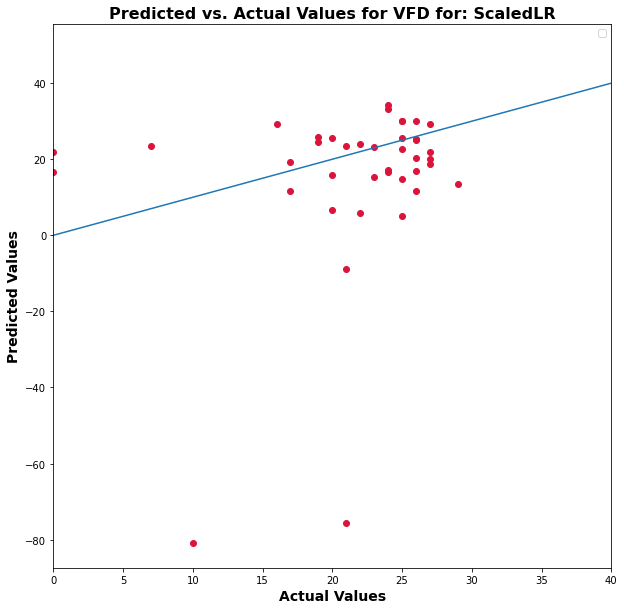

No handles with labels found to put in legend.


ScaledLASSO
MSE: 			294.5364481403077
R-Squared Score: 	-5.6948660627707


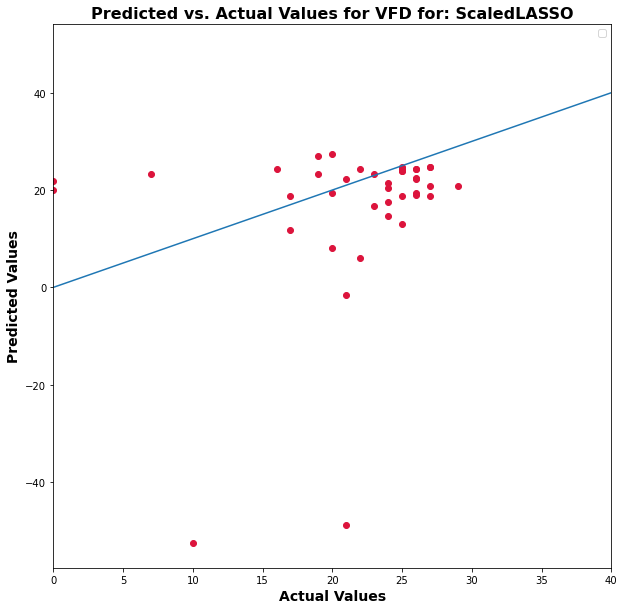

ScaledEN
MSE: 			427.44803181073456
R-Squared Score: 	-8.71597009414805


No handles with labels found to put in legend.


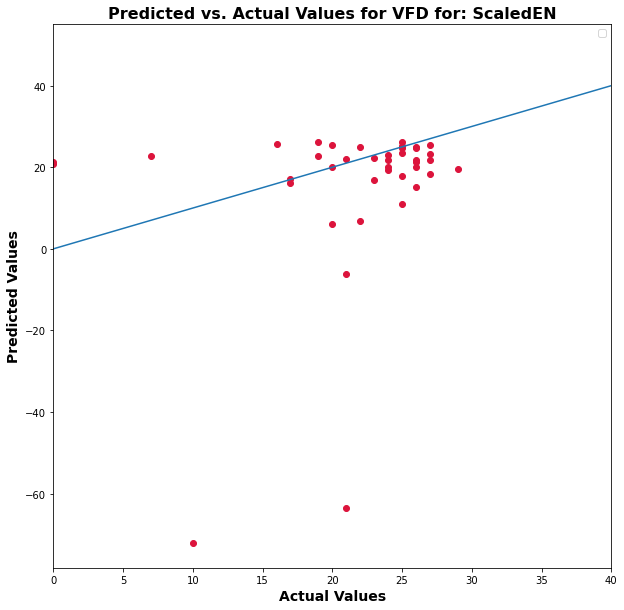

No handles with labels found to put in legend.


ScaledKNN
MSE: 			56.551
R-Squared Score: 	-0.28541432853631865


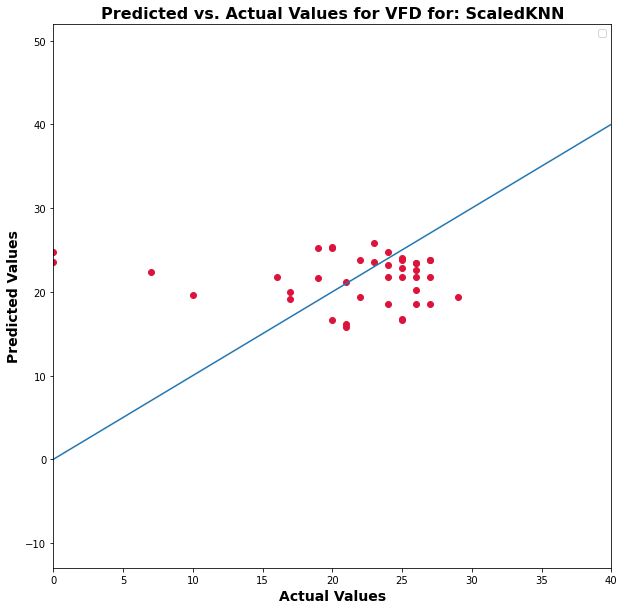

ScaledCART
MSE: 			113.2
R-Squared Score: 	-1.573056214572886


No handles with labels found to put in legend.


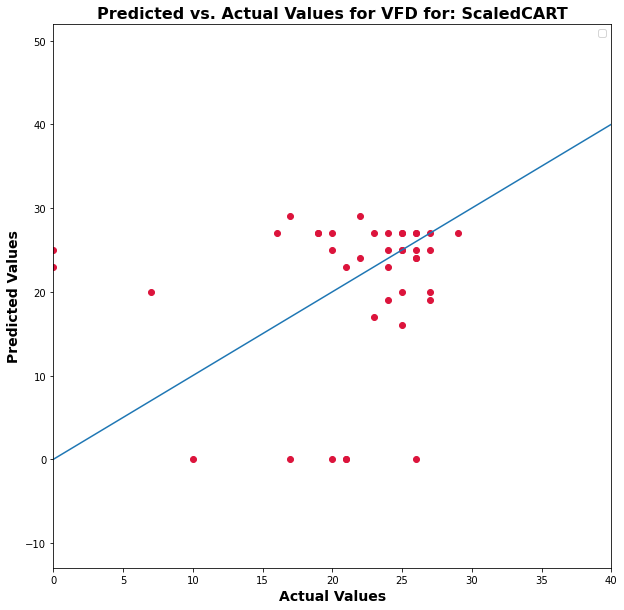

No handles with labels found to put in legend.


ScaledGBM
MSE: 			81.5832736397173
R-Squared Score: 	-0.8544023784794605


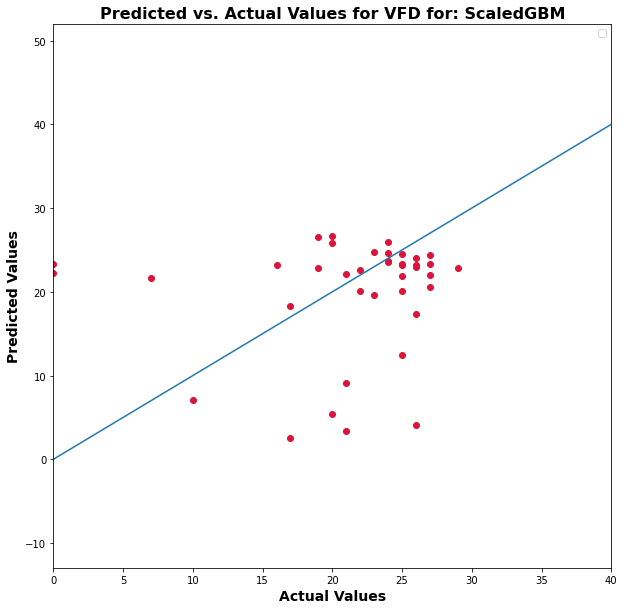

No handles with labels found to put in legend.


SVM
MSE: 			57.35
R-Squared Score: 	-0.3035757412169171


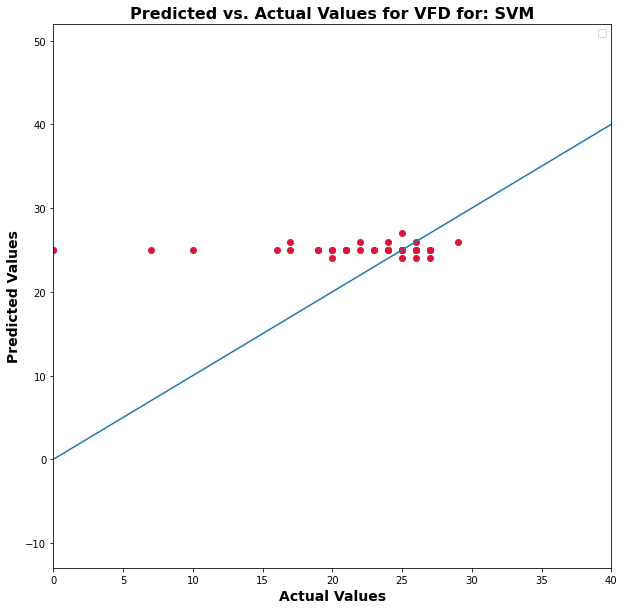

In [321]:
combinedDfNormalized = pd.read_csv('data/processed/VFD/CombinedDataset/combinedDfNormalized.csv').set_index('Unnamed: 0')
compareRegressions(combinedDfNormalized)

(40, 202)
['Infection Status_None', 'Race_UnknownDeclined', 'Infection Status_Co', 'Race_White', 'ECMO_Yes']
[1.6939995460861579, 1.2110560270365913, -1.5060790847090242, -1.584888435221553, -4.313538017513518]
(40, 5)


<ipython-input-12-e8a6c5dce0a0>:78: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  featuresDfReducedSmoteTotal['VFD'] = tgt


ScaledLR:
	Mean: 	-2.862299721445348
	STD: 	0.6683420282429433
ScaledLASSO:
	Mean: 	-2.8663914784420093
	STD: 	0.6203479307464267
ScaledEN:
	Mean: 	-2.8069058177463626
	STD: 	0.6512257286834472
ScaledKNN:
	Mean: 	-2.8990000000000005
	STD: 	0.6082624299374977
ScaledCART:
	Mean: 	-2.994314909297052
	STD: 	0.6517948629849917


/opt/conda/lib/python3.8/site-packages/sklearn/model_selection/_split.py:666: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=3.
  warnings.warn(("The least populated class in y has only %d"
No handles with labels found to put in legend.


ScaledGBM:
	Mean: 	-2.964090353921061
	STD: 	0.6469383072754434
SVM:
	Mean: 	-3.2221428571428565
	STD: 	0.8508711022552483
ScaledLR
MSE: 	12.024882701662628
R-Squared Err: 	-0.16369832596735123


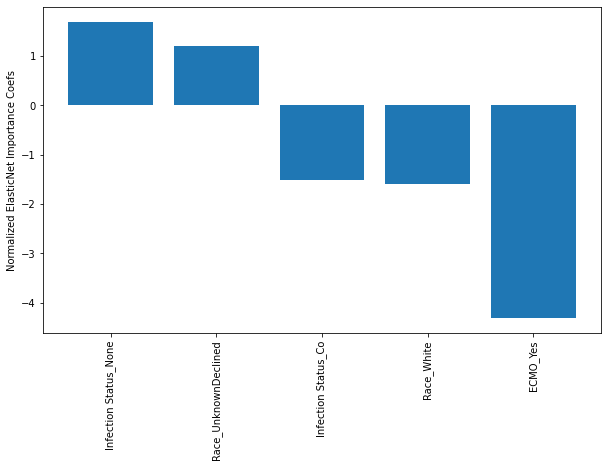

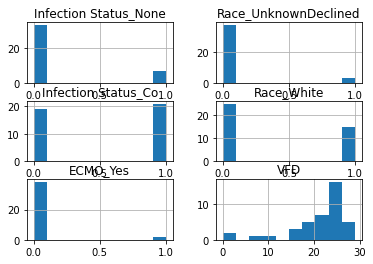

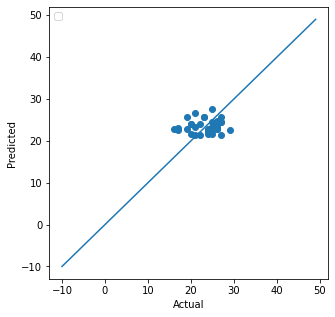

No handles with labels found to put in legend.


ScaledLASSO
MSE: 	11.600785101901293
R-Squared Err: 	-0.12265662276464129


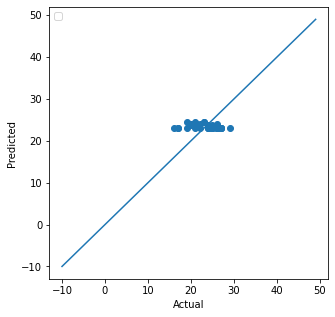

ScaledEN
MSE: 	11.40089442195929
R-Squared Err: 	-0.10331236341541516


No handles with labels found to put in legend.


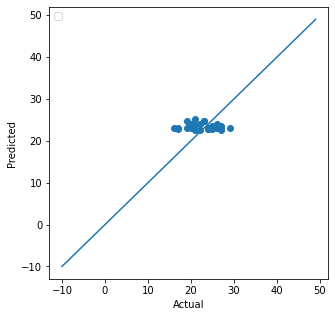

No handles with labels found to put in legend.


ScaledKNN
MSE: 	11.553333333333335
R-Squared Err: 	-0.11806451612903235


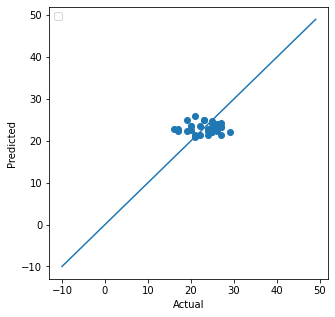

No handles with labels found to put in legend.


ScaledCART
MSE: 	12.111857048374908
R-Squared Err: 	-0.1721151982298299


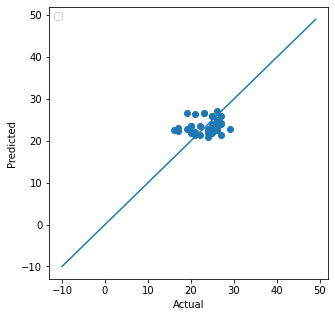

No handles with labels found to put in legend.


ScaledGBM
MSE: 	12.140906383877665
R-Squared Err: 	-0.17492642424622562


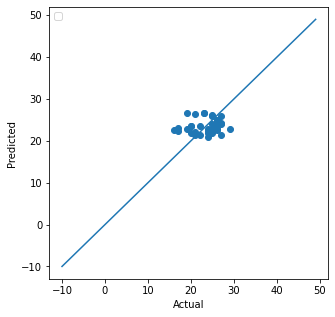

No handles with labels found to put in legend.


SVM
MSE: 	14.61111111111111
R-Squared Err: 	-0.413978494623656


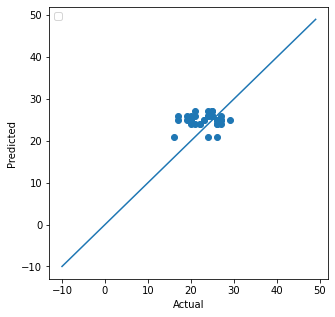

In [57]:
combinedDfNormalized = pd.read_csv('data/processed/VFD/CombinedDataset/combinedDfNormalized.csv').set_index('Unnamed: 0')
keys, featuresDfReduced = applyLimitOnRemainedFeatures(combinedDfNormalized, cutoff=0.0)

# featuresDfReduced.hist(column='VFD')
# featuresDfReduced.hist(column='Race_White')
featuresDfReduced.hist()

compareRegressions(featuresDfReduced[featuresDfReduced.VFD > 15])
# compareRegressions(featuresDfReduced)

In [6]:
# Results of Stability Selection
features = open('data/processed/VFD/StabilitySelection/selectedFeatures.txt', 'r')
Lines = features.readlines()

selectedFeatures = []
 
# Strips the newline character
for line in Lines:
    selectedFeatures.append(line[:-1])


In [125]:
len(selectedFeatures)

425

<ipython-input-149-fb08ff160345>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureCombinedDfNormalized['VFD'] = combinedDfNormalized.VFD
<ipython-input-149-fb08ff160345>:8: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  selectedFeatureCombinedDfNormalized.hist(bins=12, ax = ax)


ScaledLR:
	Mean: 	-8.216073424669023
	STD: 	2.5050671936324522
ScaledLASSO:
	Mean: 	-4.910940408587634
	STD: 	1.1908620008755342
ScaledEN:
	Mean: 	-4.730608816345198
	STD: 	1.1595016532400693
ScaledKNN:
	Mean: 	-4.809
	STD: 	1.0687113735709934
ScaledCART:
	Mean: 	-7.245
	STD: 	2.324994623649698


/opt/conda/lib/python3.8/site-packages/sklearn/model_selection/_split.py:666: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=3.
  warnings.warn(("The least populated class in y has only %d"
No handles with labels found to put in legend.


ScaledGBM:
	Mean: 	-5.608732557314936
	STD: 	1.7451255519587563
SVM:
	Mean: 	-4.74
	STD: 	1.8006665432555804
ScaledLR
MSE: 			204.83413602905512
R-Squared Score: 	-3.6559164899843477


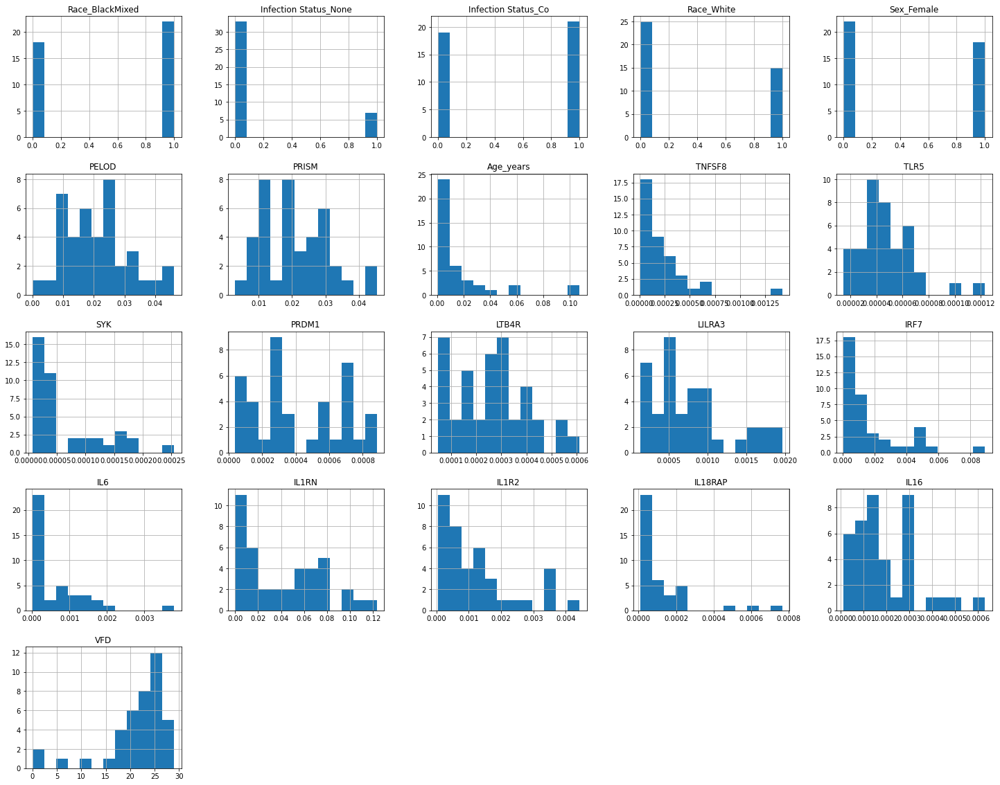

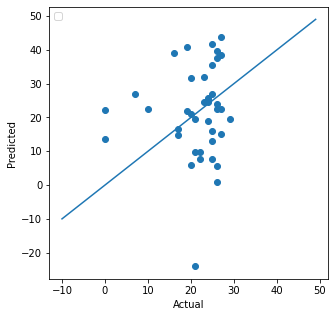

No handles with labels found to put in legend.


ScaledLASSO
MSE: 			54.121247231219435
R-Squared Score: 	-0.23018561421134942


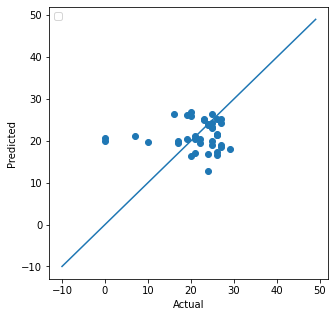

No handles with labels found to put in legend.


ScaledEN
MSE: 			49.871178749258114
R-Squared Score: 	-0.13358079866478656


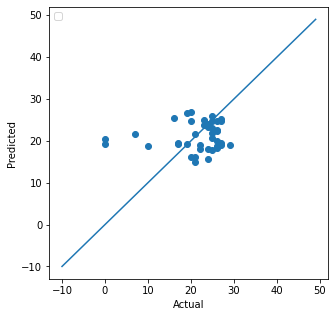

ScaledKNN
MSE: 			38.455
R-Squared Score: 	0.1259109829381596


No handles with labels found to put in legend.


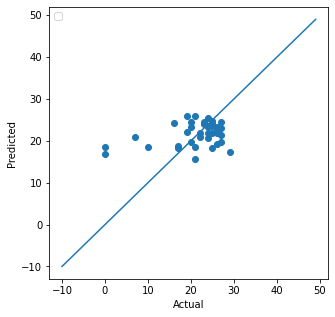

No handles with labels found to put in legend.


ScaledCART
MSE: 			90.025
R-Squared Score: 	-1.0462843261212371


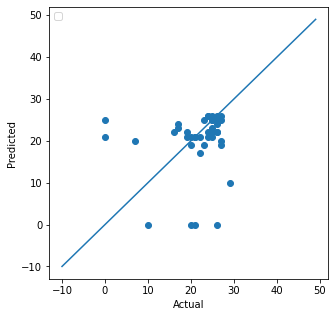

No handles with labels found to put in legend.


ScaledGBM
MSE: 			63.17506801239121
R-Squared Score: 	-0.43598057734406304


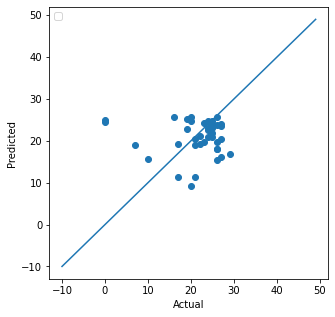

SVM
MSE: 			57.825
R-Squared Score: 	-0.3143725760395506


No handles with labels found to put in legend.


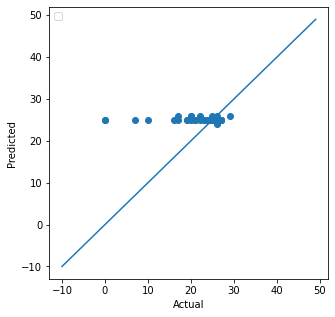

In [149]:
combinedDfNormalized = pd.read_csv('data/processed/VFD/CombinedDataset/combinedDfNormalized.csv').set_index('Unnamed: 0')
selectedFeatureCombinedDfNormalized = combinedDfNormalized[selectedFeatures[:20]]
selectedFeatureCombinedDfNormalized['VFD'] = combinedDfNormalized.VFD
# selectedFeatureCombinedDfNormalized = selectedFeatureCombinedDfNormalized[selectedFeatureCombinedDfNormalized.VFD < 22]

fig = plt.figure(figsize = (25,20))
ax = fig.gca()
selectedFeatureCombinedDfNormalized.hist(bins=12, ax = ax)

# f, ax = plt.subplots(figsize=(16, 12))
# corrMatrix = selectedFeatureCombinedDfNormalized.corr()
# sn.heatmap(corrMatrix, annot=True)
# # corrPlot.get_figure().savefig('data/processed/VFD/CombinedDataset/StabilitySelectCorrelation.pdf')
# plt.show()

compareRegressions(selectedFeatureCombinedDfNormalized)

In [45]:
selectedFeatureCombinedDfNormalized.head()

,Race_BlackMixed,Infection Status_None,Infection Status_Co,Race_White,Sex_Female,PELOD,PRISM,Age_years,ZBTB16,TNFSF8
Unnamed: 0,,,,,,,,,,
1,0.0,0.0,0.0,1.0,1.0,0.005780,0.017595,0.005530,0.000333,0.000161
2,1.0,1.0,0.0,0.0,0.0,0.008671,0.008798,0.004382,0.000020,0.000340
3,1.0,0.0,0.0,0.0,1.0,0.020231,0.020528,0.008765,0.000126,0.000076
4,1.0,0.0,0.0,0.0,0.0,0.037572,0.023460,0.054674,0.000013,0.000269
5,0.0,0.0,1.0,1.0,1.0,0.017341,0.010264,0.000835,0.000043,0.000033


# Dealing with Imbalance in Regression

## SMOGN

r_index: 100%|##########| 8/8 [00:00<00:00, 285.42it/s]


(40, 6)
(25, 6)
***********************************************
here------
[20.92645294 26.07491857 23.58666209 23.01371507 19.22201269 18.64906566
 18.64906566 21.30927482 23.58666209 19.22201269 21.30927482 21.30927482
 21.30927482 21.88222184 22.02783883 20.73992674 19.64761905 22.02783883
 19.48278388 20.57509158 24.8967033  23.28498168 28.83809524 23.28498168
 23.63956044 23.12014652 19.48278388 19.98170732 25.4171286  21.50471175
 25.4171286  19.0363082  16.78492239 16.78492239 23.16574279 19.25332594
 19.0363082  15.67904656 19.0363082  18.6191796 ]
ScaledLR:
	Mean: 	-12.320605373981435
	STD: 	7.141814458128355
here------
[21.55038626 24.38026863 22.66832565 22.66832565 21.09465868 21.09465868
 21.09465868 22.21259808 22.66832565 21.09465868 22.21259808 22.21259808
 22.21259808 22.21259808 22.52122735 21.3916562  21.3916562  22.52122735
 21.3916562  21.3916562  22.52122735 22.52122735 22.52122735 22.52122735
 22.52122735 22.52122735 21.3916562  21.11837539 22.76577167 21.1183753

/opt/conda/lib/python3.8/site-packages/sklearn/model_selection/_split.py:666: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=3.
  warnings.warn(("The least populated class in y has only %d"
No handles with labels found to put in legend.


here------
[23.34890097 26.04525648 18.35430957 25.15652904 20.07102971 13.42958082
 13.42958082 21.3040457  18.35430957 20.07102971 21.3040457  21.3040457
 21.3040457  24.85770249 20.98364147 17.33562623 21.7492549  20.98364147
 10.05333528 21.99653897 26.77360866 26.34037345 25.62300793 26.34037345
 22.88948429 24.50400153 10.05333528 21.64366886 21.43364546 23.69404954
 21.43364546 21.42535532 20.41138022 20.41138022 28.55781896 20.69625917
 21.42535532  8.24184725 21.42535532 20.05802083]
ScaledGBM:
	Mean: 	-7.615746969003026
	STD: 	2.9849976343562097
here------
[26 25 25 25 26 26 26 25 25 21 26 26 25 24 23 25 26 23 24 26 25 25 25 26
 25 26 26 26 25 25 25 26 24 24 26 21 26 25 26 26]
SVM:
	Mean: 	-6.704
	STD: 	2.831321952728089
ScaledLR
MSE: 			47.09916112082575
R-Squared Score: 	-0.07057234296033865


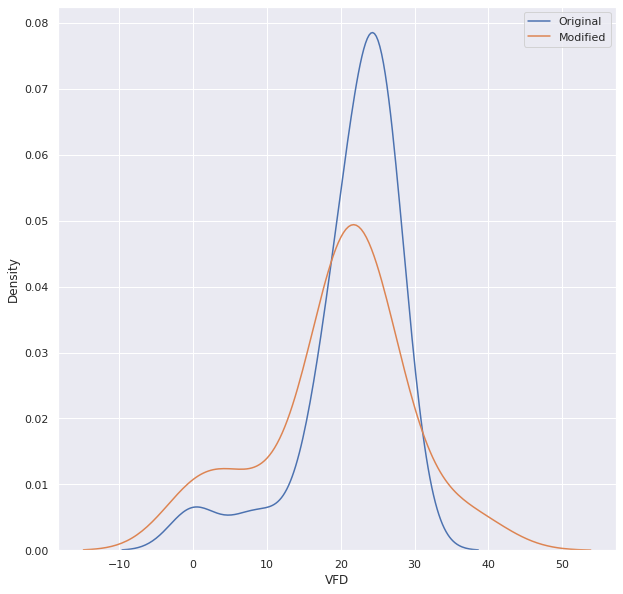

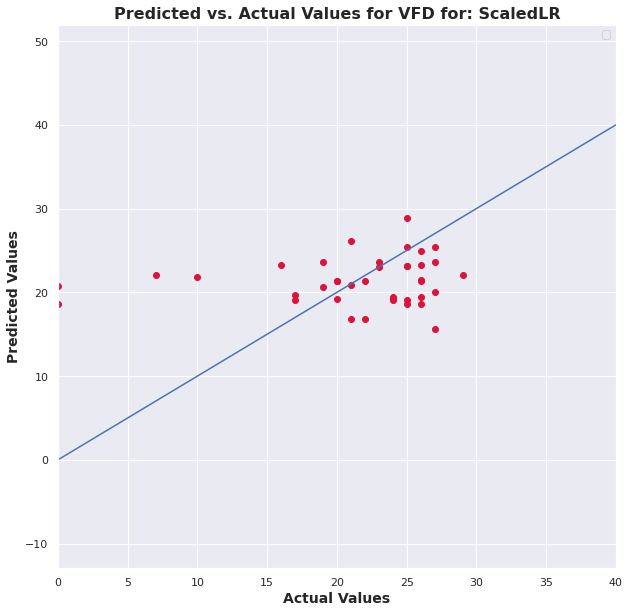

No handles with labels found to put in legend.


ScaledLASSO
MSE: 			46.8457449773279
R-Squared Score: 	-0.06481214876510677


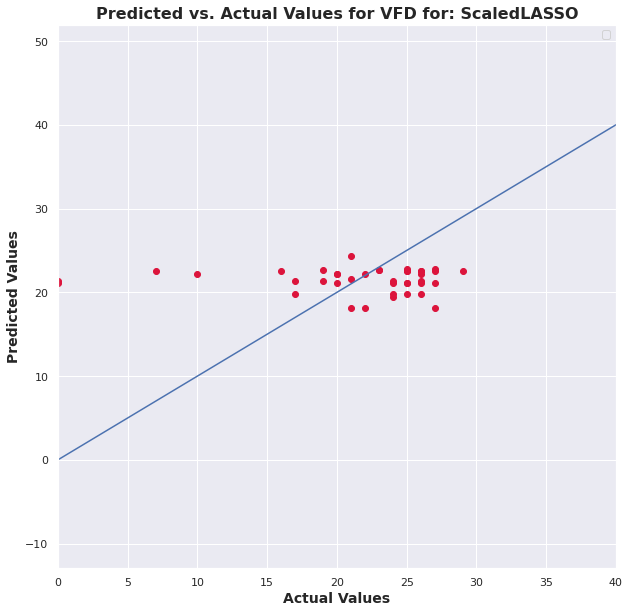

No handles with labels found to put in legend.


ScaledEN
MSE: 			46.42865120032006
R-Squared Score: 	-0.05533153273162905


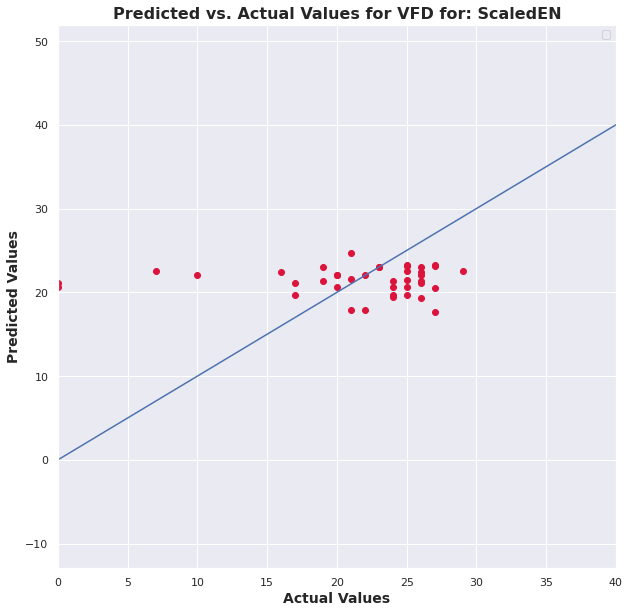

No handles with labels found to put in legend.


ScaledKNN
MSE: 			45.522
R-Squared Score: 	-0.034723189044054026


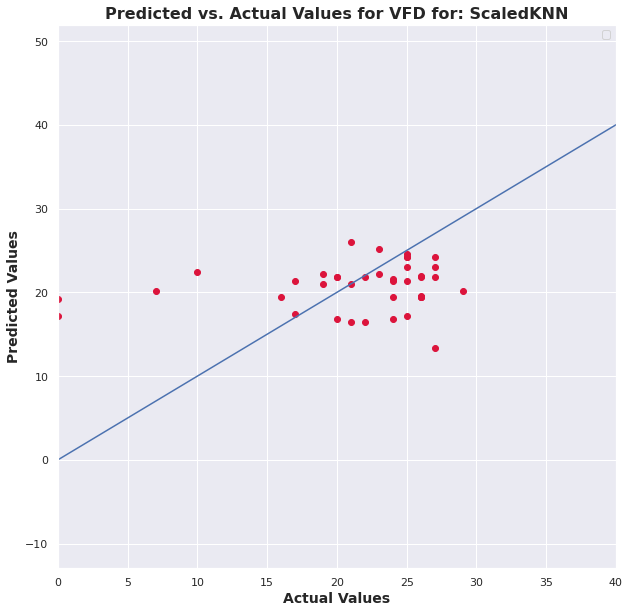

No handles with labels found to put in legend.


ScaledCART
MSE: 			58.577868055555555
R-Squared Score: 	-0.3314854013849624


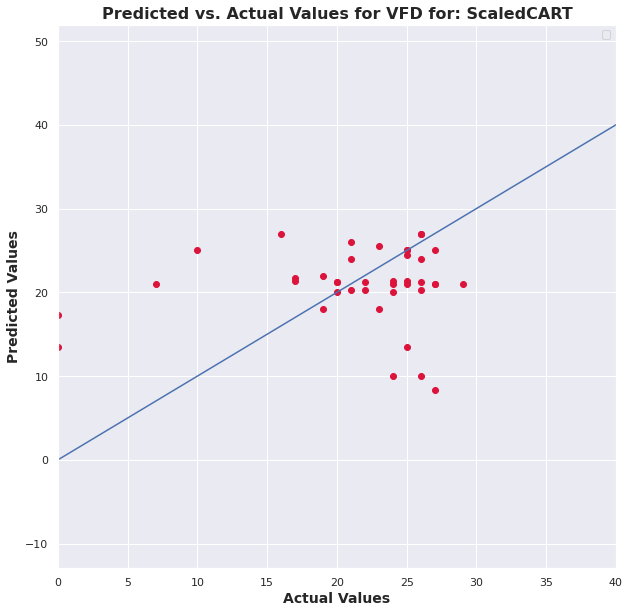

No handles with labels found to put in legend.


ScaledGBM
MSE: 			58.25343007384869
R-Squared Score: 	-0.32411086812458856


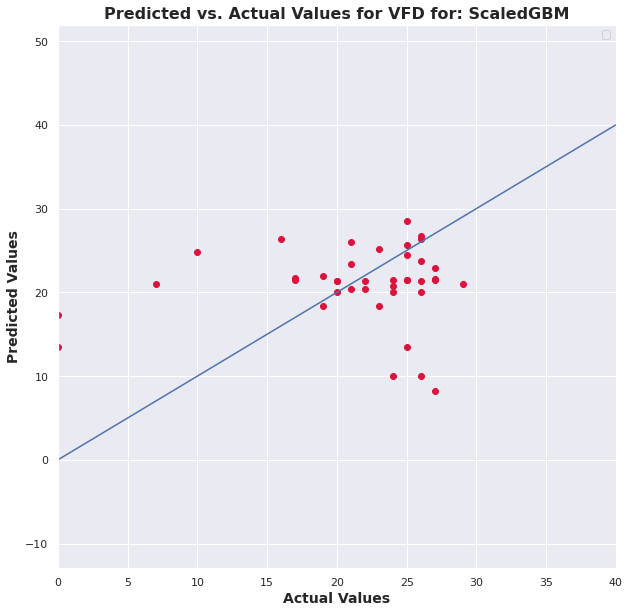

No handles with labels found to put in legend.


SVM
MSE: 			58.05
R-Squared Score: 	-0.31948686621869293


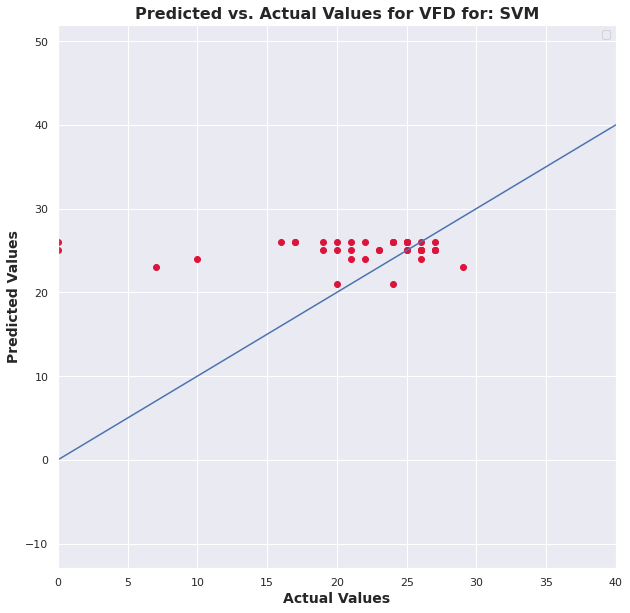

In [392]:
combinedDfNormalized = pd.read_csv('data/processed/VFD/CombinedDataset/combinedDfNormalized.csv').set_index('Unnamed: 0')
selectedFeatureCombinedDfNormalized = combinedDfNormalized[selectedFeatures[:5]]
selectedFeatureCombinedDfNormalized['VFD'] = combinedDfNormalized.VFD

## load libraries
import smogn
import pandas
import seaborn


## conduct smogn
features_smogn = smogn.smoter(
    
    data = selectedFeatureCombinedDfNormalized, 
    y = "VFD",
    k = 3,
    pert = 0.2
)

print('=============================================')
# print('Original VFD Histogram')
print(selectedFeatureCombinedDfNormalized.shape)
# print(selectedFeatureCombinedDfNormalized.VFD.values)
# print('------ Boxplot Stats ------')
# print(smogn.box_plot_stats(selectedFeatureCombinedDfNormalized['VFD'])['stats'])
# selectedFeatureCombinedDfNormalized.VFD.hist()


print('=============================================')
# print('Smogned VFD Histogram')
print(features_smogn.shape)
# print(features_smogn.VFD.values)
# print('------ Boxplot Stats ------')
# print(smogn.box_plot_stats(features_smogn['VFD'])['stats'])
# features_smogn.VFD.hist()

print('=============================================')
## distribution plot
seaborn.set(rc={'figure.figsize':(10,10)})
seaborn.kdeplot(selectedFeatureCombinedDfNormalized['VFD'], label = "Original", legend = True)
seaborn.kdeplot(features_smogn['VFD'], label = "Modified", legend = True)
plt.legend()

print('***********************************************')

# compareRegressions(features_smogn)
compareRegressions(features_smogn, selectedFeatureCombinedDfNormalized)


ScaledLR:
	Mean: 	-29.80376017069028
	STD: 	42.78733425336047
ScaledLASSO:
	Mean: 	-6.365854813560267
	STD: 	2.324119986588355
ScaledEN:
	Mean: 	-6.170469126675183
	STD: 	2.2768591494441623
ScaledKNN:
	Mean: 	-7.3874666666666675
	STD: 	1.8666717333264569
ScaledCART:
	Mean: 	-5.942666666666667
	STD: 	2.412716679964263


/opt/conda/lib/python3.8/site-packages/sklearn/model_selection/_split.py:666: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=3.
  warnings.warn(("The least populated class in y has only %d"
No handles with labels found to put in legend.


ScaledGBM:
	Mean: 	-5.846810890849049
	STD: 	1.688728766744032
SVM:
	Mean: 	-5.916
	STD: 	2.4864453878311235
ScaledLR
MSE: 			22985.46465614744
R-Squared Score: 	-240.14929197114327


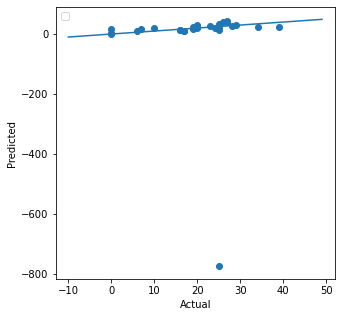

No handles with labels found to put in legend.


ScaledLASSO
MSE: 			66.51460351269725
R-Squared Score: 	0.3021698807146632


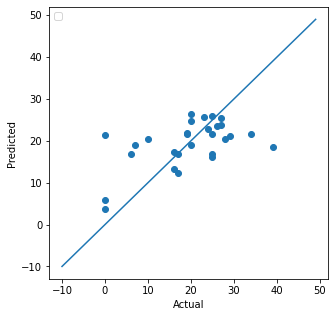

No handles with labels found to put in legend.


ScaledEN
MSE: 			70.35886417836834
R-Squared Score: 	0.2618382732598118


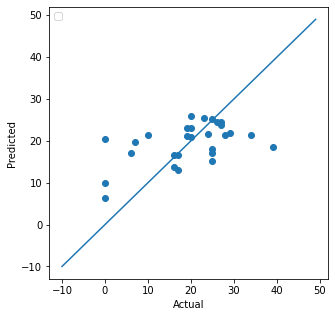

No handles with labels found to put in legend.


ScaledKNN
MSE: 			89.55714285714285
R-Squared Score: 	0.06042179638154366


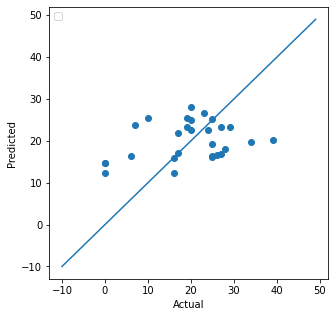

No handles with labels found to put in legend.


ScaledCART
MSE: 			64.25
R-Squared Score: 	0.32592870142383035


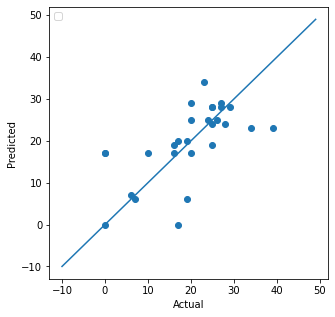

No handles with labels found to put in legend.


ScaledGBM
MSE: 			53.71555444815639
R-Squared Score: 	0.4364495946987126


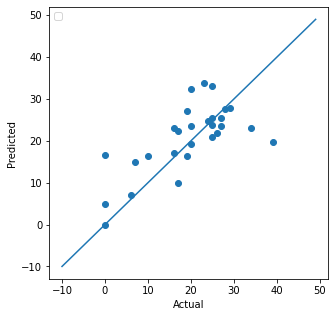

No handles with labels found to put in legend.


SVM
MSE: 			107.64285714285714
R-Squared Score: 	-0.12932234236163165


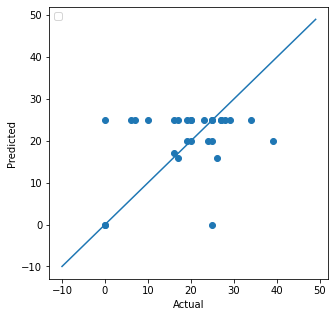

In [255]:
compareRegressions(features_smogn)

# ANN

In [3]:
# import numpy as np
# from keras.layers import Dense, Activation
# from keras.models import Sequential
# from sklearn.model_selection import train_test_split
# import matplotlib.pyplot as plt

# combinedDfNormalized = pd.read_csv('data/processed/VFD/CombinedDataset/combinedDfNormalized.csv').set_index('Unnamed: 0')
# selectedFeatureCombinedDfNormalized = combinedDfNormalized[selectedFeatures[:inputNumber]]
# selectedFeatureCombinedDfNormalized['VFD'] = combinedDfNormalized.VFD

# inputNumber = 10


# XOriginal = selectedFeatureCombinedDfNormalized.values[:,0:inputNumber]
# yOriginal = selectedFeatureCombinedDfNormalized.values[:,-1]

# sc = StandardScaler()
# XOriginal = sc.fit_transform(XOriginal)

# ## conduct smogn
# features_smogn = smogn.smoter(
    
#     data = selectedFeatureCombinedDfNormalized, 
#     y = "VFD",
#     k = 3,
#     pert = 0.2
# )

# X = features_smogn.values[:,0:inputNumber]
# y = features_smogn.values[:,-1]

# # Splitting the dataset into the Training set and Test set
# X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.01, random_state = 42)
# # X_train, X_test, y_train, y_test = train_test_split(XOriginal, yOriginal, test_size = 0.2, random_state = 42)

# # Feature Scaling
# from sklearn.preprocessing import StandardScaler
# sc = StandardScaler()
# X_train = sc.fit_transform(X_train)
# X_test = sc.transform(X_test)

# # Initialising the ANN
# model = Sequential()

# # Adding the input layer and the first hidden layer
# model.add(Dense(10, activation = 'relu', input_dim = inputNumber))

# # Adding the second hidden layer
# model.add(Dense(units = inputNumber*4, activation = 'relu'))

# # Adding the third hidden layer
# model.add(Dense(units = inputNumber*2, activation = 'relu'))

# # Adding the output layer

# model.add(Dense(units = 1))

# #model.add(Dense(1))
# # Compiling the ANN
# model.compile(optimizer = 'adam', loss = 'mean_squared_error')

# # Fitting the ANN to the Training set
# model.fit(X_train, y_train, batch_size = (X_train.shape[0]), epochs = 1000)

# y_pred = model.predict(X_test)
# y_predOriginal = model.predict(XOriginal)

# # plt.plot(y_test, color = 'red', label = 'Real data')
# plt.plot(yOriginal, color = 'red', label = 'Real data')
# plt.plot(y_predOriginal, color = 'blue', label = 'Predicted data')
# plt.title('Prediction')
# plt.legend()
# plt.show()

# from sklearn.metrics import mean_squared_error
# from sklearn.metrics import r2_score

# XLimit = [-10,50]
# YLimit = [-10,50]

# xLine = np.arange(XLimit[0], XLimit[1])
# yLine = xLine

# mse = mean_squared_error(y_test, y_pred)
# mseOriginal = mean_squared_error(yOriginal, y_predOriginal)
# coefficient_of_dermination = r2_score(y_test, y_pred)
# coefficient_of_derminationOriginal = r2_score(yOriginal, y_predOriginal)

# # =============================================
# print('MSE: \t\t\t' + str(mse))
# print('R-Squared Score: \t' + str(coefficient_of_dermination))
# plt.figure(figsize=[10,10])

# plt.scatter(y_test,y_pred, c='crimson')
# plt.plot(xLine, yLine)

# plt.ylabel('Predicted Values',fontweight="bold", fontsize=14)
# plt.xlabel('Actual Values',fontweight="bold", fontsize=14)
# plt.title("Predicted vs. Actual Values (SMOGN) for VFD for: ANN",fontweight="bold", fontsize=16)

# plt.legend()
# plt.show()

# # =============================================
# print('MSE: \t\t\t' + str(mseOriginal))
# print('R-Squared Score: \t' + str(coefficient_of_derminationOriginal))
# plt.figure(figsize=[10,10])

# plt.scatter(yOriginal,y_predOriginal, c='crimson')
# plt.plot(xLine, yLine)

# plt.ylabel('Predicted Values',fontweight="bold", fontsize=14)
# plt.xlabel('Actual Values',fontweight="bold", fontsize=14)
# plt.title("Predicted vs. Actual Values (Original) for VFD for: ANN",fontweight="bold", fontsize=16)

# plt.legend()
# plt.show()

In [13]:
import numpy as np
from keras.layers import Dense, Activation
from keras.models import Sequential
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import r2_score
import tensorflow as tf
import smogn


def trainANN(df, selectedFeatures, inputNumber, vfdCond = ''):

    selectedFeatureDF = df[selectedFeatures[:inputNumber]]
    selectedFeatureDF['VFD'] = df.VFD

    if vfdCond != '':
        XOriginal = selectedFeatureDF[selectedFeatureDF.VFD <= vfdCond].values[:,0:inputNumber]
        yOriginal = selectedFeatureDF[selectedFeatureDF.VFD <= vfdCond].values[:,-1]
    else:
        XOriginal = selectedFeatureDF.values[:,0:inputNumber]
        yOriginal = selectedFeatureDF.values[:,-1]

    sc = StandardScaler()
    XOriginal = sc.fit_transform(XOriginal)

    ## conduct smogn
    features_smogn = smogn.smoter(

        data = selectedFeatureDF, 
        y = "VFD",
        k = 3,
        pert = 0.2
    )
    
    print(features_smogn.shape)

    X = features_smogn.values[:,0:inputNumber]
    y = features_smogn.values[:,-1]

    # Splitting the dataset into the Training set and Test set
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.01, random_state = 42)
    # X_train, X_test, y_train, y_test = train_test_split(XOriginal, yOriginal, test_size = 0.2, random_state = 42)

    # Feature Scaling
    sc = StandardScaler()
    X_train = sc.fit_transform(X_train)
    X_test = sc.transform(X_test)
    
    # =============================================
    
#     print(XOriginal)
#     print(X_train)
    
    
    # =============================================

    # Initialising the ANN
    model = Sequential()

    # Adding the input layer and the first hidden layer
    model.add(Dense(10, activation = 'relu', input_dim = inputNumber))

    # Adding the second hidden layer
    model.add(Dense(units = inputNumber*4, activation = 'relu'))

    # Adding the third hidden layer
    model.add(Dense(units = inputNumber*4, activation = 'relu'))
    
#     # Adding the third hidden layer
#     model.add(Dense(units = inputNumber*1, activation = 'relu'))

    # Adding the output layer
    model.add(Dense(units = 1))

    #model.add(Dense(1))
    # Compiling the ANN
#     model.compile(optimizer = 'adam', loss = 'mean_squared_error')
    model.compile(optimizer = tf.optimizers.Adam(learning_rate=0.01), loss = 'mean_absolute_error')
    

    # Fitting the ANN to the Training set
    model.fit(X_train, y_train, batch_size = (X_train.shape[0]), epochs = 1000, verbose=0)

    y_pred = model.predict(X_test)
    y_predOriginal = model.predict(XOriginal)
    
    
    # =============================================
    
    XLimit = [-10,50]
    YLimit = [-10,50]

    xLine = np.arange(XLimit[0], XLimit[1])
    yLine = xLine

    mse = mean_squared_error(y_test, y_pred)
    mseOriginal = mean_squared_error(yOriginal, y_predOriginal)
    coefficient_of_dermination = r2_score(y_test, y_pred)
    coefficient_of_derminationOriginal = r2_score(yOriginal, y_predOriginal)
    maeOriginal = mean_absolute_error(yOriginal, y_predOriginal)
    
    # =============================================
    plt.figure(figsize=[10,10])
    plt.plot(yOriginal, color = 'red', label = 'Real data')
    plt.plot(y_predOriginal, color = 'blue', label = 'Predicted data')
    plt.ylabel('VFD (days)',fontweight="bold", fontsize=14)
    plt.xlabel('Index',fontweight="bold", fontsize=14)
    plt.title('Prediction',fontweight="bold", fontsize=16)
    plt.legend()
    plt.show()

    # =============================================
    print('MSE: \t\t\t' + str(mse))
    print('R-Squared Score: \t' + str(coefficient_of_dermination))
    plt.figure(figsize=[10,10])

    plt.scatter(y_test,y_pred, c='crimson')
    plt.plot(xLine, yLine)

    plt.ylabel('Predicted Values',fontweight="bold", fontsize=14)
    plt.xlabel('Actual Values',fontweight="bold", fontsize=14)
    plt.title("Predicted vs. Actual Values (SMOGN) for VFD for: ANN",fontweight="bold", fontsize=16)

    plt.legend()
    plt.show()

    # =============================================
    print('MSE: \t\t\t' + str(mseOriginal))
    print('MAE: \t' + str(maeOriginal))
    print('R-Squared Score: \t' + str(coefficient_of_derminationOriginal))
    plt.figure(figsize=[10,10])

    plt.scatter(yOriginal,y_predOriginal, c='crimson')
    plt.plot(xLine, yLine)

    plt.ylabel('Predicted Values',fontweight="bold", fontsize=14)
    plt.xlabel('Actual Values',fontweight="bold", fontsize=14)
    plt.title("Predicted vs. Actual Values (Original Dataset) for VFD using: ANN",fontweight="bold", fontsize=16)

    plt.legend()
    
    plt.savefig('figs/ANN_' + str(inputNumber) + '_' + str(vfdCond) + '.pdf')
    plt.show()
    
    return mseOriginal, maeOriginal, coefficient_of_derminationOriginal

<ipython-input-13-85380e66bd6c>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
r_index: 100%|##########| 8/8 [00:00<00:00, 125.04it/s]


(25, 27)


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


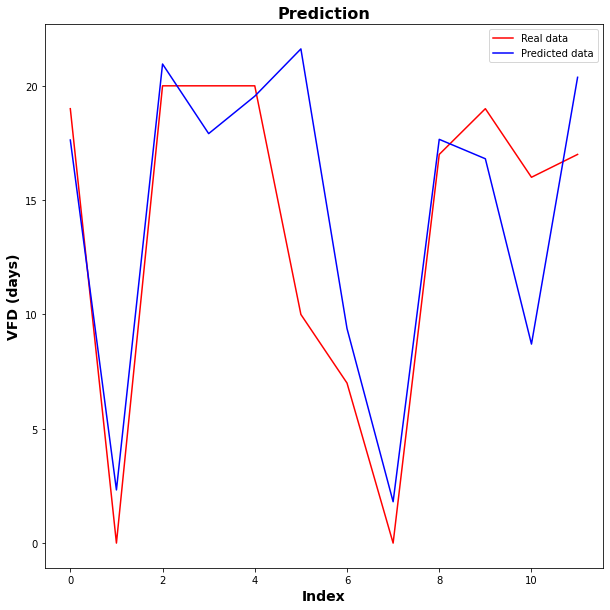

No handles with labels found to put in legend.


MSE: 			108.72917150819922
R-Squared Score: 	nan


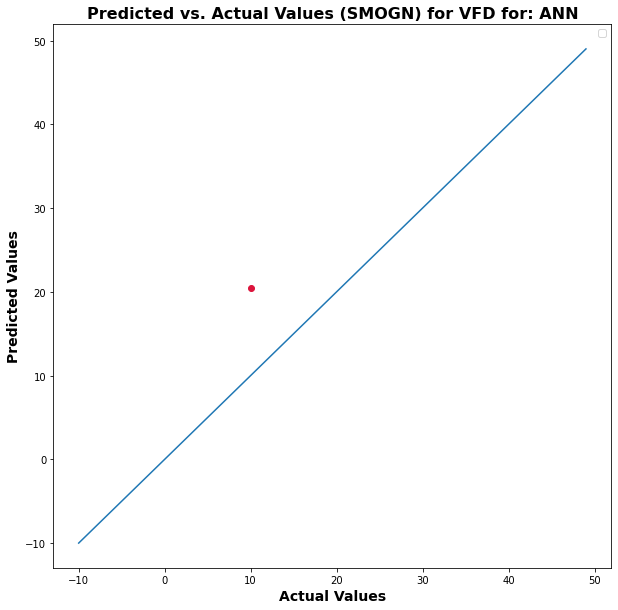

No handles with labels found to put in legend.


MSE: 			18.871326304584827
MAE: 	3.043123503526052
R-Squared Score: 	0.644077146318243


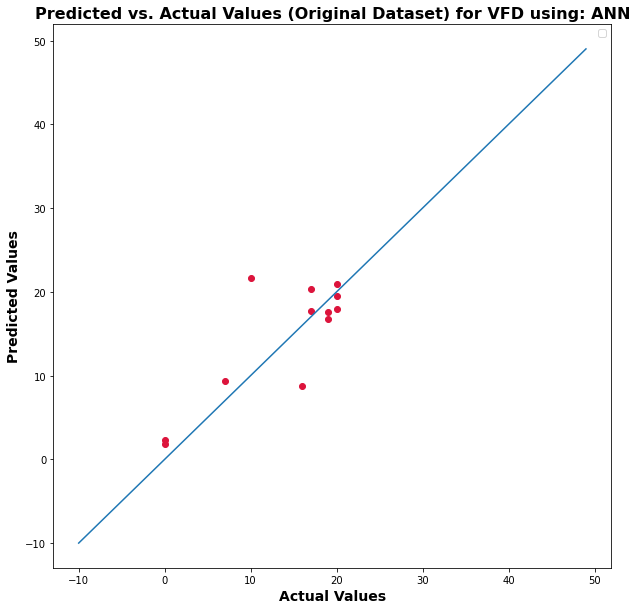

(18.871326304584827, 3.043123503526052, 0.644077146318243)

In [19]:
combinedDfNormalized = pd.read_csv('data/processed/VFD/CombinedDataset/combinedDfNormalized.csv').set_index('Unnamed: 0')
trainANN(combinedDfNormalized, selectedFeatures, 26,20)

<ipython-input-746-8c050f777e8c>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
r_index: 100%|##########| 8/8 [00:00<00:00, 120.12it/s]


(27, 40)


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


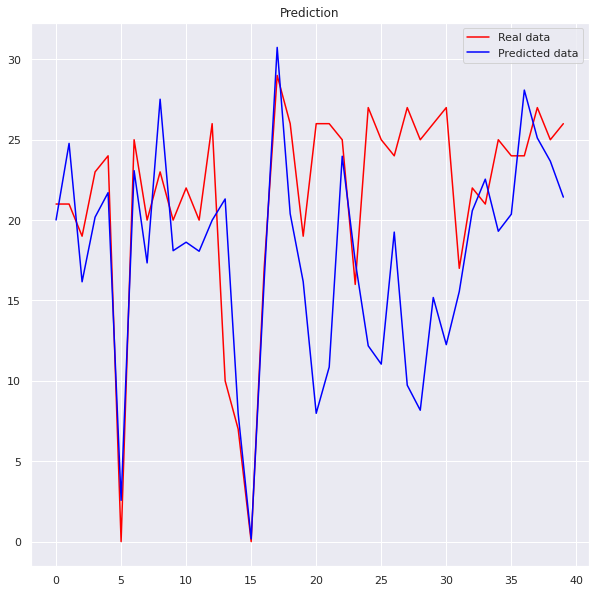

No handles with labels found to put in legend.


MSE: 			90.54668355040485
R-Squared Score: 	nan


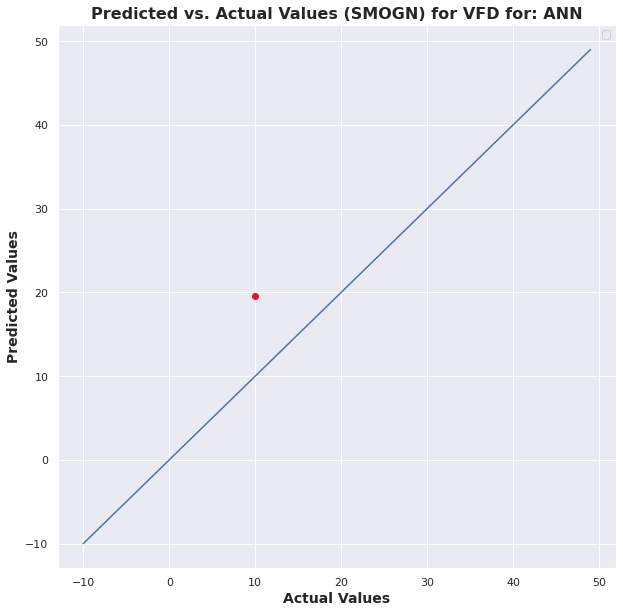

No handles with labels found to put in legend.


MSE: 			57.655820011399555
MAE: 	5.385783891752363
R-Squared Score: 	-0.310527084687521


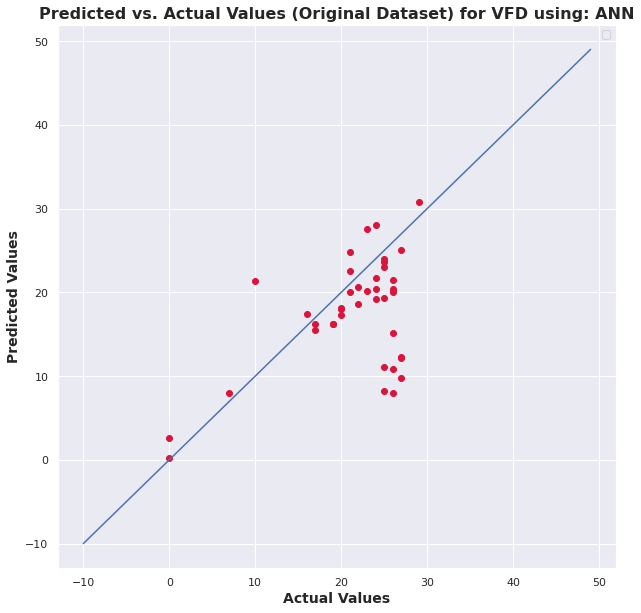

(57.655820011399555, 5.385783891752363, -0.310527084687521)

In [747]:
combinedDfNormalized = pd.read_csv('data/processed/VFD/CombinedDataset/combinedDfNormalized.csv').set_index('Unnamed: 0')
trainANN(combinedDfNormalized, selectedFeatures, 39)

In [39]:
selectedFeatures[:20]

['Race_BlackMixed',
 'Infection Status_None',
 'Infection Status_Co',
 'Race_White',
 'Sex_Female',
 'PELOD',
 'PRISM',
 'Age_years',
 'TNFSF8',
 'TLR5',
 'SYK',
 'PRDM1',
 'LTB4R',
 'LILRA3',
 'IRF7',
 'IL6',
 'IL1RN',
 'IL1R2',
 'IL18RAP',
 'IL16']

<ipython-input-546-1259e5c3eb40>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
r_index: 100%|##########| 8/8 [00:00<00:00, 363.21it/s]

2


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


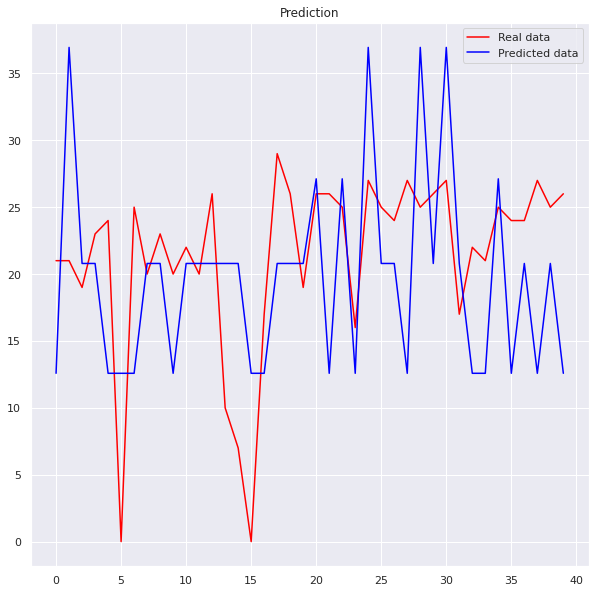

No handles with labels found to put in legend.


MSE: 			112.90083908295492
R-Squared Score: 	nan


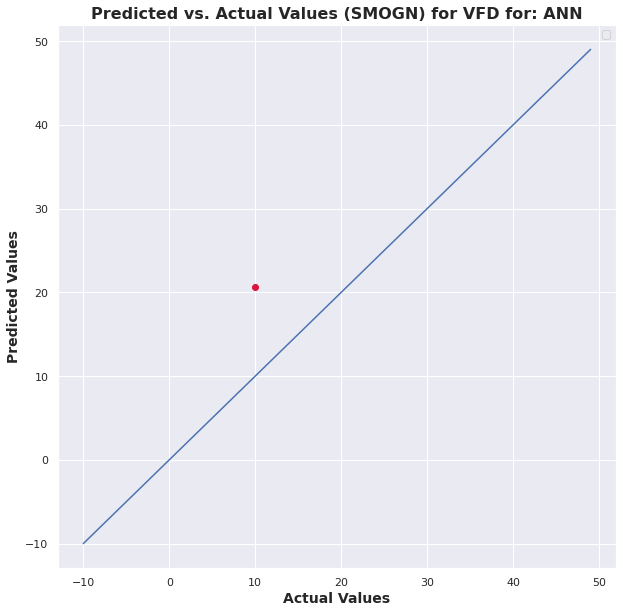

No handles with labels found to put in legend.


MSE: 			74.34225516779543
R-Squared Score: 	-0.6898127355552939


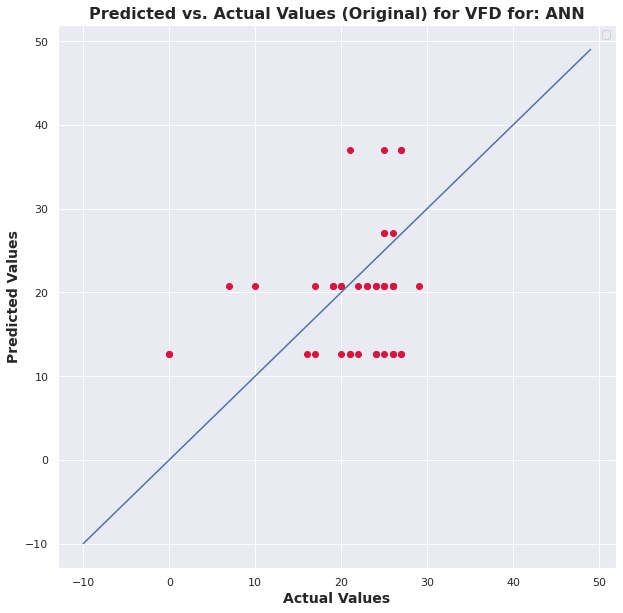

<ipython-input-546-1259e5c3eb40>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
r_index: 100%|##########| 8/8 [00:00<00:00, 692.24it/s]

3


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


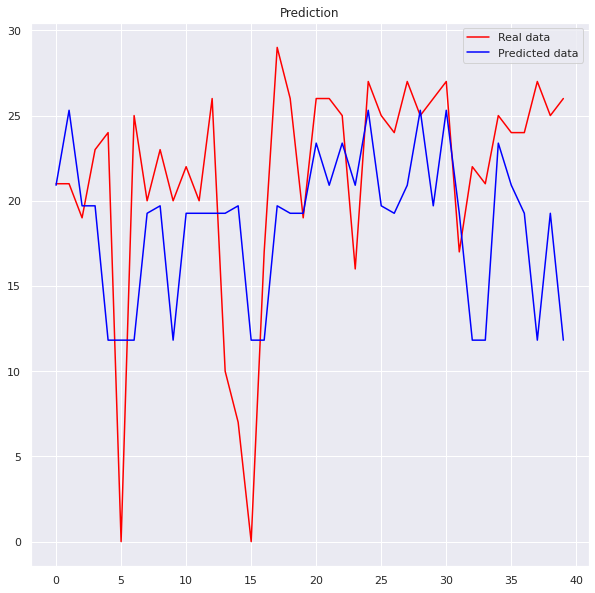

No handles with labels found to put in legend.


MSE: 			24.014379739202013
R-Squared Score: 	nan


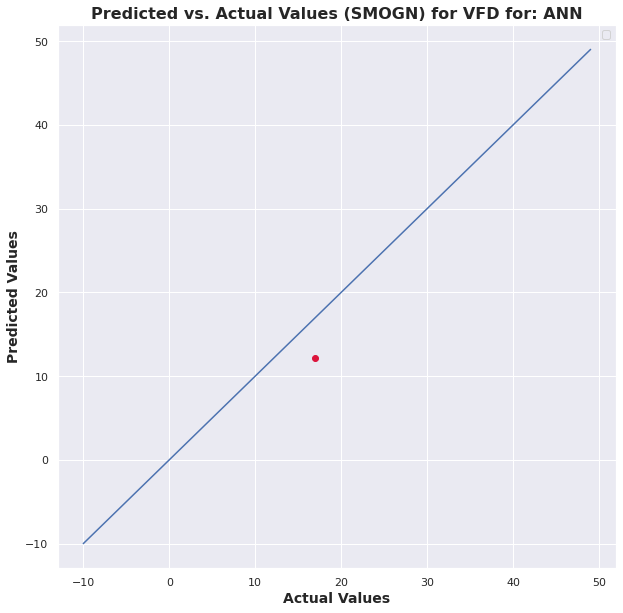

No handles with labels found to put in legend.


MSE: 			51.33274181698452
R-Squared Score: 	-0.16680238819132054


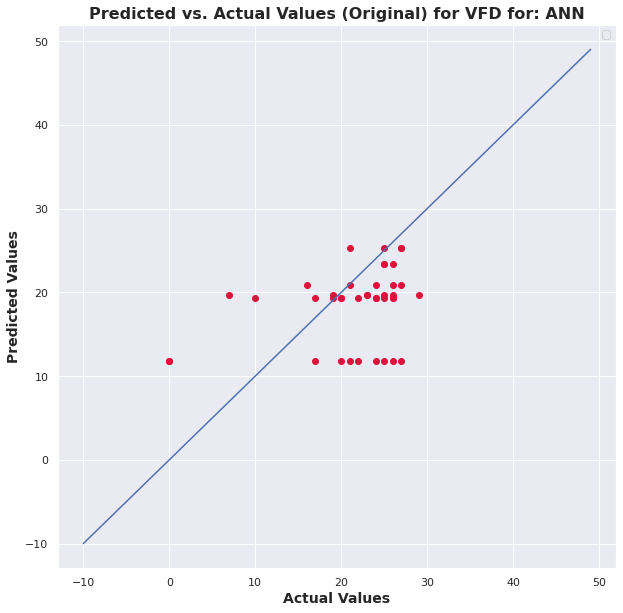

<ipython-input-546-1259e5c3eb40>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
r_index: 100%|##########| 8/8 [00:00<00:00, 718.36it/s]

4


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


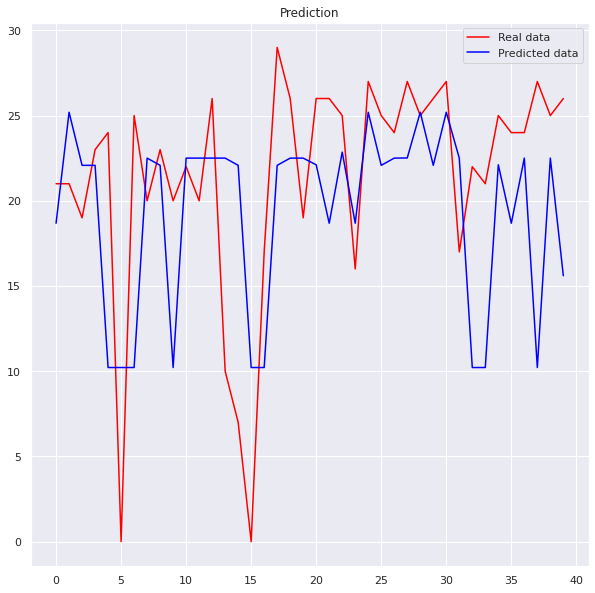

No handles with labels found to put in legend.


MSE: 			123.35592376535351
R-Squared Score: 	nan


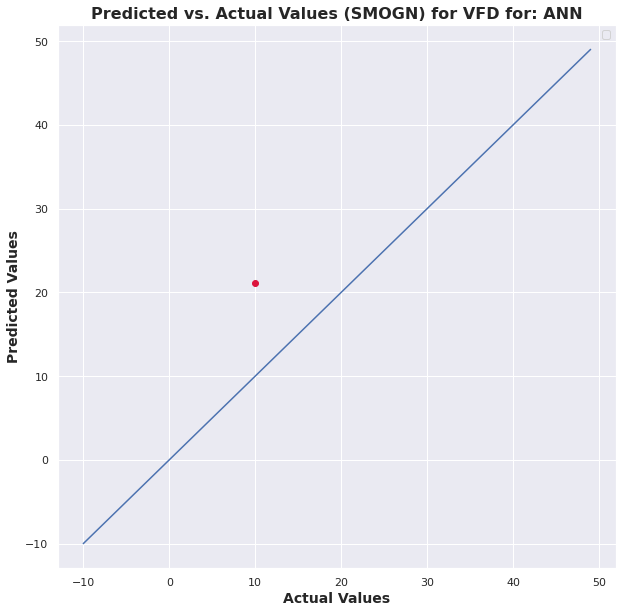

No handles with labels found to put in legend.


MSE: 			53.20373988916017
R-Squared Score: 	-0.20933050848341805


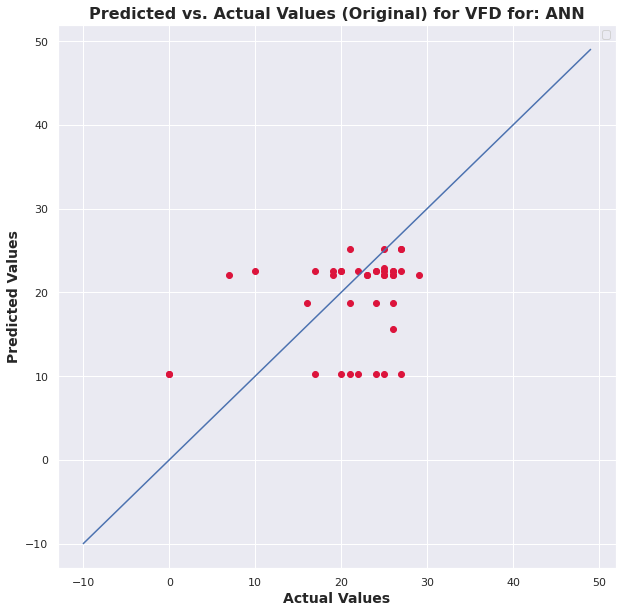

<ipython-input-546-1259e5c3eb40>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
r_index: 100%|##########| 8/8 [00:00<00:00, 599.73it/s]

5


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


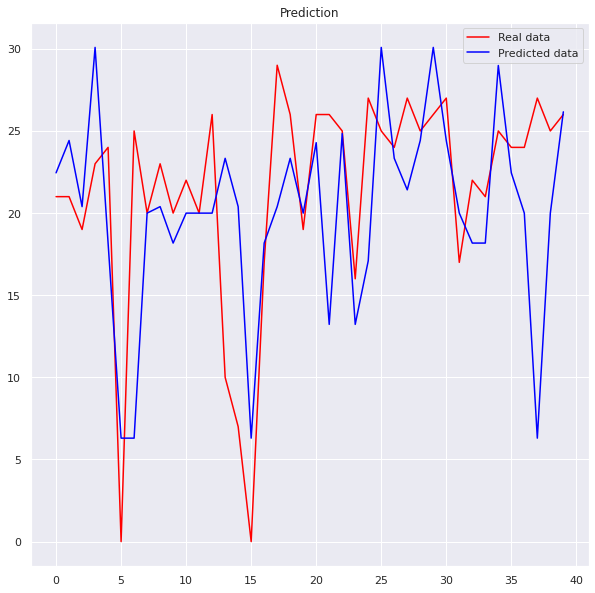

No handles with labels found to put in legend.


MSE: 			189.3558733412683
R-Squared Score: 	nan


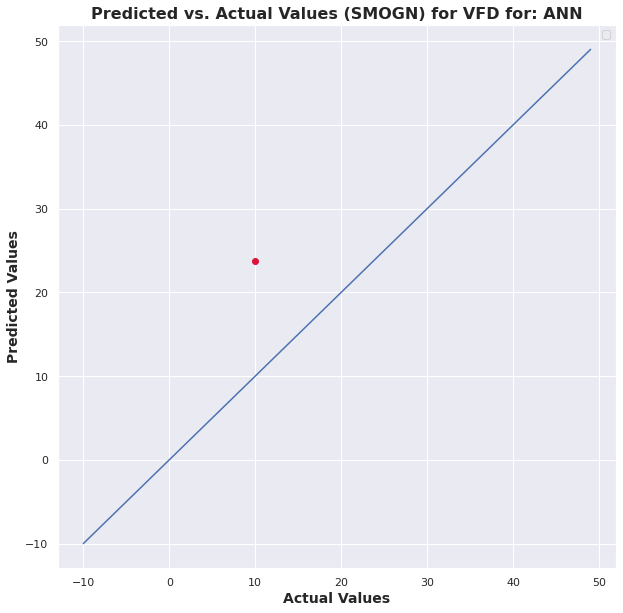

MSE: 			47.3172380574581
R-Squared Score: 	-0.07552927067285542


No handles with labels found to put in legend.


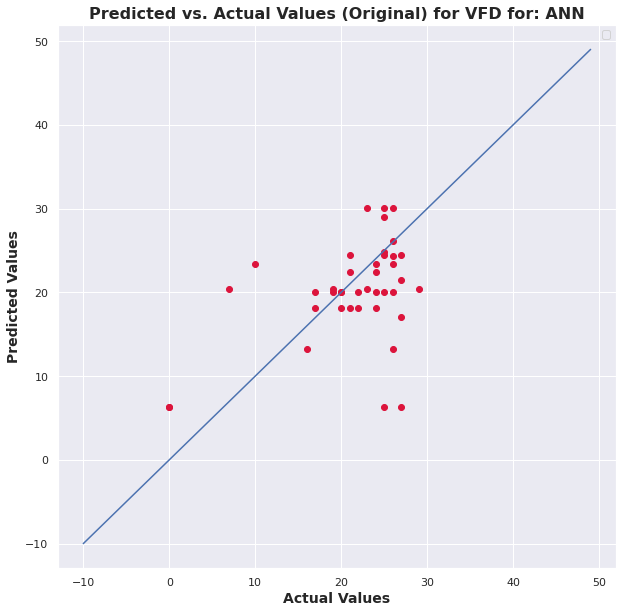

<ipython-input-546-1259e5c3eb40>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
r_index: 100%|##########| 8/8 [00:00<00:00, 520.51it/s]

6


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


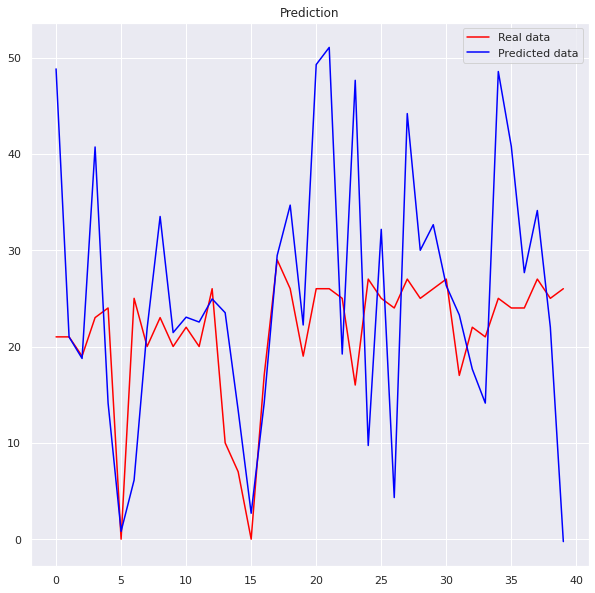

No handles with labels found to put in legend.


MSE: 			170.8529632816826
R-Squared Score: 	nan


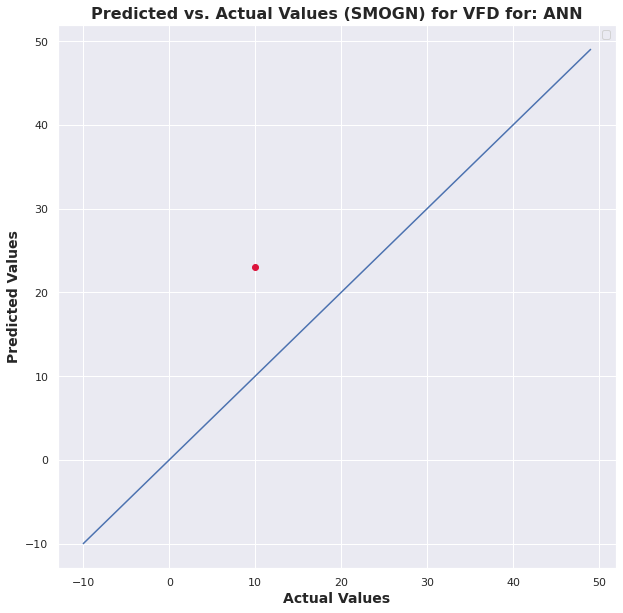

No handles with labels found to put in legend.


MSE: 			174.99125806848176
R-Squared Score: 	-2.9775825447794584


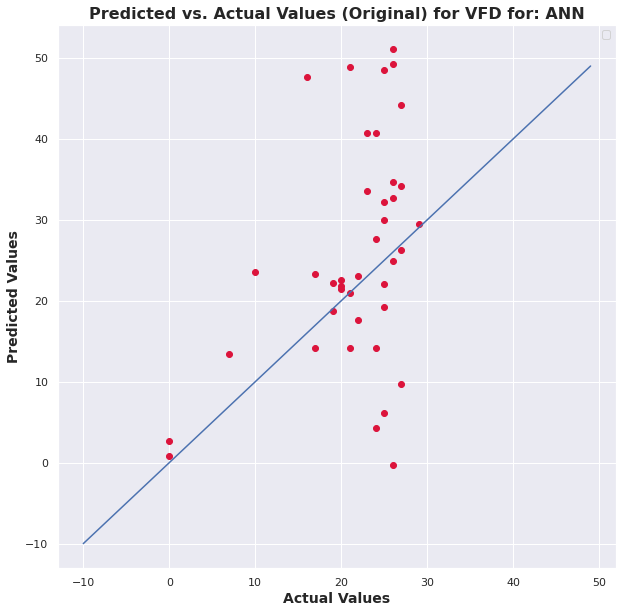

<ipython-input-546-1259e5c3eb40>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
r_index: 100%|##########| 8/8 [00:00<00:00, 525.52it/s]

7


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


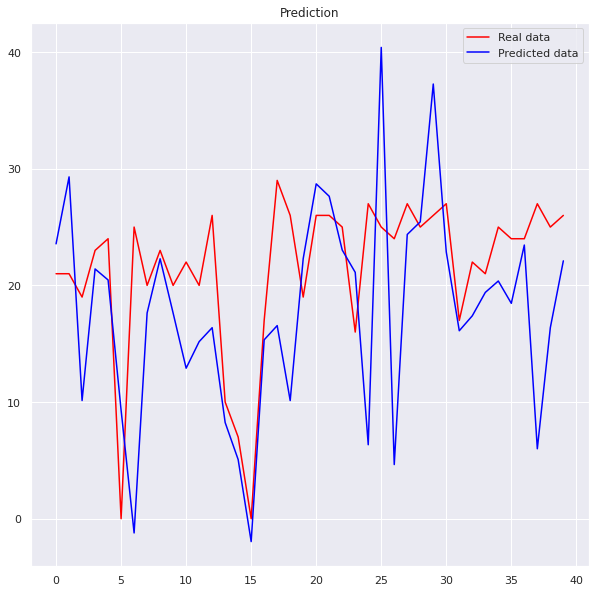

No handles with labels found to put in legend.


MSE: 			4.553792441257428
R-Squared Score: 	nan


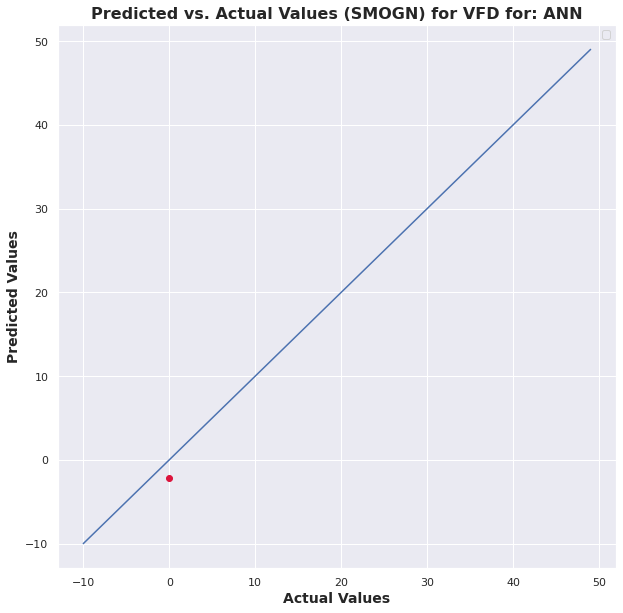

No handles with labels found to put in legend.


MSE: 			85.56937562511541
R-Squared Score: 	-0.9450071884215976


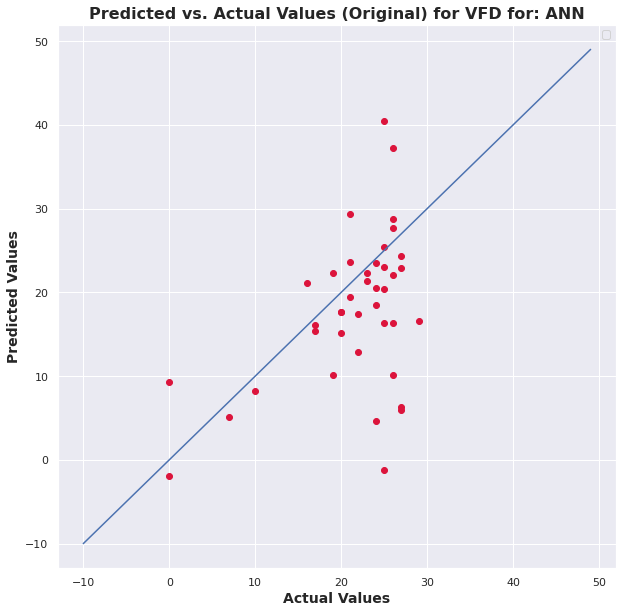

<ipython-input-546-1259e5c3eb40>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
r_index: 100%|##########| 8/8 [00:00<00:00, 505.72it/s]

8


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


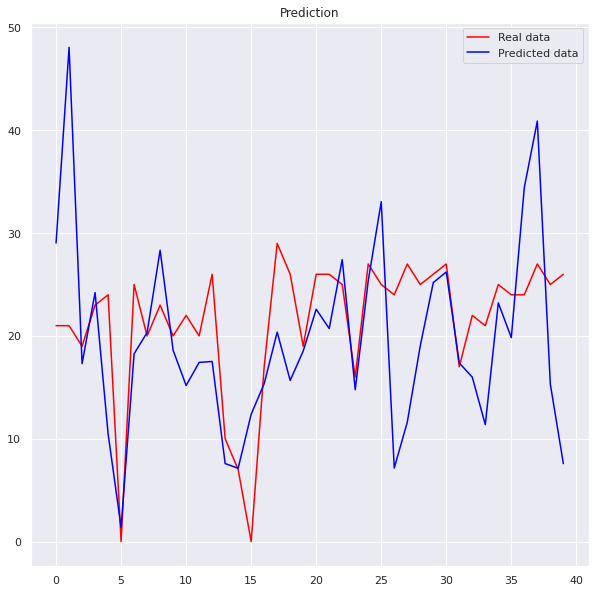

No handles with labels found to put in legend.


MSE: 			316.5838997335086
R-Squared Score: 	nan


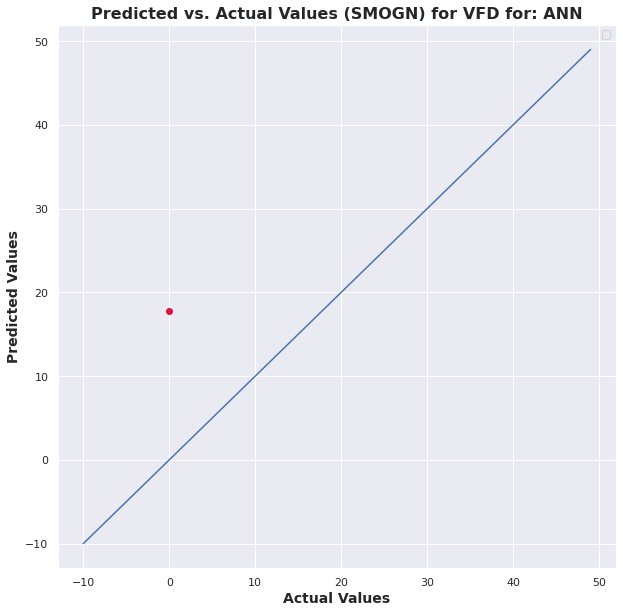

No handles with labels found to put in legend.


MSE: 			77.17877284767535
R-Squared Score: 	-0.7542872889471746


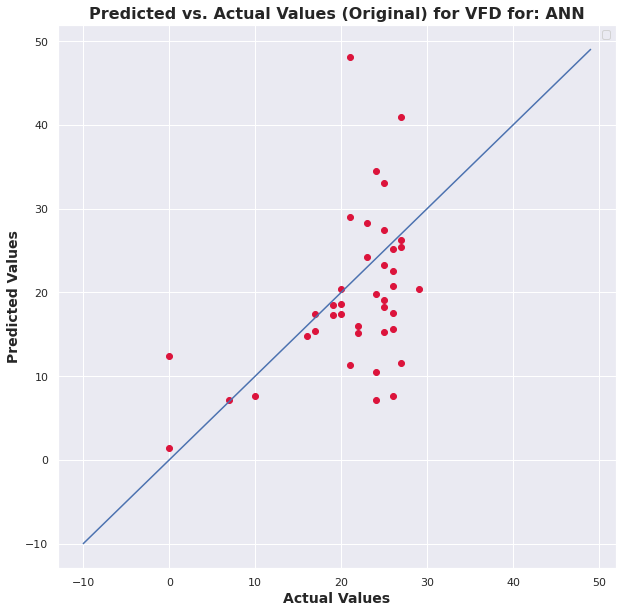

<ipython-input-546-1259e5c3eb40>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
r_index: 100%|##########| 8/8 [00:00<00:00, 462.67it/s]

9


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


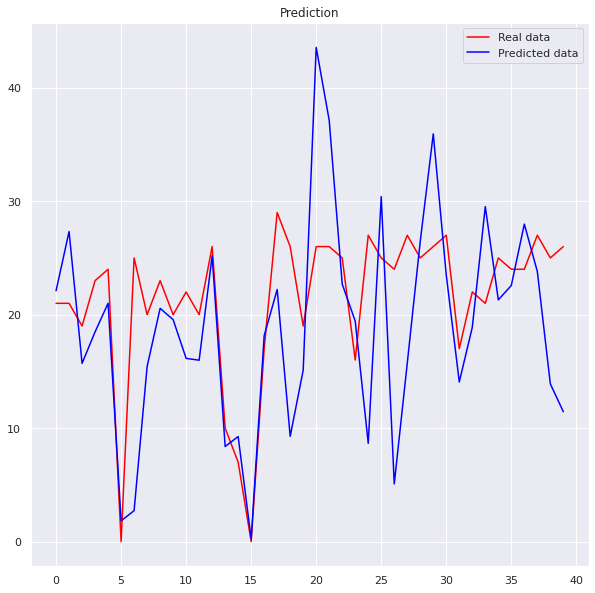

No handles with labels found to put in legend.


MSE: 			31.986928647620516
R-Squared Score: 	nan


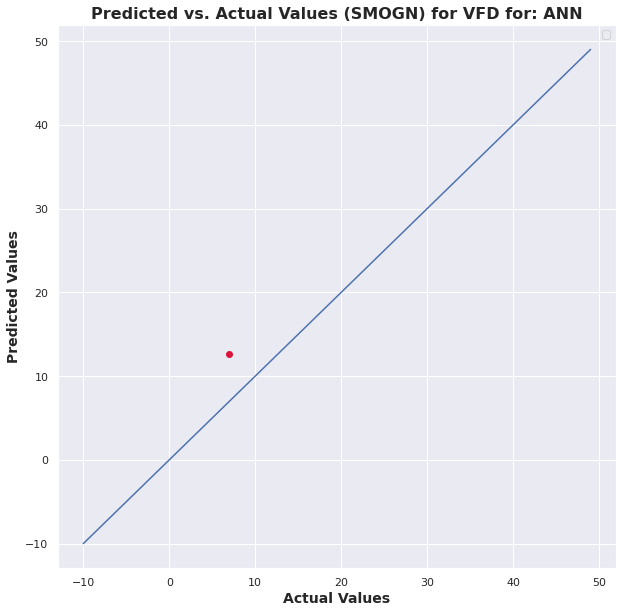

No handles with labels found to put in legend.


MSE: 			72.24700647212333
R-Squared Score: 	-0.6421873585457989


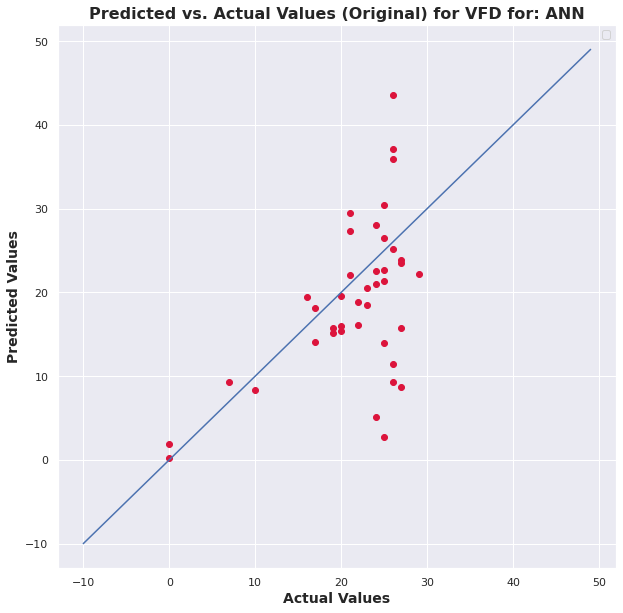

<ipython-input-546-1259e5c3eb40>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
r_index: 100%|##########| 8/8 [00:00<00:00, 436.29it/s]

10


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


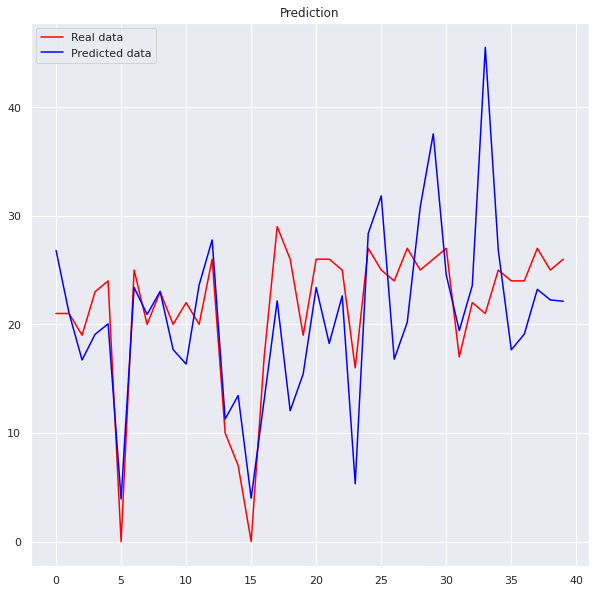

No handles with labels found to put in legend.


MSE: 			28.937074958435005
R-Squared Score: 	nan


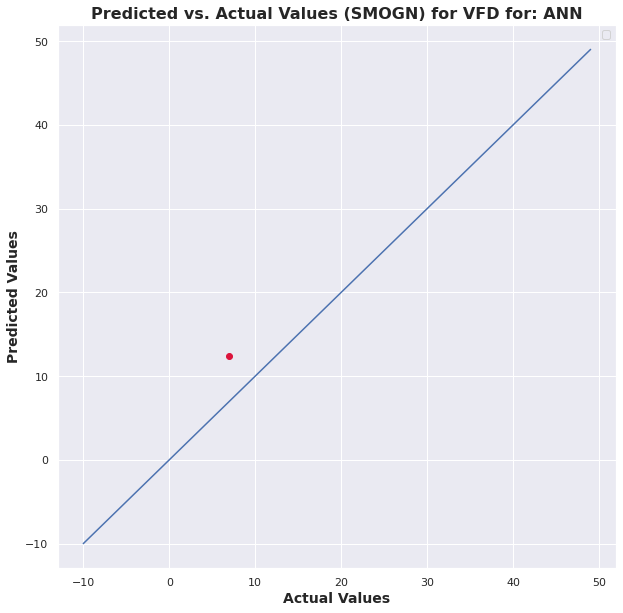

No handles with labels found to put in legend.


MSE: 			42.266950573765875
R-Squared Score: 	0.03926466568133136


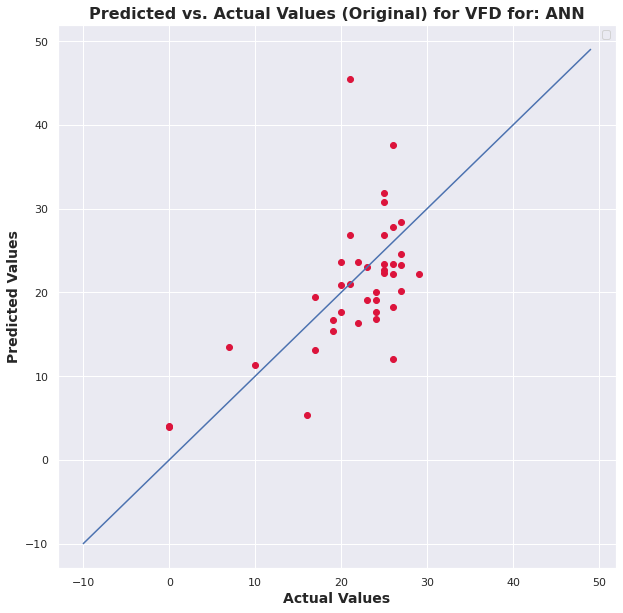

<ipython-input-546-1259e5c3eb40>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
r_index: 100%|##########| 8/8 [00:00<00:00, 368.61it/s]

11


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


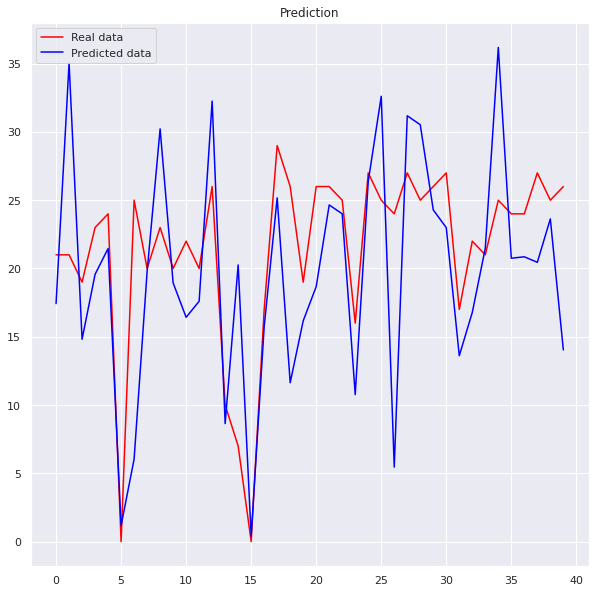

No handles with labels found to put in legend.


MSE: 			278.4829052437599
R-Squared Score: 	nan


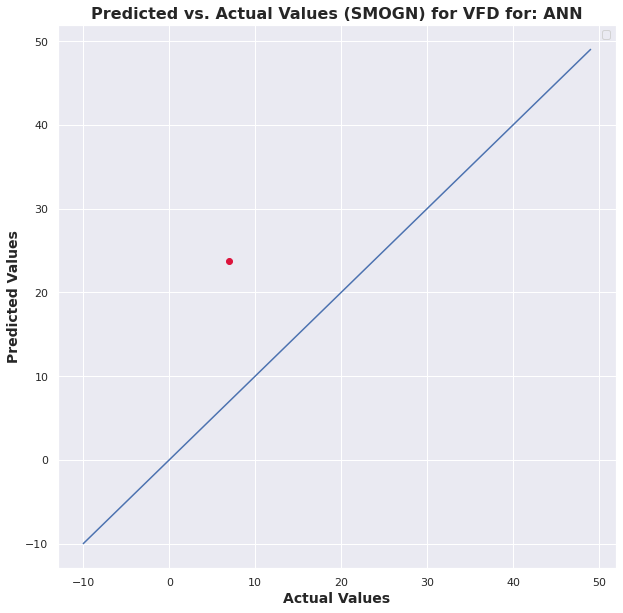

No handles with labels found to put in legend.


MSE: 			51.75026576179101
R-Squared Score: 	-0.17629278201567855


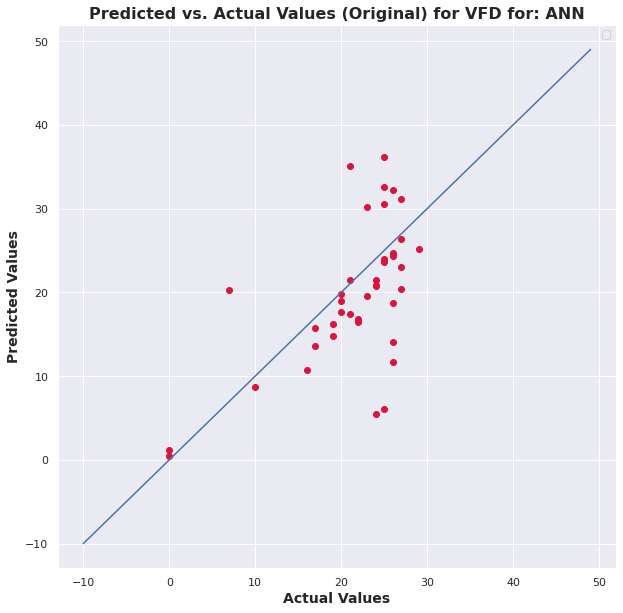

<ipython-input-546-1259e5c3eb40>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
r_index: 100%|##########| 8/8 [00:00<00:00, 318.12it/s]

12


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


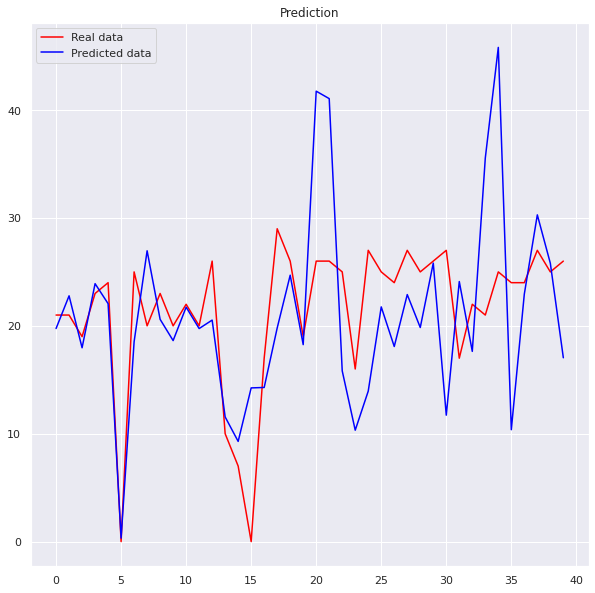

No handles with labels found to put in legend.


MSE: 			348.56705112092095
R-Squared Score: 	nan


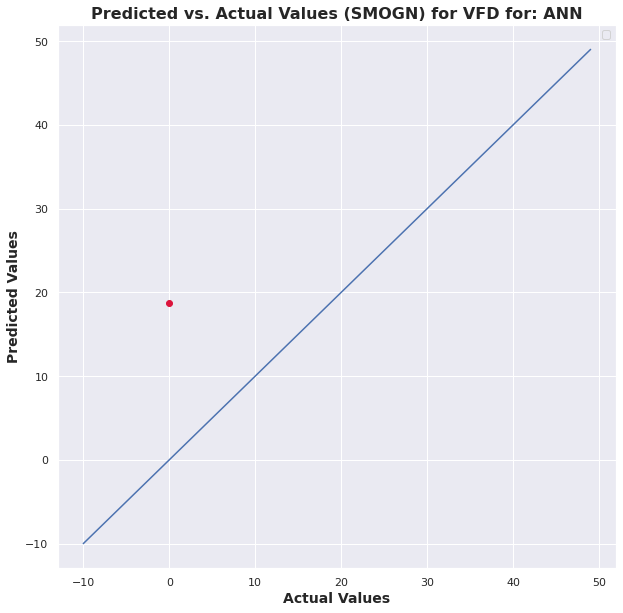

No handles with labels found to put in legend.


MSE: 			63.01512062357487
R-Squared Score: 	-0.43234494463382833


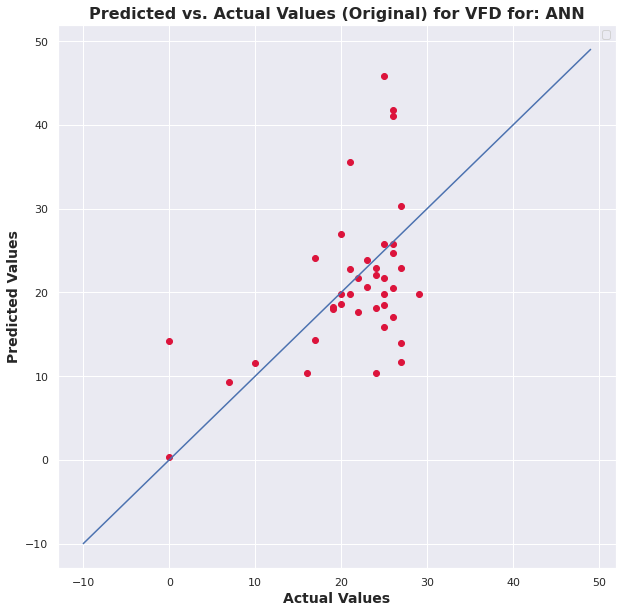

<ipython-input-546-1259e5c3eb40>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
r_index: 100%|##########| 8/8 [00:00<00:00, 292.33it/s]

13


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


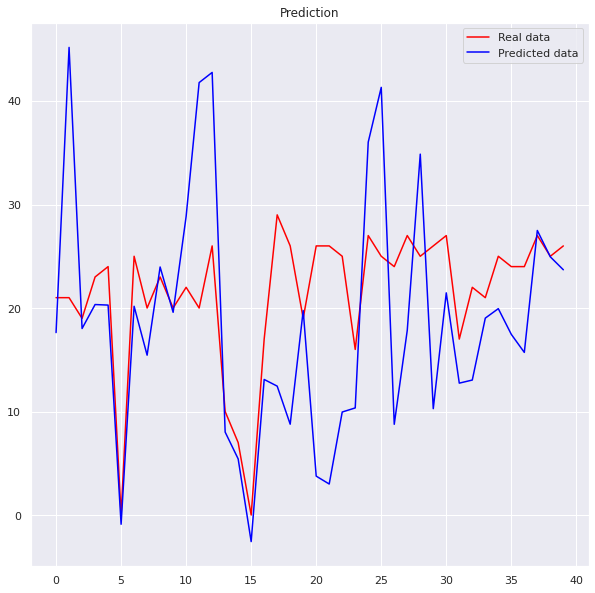

No handles with labels found to put in legend.


MSE: 			544.7935367078171
R-Squared Score: 	nan


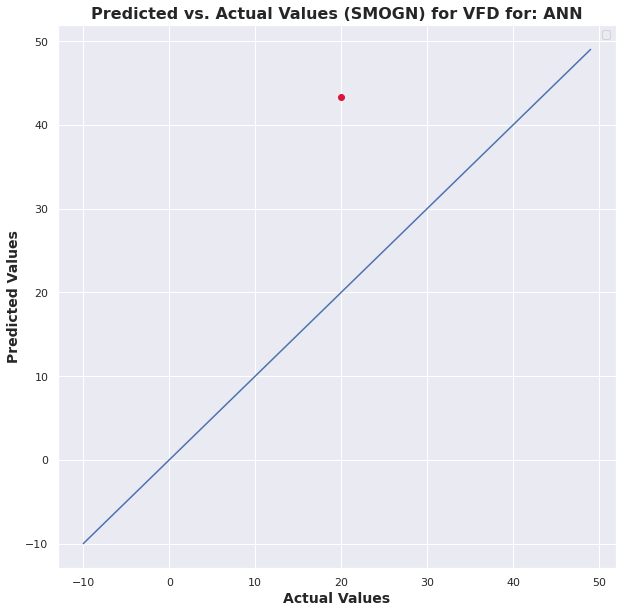

No handles with labels found to put in legend.


MSE: 			115.77506626085926
R-Squared Score: 	-1.6315879305220102


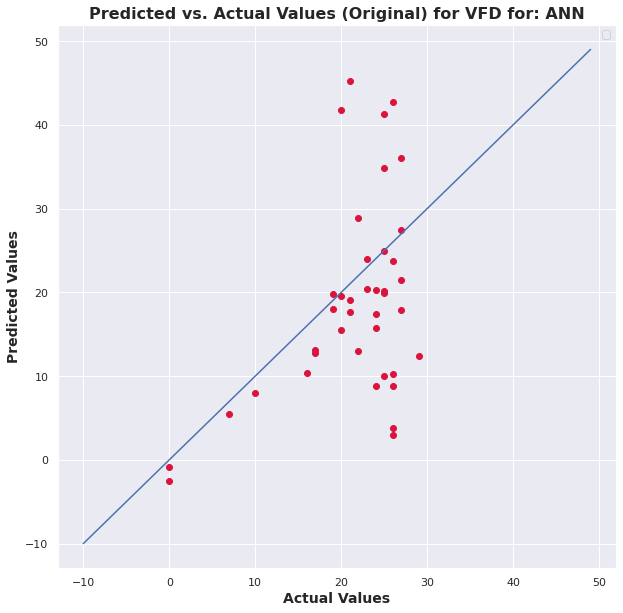

<ipython-input-546-1259e5c3eb40>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
r_index:   0%|          | 0/8 [00:00<?, ?it/s]

14


r_index: 100%|##########| 8/8 [00:00<00:00, 251.77it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


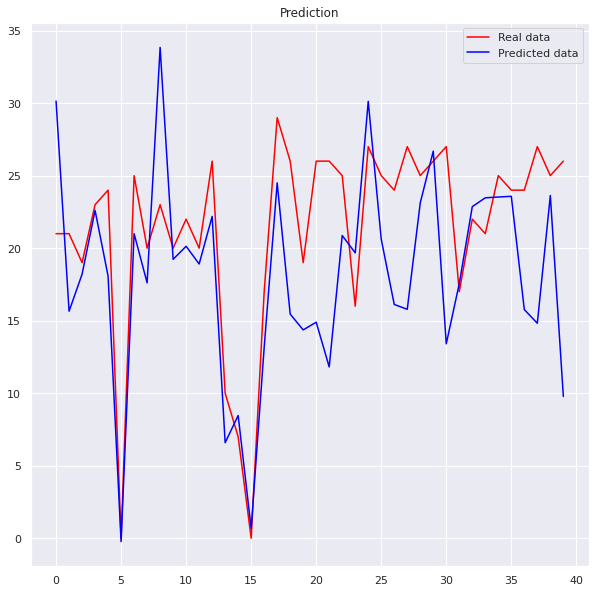

No handles with labels found to put in legend.


MSE: 			4.1061485186364735
R-Squared Score: 	nan


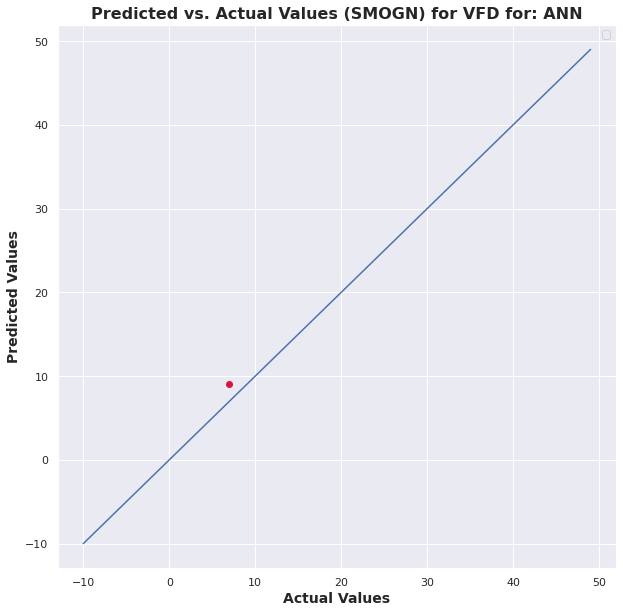

No handles with labels found to put in legend.


MSE: 			43.506091287852996
R-Squared Score: 	0.011098775971860042


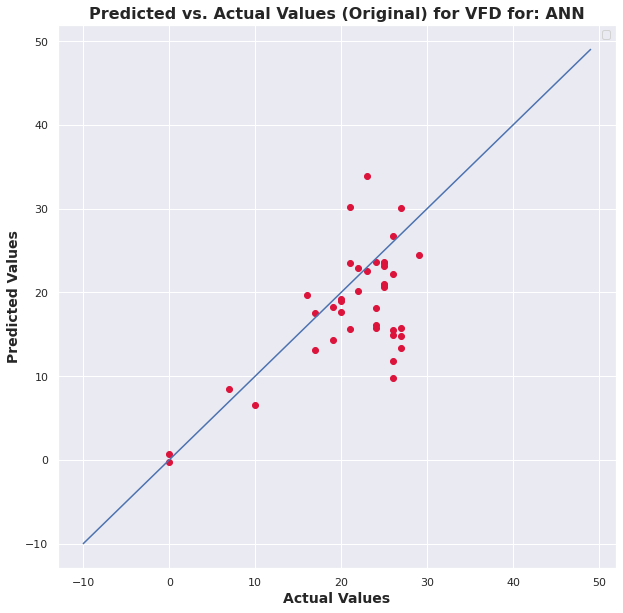

<ipython-input-546-1259e5c3eb40>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
r_index: 100%|##########| 8/8 [00:00<00:00, 298.90it/s]

15


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


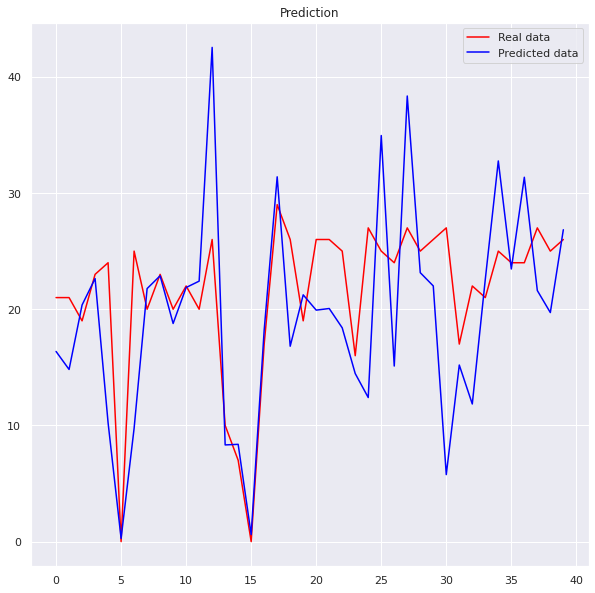

No handles with labels found to put in legend.


MSE: 			0.9810382439982277
R-Squared Score: 	nan


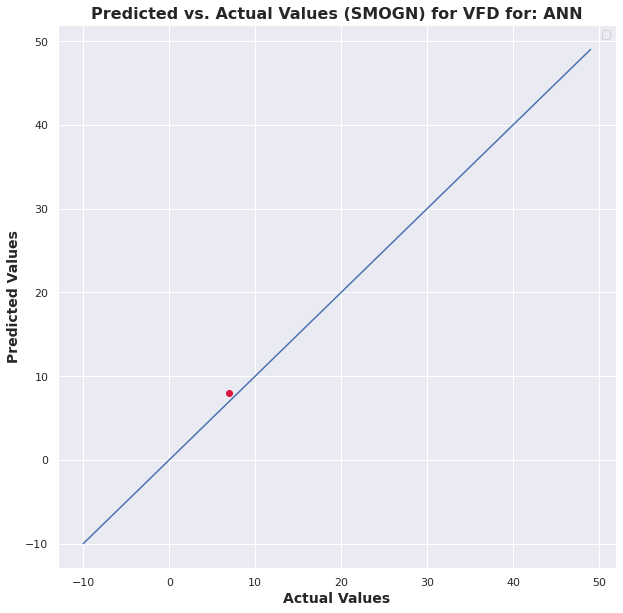

No handles with labels found to put in legend.


MSE: 			56.488817946371704
R-Squared Score: 	-0.28400091935325156


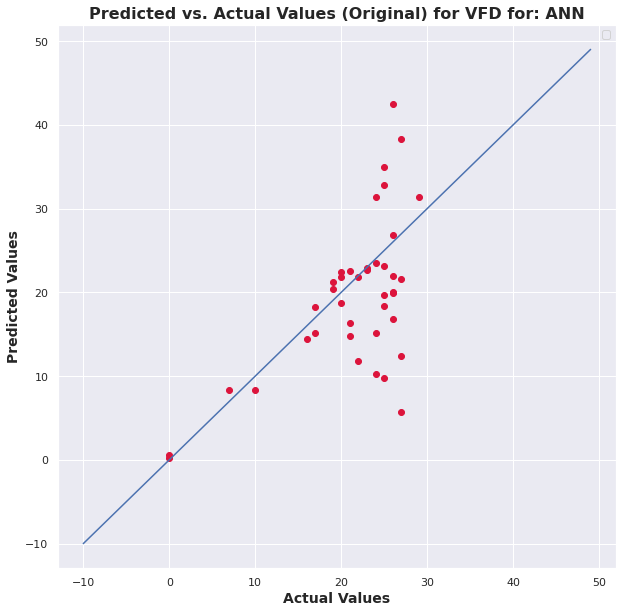

<ipython-input-546-1259e5c3eb40>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
r_index: 100%|##########| 8/8 [00:00<00:00, 307.63it/s]

16


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


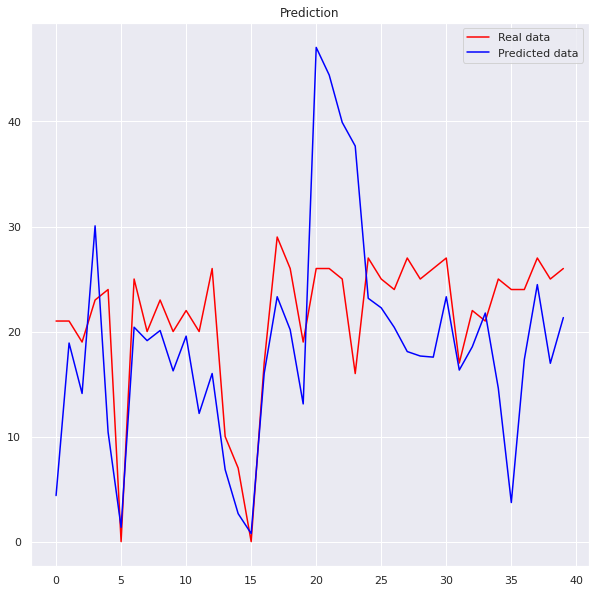

No handles with labels found to put in legend.


MSE: 			31.713284793179128
R-Squared Score: 	nan


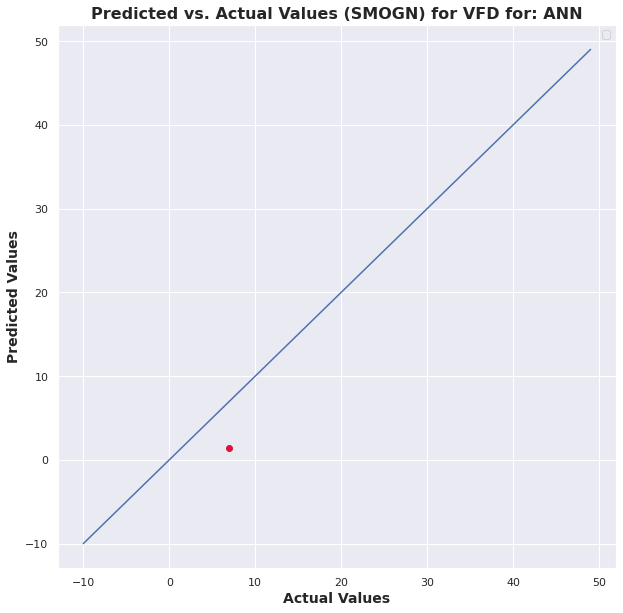

No handles with labels found to put in legend.


MSE: 			81.9913958489489
R-Squared Score: 	-0.8636790691752958


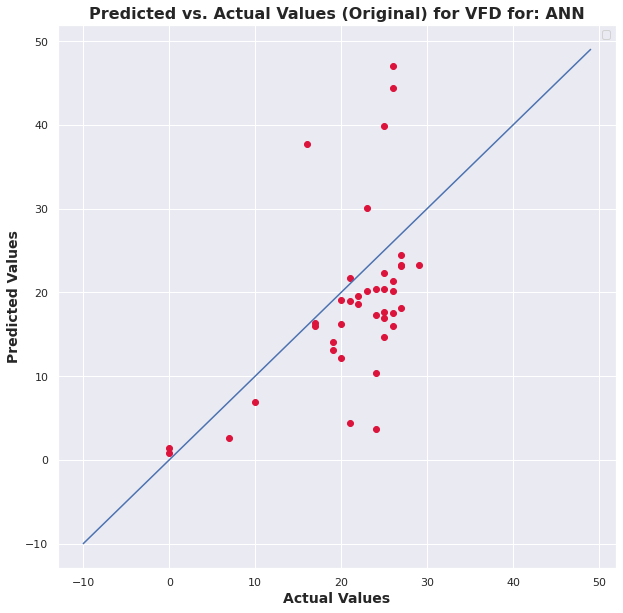

<ipython-input-546-1259e5c3eb40>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
r_index:   0%|          | 0/8 [00:00<?, ?it/s]

17


r_index: 100%|##########| 8/8 [00:00<00:00, 266.47it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


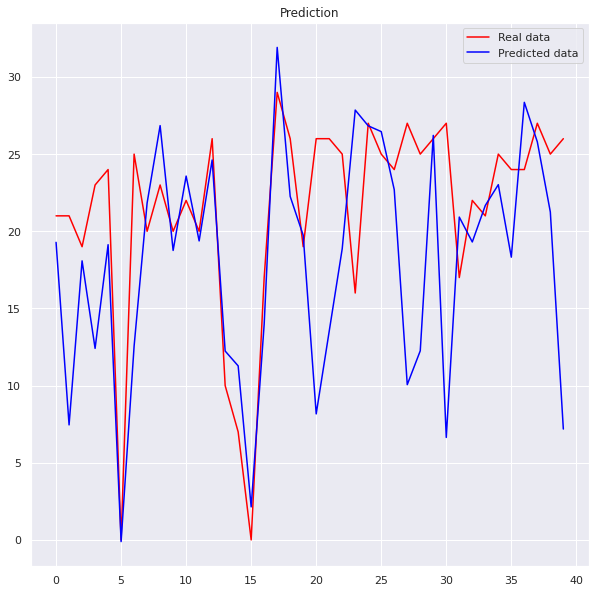

No handles with labels found to put in legend.


MSE: 			0.12867820287851828
R-Squared Score: 	nan


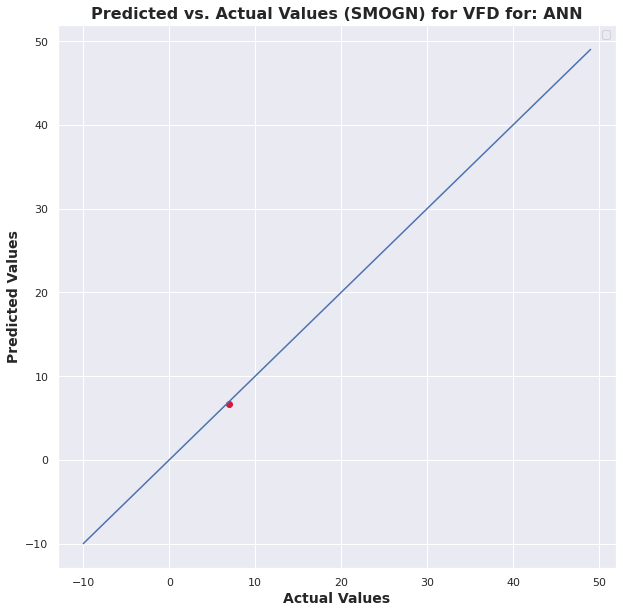

No handles with labels found to put in legend.


MSE: 			63.24751160999754
R-Squared Score: 	-0.4376272332541953


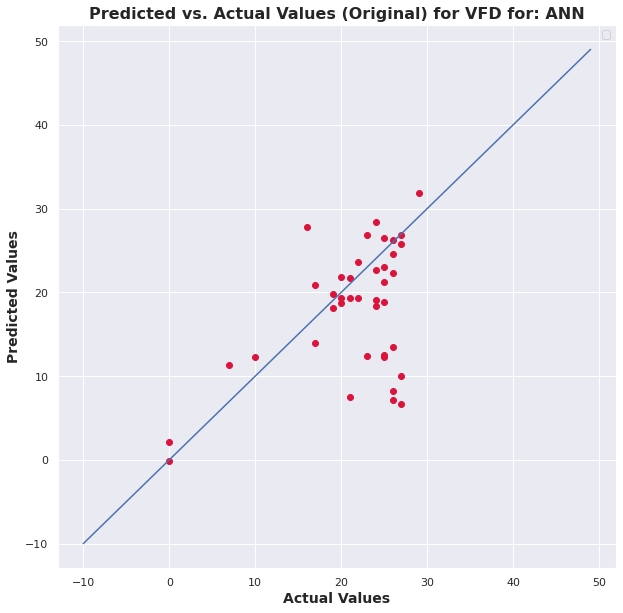

<ipython-input-546-1259e5c3eb40>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix: 100%|##########| 12/12 [00:00<00:00, 136.75it/s]

18



r_index: 100%|##########| 8/8 [00:00<00:00, 277.44it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


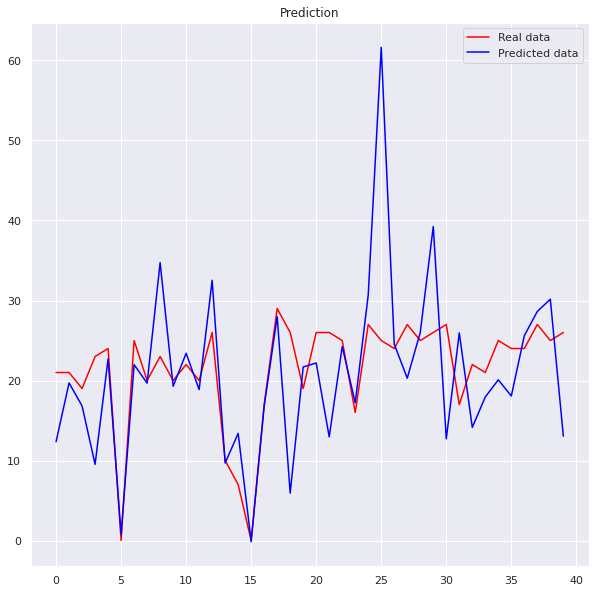

No handles with labels found to put in legend.


MSE: 			65.25887694921403
R-Squared Score: 	nan


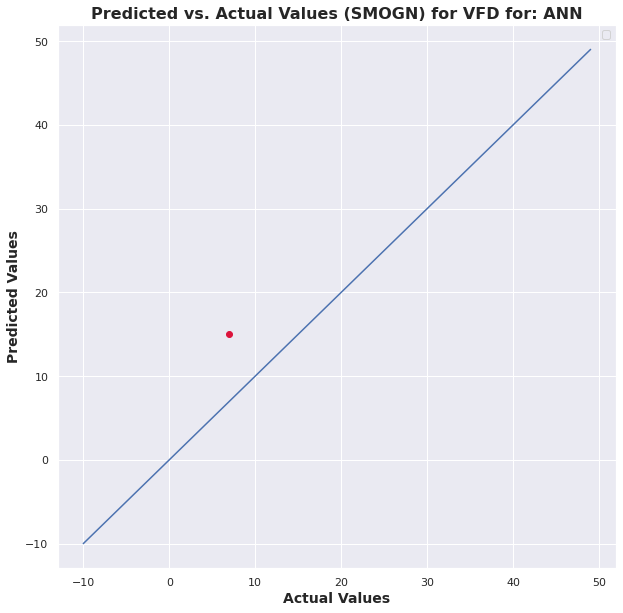

No handles with labels found to put in legend.


MSE: 			82.19190031910466
R-Squared Score: 	-0.8682365715868146


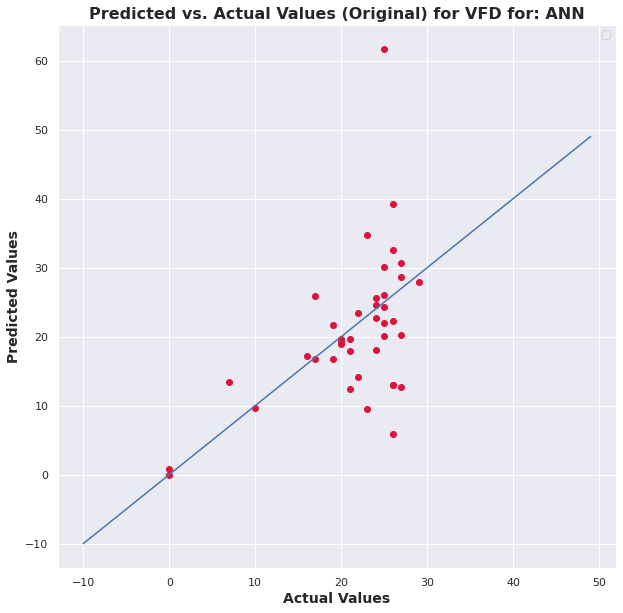

<ipython-input-546-1259e5c3eb40>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
r_index:   0%|          | 0/8 [00:00<?, ?it/s]

19


r_index: 100%|##########| 8/8 [00:00<00:00, 233.50it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


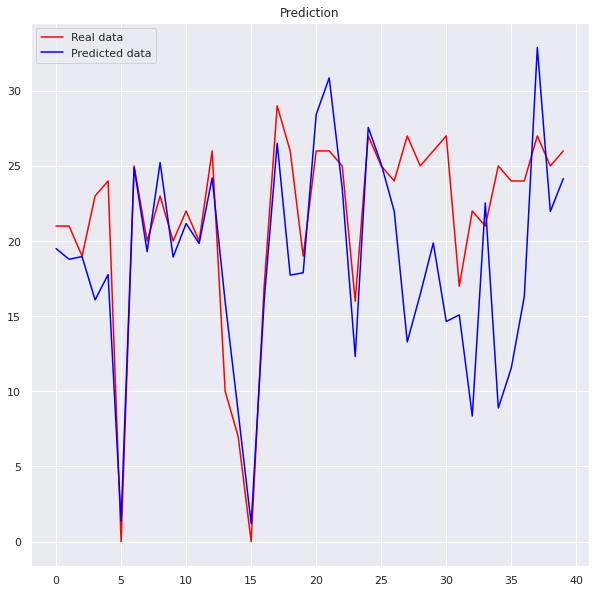

No handles with labels found to put in legend.


MSE: 			32.47663765043035
R-Squared Score: 	nan


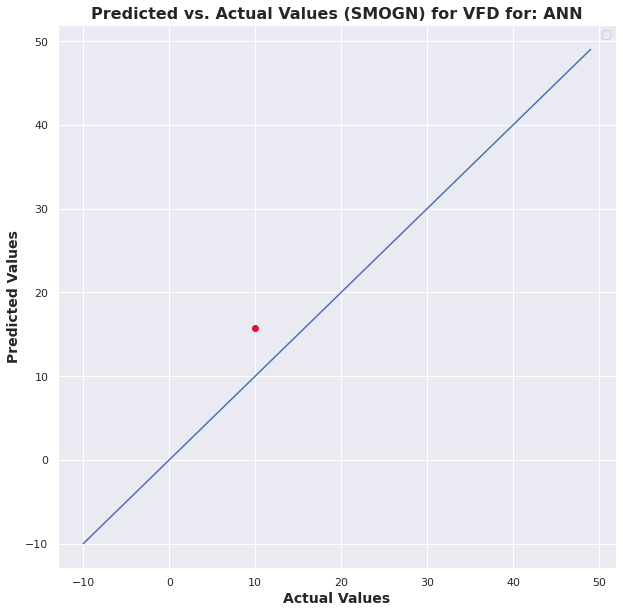

No handles with labels found to put in legend.


MSE: 			35.90071083199798
R-Squared Score: 	0.18397043185639106


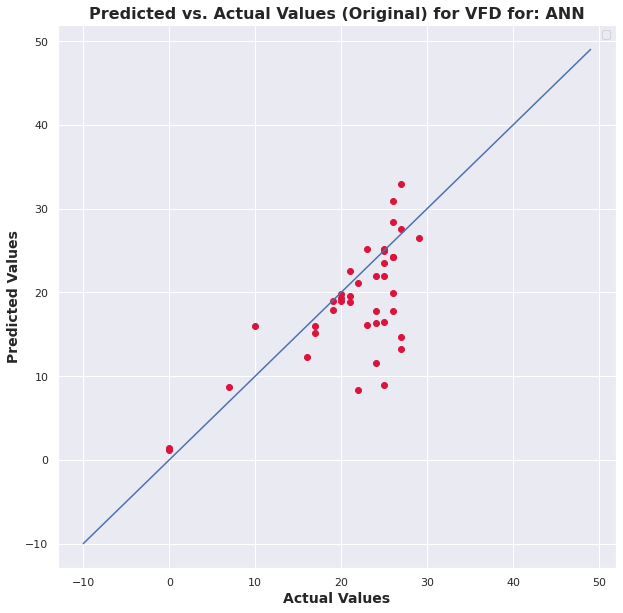

<ipython-input-546-1259e5c3eb40>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix: 100%|##########| 12/12 [00:00<00:00, 129.24it/s]

20



r_index: 100%|##########| 8/8 [00:00<00:00, 228.24it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


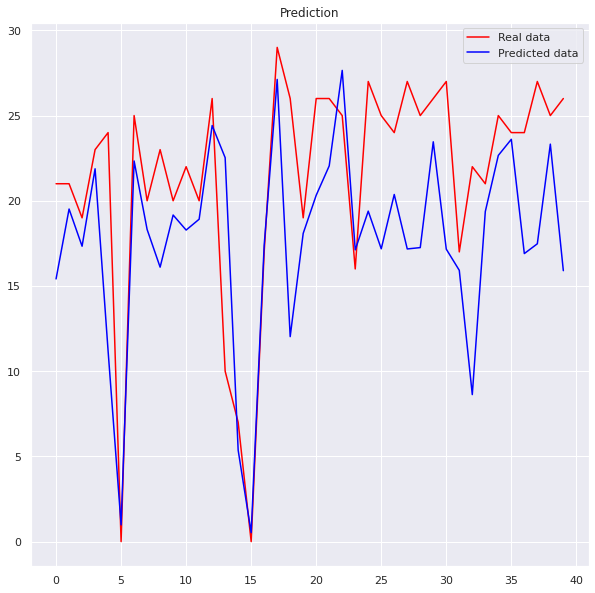

No handles with labels found to put in legend.


MSE: 			237.3608257301712
R-Squared Score: 	nan


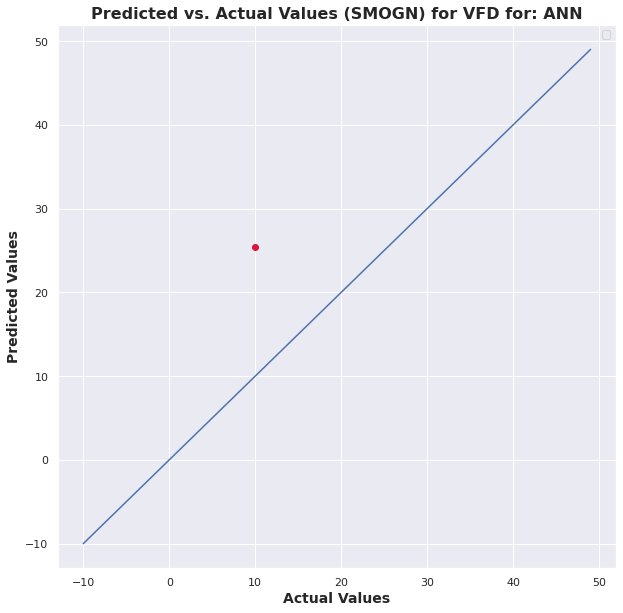

No handles with labels found to put in legend.


MSE: 			38.00810943202539
R-Squared Score: 	0.13606888535124328


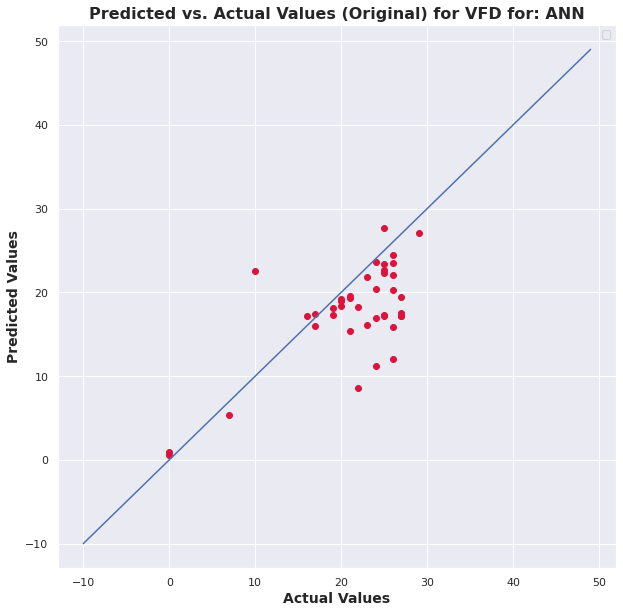

<ipython-input-546-1259e5c3eb40>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
r_index: 100%|##########| 8/8 [00:00<00:00, 203.42it/s]

21


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


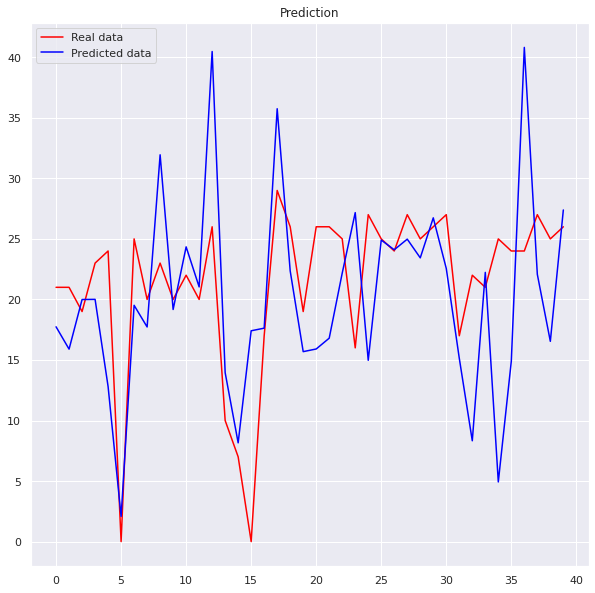

No handles with labels found to put in legend.


MSE: 			705.6600363320322
R-Squared Score: 	nan


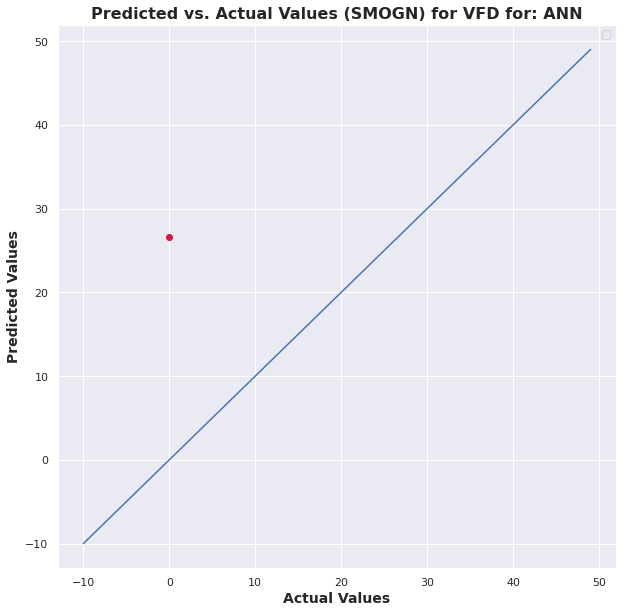

No handles with labels found to put in legend.


MSE: 			61.18363689550288
R-Squared Score: 	-0.39071499243943997


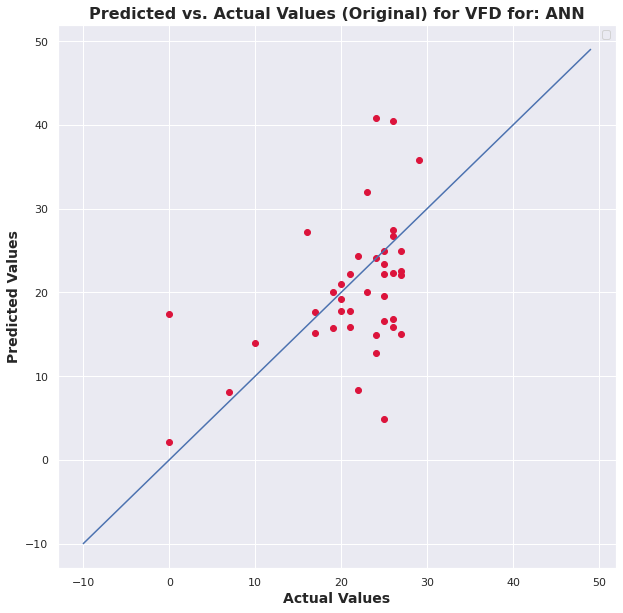

<ipython-input-546-1259e5c3eb40>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix:  92%|#########1| 11/12 [00:00<00:00, 106.20it/s]

22


r_index: 100%|##########| 8/8 [00:00<00:00, 155.49it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


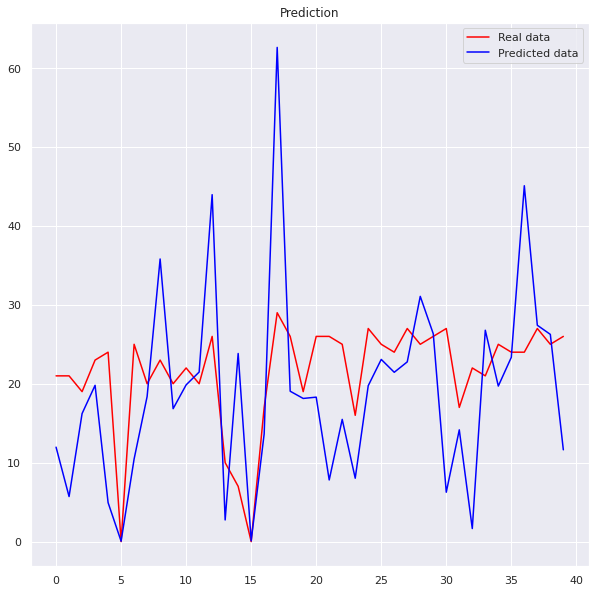

No handles with labels found to put in legend.


MSE: 			465.09737368882634
R-Squared Score: 	nan


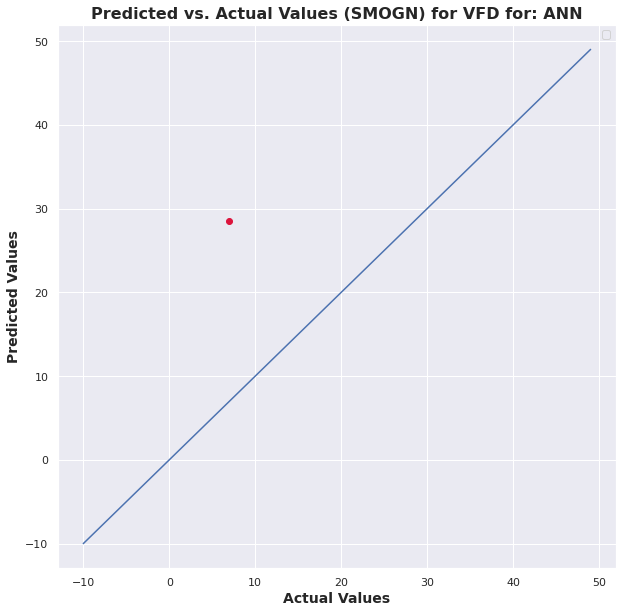

No handles with labels found to put in legend.


MSE: 			129.24184831939695
R-Squared Score: 	-1.9376902915292455


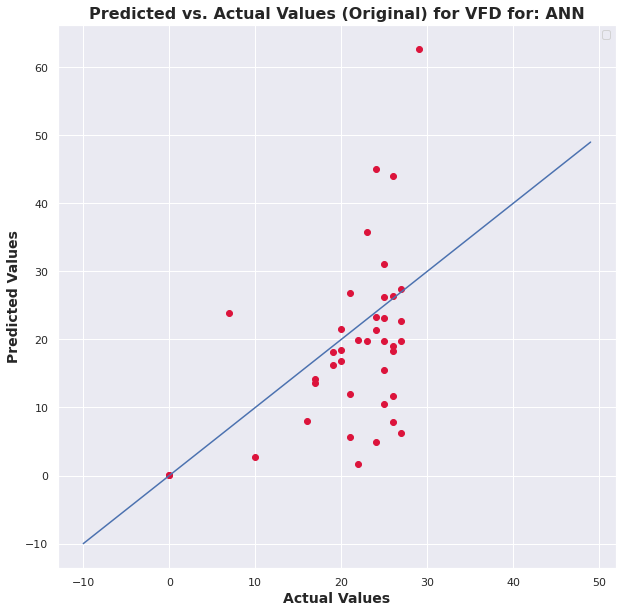

<ipython-input-546-1259e5c3eb40>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix:  92%|#########1| 11/12 [00:00<00:00, 108.10it/s]

23


r_index: 100%|##########| 8/8 [00:00<00:00, 133.23it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


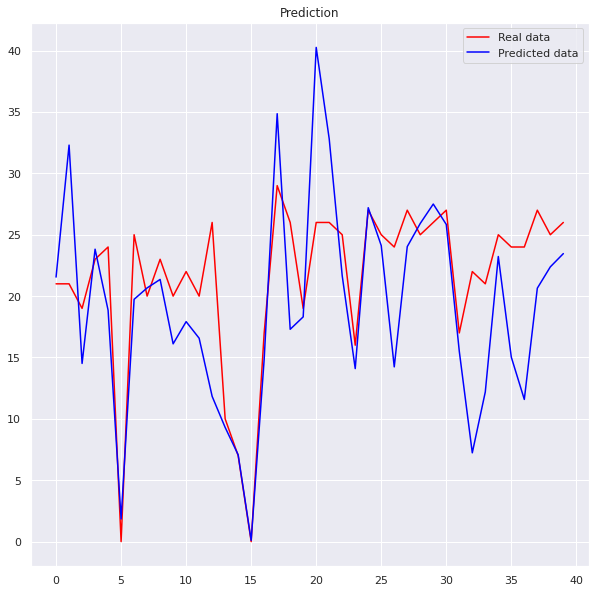

No handles with labels found to put in legend.


MSE: 			3.4268500217913243
R-Squared Score: 	nan


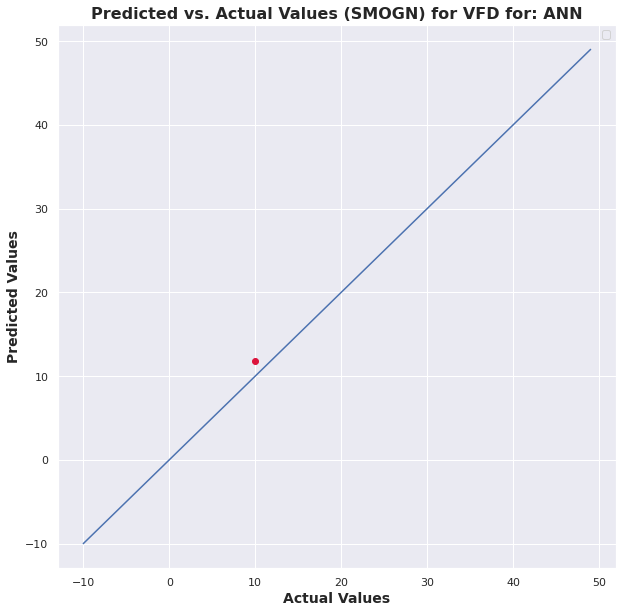

No handles with labels found to put in legend.


MSE: 			38.32545411538256
R-Squared Score: 	0.1288555840290363


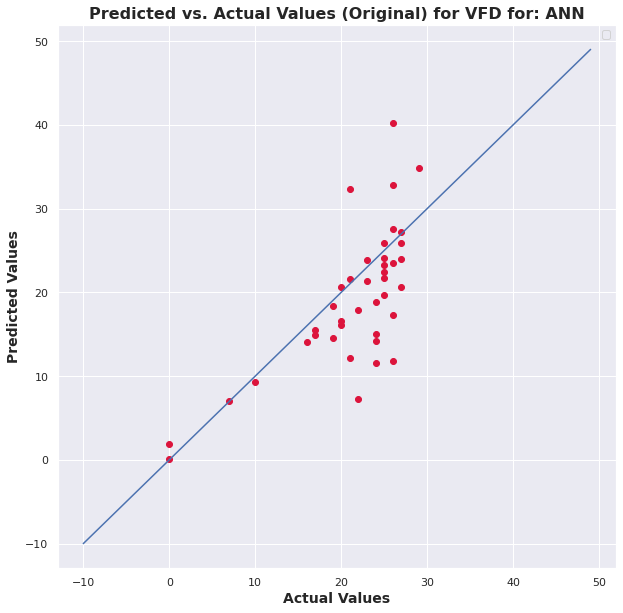

<ipython-input-546-1259e5c3eb40>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix: 100%|##########| 12/12 [00:00<00:00, 117.94it/s]

24



r_index: 100%|##########| 8/8 [00:00<00:00, 239.42it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


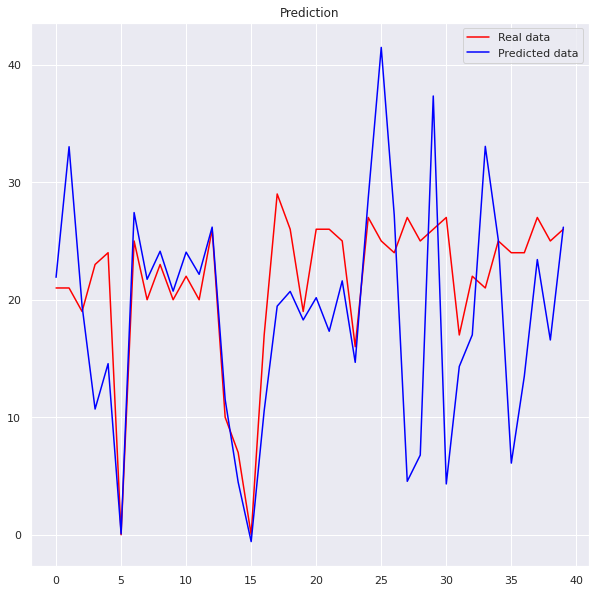

No handles with labels found to put in legend.


MSE: 			3.715902444706444
R-Squared Score: 	nan


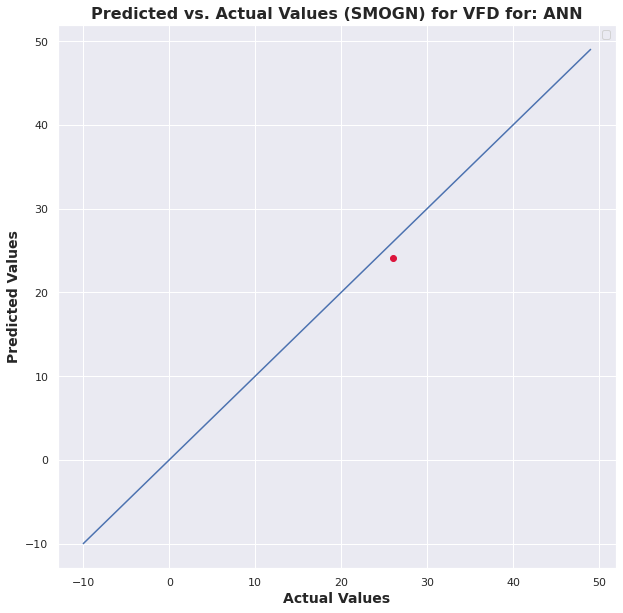

No handles with labels found to put in legend.


MSE: 			78.85506103503735
R-Squared Score: 	-0.7923896187873418


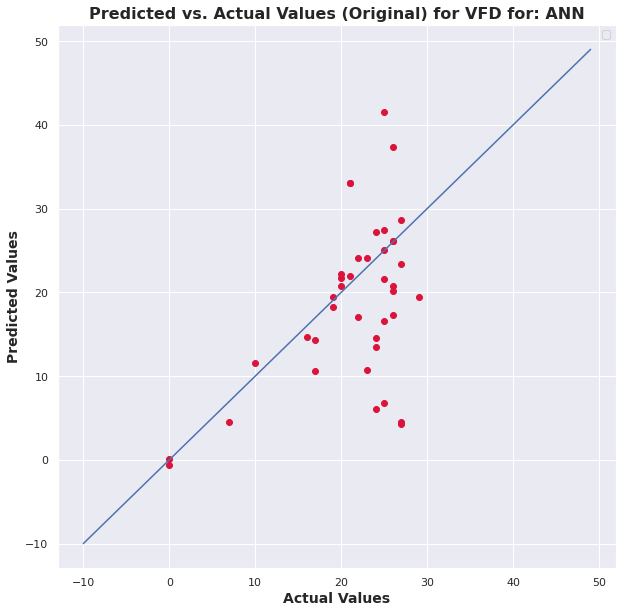

<ipython-input-546-1259e5c3eb40>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix: 100%|##########| 12/12 [00:00<00:00, 116.46it/s]

25



r_index: 100%|##########| 8/8 [00:00<00:00, 212.22it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


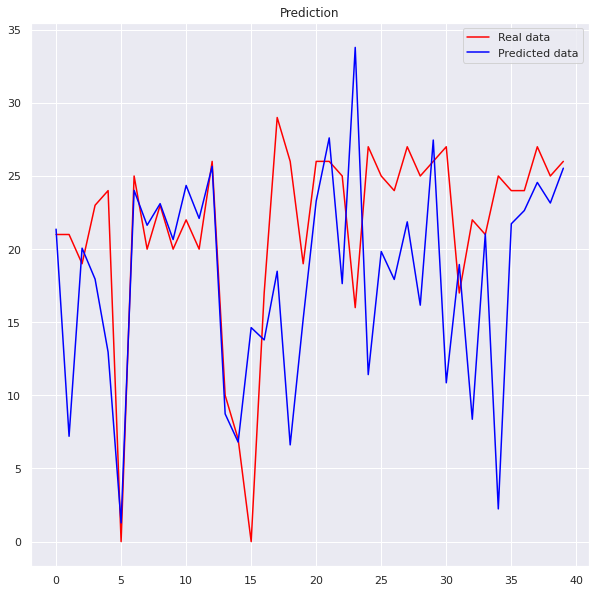

No handles with labels found to put in legend.


MSE: 			373.57508885978314
R-Squared Score: 	nan


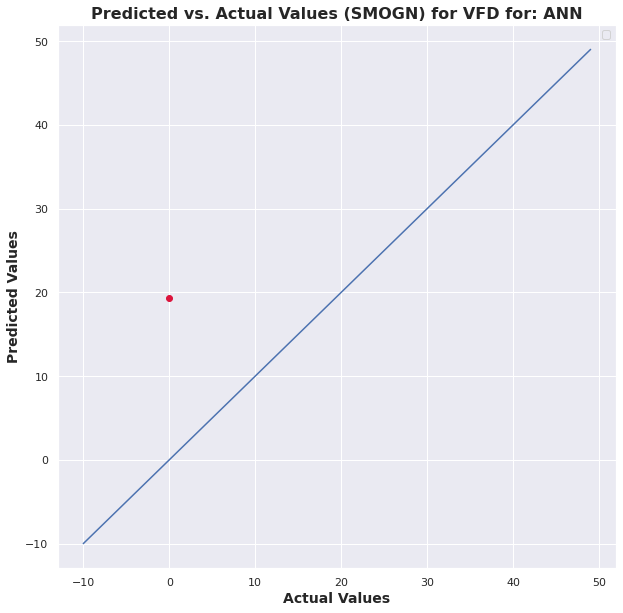

No handles with labels found to put in legend.


MSE: 			71.50046964647692
R-Squared Score: 	-0.6252184431868146


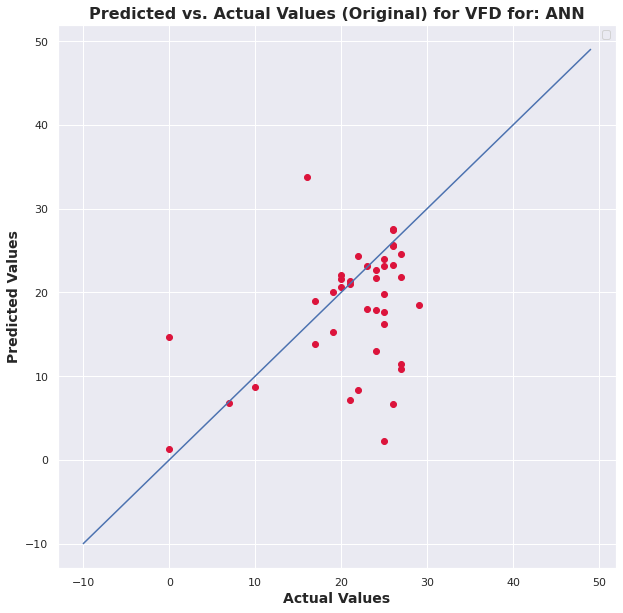

<ipython-input-546-1259e5c3eb40>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix:   0%|          | 0/12 [00:00<?, ?it/s]

26


r_index: 100%|##########| 8/8 [00:00<00:00, 162.91it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


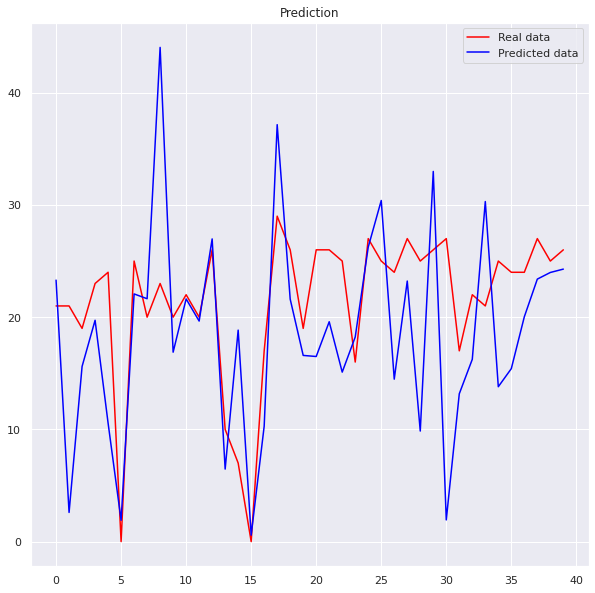

No handles with labels found to put in legend.


MSE: 			253.92688262337833
R-Squared Score: 	nan


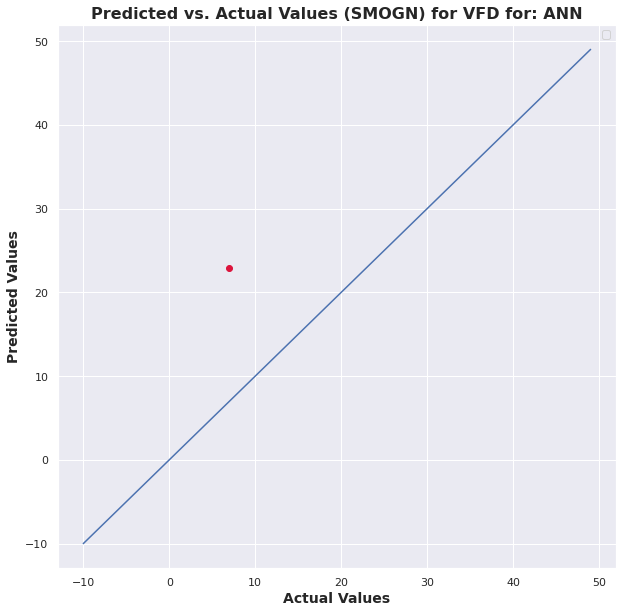

No handles with labels found to put in legend.


MSE: 			73.68339067738638
R-Squared Score: 	-0.6748366280322518


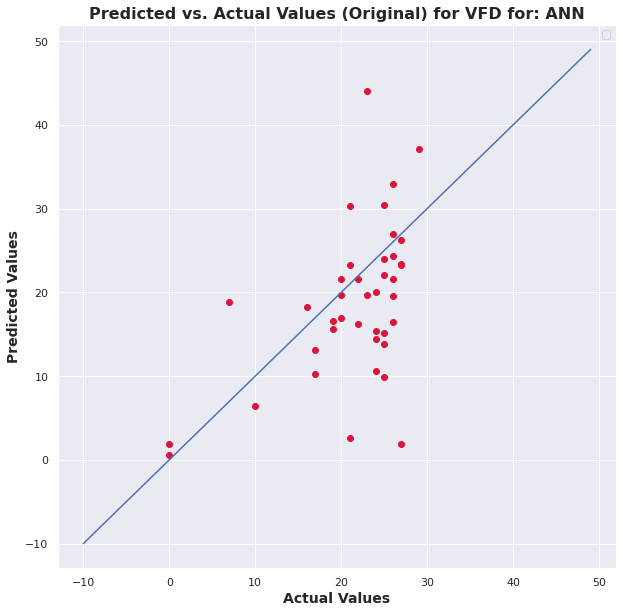

<ipython-input-546-1259e5c3eb40>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix:   0%|          | 0/12 [00:00<?, ?it/s]

27


r_index: 100%|##########| 8/8 [00:00<00:00, 134.85it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


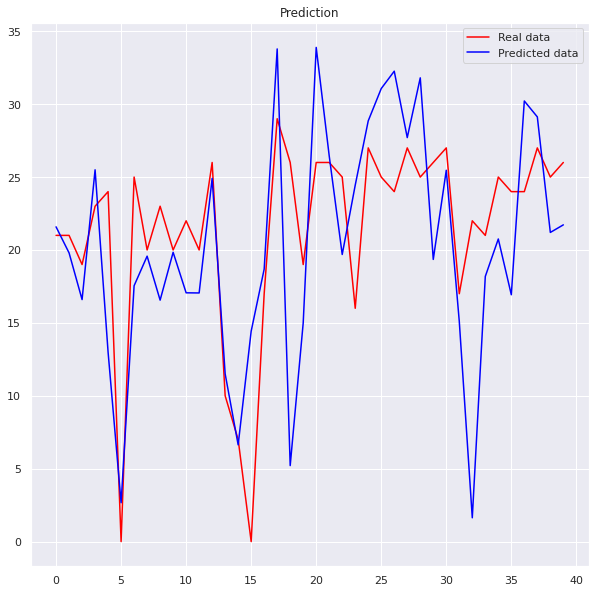

No handles with labels found to put in legend.


MSE: 			448.8909203682706
R-Squared Score: 	nan


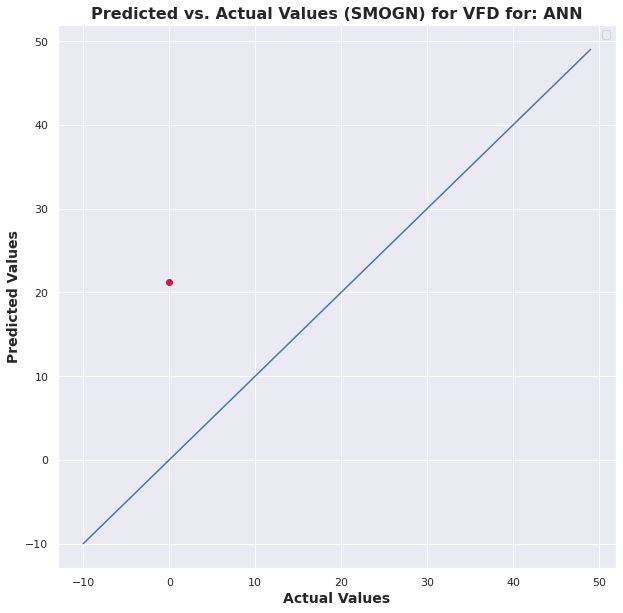

No handles with labels found to put in legend.


MSE: 			47.30845563759506
R-Squared Score: 	-0.07532964470105696


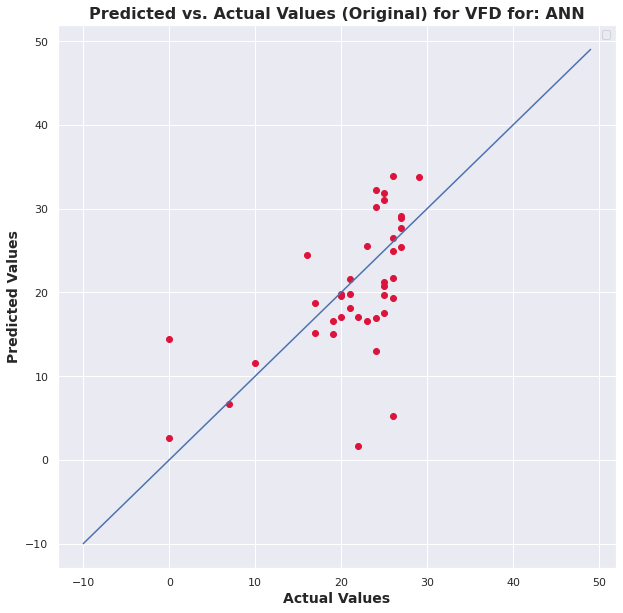

<ipython-input-546-1259e5c3eb40>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix:  92%|#########1| 11/12 [00:00<00:00, 109.25it/s]

28


r_index: 100%|##########| 8/8 [00:00<00:00, 138.24it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


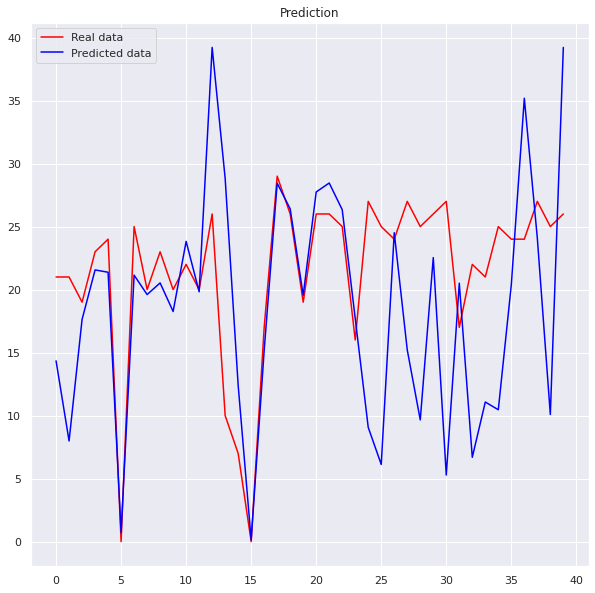

No handles with labels found to put in legend.


MSE: 			383.6953224875615
R-Squared Score: 	nan


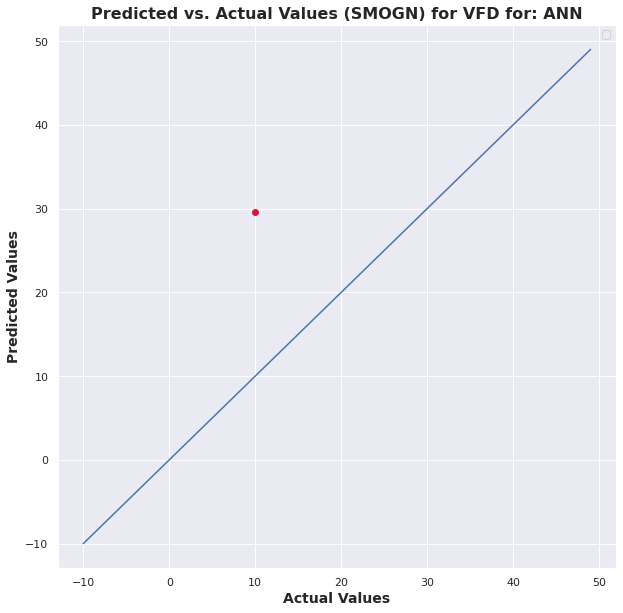

MSE: 			86.64737787443978
R-Squared Score: 	-0.9695103720518767


No handles with labels found to put in legend.


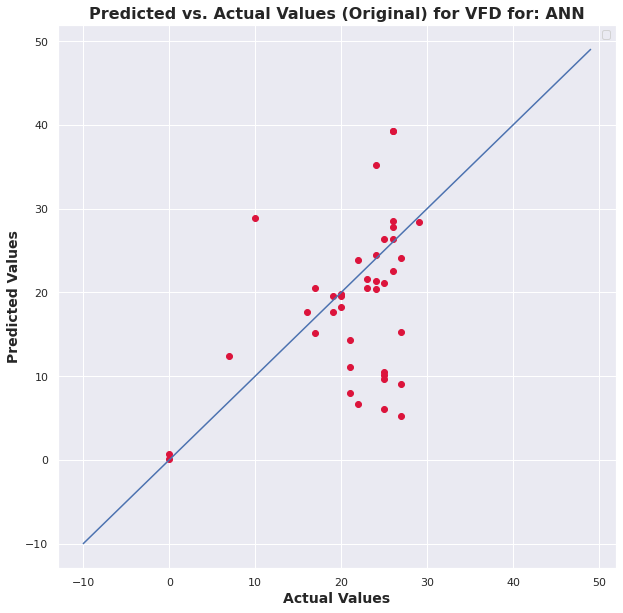

<ipython-input-546-1259e5c3eb40>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix:  92%|#########1| 11/12 [00:00<00:00, 107.69it/s]

29


r_index: 100%|##########| 8/8 [00:00<00:00, 129.95it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


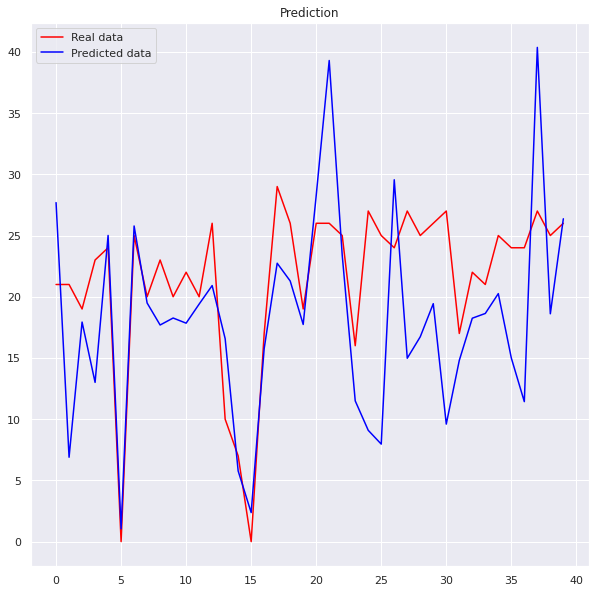

No handles with labels found to put in legend.


MSE: 			396.76962532717516
R-Squared Score: 	nan


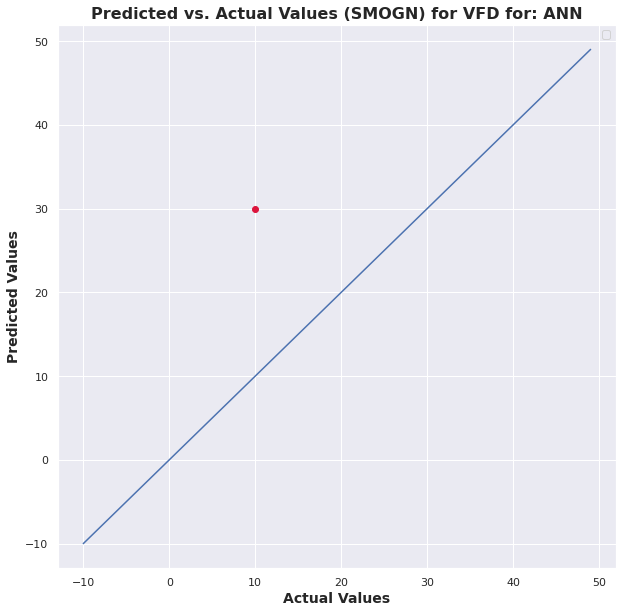

No handles with labels found to put in legend.


MSE: 			61.22194596497693
R-Squared Score: 	-0.3915857644295875


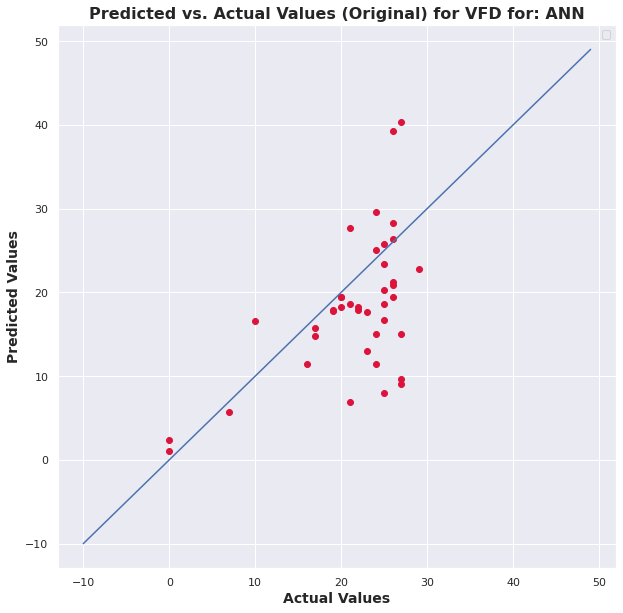

<ipython-input-546-1259e5c3eb40>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix:  83%|########3 | 10/12 [00:00<00:00, 99.57it/s]

30


r_index: 100%|##########| 8/8 [00:00<00:00, 106.07it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


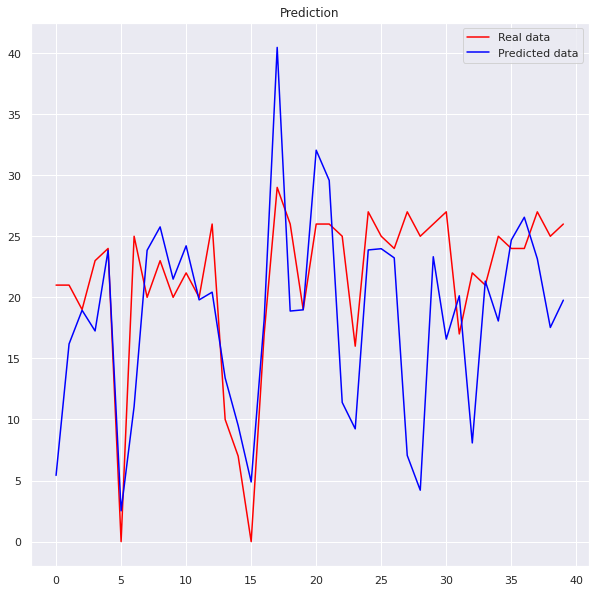

No handles with labels found to put in legend.


MSE: 			8.439433476240993
R-Squared Score: 	nan


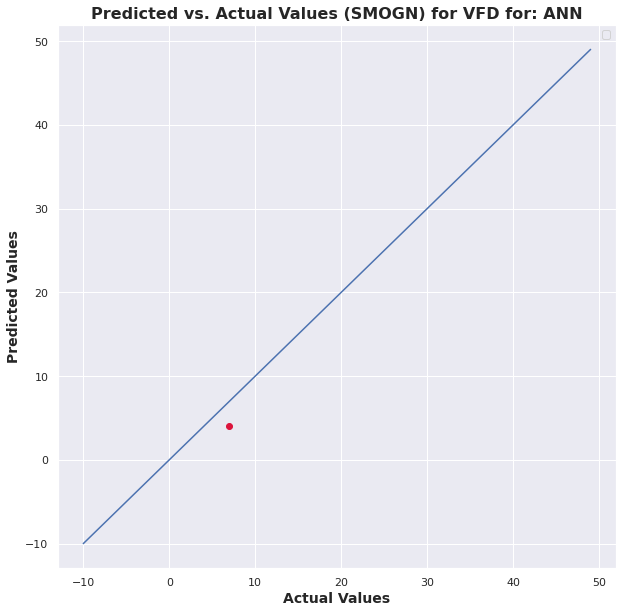

No handles with labels found to put in legend.


MSE: 			59.790843063362864
R-Squared Score: 	-0.35905653991817976


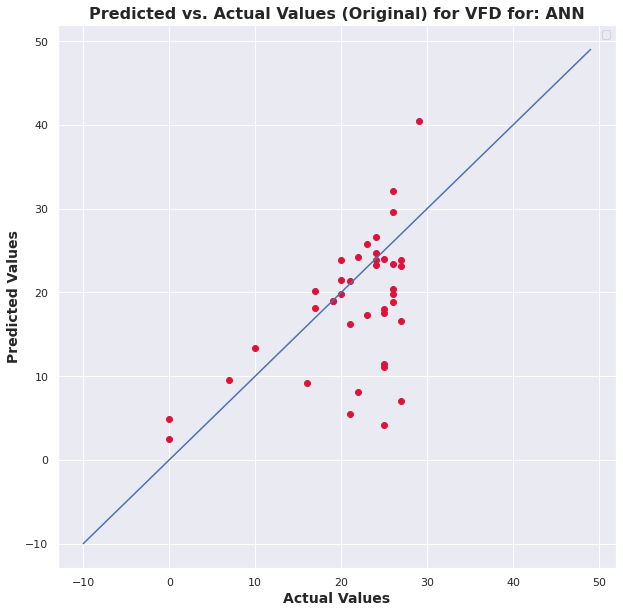

<ipython-input-546-1259e5c3eb40>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix:   0%|          | 0/12 [00:00<?, ?it/s]

31


r_index: 100%|##########| 8/8 [00:00<00:00, 125.45it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


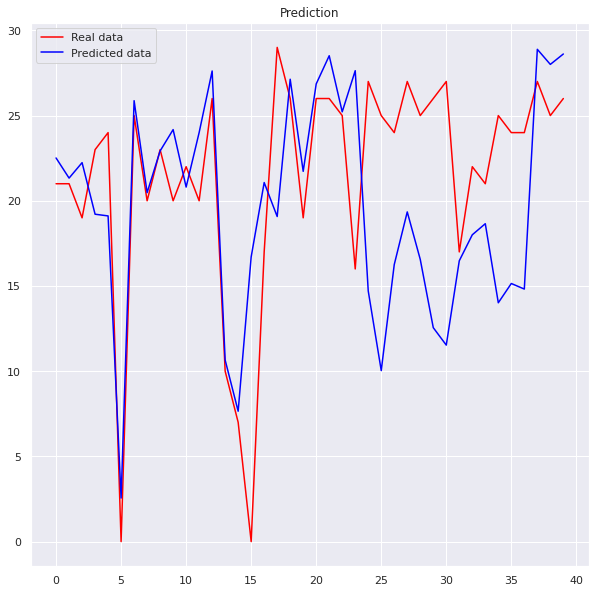

No handles with labels found to put in legend.


MSE: 			277.74596835184275
R-Squared Score: 	nan


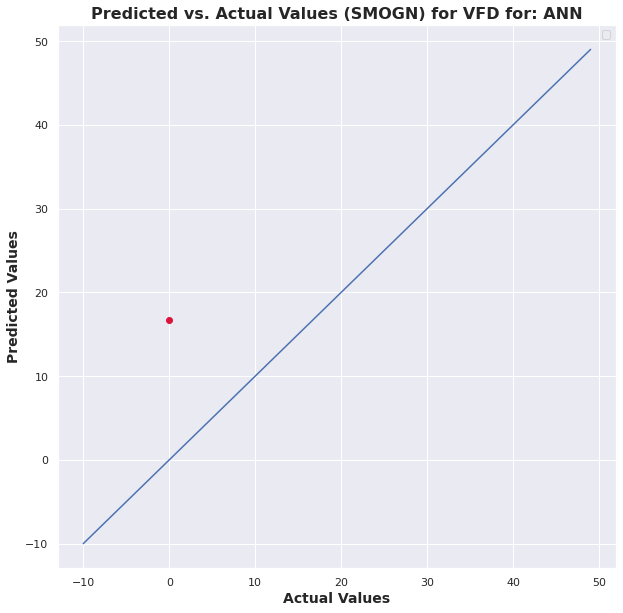

No handles with labels found to put in legend.


MSE: 			48.79578616270855
R-Squared Score: 	-0.10913693313539641


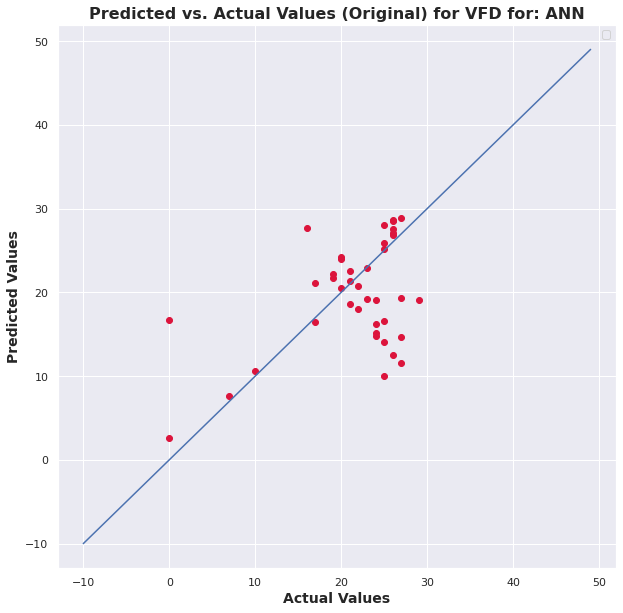

<ipython-input-546-1259e5c3eb40>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix:  83%|########3 | 10/12 [00:00<00:00, 99.93it/s]

32


r_index: 100%|##########| 8/8 [00:00<00:00, 131.88it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


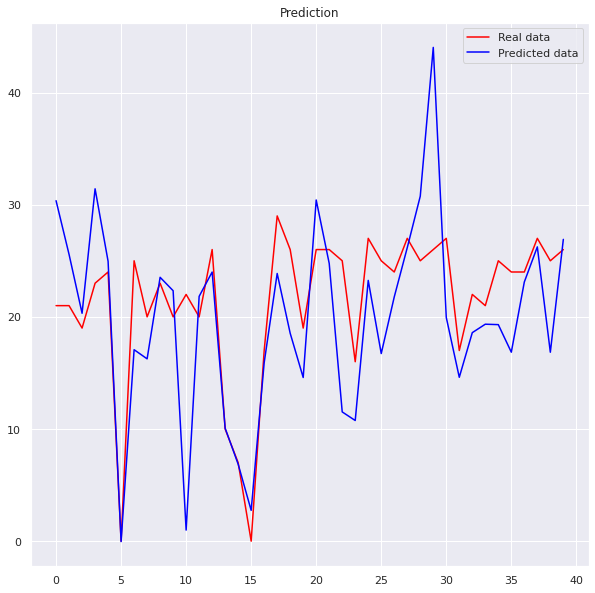

No handles with labels found to put in legend.


MSE: 			9.036410366372877
R-Squared Score: 	nan


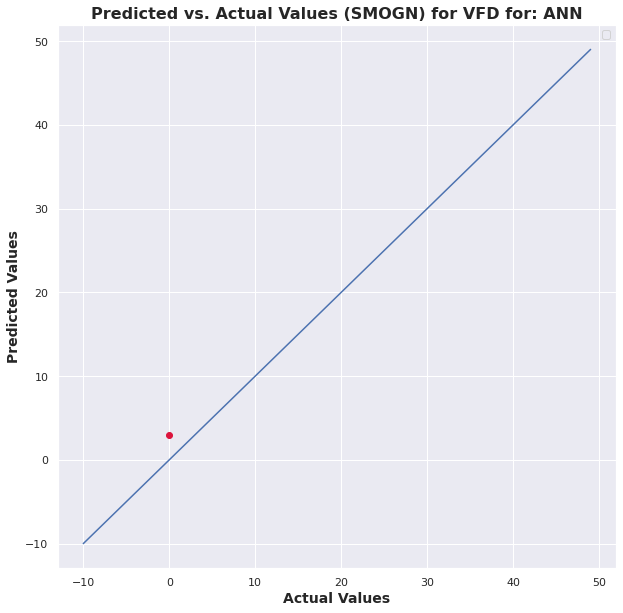

No handles with labels found to put in legend.


MSE: 			43.045609894164215
R-Squared Score: 	0.02156560028039456


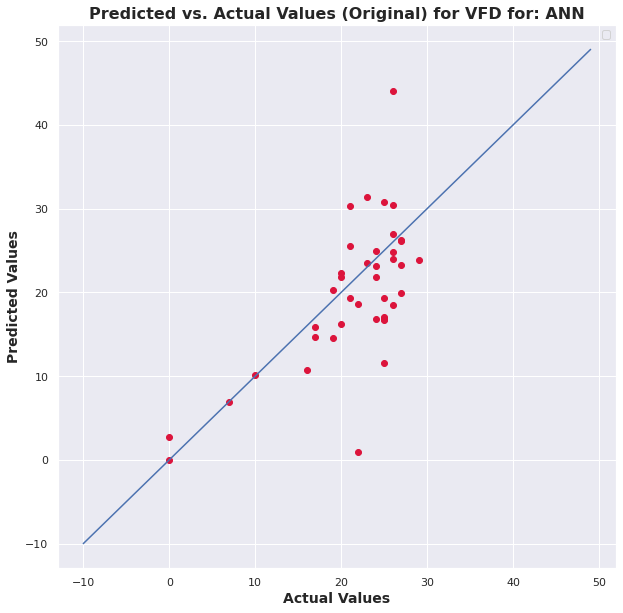

<ipython-input-546-1259e5c3eb40>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix:   0%|          | 0/12 [00:00<?, ?it/s]

33


r_index: 100%|##########| 8/8 [00:00<00:00, 127.71it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


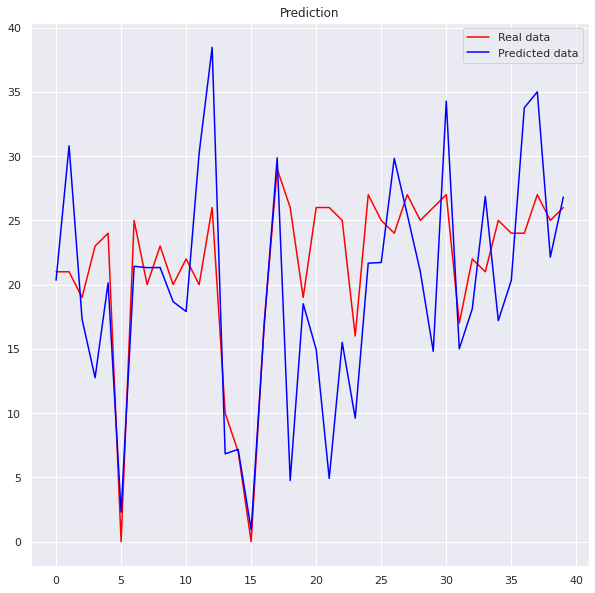

No handles with labels found to put in legend.


MSE: 			236.08456606330583
R-Squared Score: 	nan


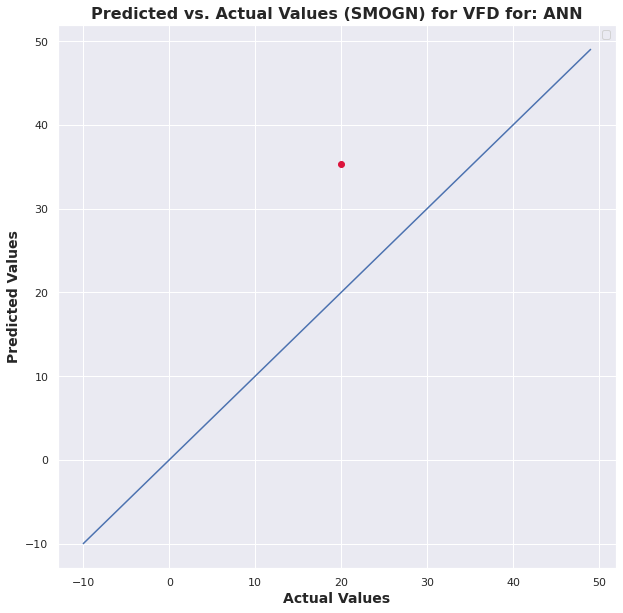

No handles with labels found to put in legend.


MSE: 			56.17450466948238
R-Squared Score: 	-0.27685652244138903


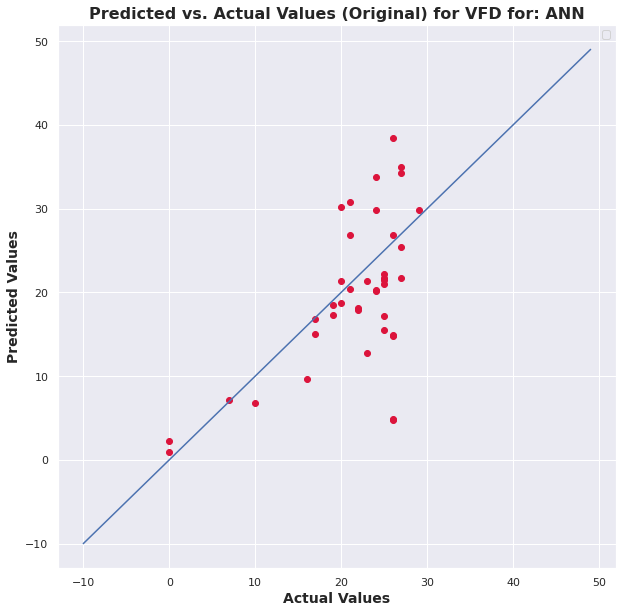

<ipython-input-546-1259e5c3eb40>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix:   0%|          | 0/12 [00:00<?, ?it/s]

34


r_index: 100%|##########| 8/8 [00:00<00:00, 149.25it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


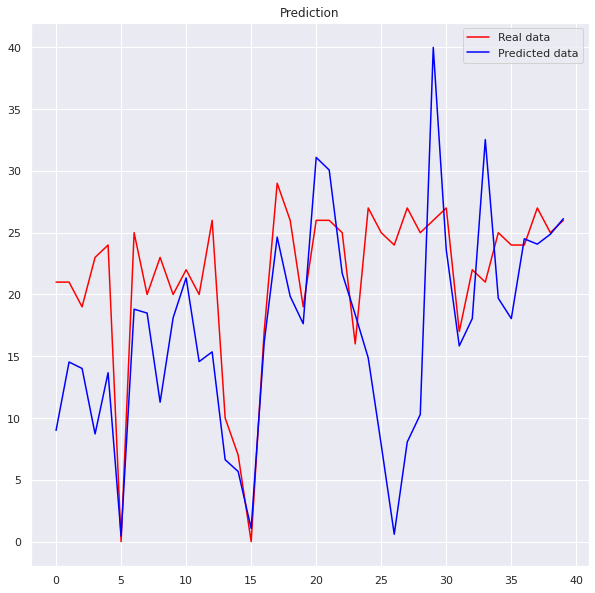

No handles with labels found to put in legend.


MSE: 			0.2317367906018717
R-Squared Score: 	nan


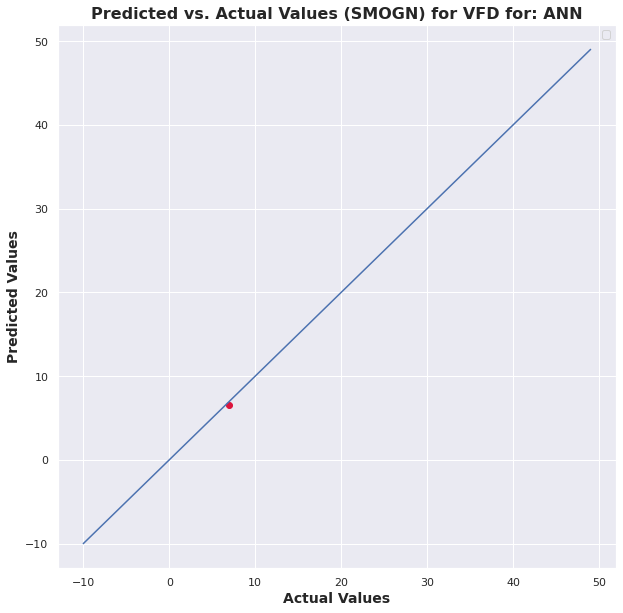

No handles with labels found to put in legend.


MSE: 			74.37204890968349
R-Squared Score: 	-0.6904899526287962


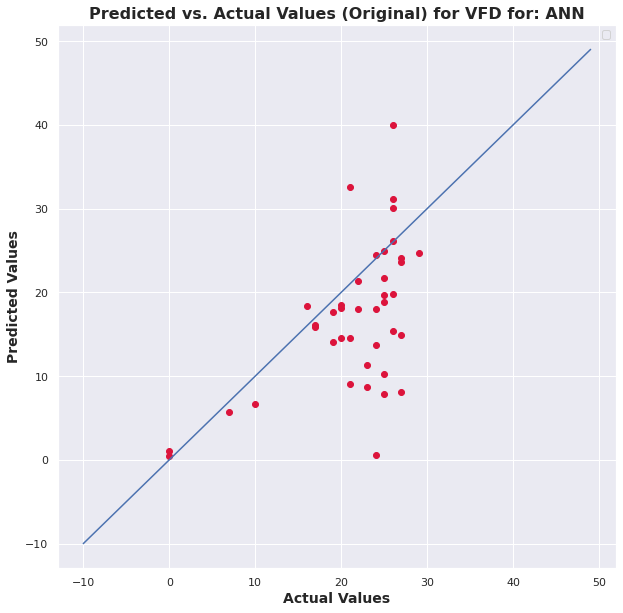

<ipython-input-546-1259e5c3eb40>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix:   0%|          | 0/12 [00:00<?, ?it/s]

35


r_index: 100%|##########| 8/8 [00:00<00:00, 136.26it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


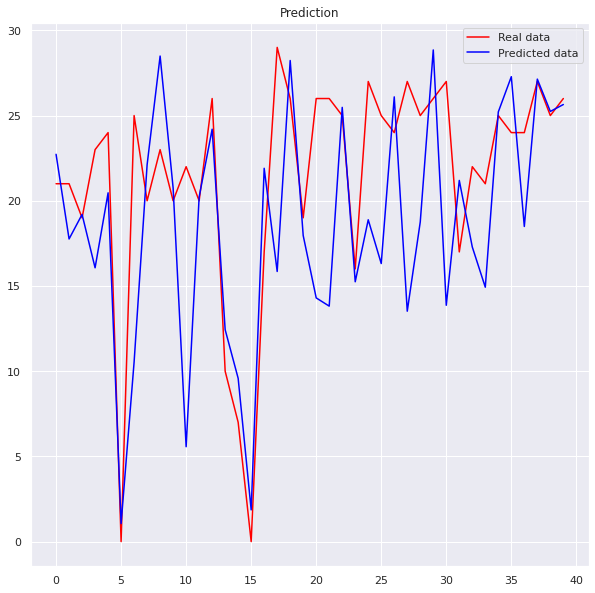

No handles with labels found to put in legend.


MSE: 			19.52374225058344
R-Squared Score: 	nan


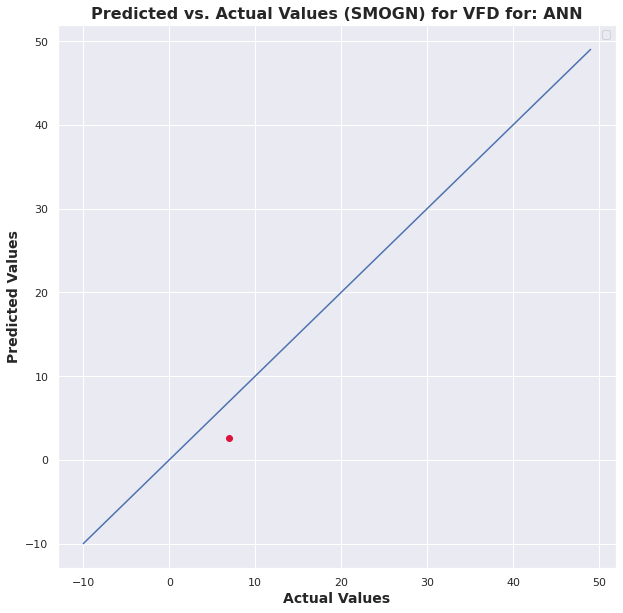

No handles with labels found to put in legend.


MSE: 			44.07307021181366
R-Squared Score: 	-0.001788756217440568


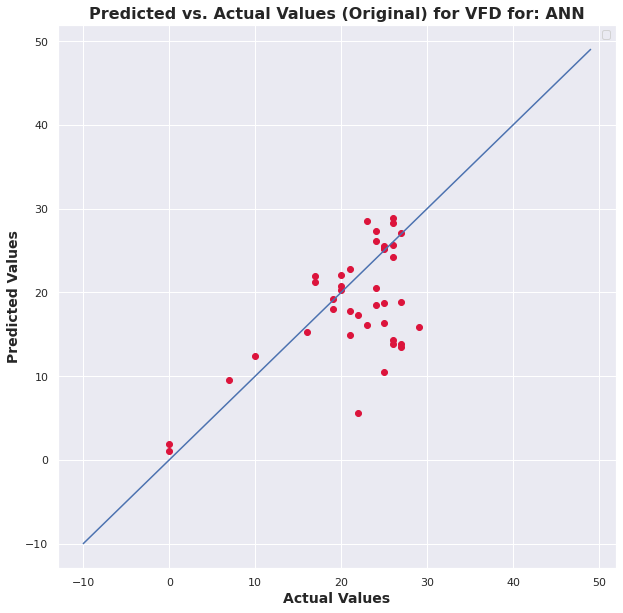

<ipython-input-546-1259e5c3eb40>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix:   0%|          | 0/12 [00:00<?, ?it/s]

36


r_index: 100%|##########| 8/8 [00:00<00:00, 99.42it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


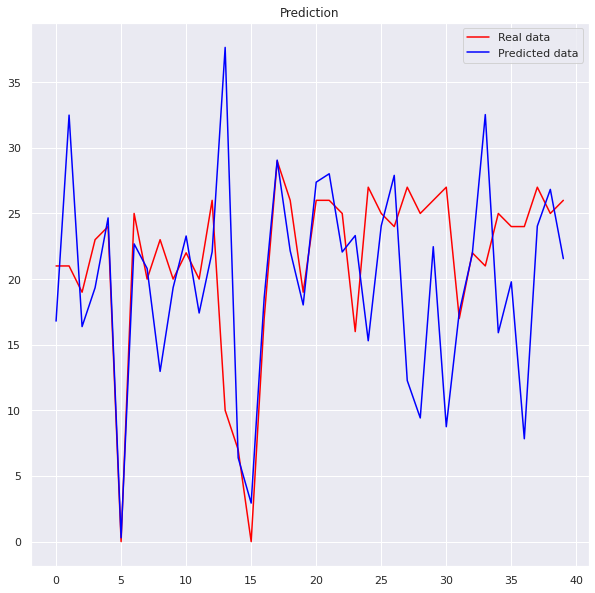

No handles with labels found to put in legend.


MSE: 			1050.419959039209
R-Squared Score: 	nan


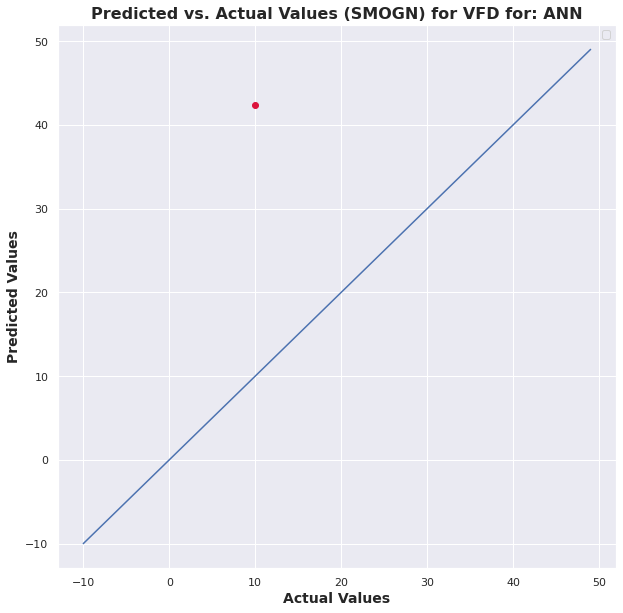

No handles with labels found to put in legend.


MSE: 			66.14973972184225
R-Squared Score: 	-0.5035953964988082


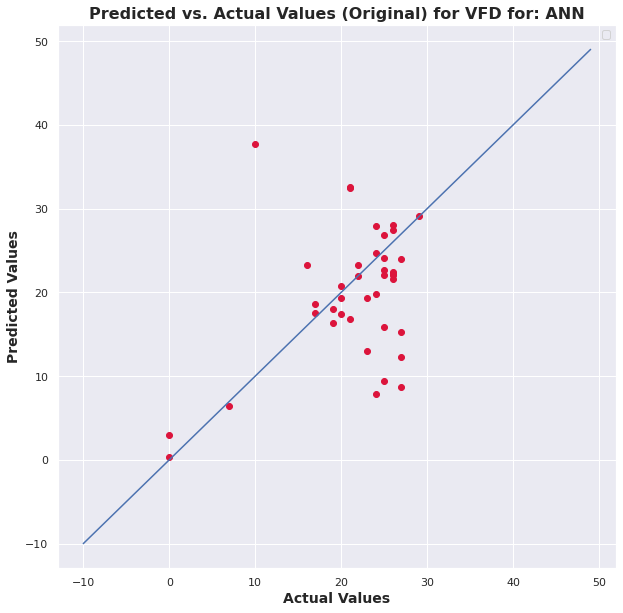

<ipython-input-546-1259e5c3eb40>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix:   0%|          | 0/12 [00:00<?, ?it/s]

37


r_index: 100%|##########| 8/8 [00:00<00:00, 102.58it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


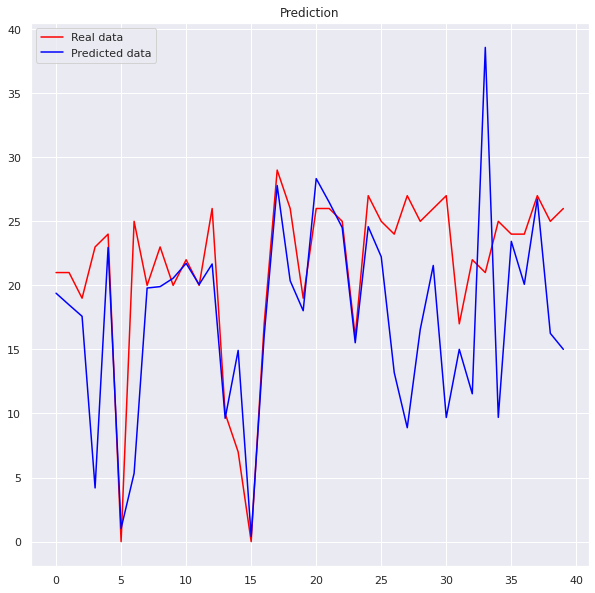

No handles with labels found to put in legend.


MSE: 			158.66985212563668
R-Squared Score: 	nan


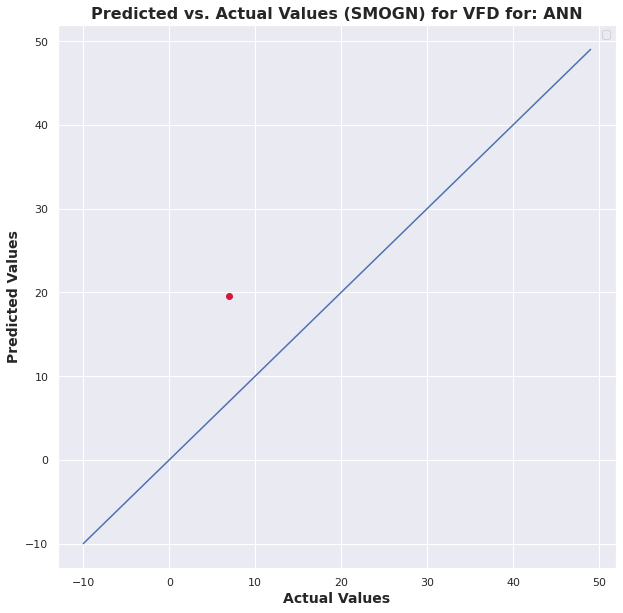

No handles with labels found to put in legend.


MSE: 			65.13960846449069
R-Squared Score: 	-0.48063493263606283


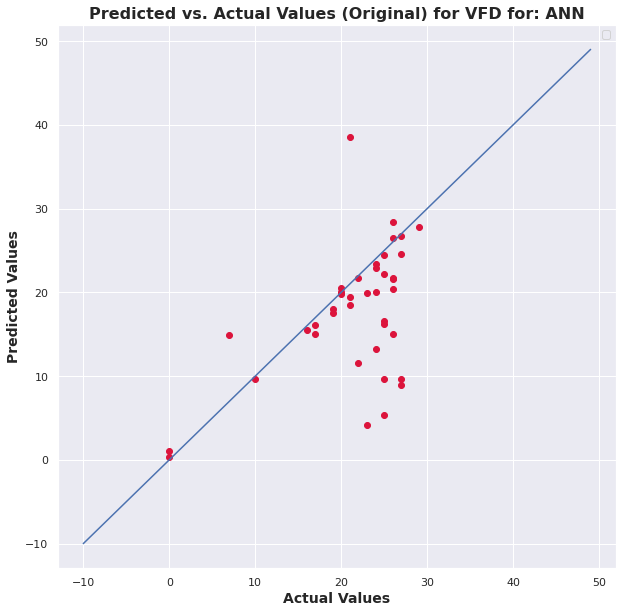

<ipython-input-546-1259e5c3eb40>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix:   0%|          | 0/12 [00:00<?, ?it/s]

38


r_index: 100%|##########| 8/8 [00:00<00:00, 115.45it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


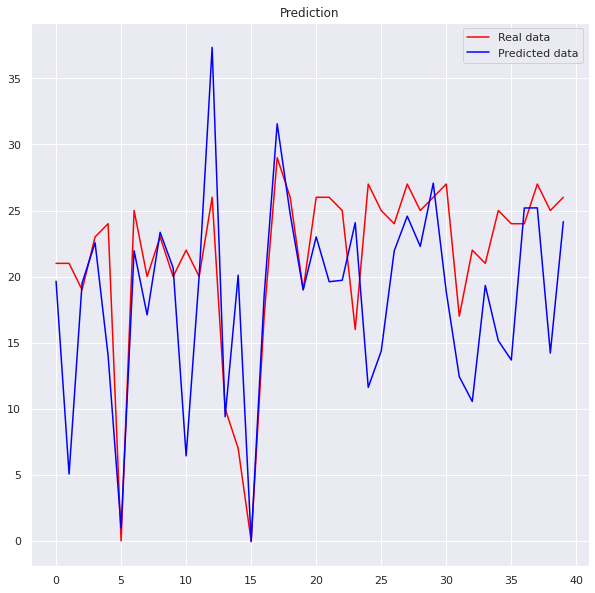

No handles with labels found to put in legend.


MSE: 			412.8310772013501
R-Squared Score: 	nan


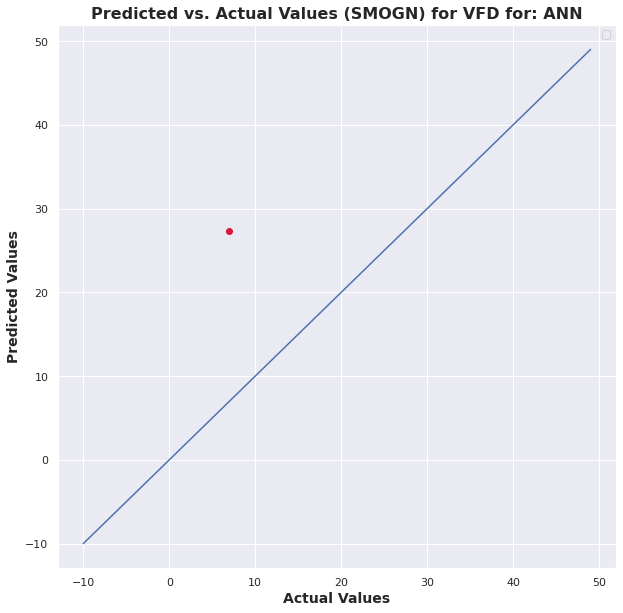

No handles with labels found to put in legend.


MSE: 			49.73218092855432
R-Squared Score: 	-0.13042135337879723


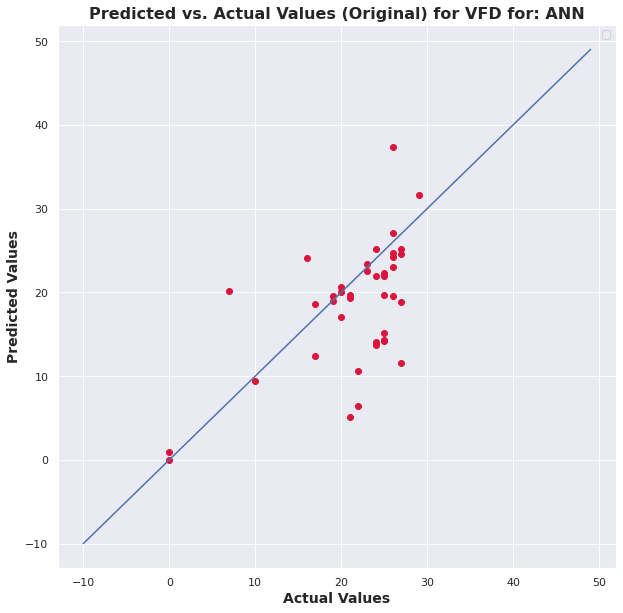

<ipython-input-546-1259e5c3eb40>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix:   0%|          | 0/12 [00:00<?, ?it/s]

39


r_index: 100%|##########| 8/8 [00:00<00:00, 99.29it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


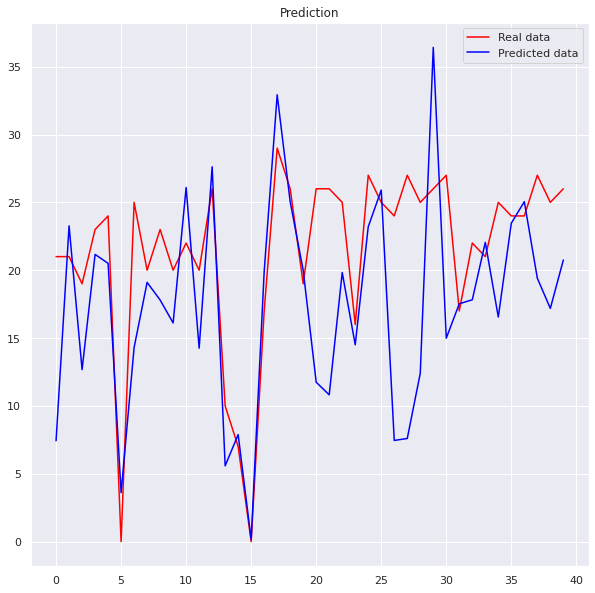

No handles with labels found to put in legend.


MSE: 			0.2147000146795932
R-Squared Score: 	nan


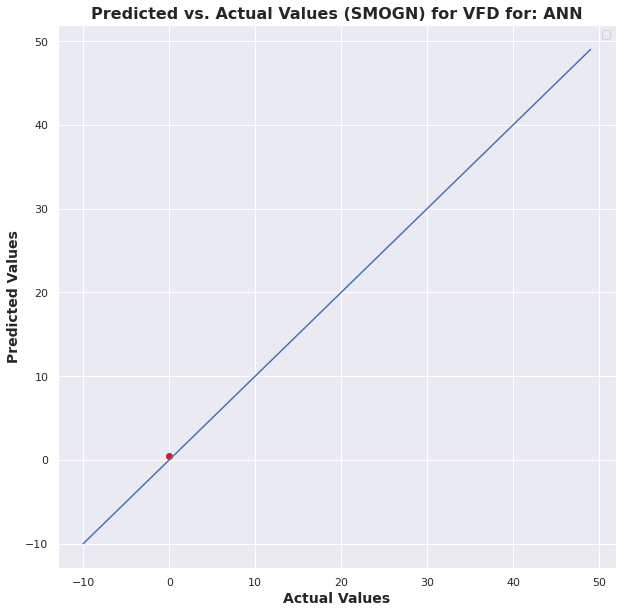

No handles with labels found to put in legend.


MSE: 			57.28460360334625
R-Squared Score: 	-0.3020892694428834


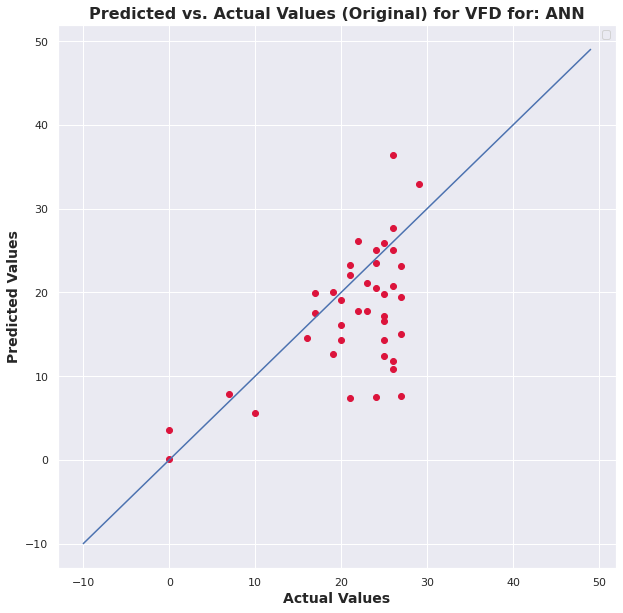

<ipython-input-546-1259e5c3eb40>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix:   0%|          | 0/12 [00:00<?, ?it/s]

40


r_index: 100%|##########| 8/8 [00:00<00:00, 105.48it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


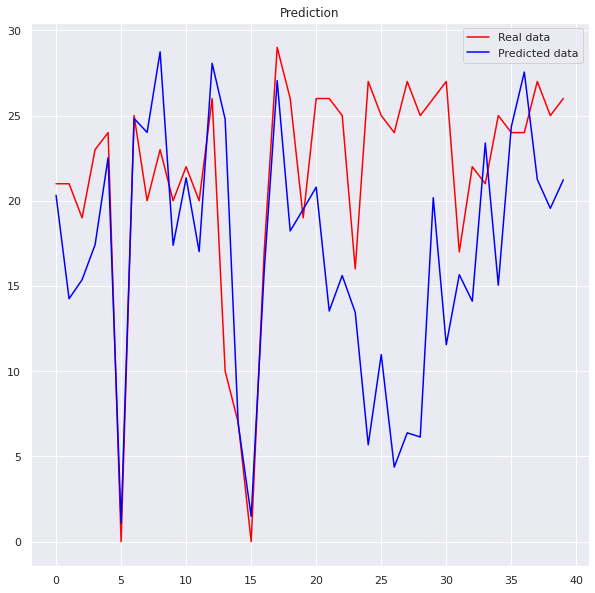

No handles with labels found to put in legend.


MSE: 			380.37795570888557
R-Squared Score: 	nan


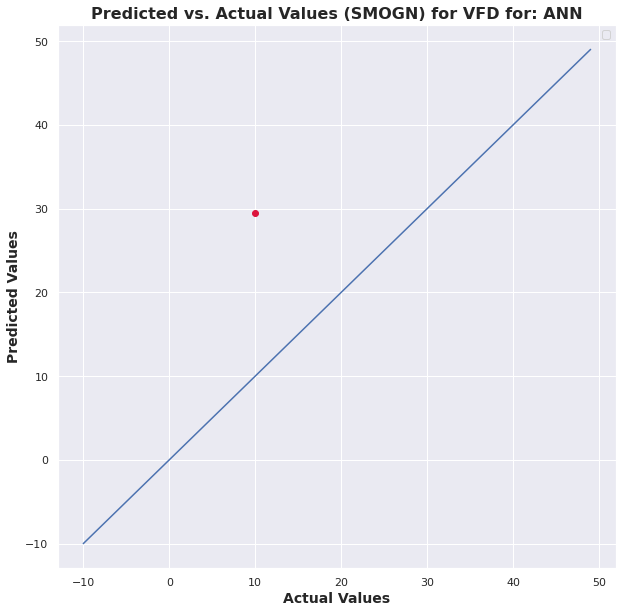

No handles with labels found to put in legend.


MSE: 			77.0903659520582
R-Squared Score: 	-0.7522777844226272


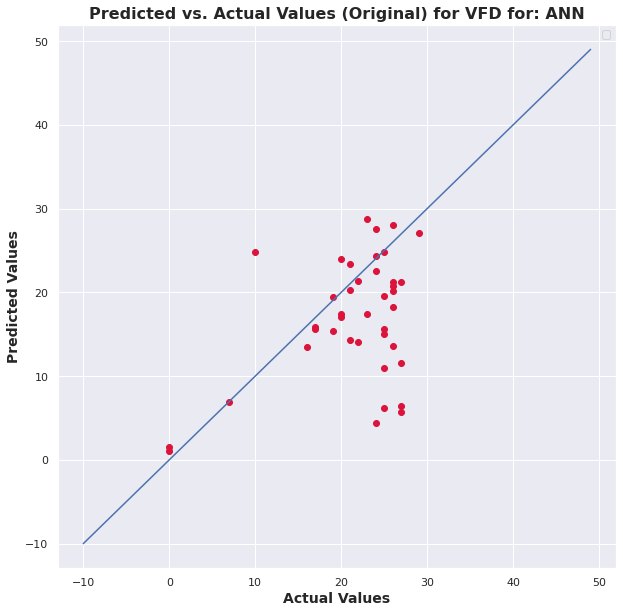

<ipython-input-546-1259e5c3eb40>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix:   0%|          | 0/12 [00:00<?, ?it/s]

41


r_index: 100%|##########| 8/8 [00:00<00:00, 114.11it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


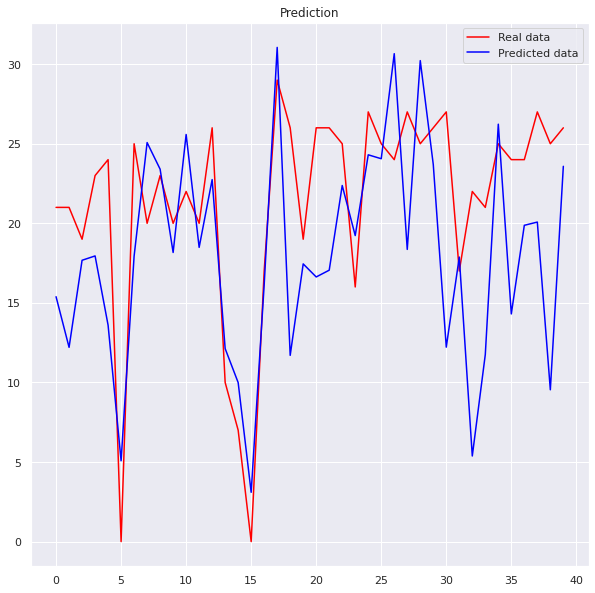

No handles with labels found to put in legend.


MSE: 			0.4356769065466892
R-Squared Score: 	nan


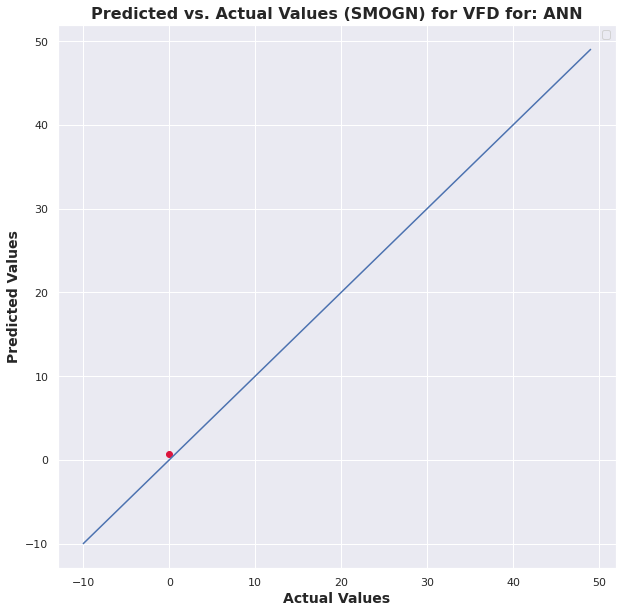

No handles with labels found to put in legend.


MSE: 			48.52645557779923
R-Squared Score: 	-0.10301500084497706


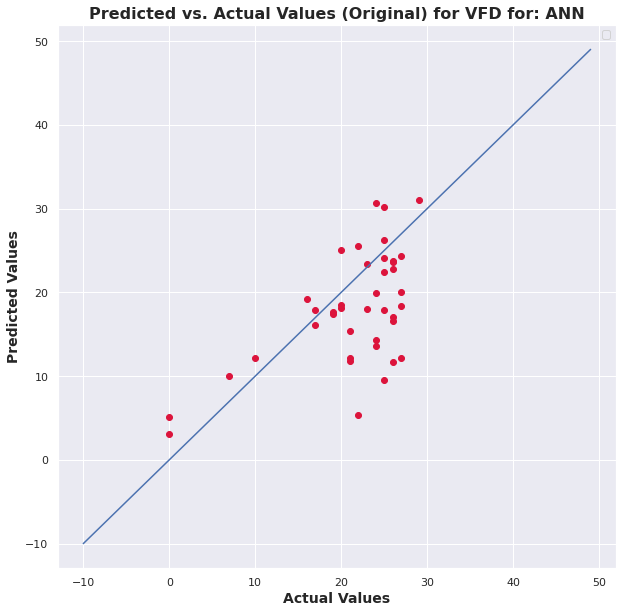

<ipython-input-546-1259e5c3eb40>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix:   0%|          | 0/12 [00:00<?, ?it/s]

42


r_index: 100%|##########| 8/8 [00:00<00:00, 109.57it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


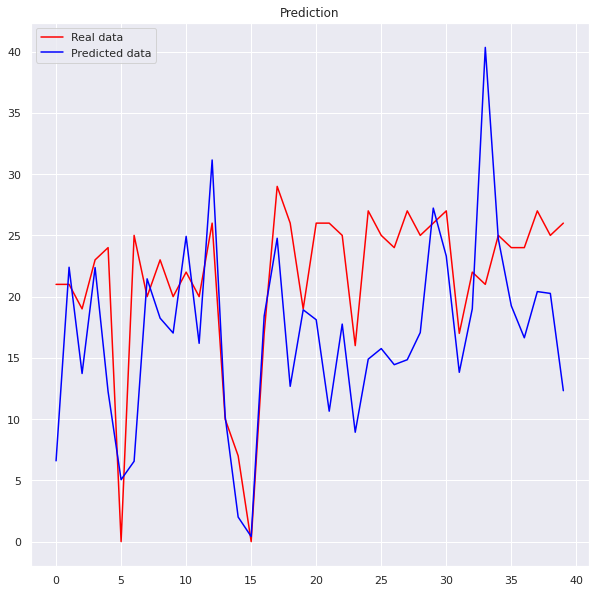

No handles with labels found to put in legend.


MSE: 			6.912822929156391
R-Squared Score: 	nan


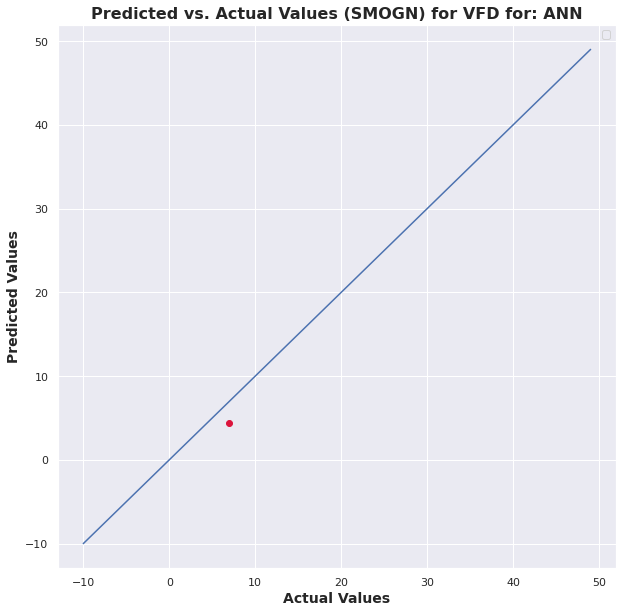

No handles with labels found to put in legend.


MSE: 			68.00350206907278
R-Squared Score: 	-0.5457317456850515


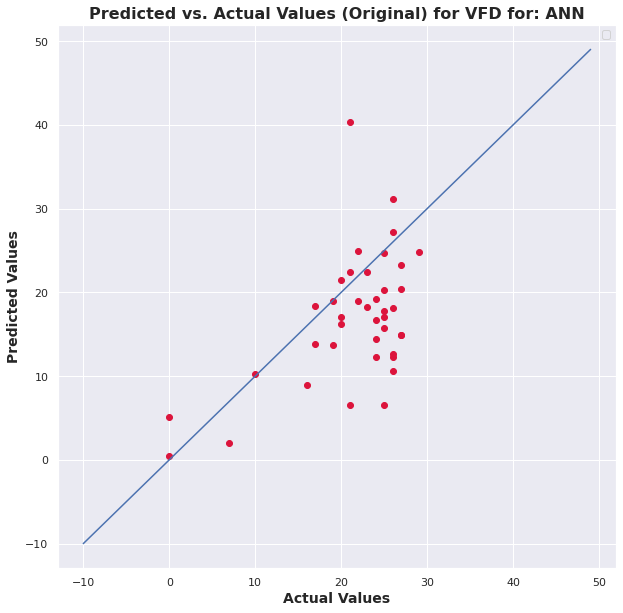

<ipython-input-546-1259e5c3eb40>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix:   0%|          | 0/12 [00:00<?, ?it/s]

43


r_index: 100%|##########| 8/8 [00:00<00:00, 102.55it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


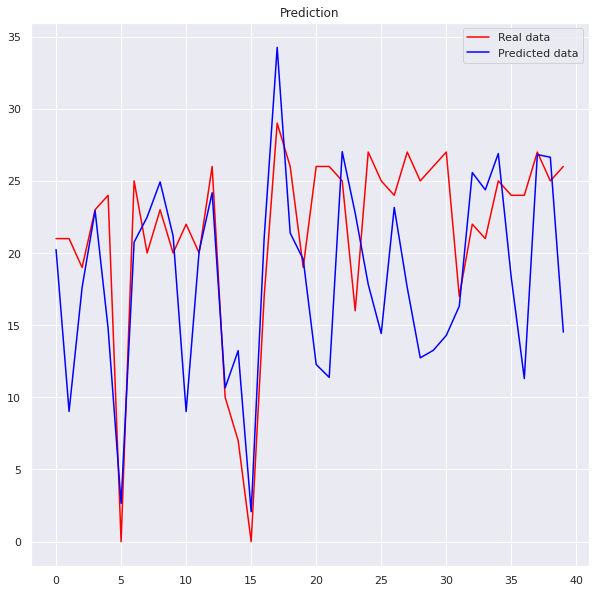

No handles with labels found to put in legend.


MSE: 			34.33375062143023
R-Squared Score: 	nan


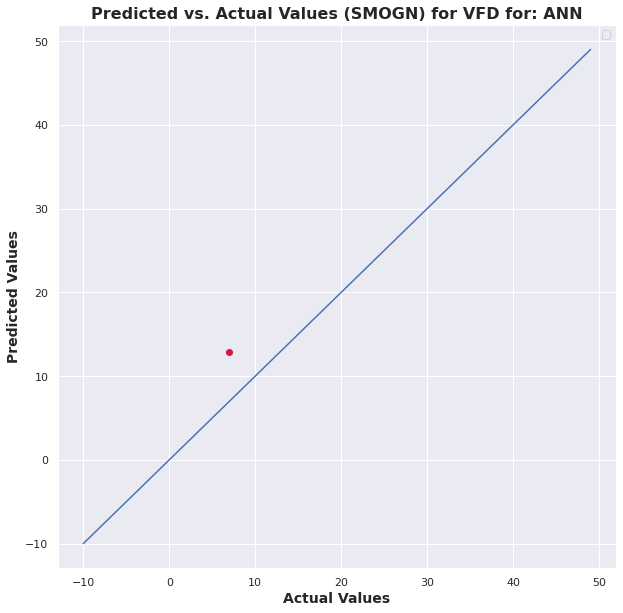

No handles with labels found to put in legend.


MSE: 			52.909610822075784
R-Squared Score: 	-0.20264490226479603


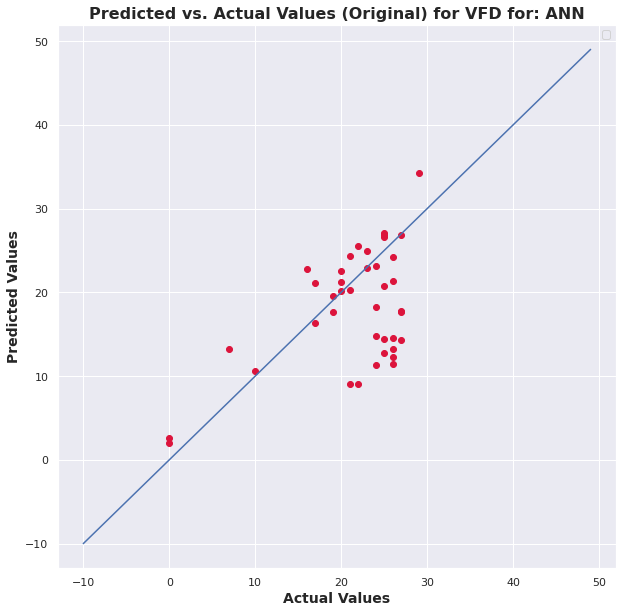

<ipython-input-546-1259e5c3eb40>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix:   0%|          | 0/12 [00:00<?, ?it/s]

44


r_index: 100%|##########| 8/8 [00:00<00:00, 108.83it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


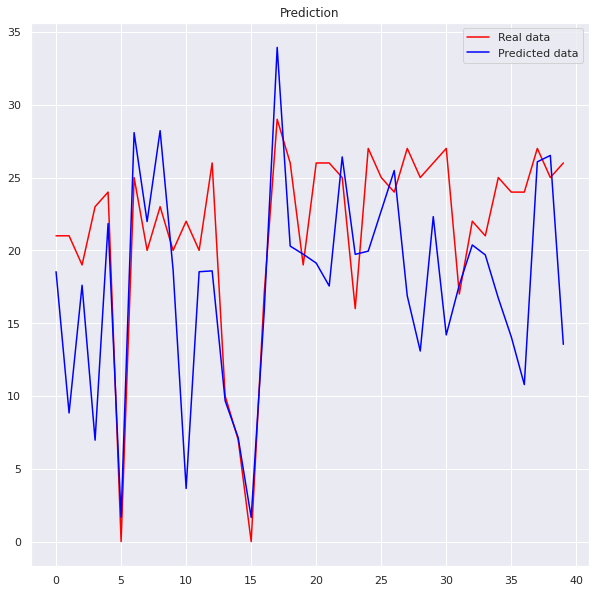

No handles with labels found to put in legend.


MSE: 			0.0018164481625257967
R-Squared Score: 	nan


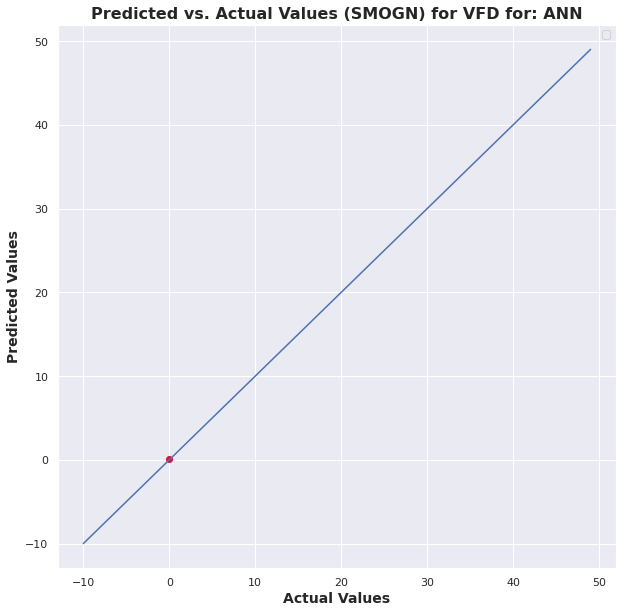

No handles with labels found to put in legend.


MSE: 			50.943296101046926
R-Squared Score: 	-0.15795021752319305


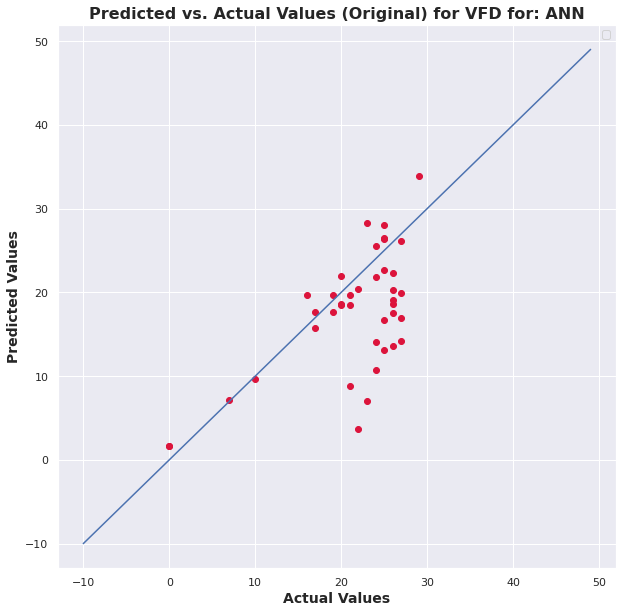

<ipython-input-546-1259e5c3eb40>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix:   0%|          | 0/12 [00:00<?, ?it/s]

45


r_index: 100%|##########| 8/8 [00:00<00:00, 90.37it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


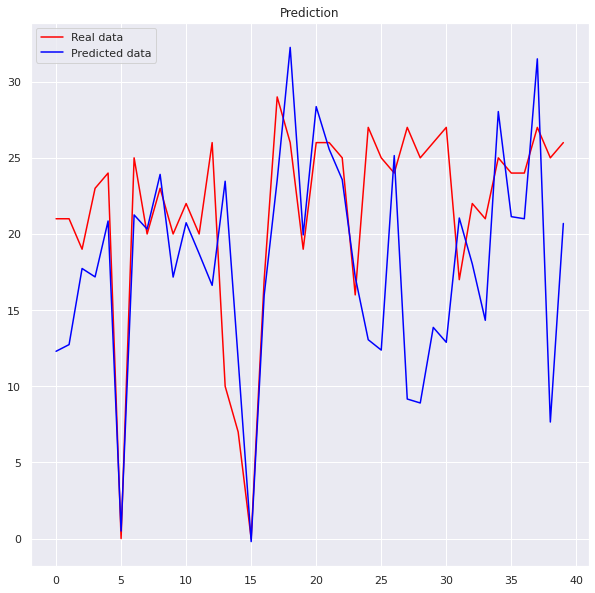

No handles with labels found to put in legend.


MSE: 			312.04572087663473
R-Squared Score: 	nan


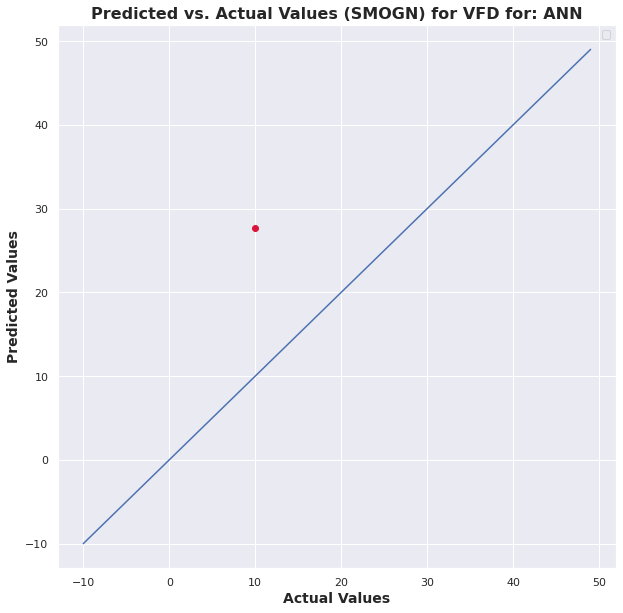

No handles with labels found to put in legend.


MSE: 			57.9755679604918
R-Squared Score: 	-0.317795012669047


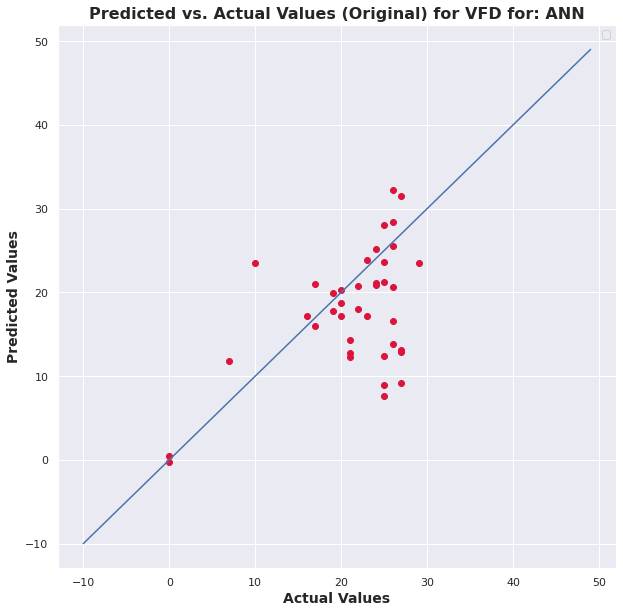

<ipython-input-546-1259e5c3eb40>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix:   0%|          | 0/12 [00:00<?, ?it/s]

46


r_index: 100%|##########| 8/8 [00:00<00:00, 115.45it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


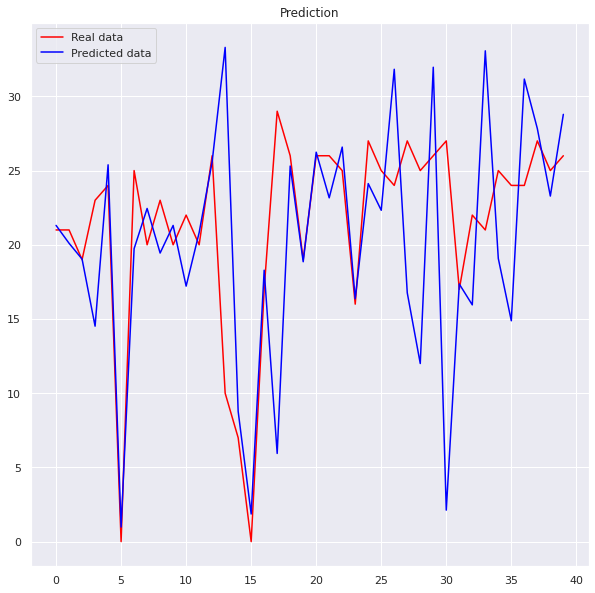

No handles with labels found to put in legend.


MSE: 			2104.4407259929576
R-Squared Score: 	nan


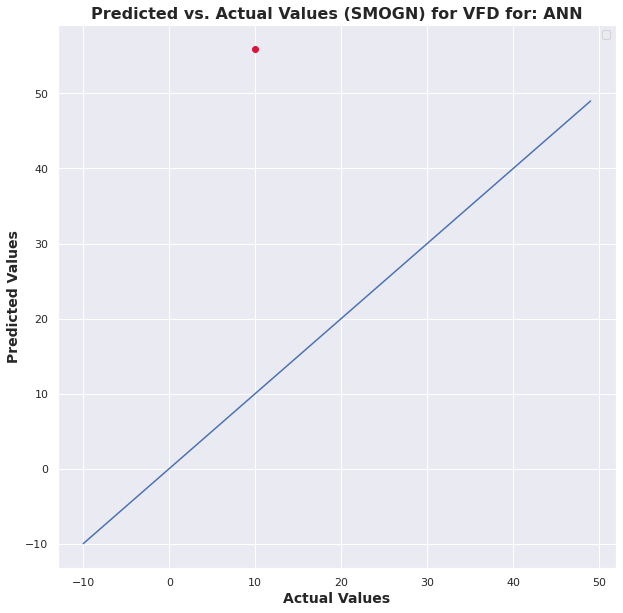

No handles with labels found to put in legend.


MSE: 			65.25371880564451
R-Squared Score: 	-0.4832286810676254


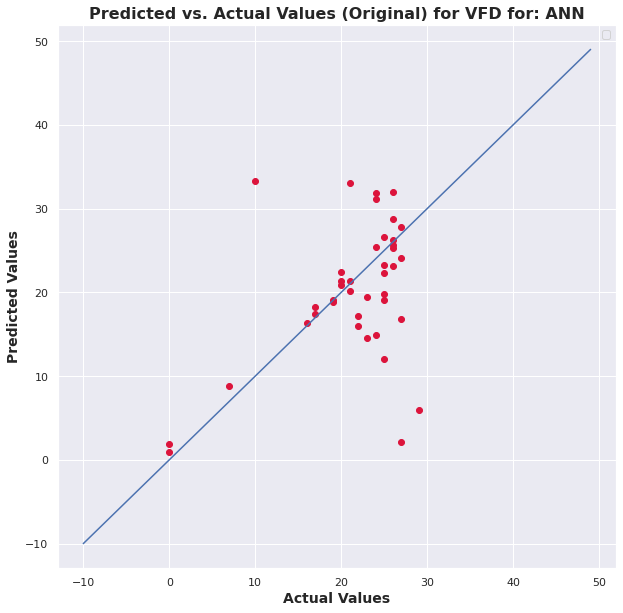

<ipython-input-546-1259e5c3eb40>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix:   0%|          | 0/12 [00:00<?, ?it/s]

47


r_index: 100%|##########| 8/8 [00:00<00:00, 103.50it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


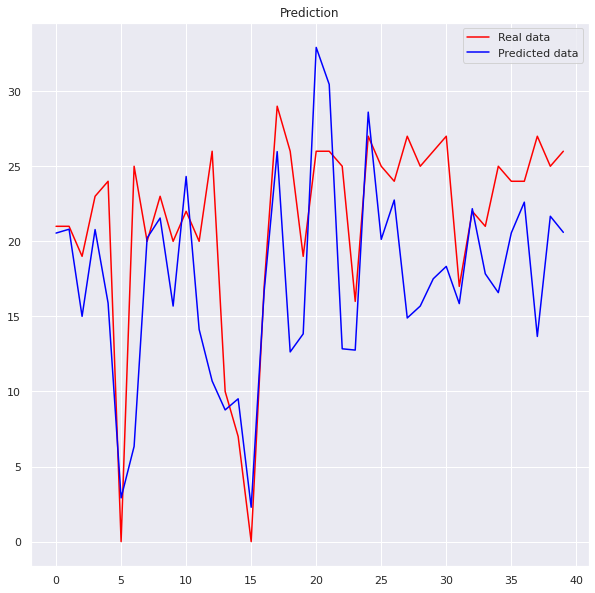

No handles with labels found to put in legend.


MSE: 			10.249162204796448
R-Squared Score: 	nan


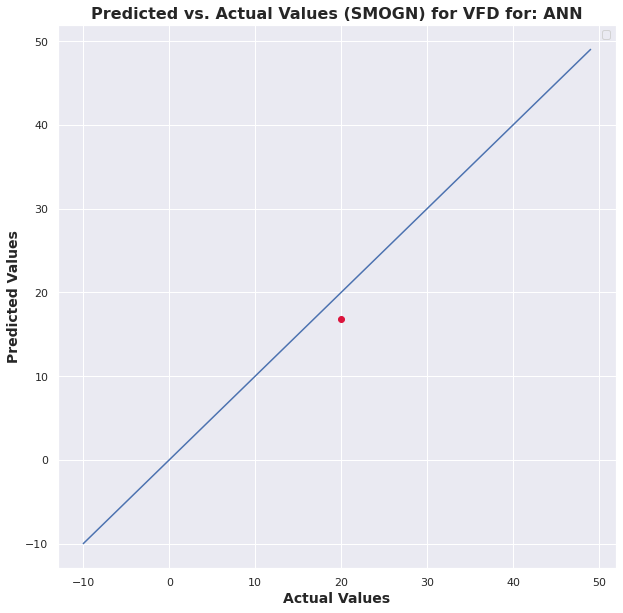

No handles with labels found to put in legend.


MSE: 			47.86441089274879
R-Squared Score: 	-0.08796660692983593


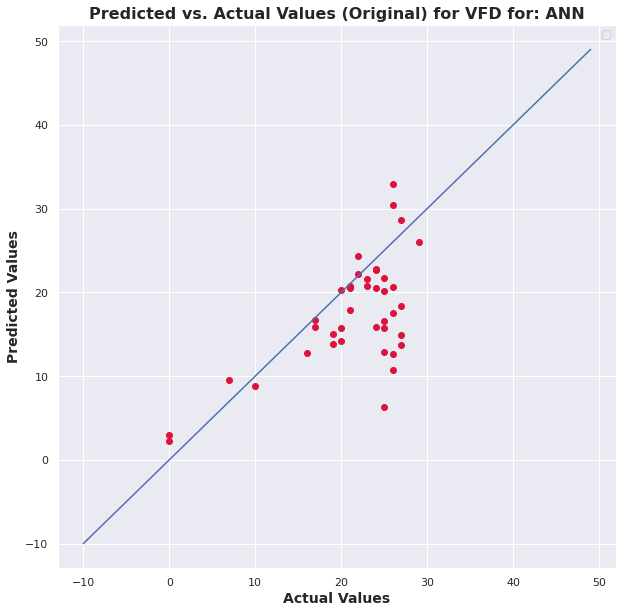

<ipython-input-546-1259e5c3eb40>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix:   0%|          | 0/12 [00:00<?, ?it/s]

48


r_index: 100%|##########| 8/8 [00:00<00:00, 115.32it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


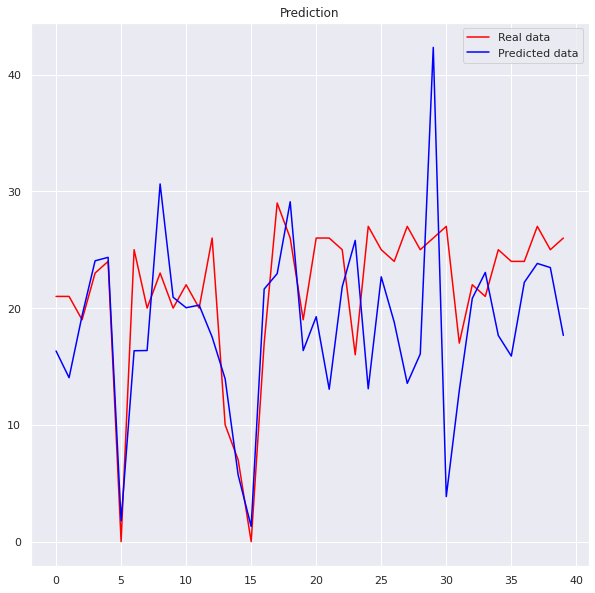

No handles with labels found to put in legend.


MSE: 			47.49530254604542
R-Squared Score: 	nan


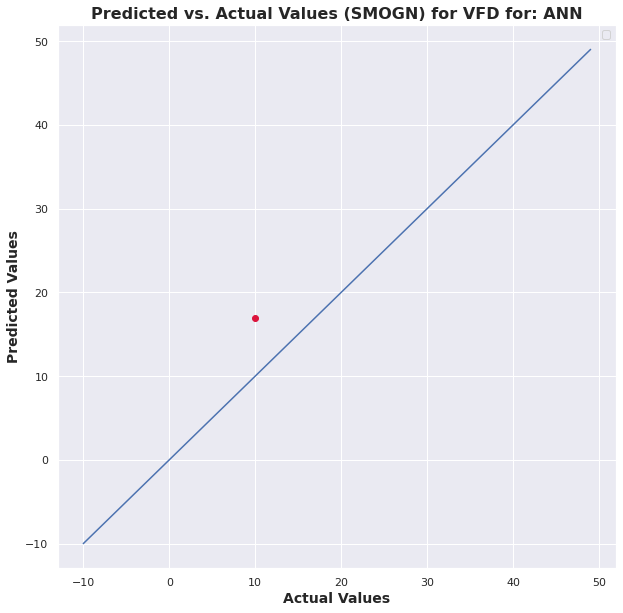

No handles with labels found to put in legend.


MSE: 			55.66424873926671
R-Squared Score: 	-0.265258314029162


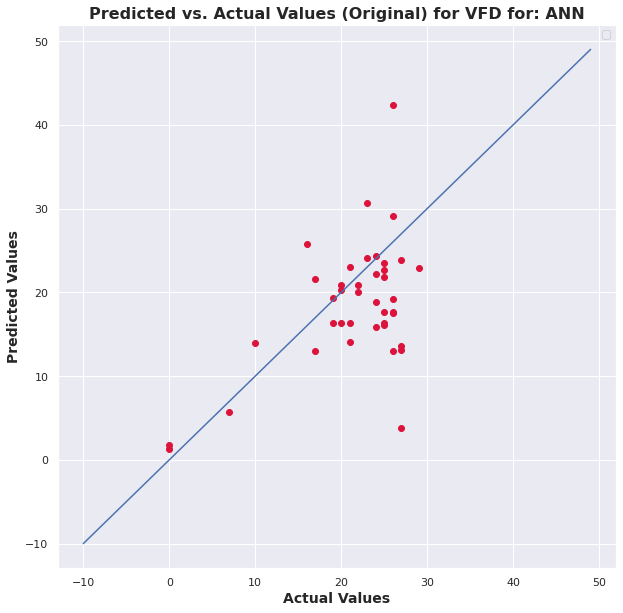

<ipython-input-546-1259e5c3eb40>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix:   0%|          | 0/12 [00:00<?, ?it/s]

49


r_index: 100%|##########| 8/8 [00:00<00:00, 116.08it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


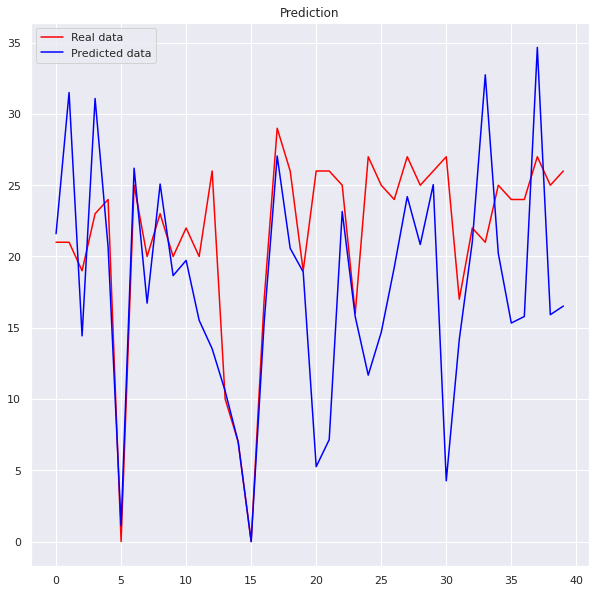

No handles with labels found to put in legend.


MSE: 			18.45402234006906
R-Squared Score: 	nan


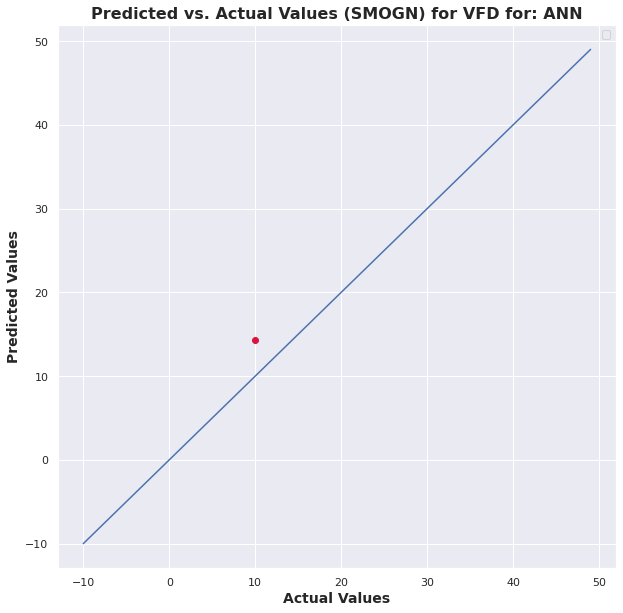

No handles with labels found to put in legend.


MSE: 			67.12319213881035
R-Squared Score: 	-0.5257221437697515


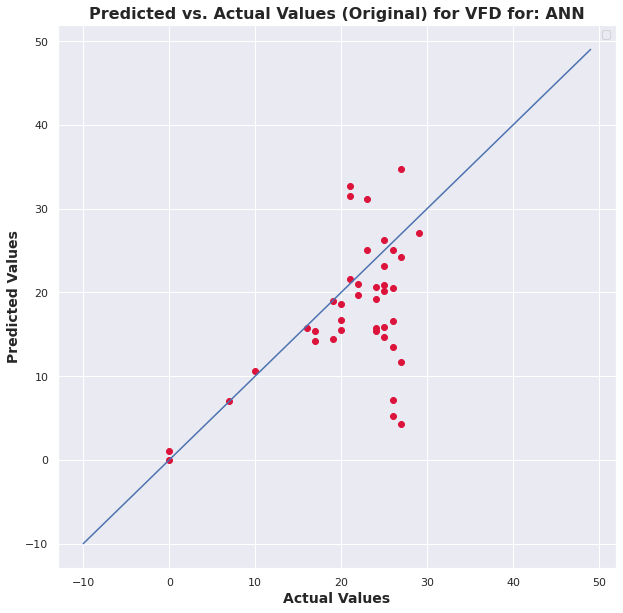

In [547]:
rSquared = {}
MSE = {}
for n in range(2,50):
    print('==================================================')
    print(n)
    combinedDfNormalized = pd.read_csv('data/processed/VFD/CombinedDataset/combinedDfNormalized.csv').set_index('Unnamed: 0')
    mse, rSqre = trainANN(combinedDfNormalized, selectedFeatures, n)
    
    rSquared[n] = rSqre
    MSE[n] = mse
    

<ipython-input-638-0f79e873448e>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix:   0%|          | 0/12 [00:00<?, ?it/s]

2


r_index: 100%|##########| 8/8 [00:00<00:00, 192.92it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


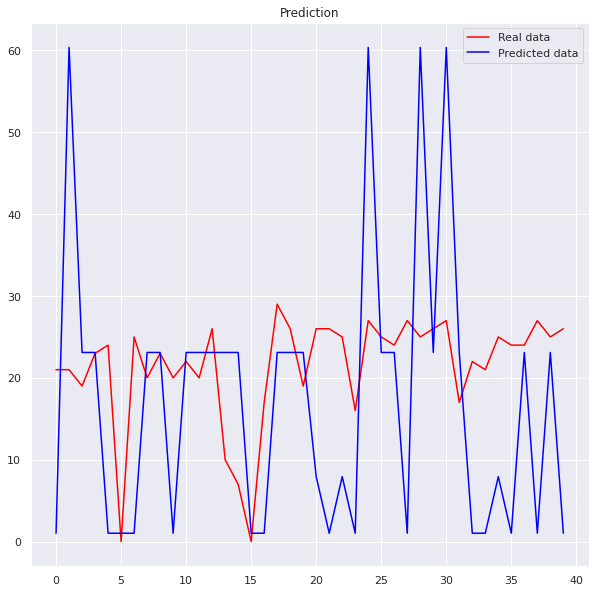

No handles with labels found to put in legend.


MSE: 			223.61962017487167
R-Squared Score: 	nan


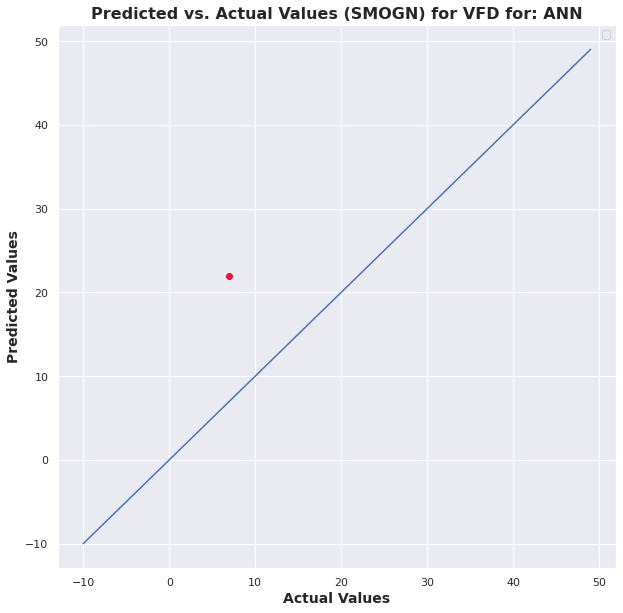

No handles with labels found to put in legend.


MSE: 			320.92577153909394
R-Squared Score: 	-6.294700096071236


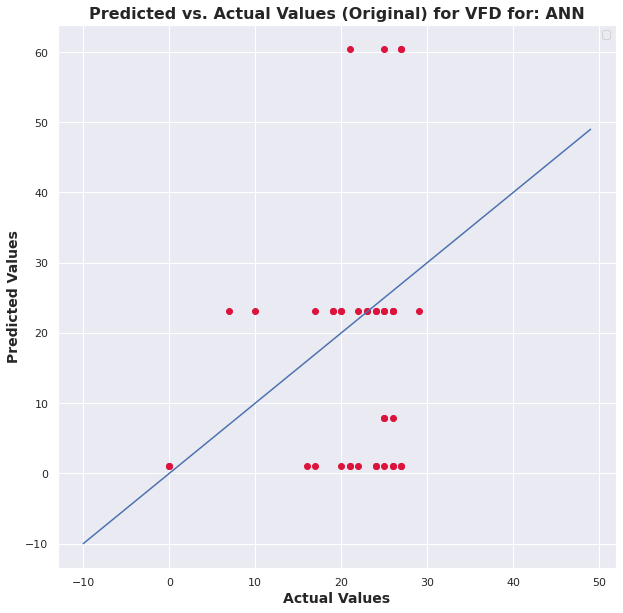

<ipython-input-638-0f79e873448e>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
r_index: 100%|##########| 8/8 [00:00<00:00, 497.68it/s]

3


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


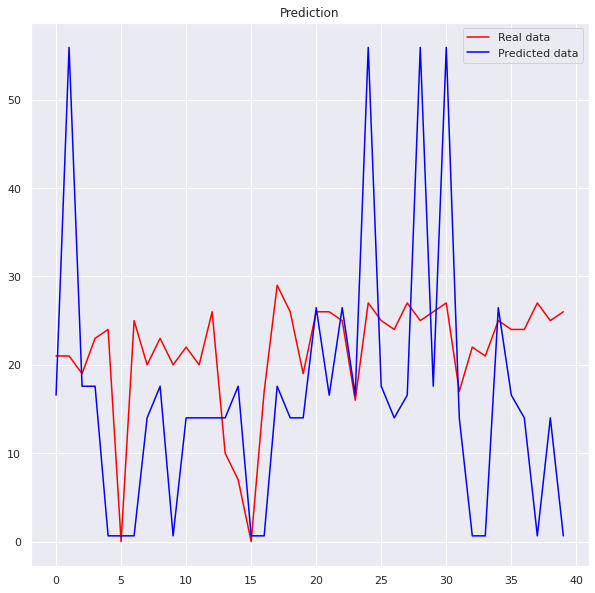

No handles with labels found to put in legend.


MSE: 			0.00033325355980196036
R-Squared Score: 	nan


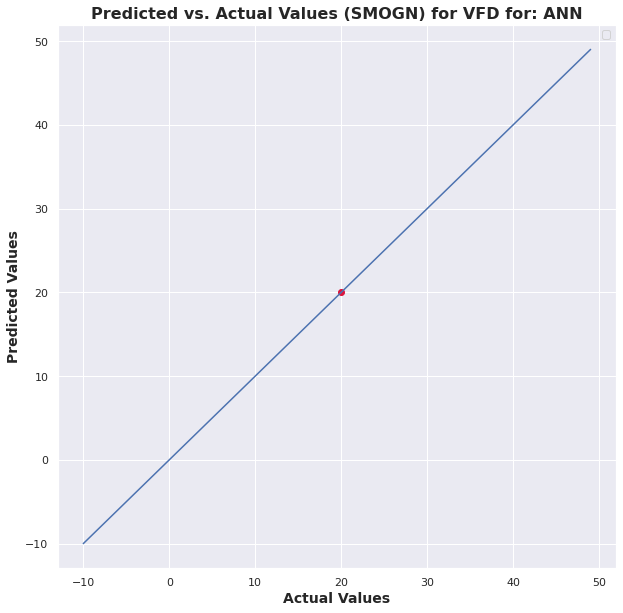

No handles with labels found to put in legend.


MSE: 			233.39372587666472
R-Squared Score: 	-4.3050810672197235


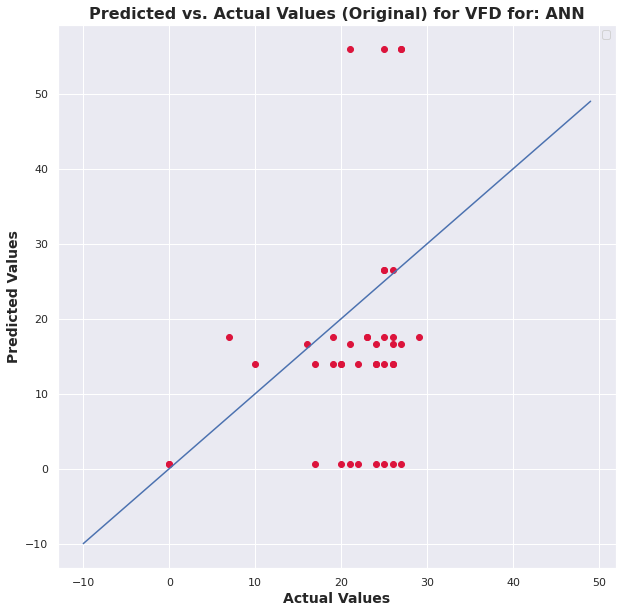

<ipython-input-638-0f79e873448e>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix:   0%|          | 0/12 [00:00<?, ?it/s]

4


r_index: 100%|##########| 8/8 [00:00<00:00, 215.35it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


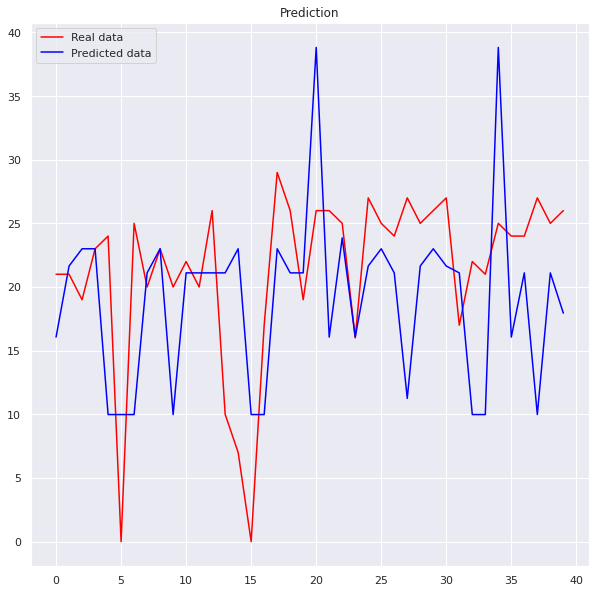

No handles with labels found to put in legend.


MSE: 			96.06656693100012
R-Squared Score: 	nan


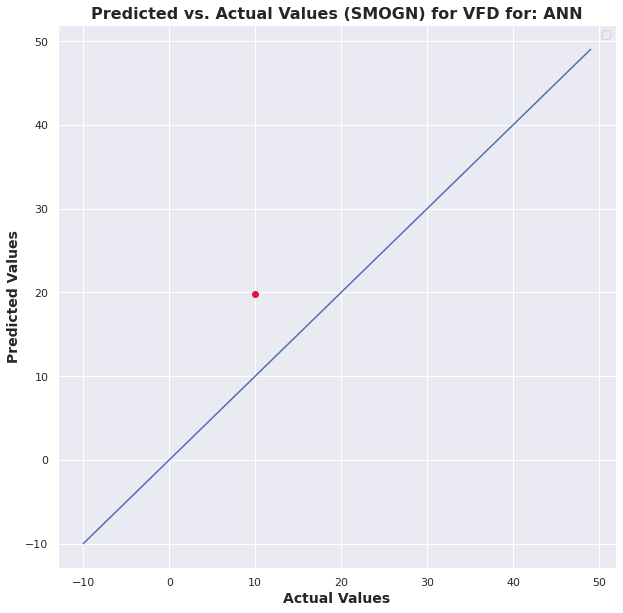

No handles with labels found to put in legend.


MSE: 			70.00494950959721
R-Squared Score: 	-0.5912250034145778


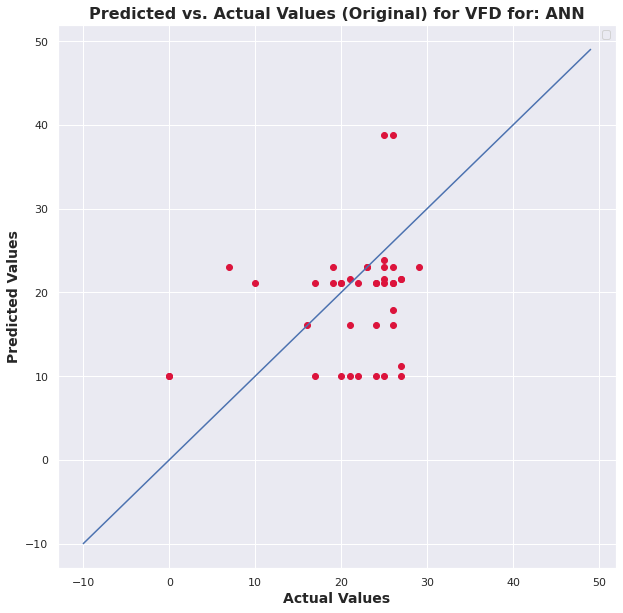

<ipython-input-638-0f79e873448e>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix:   0%|          | 0/12 [00:00<?, ?it/s]

5


r_index: 100%|##########| 8/8 [00:00<00:00, 303.56it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


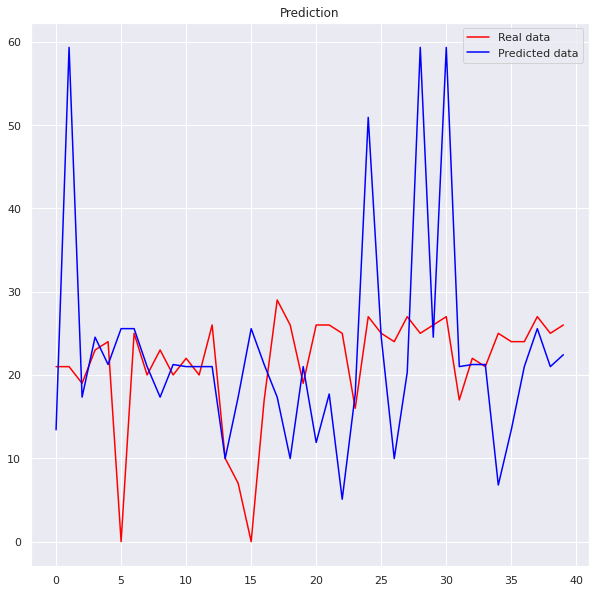

No handles with labels found to put in legend.


MSE: 			176.528876895758
R-Squared Score: 	nan


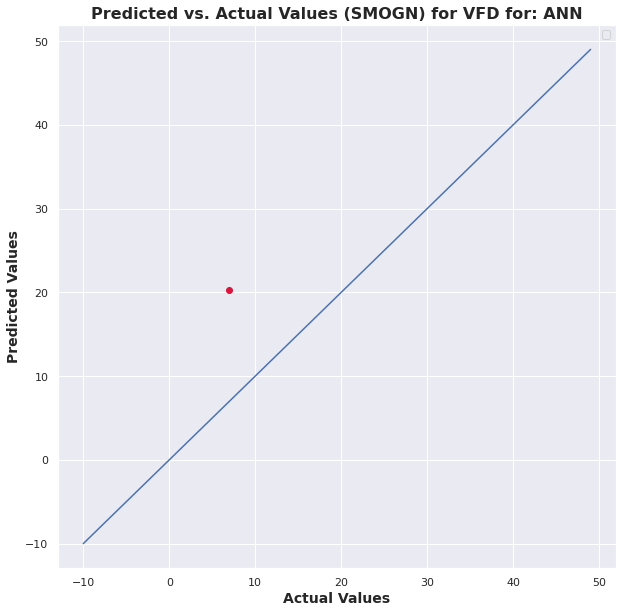

No handles with labels found to put in legend.


MSE: 			190.8492367971386
R-Squared Score: 	-3.3380372331039734


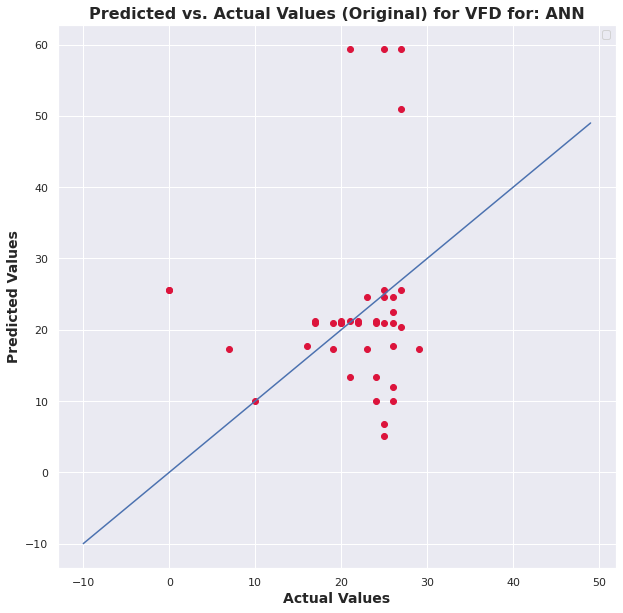

<ipython-input-638-0f79e873448e>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix:   0%|          | 0/12 [00:00<?, ?it/s]

6


r_index: 100%|##########| 8/8 [00:00<00:00, 204.35it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


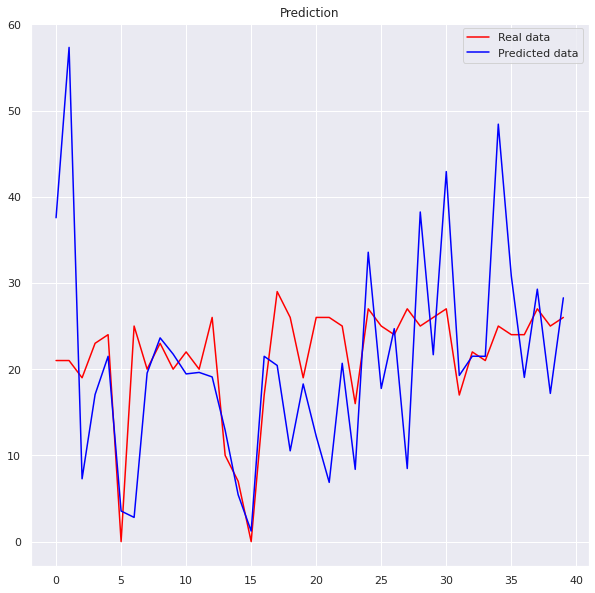

No handles with labels found to put in legend.


MSE: 			25.630431913192297
R-Squared Score: 	nan


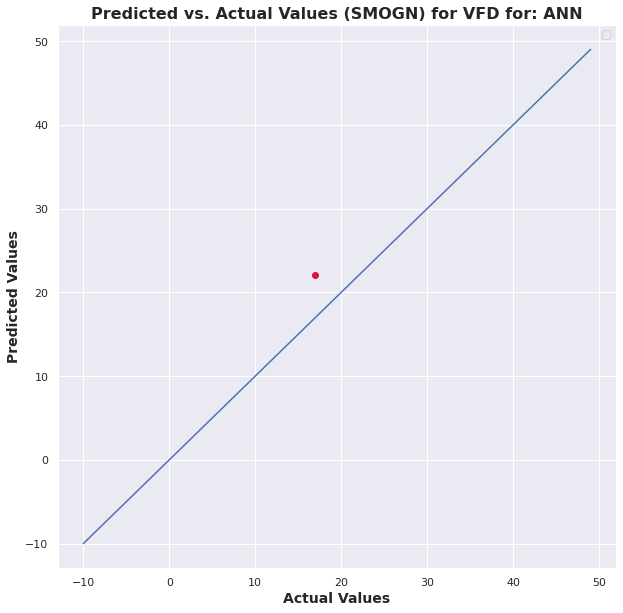

No handles with labels found to put in legend.


MSE: 			122.41024270114269
R-Squared Score: 	-1.7824066758794208


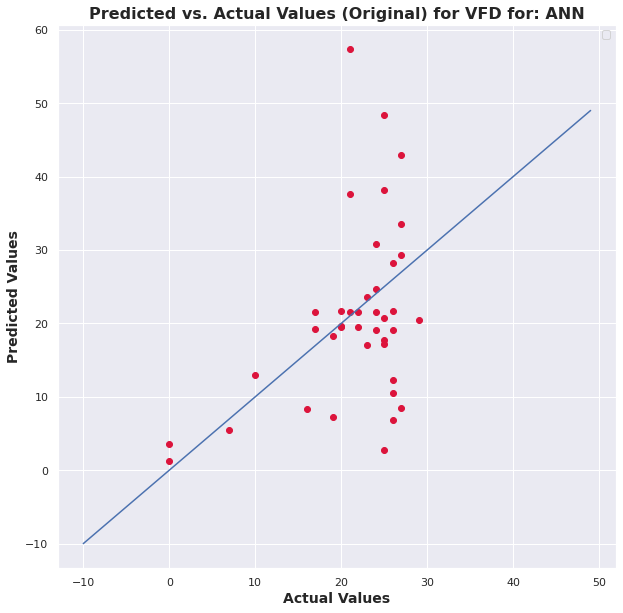

<ipython-input-638-0f79e873448e>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix:   0%|          | 0/12 [00:00<?, ?it/s]

7


r_index: 100%|##########| 8/8 [00:00<00:00, 173.11it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


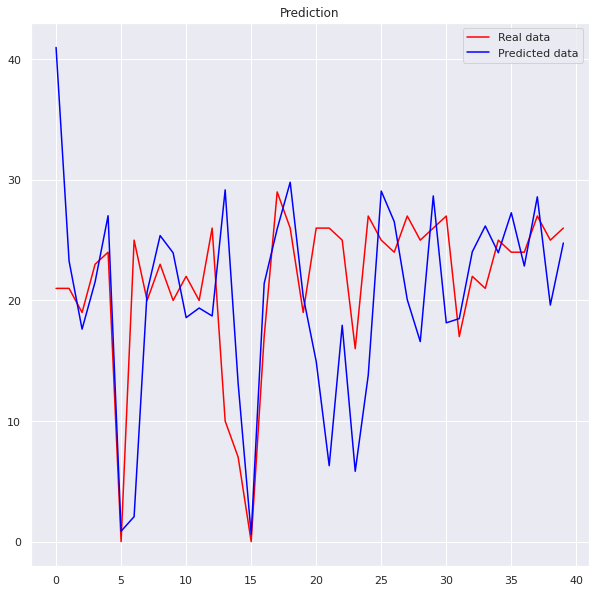

MSE: 			279.48605322861476
R-Squared Score: 	nan


No handles with labels found to put in legend.


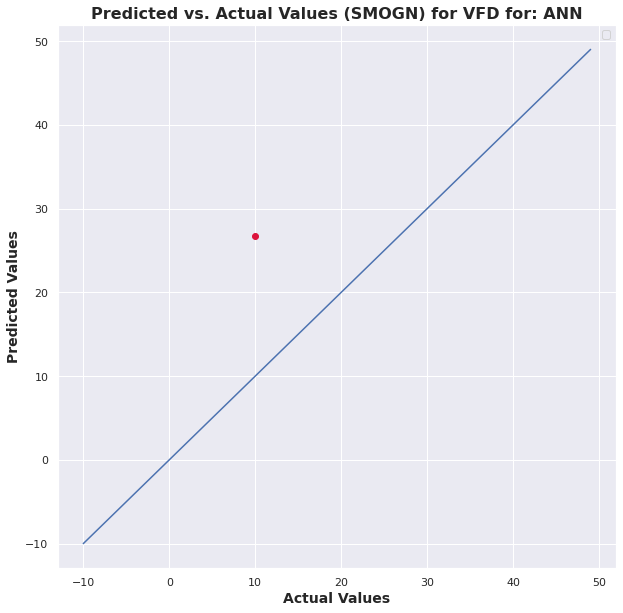

No handles with labels found to put in legend.


MSE: 			65.6593669122166
R-Squared Score: 	-0.49244913496819986


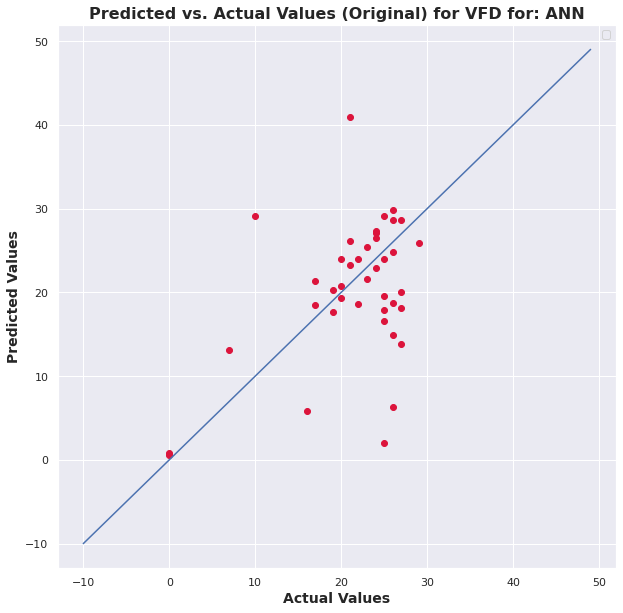

<ipython-input-638-0f79e873448e>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix:   0%|          | 0/12 [00:00<?, ?it/s]

8


r_index: 100%|##########| 8/8 [00:00<00:00, 149.60it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


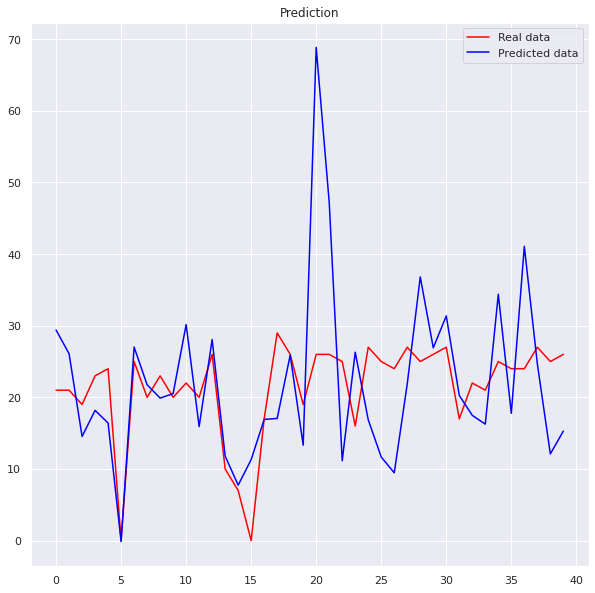

No handles with labels found to put in legend.


MSE: 			48.70875848664218
R-Squared Score: 	nan


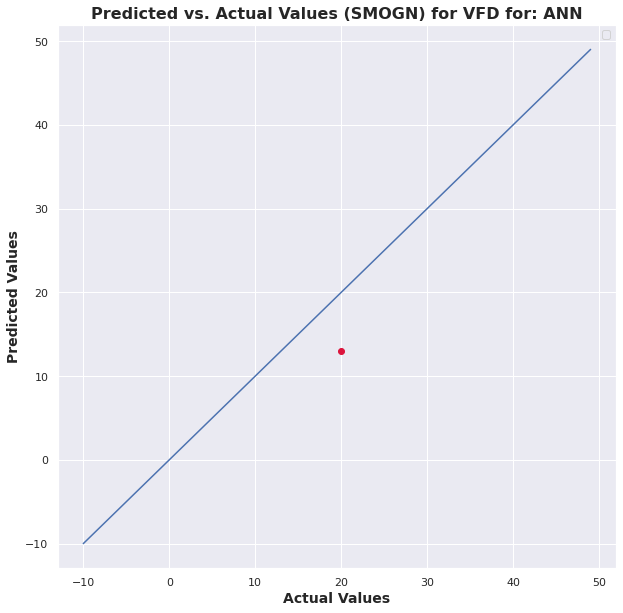

No handles with labels found to put in legend.


MSE: 			115.73690966787254
R-Squared Score: 	-1.6307206243496477


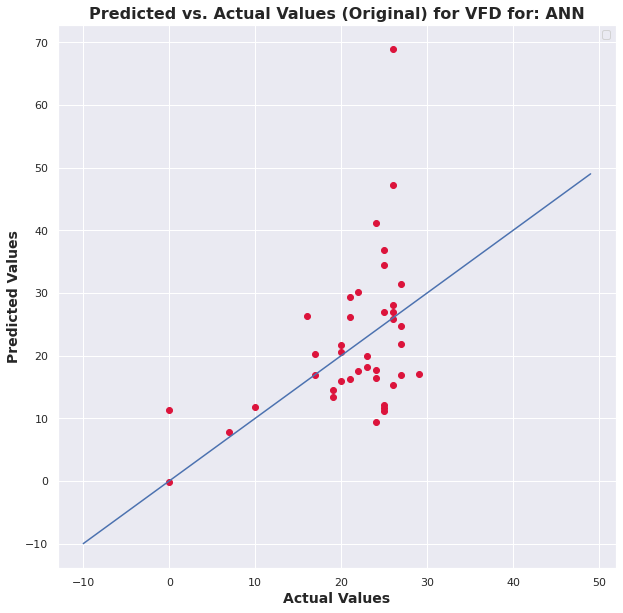

<ipython-input-638-0f79e873448e>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix:   0%|          | 0/12 [00:00<?, ?it/s]

9


r_index: 100%|##########| 8/8 [00:00<00:00, 183.74it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


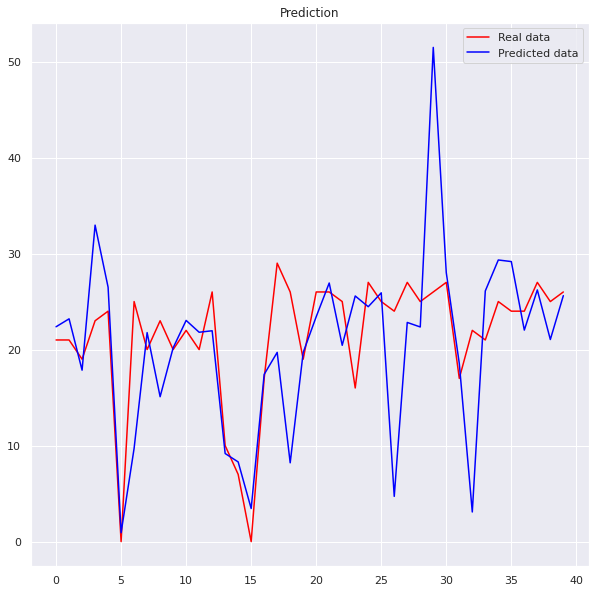

No handles with labels found to put in legend.


MSE: 			3.7964661092246956
R-Squared Score: 	nan


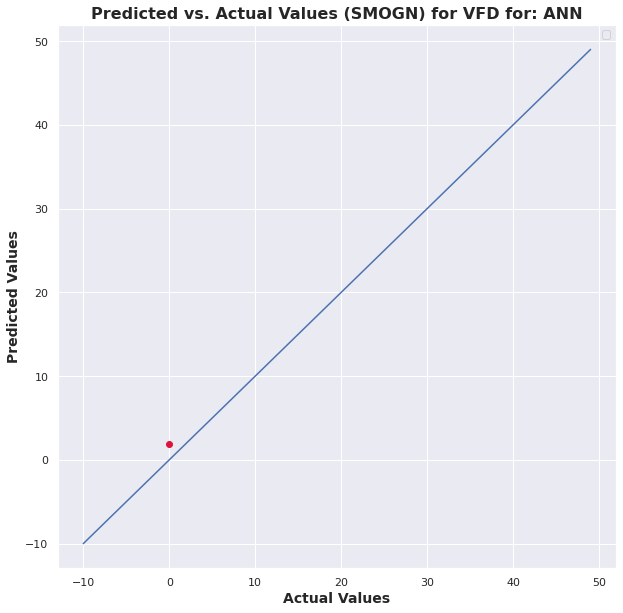

No handles with labels found to put in legend.


MSE: 			61.953140746429064
R-Squared Score: 	-0.4082059523843462


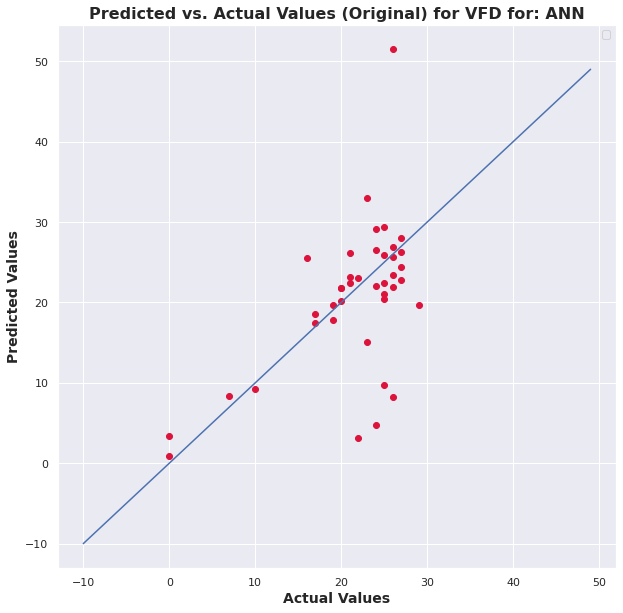

<ipython-input-638-0f79e873448e>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix:   0%|          | 0/12 [00:00<?, ?it/s]

10


r_index: 100%|##########| 8/8 [00:00<00:00, 174.90it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


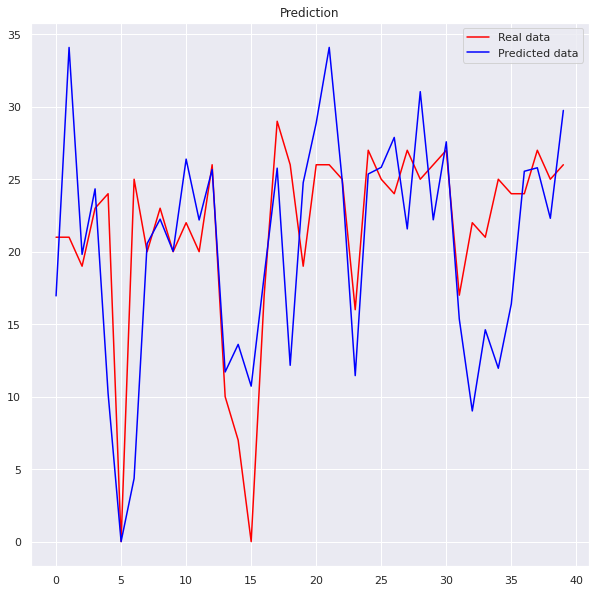

No handles with labels found to put in legend.


MSE: 			219.54649622643865
R-Squared Score: 	nan


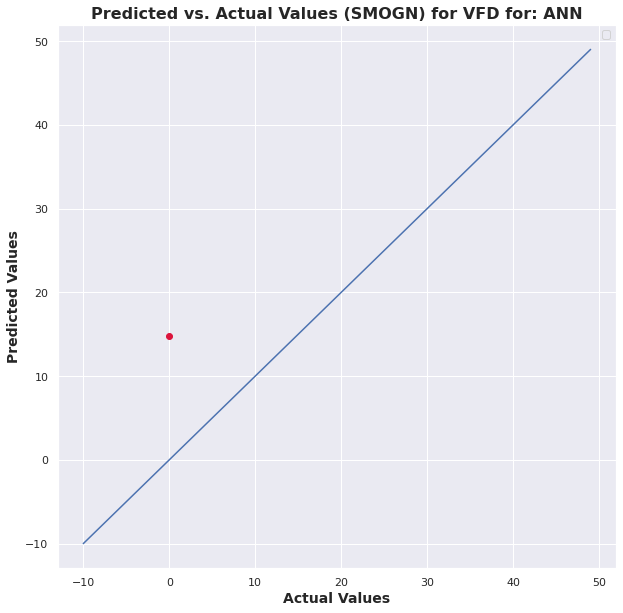

No handles with labels found to put in legend.


MSE: 			47.21277106420184
R-Squared Score: 	-0.07315471726105538


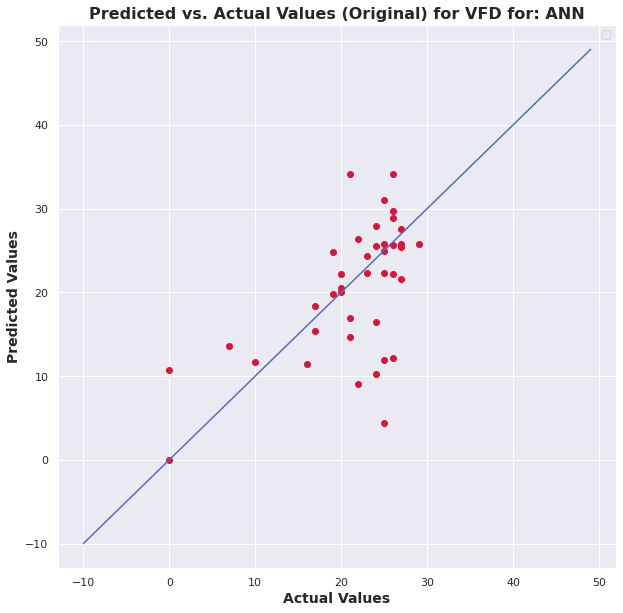

<ipython-input-638-0f79e873448e>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix:   0%|          | 0/12 [00:00<?, ?it/s]

11


r_index: 100%|##########| 8/8 [00:00<00:00, 160.64it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


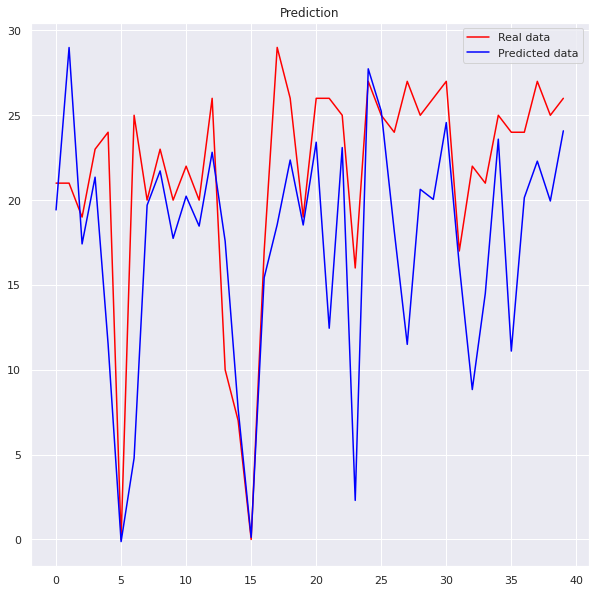

No handles with labels found to put in legend.


MSE: 			73.09743161403821
R-Squared Score: 	nan


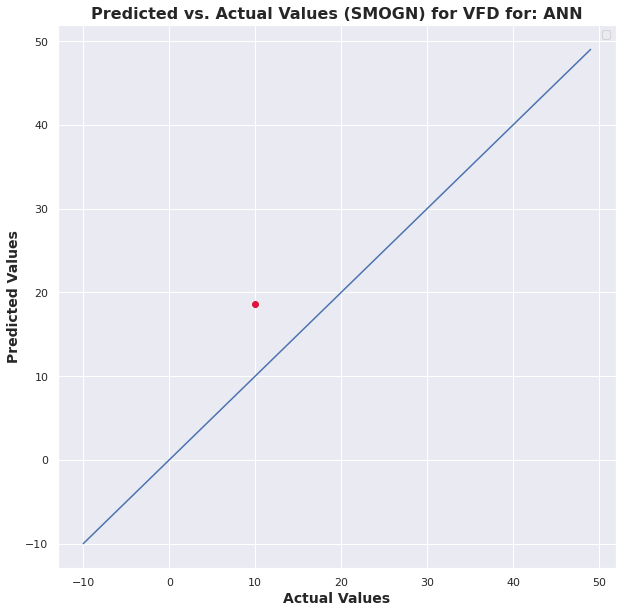

No handles with labels found to put in legend.


MSE: 			50.213936557908134
R-Squared Score: 	-0.1413717448630225


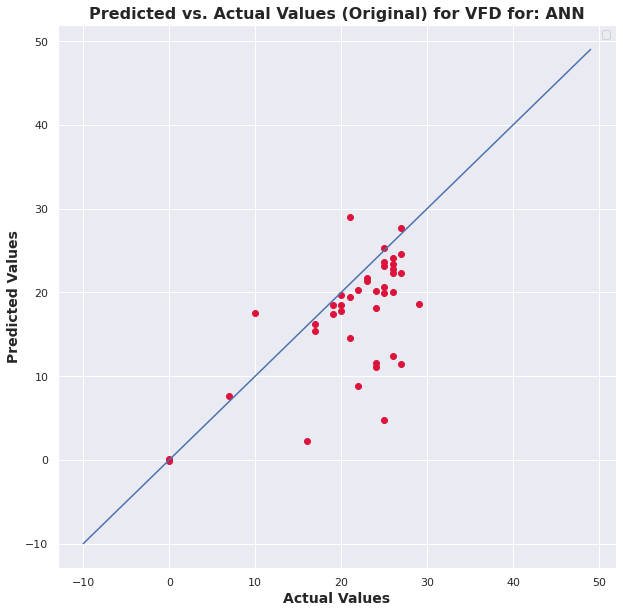

<ipython-input-638-0f79e873448e>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix:   0%|          | 0/12 [00:00<?, ?it/s]

12


r_index: 100%|##########| 8/8 [00:00<00:00, 128.15it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


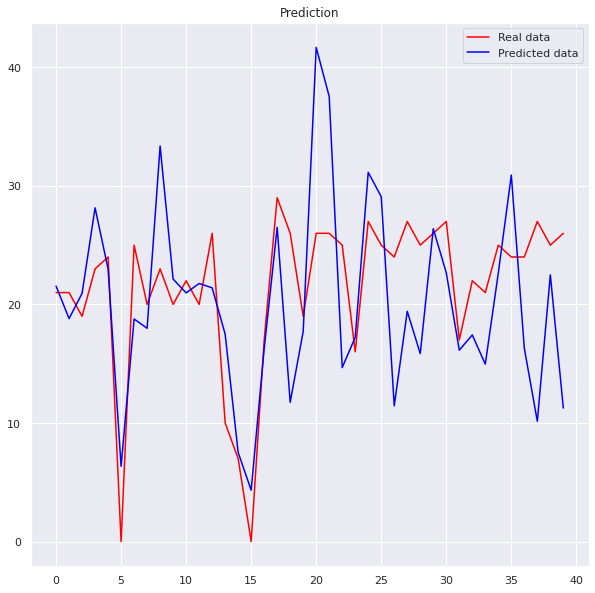

No handles with labels found to put in legend.


MSE: 			172.56320680768476
R-Squared Score: 	nan


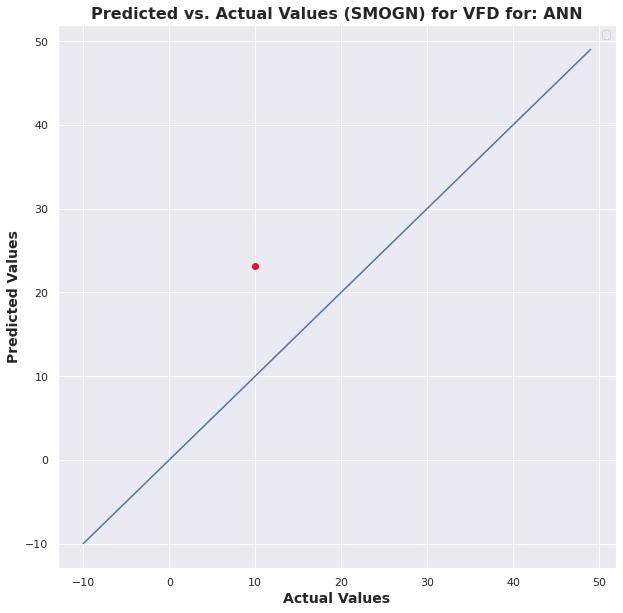

No handles with labels found to put in legend.


MSE: 			51.500156326360226
R-Squared Score: 	-0.17060774988530314


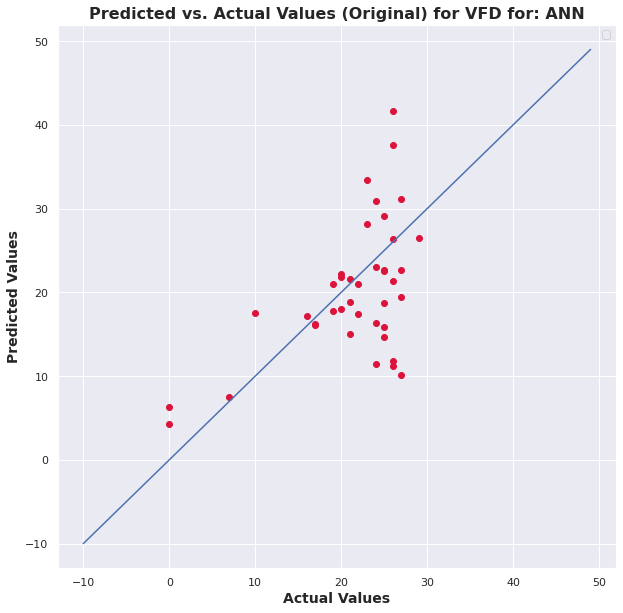

<ipython-input-638-0f79e873448e>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
r_index: 100%|##########| 8/8 [00:00<00:00, 312.78it/s]

13


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


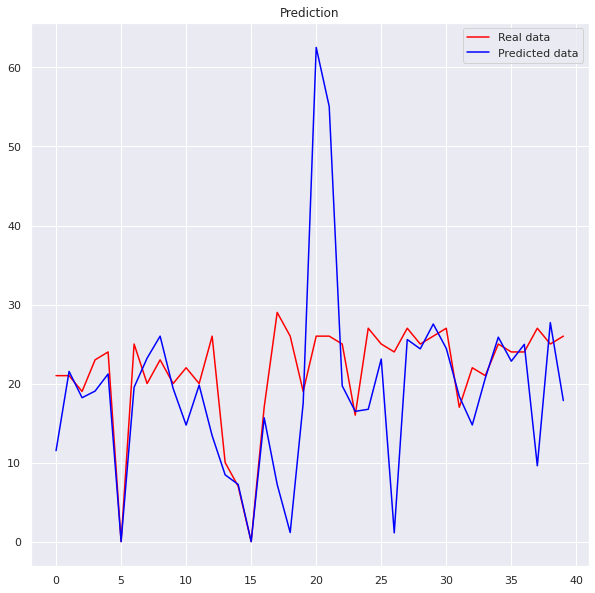

No handles with labels found to put in legend.


MSE: 			1.4028453463688493
R-Squared Score: 	nan


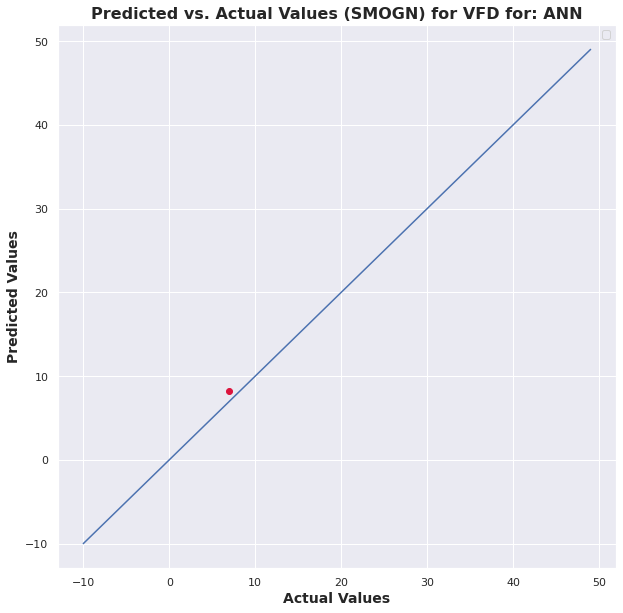

No handles with labels found to put in legend.


MSE: 			118.9999143692276
R-Squared Score: 	-1.7048893038991375


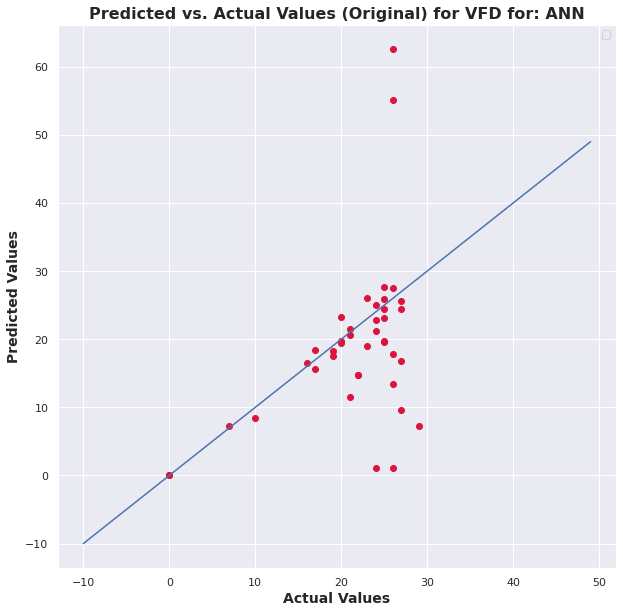

<ipython-input-638-0f79e873448e>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix:   0%|          | 0/12 [00:00<?, ?it/s]

14


r_index: 100%|##########| 8/8 [00:00<00:00, 101.16it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


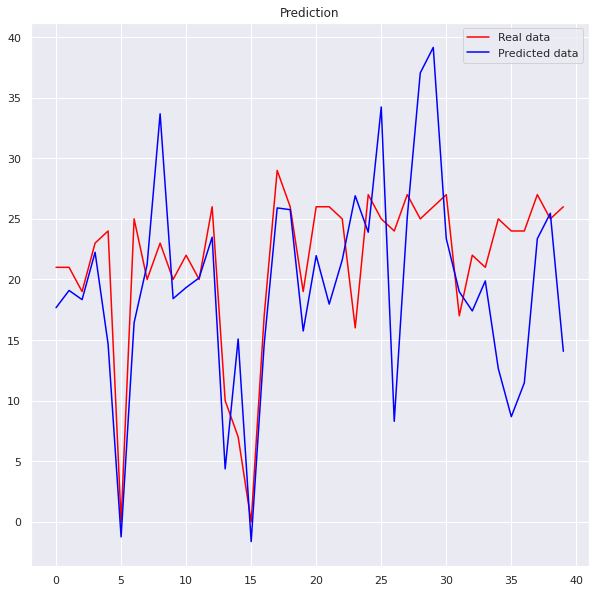

No handles with labels found to put in legend.


MSE: 			128.19641993148616
R-Squared Score: 	nan


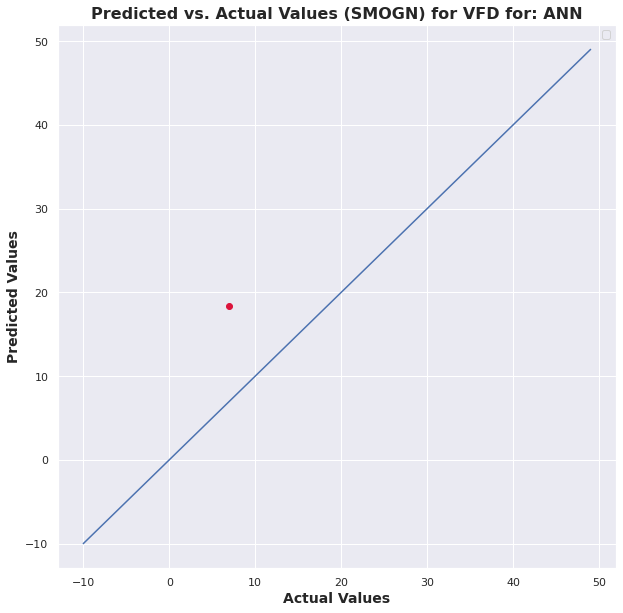

No handles with labels found to put in legend.


MSE: 			51.240557287163504
R-Squared Score: 	-0.16470701736673177


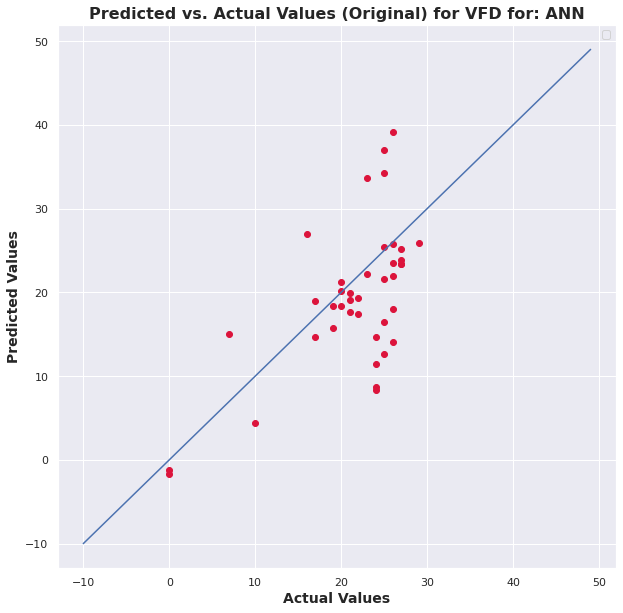

<ipython-input-638-0f79e873448e>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
r_index: 100%|##########| 8/8 [00:00<00:00, 204.85it/s]

15


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


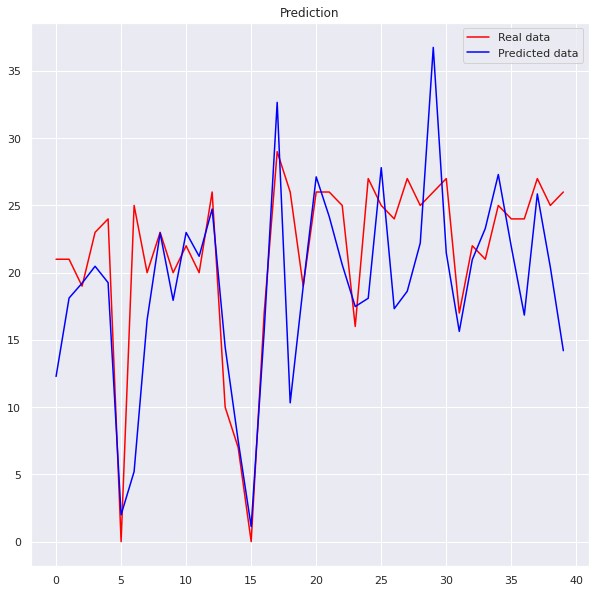

No handles with labels found to put in legend.


MSE: 			6.39742469441353
R-Squared Score: 	nan


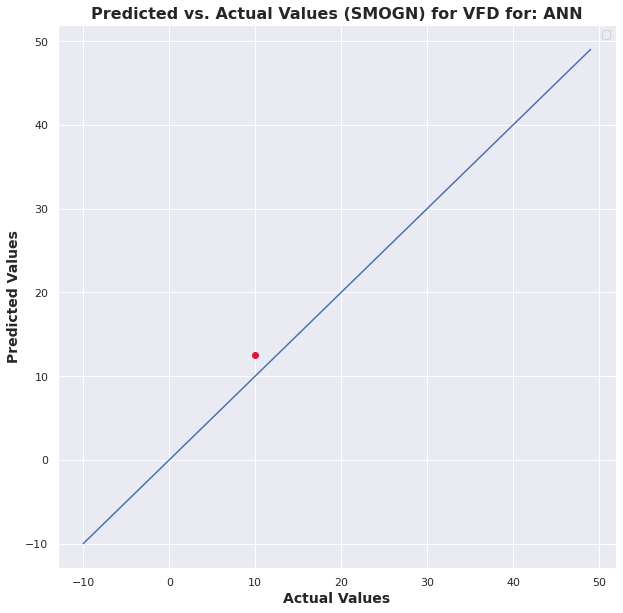

No handles with labels found to put in legend.


MSE: 			35.62584550365976
R-Squared Score: 	0.19021816985331041


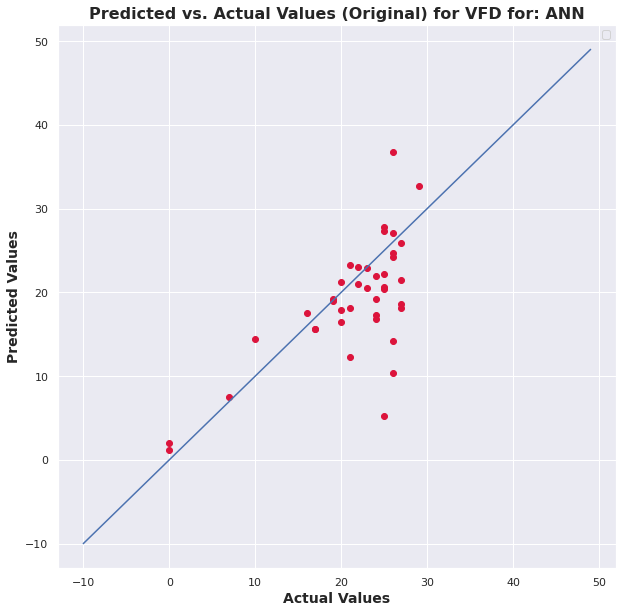

<ipython-input-638-0f79e873448e>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
r_index: 100%|##########| 8/8 [00:00<00:00, 252.79it/s]

16


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


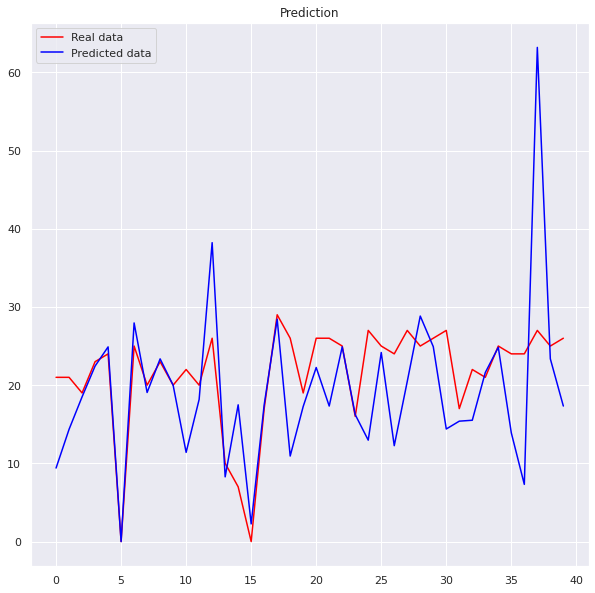

No handles with labels found to put in legend.


MSE: 			151.8490886468826
R-Squared Score: 	nan


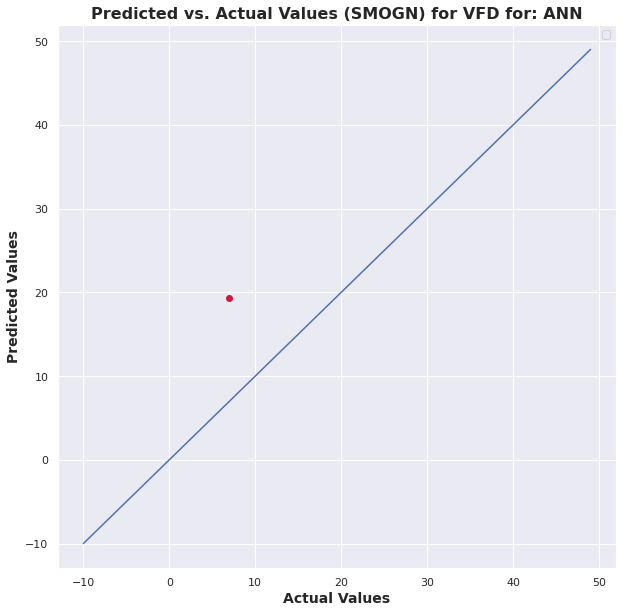

No handles with labels found to put in legend.


MSE: 			81.4665117771137
R-Squared Score: 	-0.8517483604918514


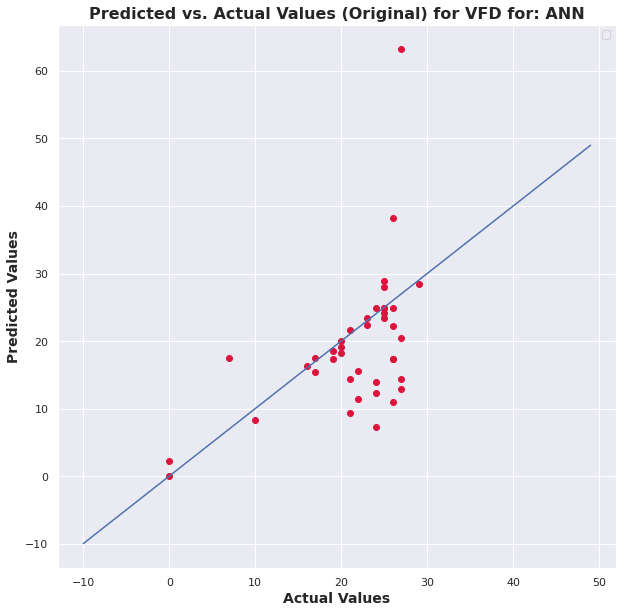

<ipython-input-638-0f79e873448e>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
r_index:   0%|          | 0/8 [00:00<?, ?it/s]

17


r_index: 100%|##########| 8/8 [00:00<00:00, 190.81it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


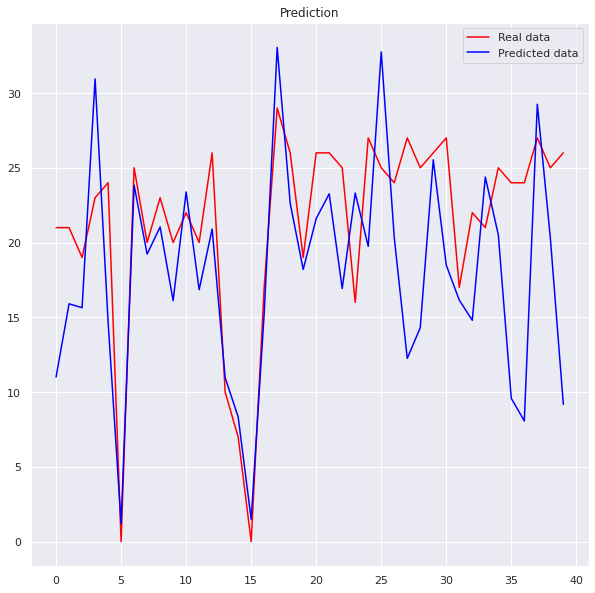

No handles with labels found to put in legend.


MSE: 			0.593855993371367
R-Squared Score: 	nan


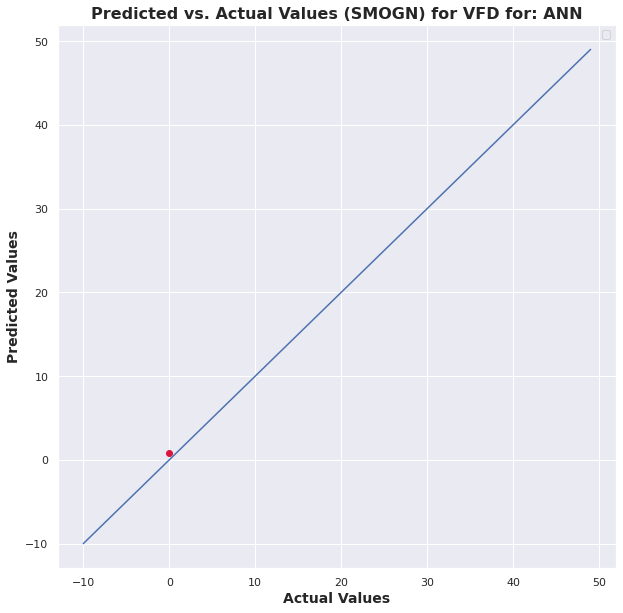

No handles with labels found to put in legend.


MSE: 			47.87571777226056
R-Squared Score: 	-0.08822361432025261


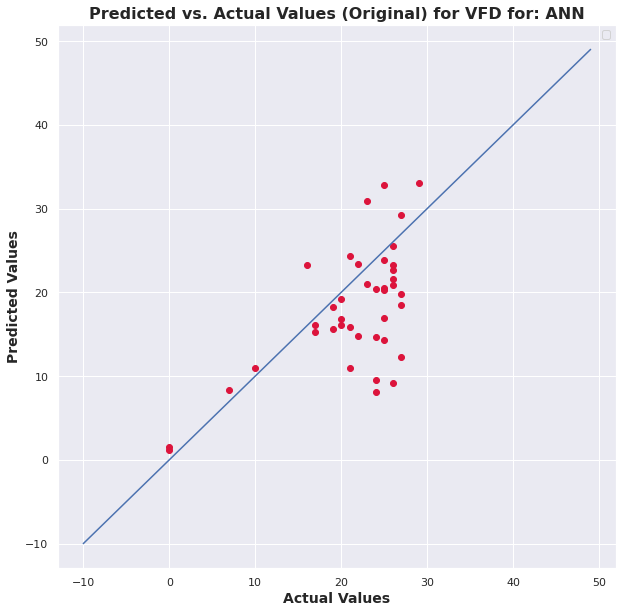

<ipython-input-638-0f79e873448e>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
r_index:   0%|          | 0/8 [00:00<?, ?it/s]

18


r_index: 100%|##########| 8/8 [00:00<00:00, 249.23it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


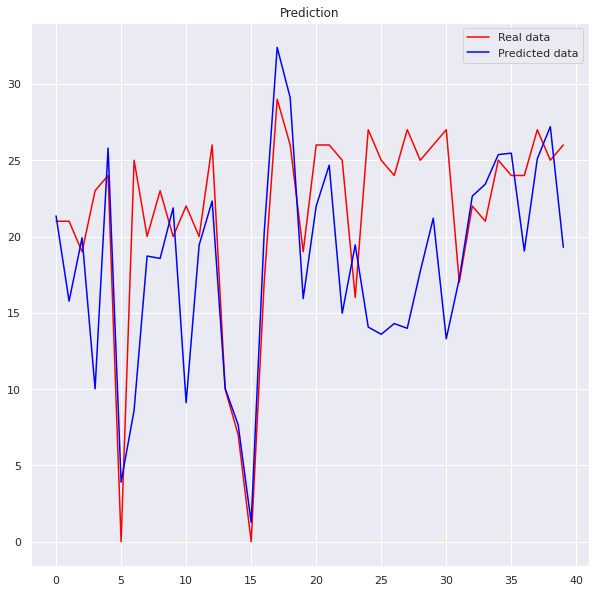

No handles with labels found to put in legend.


MSE: 			1.0158628898352617
R-Squared Score: 	nan


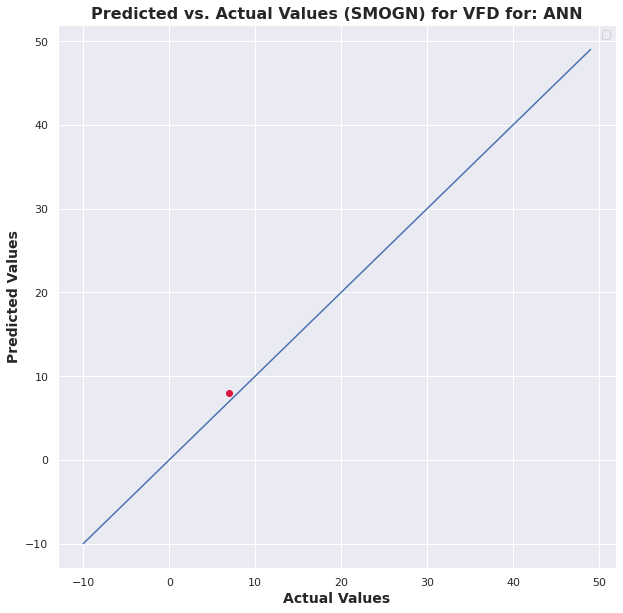

No handles with labels found to put in legend.


MSE: 			44.35042701482185
R-Squared Score: 	-0.008093125878520846


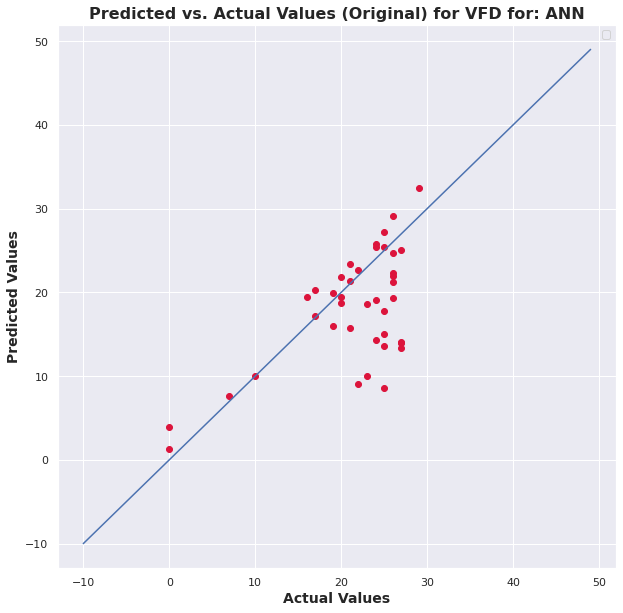

<ipython-input-638-0f79e873448e>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix:   0%|          | 0/12 [00:00<?, ?it/s]

19


r_index: 100%|##########| 8/8 [00:00<00:00, 187.62it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


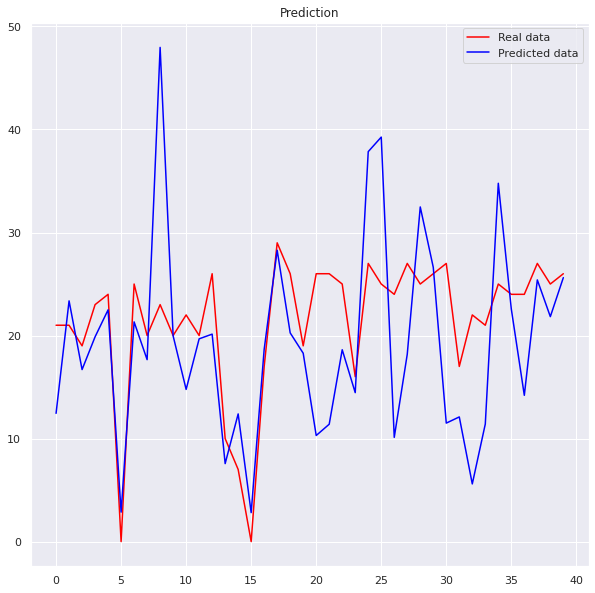

No handles with labels found to put in legend.


MSE: 			139.09390674927272
R-Squared Score: 	nan


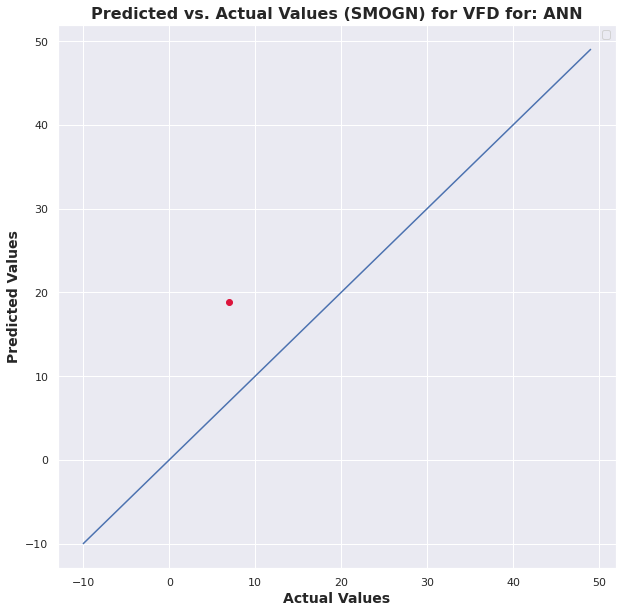

MSE: 			72.39215445571695
R-Squared Score: 	-0.6454865981325328


No handles with labels found to put in legend.


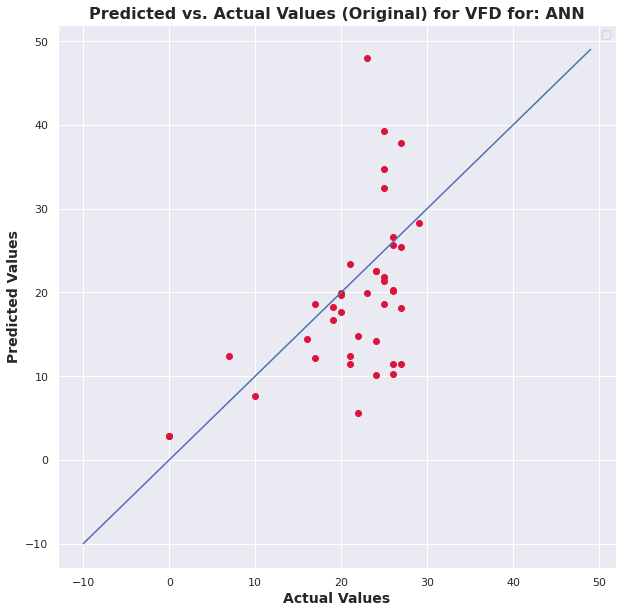

<ipython-input-638-0f79e873448e>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix:   0%|          | 0/12 [00:00<?, ?it/s]

20


r_index: 100%|##########| 8/8 [00:00<00:00, 117.96it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


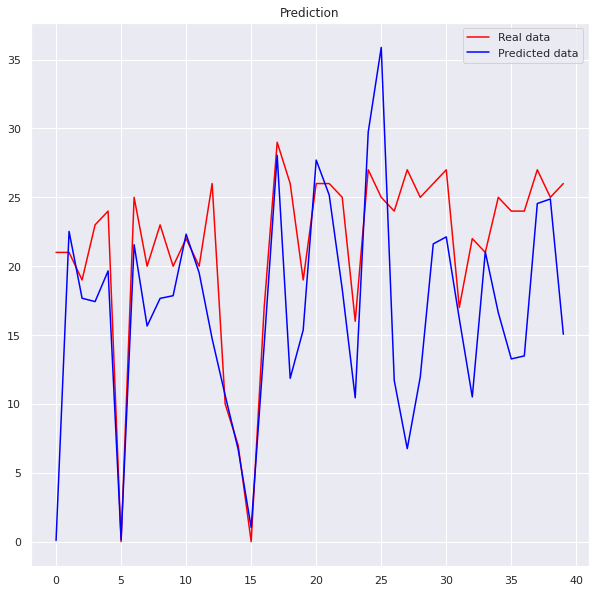

No handles with labels found to put in legend.


MSE: 			0.16036420543628083
R-Squared Score: 	nan


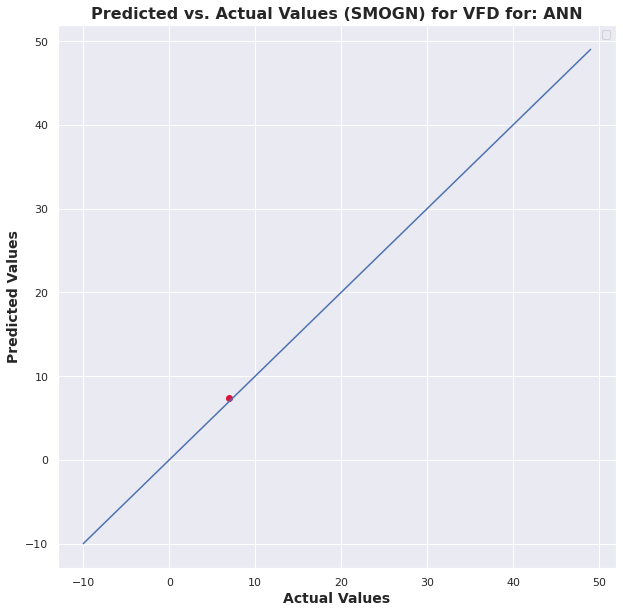

No handles with labels found to put in legend.


MSE: 			61.00141498635268
R-Squared Score: 	-0.38657305590436697


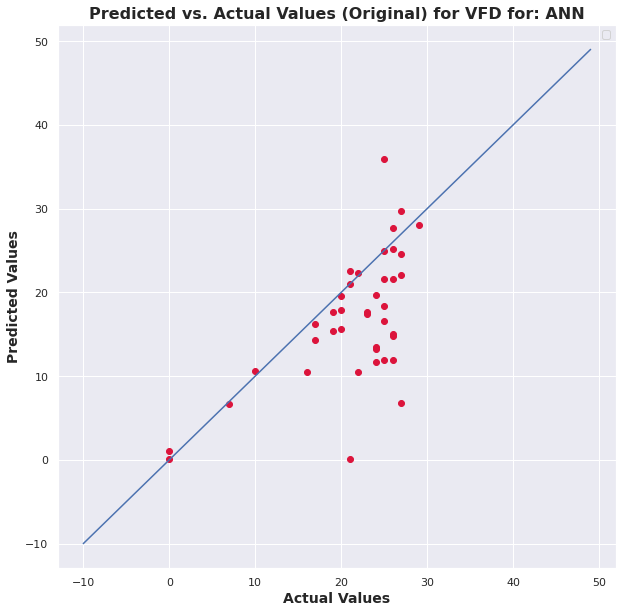

<ipython-input-638-0f79e873448e>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
r_index:   0%|          | 0/8 [00:00<?, ?it/s]

21


r_index: 100%|##########| 8/8 [00:00<00:00, 216.21it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


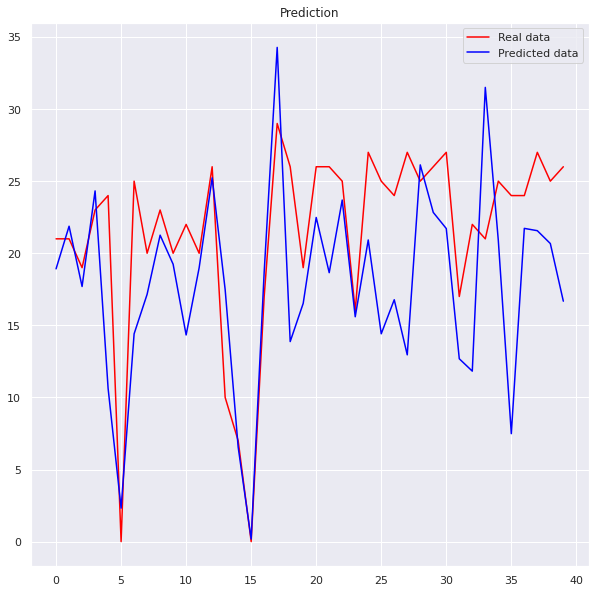

No handles with labels found to put in legend.


MSE: 			69.77319326257566
R-Squared Score: 	nan


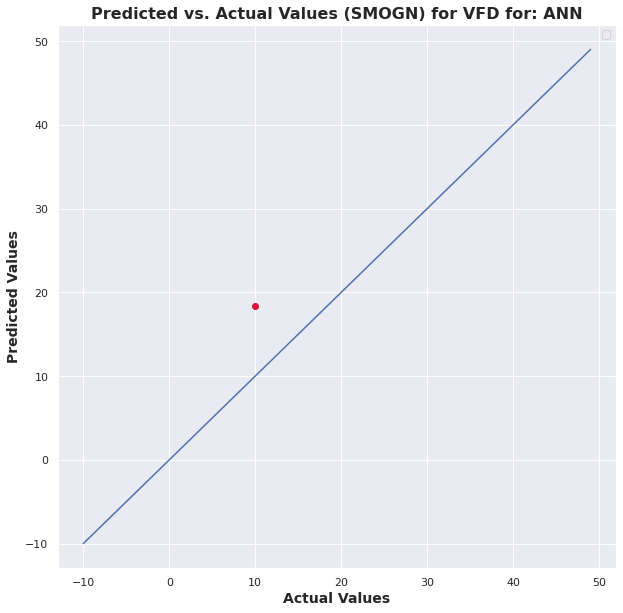

MSE: 			44.63917952321055
R-Squared Score: 	-0.014656521957876478


No handles with labels found to put in legend.


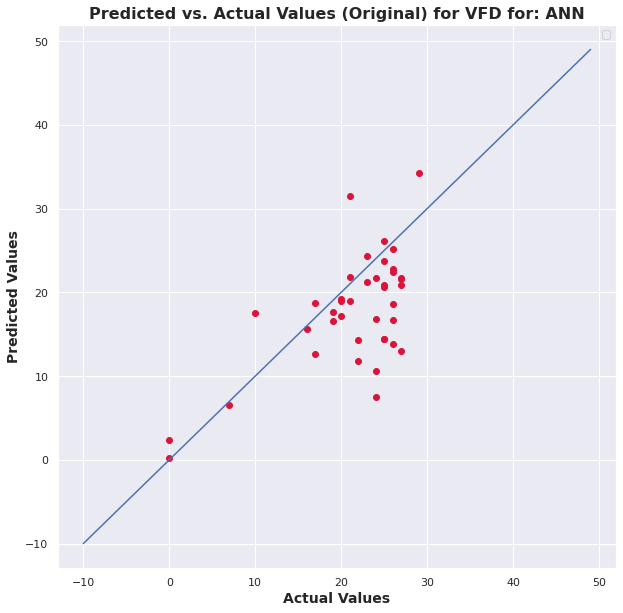

<ipython-input-638-0f79e873448e>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
r_index: 100%|##########| 8/8 [00:00<00:00, 219.53it/s]

22


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


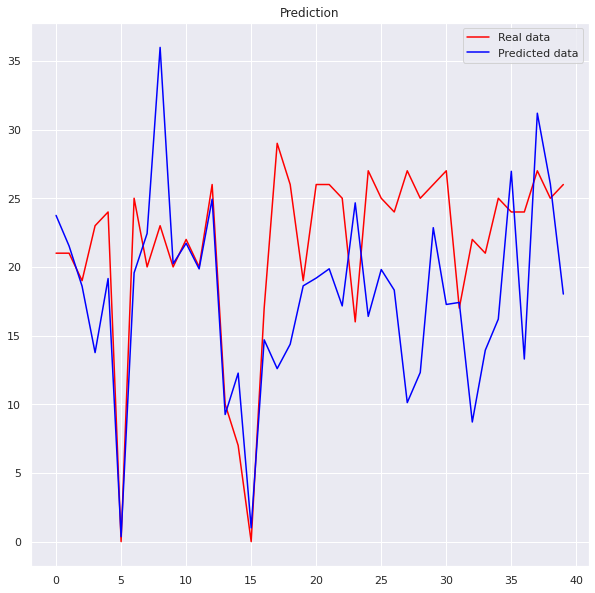

No handles with labels found to put in legend.


MSE: 			0.5663022660066872
R-Squared Score: 	nan


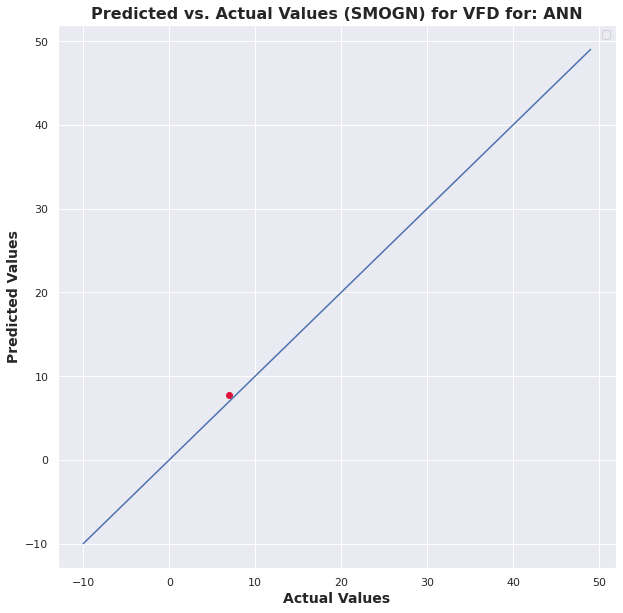

No handles with labels found to put in legend.


MSE: 			55.34871113305019
R-Squared Score: 	-0.25808608789305887


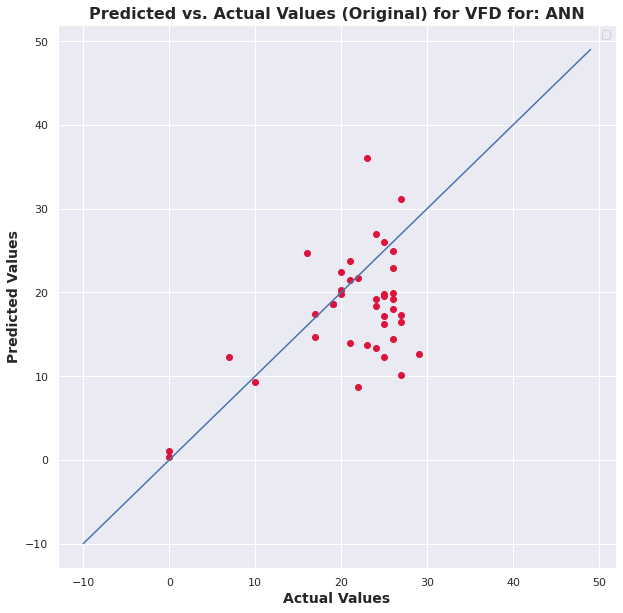

<ipython-input-638-0f79e873448e>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
r_index:   0%|          | 0/8 [00:00<?, ?it/s]

23


r_index: 100%|##########| 8/8 [00:00<00:00, 244.81it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


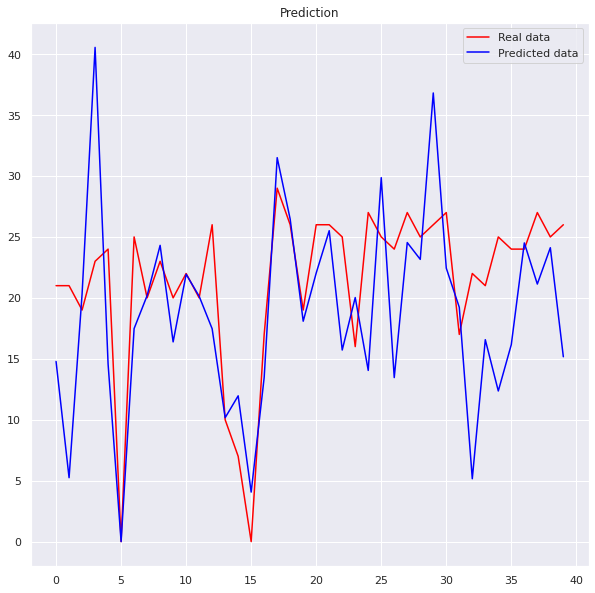

No handles with labels found to put in legend.


MSE: 			58.35319816471838
R-Squared Score: 	nan


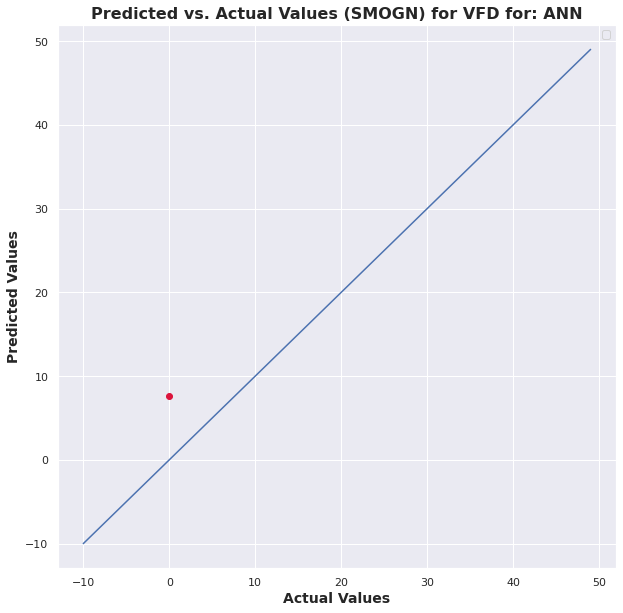

MSE: 			53.52551099125401
R-Squared Score: 	-0.2166444230939526


No handles with labels found to put in legend.


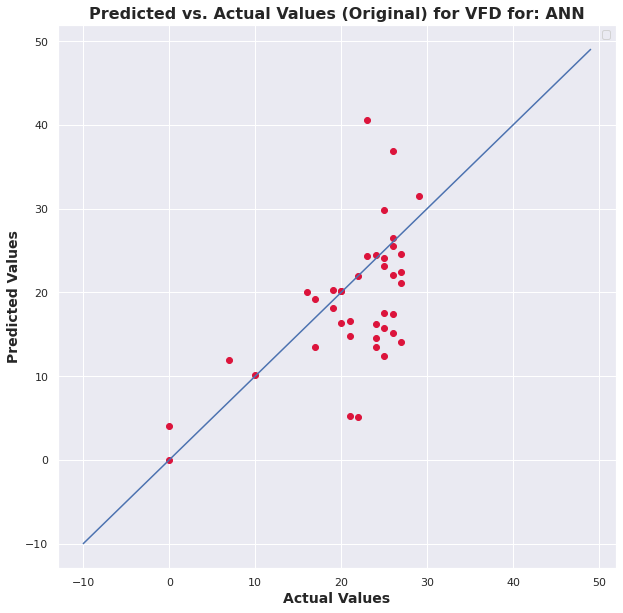

<ipython-input-638-0f79e873448e>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
r_index: 100%|##########| 8/8 [00:00<00:00, 183.06it/s]

24


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


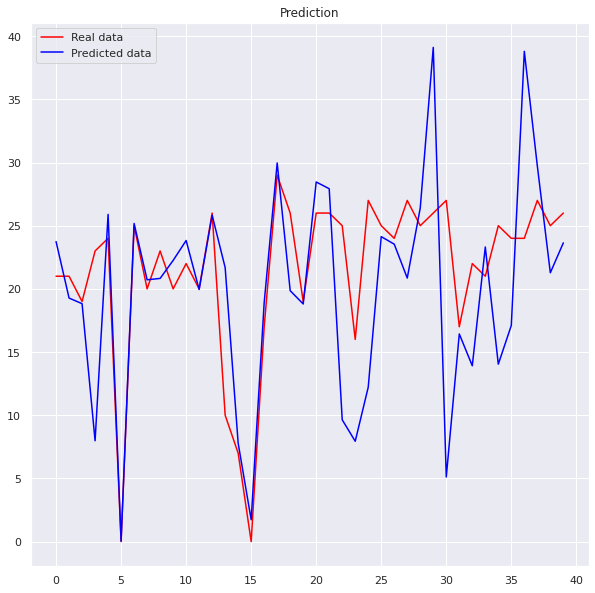

No handles with labels found to put in legend.


MSE: 			131.7811931783799
R-Squared Score: 	nan


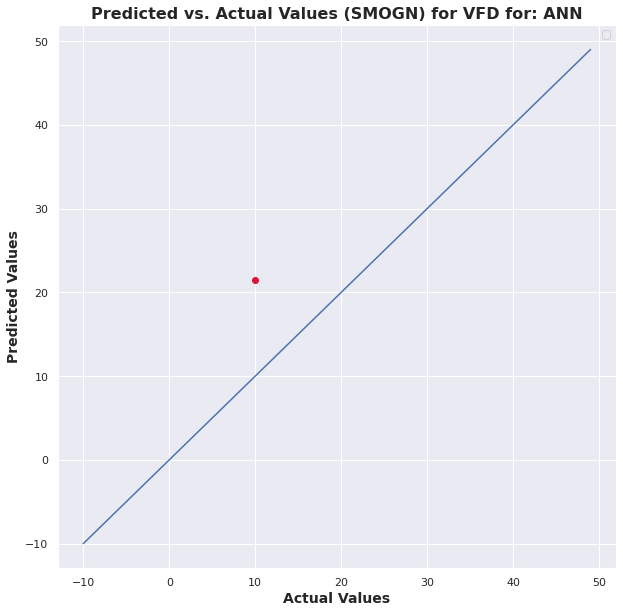

No handles with labels found to put in legend.


MSE: 			53.53483297182477
R-Squared Score: 	-0.21685631337698896


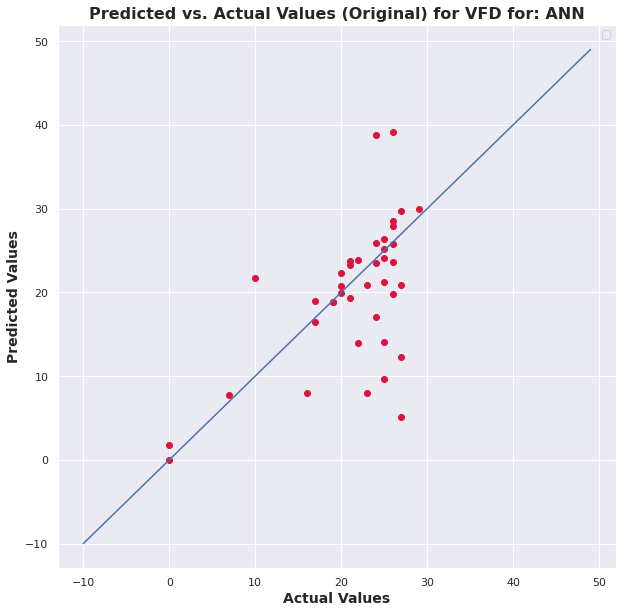

<ipython-input-638-0f79e873448e>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
r_index: 100%|##########| 8/8 [00:00<00:00, 174.81it/s]

25


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


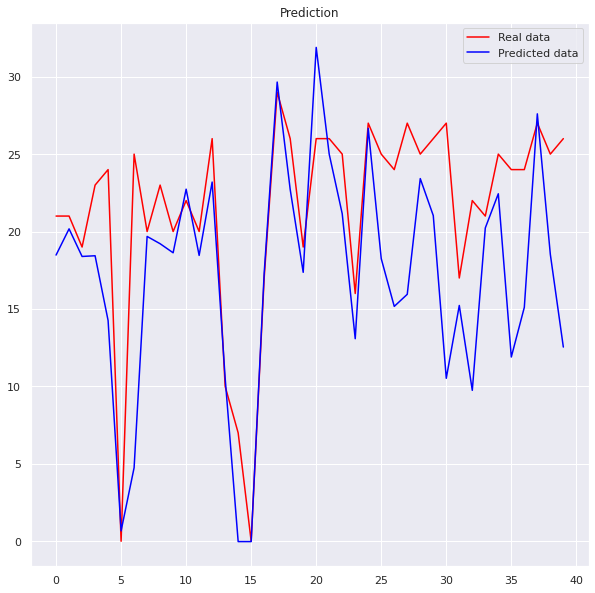

No handles with labels found to put in legend.


MSE: 			38.32980631490415
R-Squared Score: 	nan


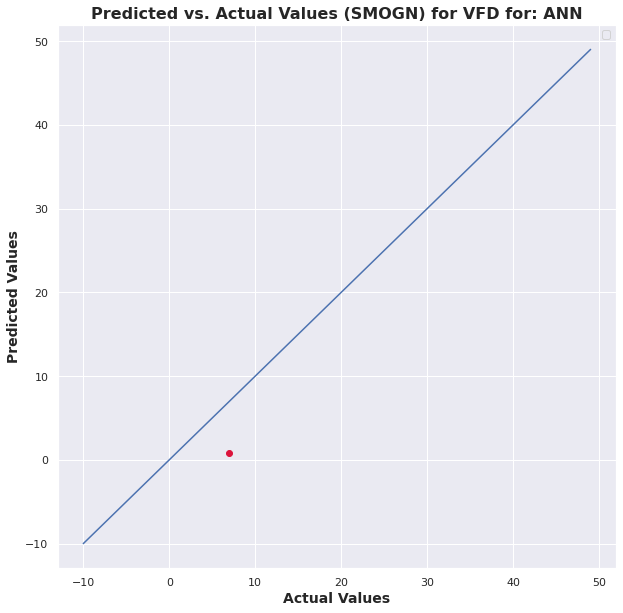

No handles with labels found to put in legend.


MSE: 			45.934488029044545
R-Squared Score: 	-0.044099115603859707


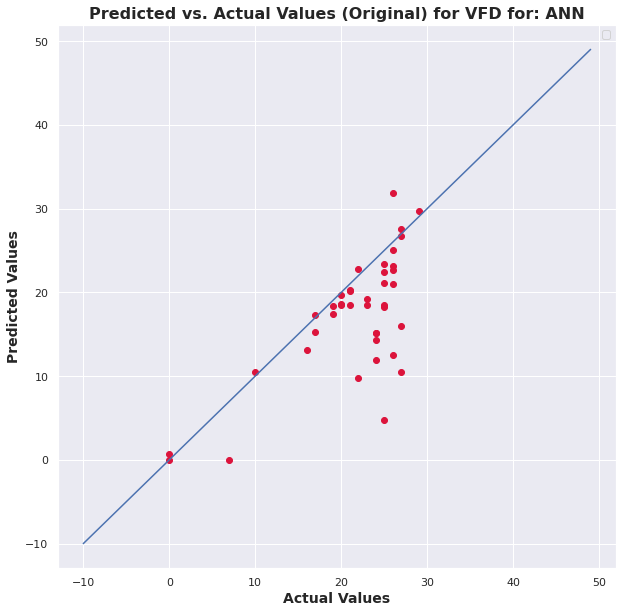

<ipython-input-638-0f79e873448e>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
r_index:   0%|          | 0/8 [00:00<?, ?it/s]

26


r_index: 100%|##########| 8/8 [00:00<00:00, 213.35it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


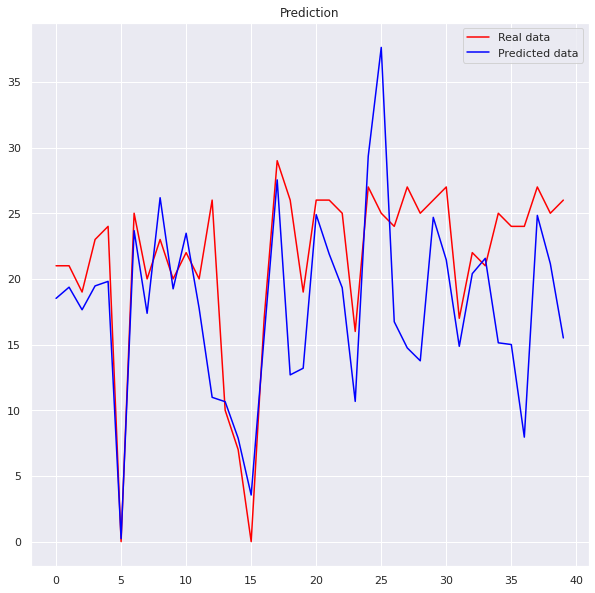

No handles with labels found to put in legend.


MSE: 			4.802704418983922
R-Squared Score: 	nan


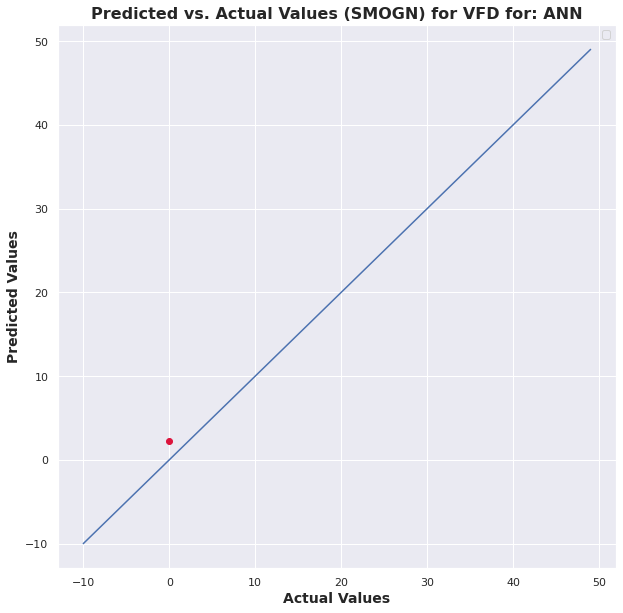

MSE: 			42.47882107005633

No handles with labels found to put in legend.



R-Squared Score: 	0.0344488114660948


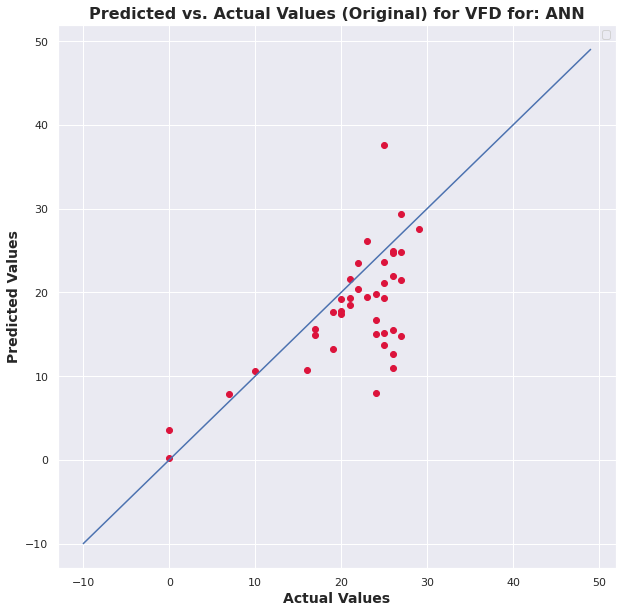

<ipython-input-638-0f79e873448e>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
r_index:   0%|          | 0/8 [00:00<?, ?it/s]

27


r_index: 100%|##########| 8/8 [00:00<00:00, 183.85it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


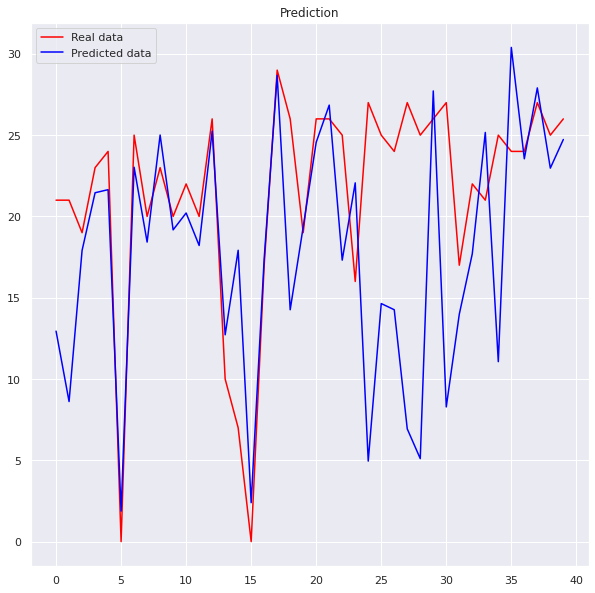

No handles with labels found to put in legend.


MSE: 			210.57309728430482
R-Squared Score: 	nan


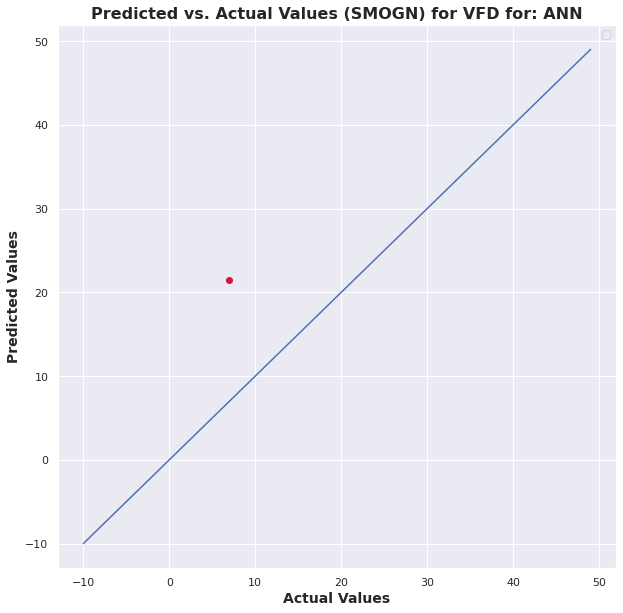

No handles with labels found to put in legend.


MSE: 			68.62381930124324
R-Squared Score: 	-0.559831667144794


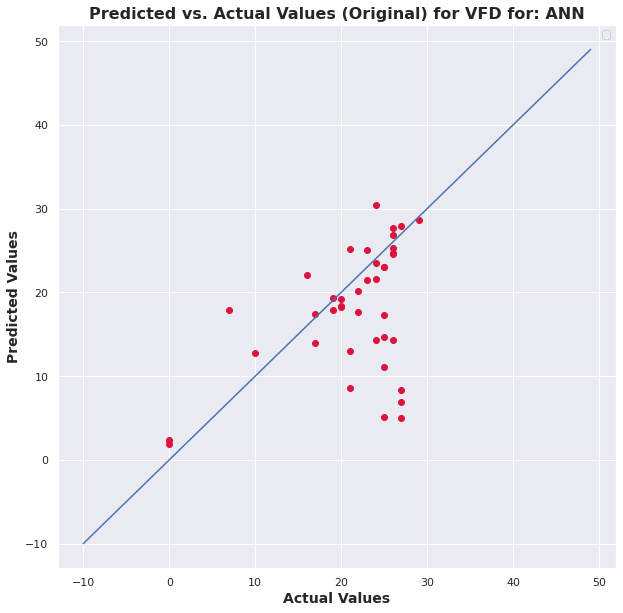

<ipython-input-638-0f79e873448e>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix: 100%|##########| 12/12 [00:00<00:00, 112.21it/s]

28



r_index: 100%|##########| 8/8 [00:00<00:00, 172.89it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


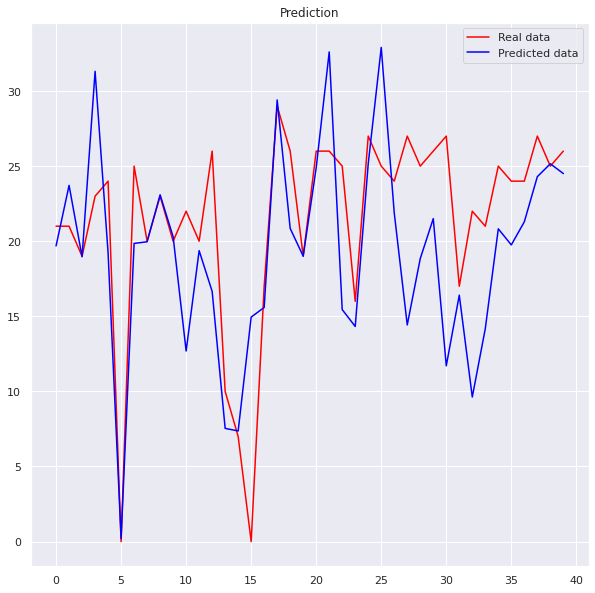

No handles with labels found to put in legend.


MSE: 			340.47256101578023
R-Squared Score: 	nan


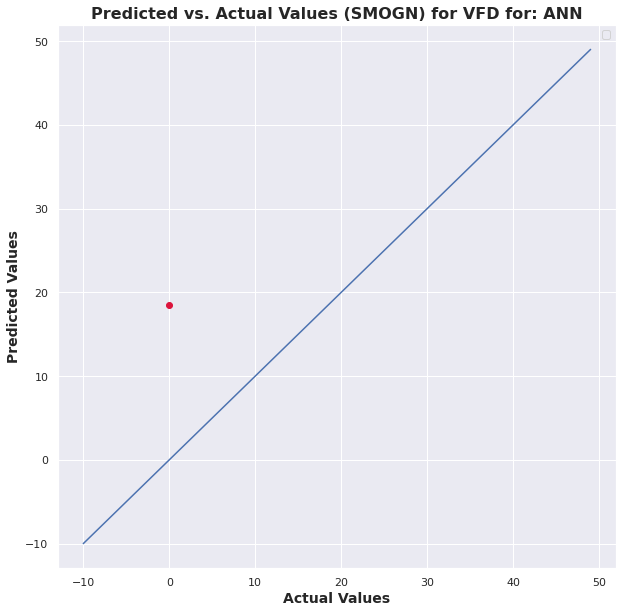

No handles with labels found to put in legend.


MSE: 			36.80018933513527
R-Squared Score: 	0.1635251248566374


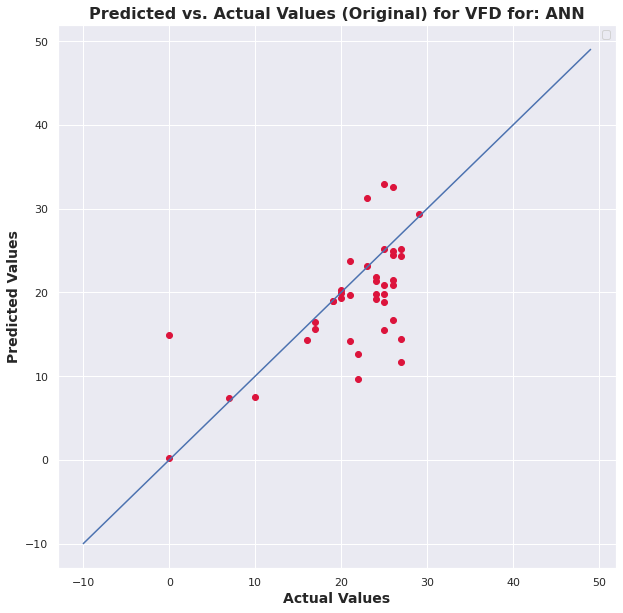

<ipython-input-638-0f79e873448e>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix: 100%|##########| 12/12 [00:00<00:00, 105.07it/s]

29



r_index: 100%|##########| 8/8 [00:00<00:00, 191.29it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


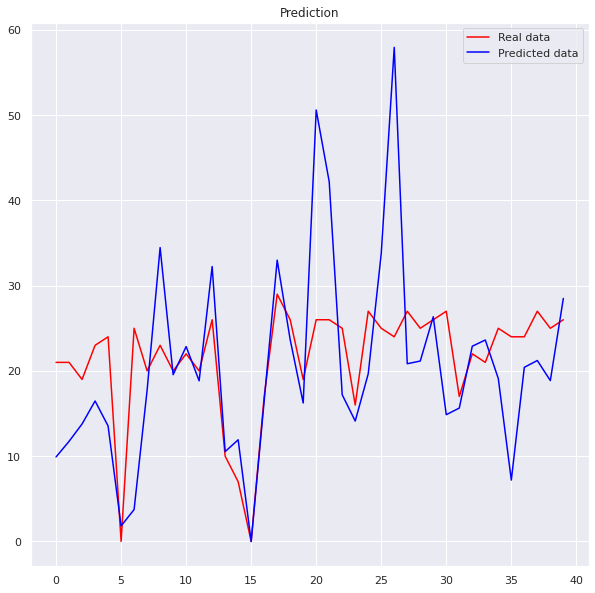

No handles with labels found to put in legend.


MSE: 			26.171594051425927
R-Squared Score: 	nan


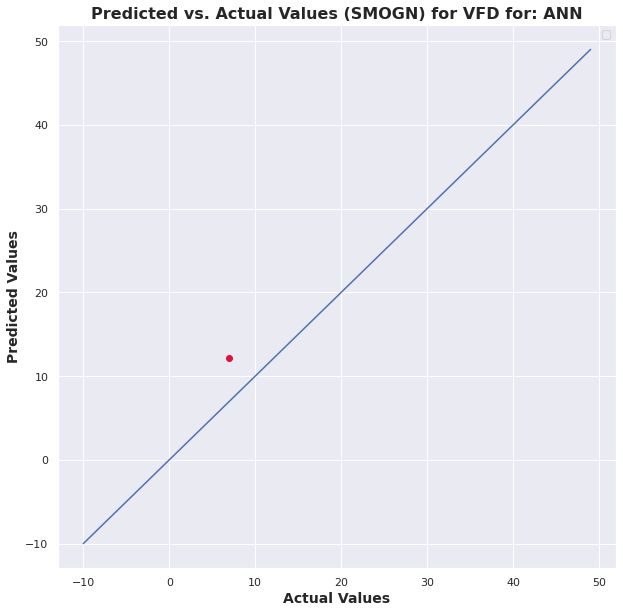

No handles with labels found to put in legend.


MSE: 			97.65069706453474
R-Squared Score: 	-1.2196177821490761


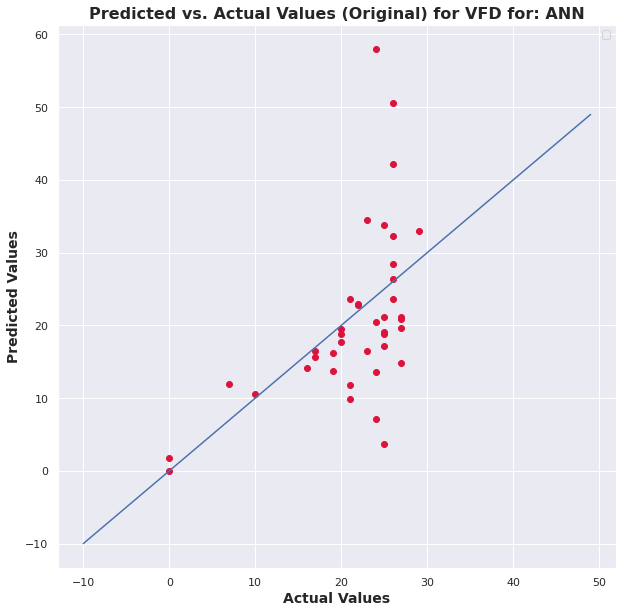

30


<ipython-input-638-0f79e873448e>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
r_index: 100%|##########| 8/8 [00:00<00:00, 193.07it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


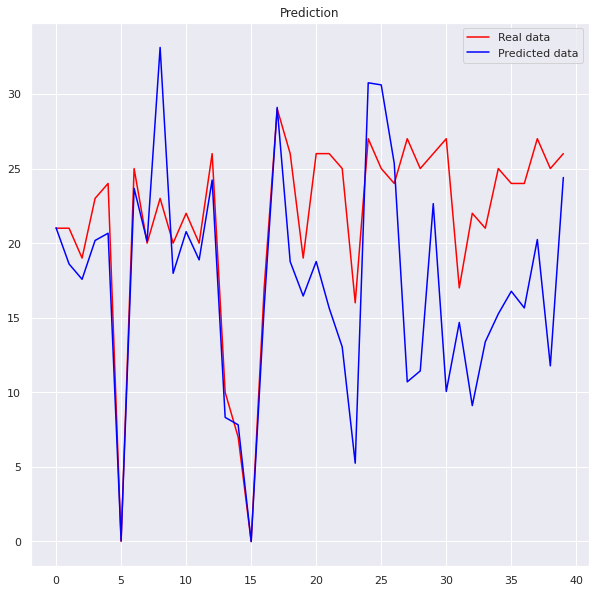

No handles with labels found to put in legend.


MSE: 			2.8240322732826826
R-Squared Score: 	nan


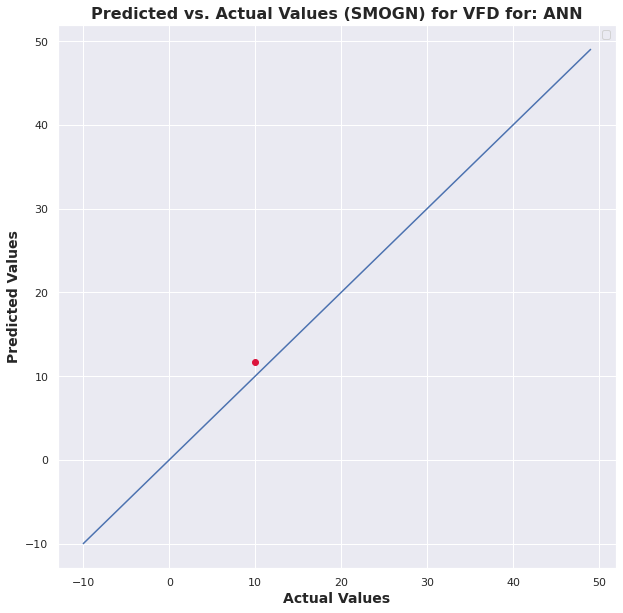

No handles with labels found to put in legend.


MSE: 			52.207438679929076
R-Squared Score: 	-0.18668440408413756


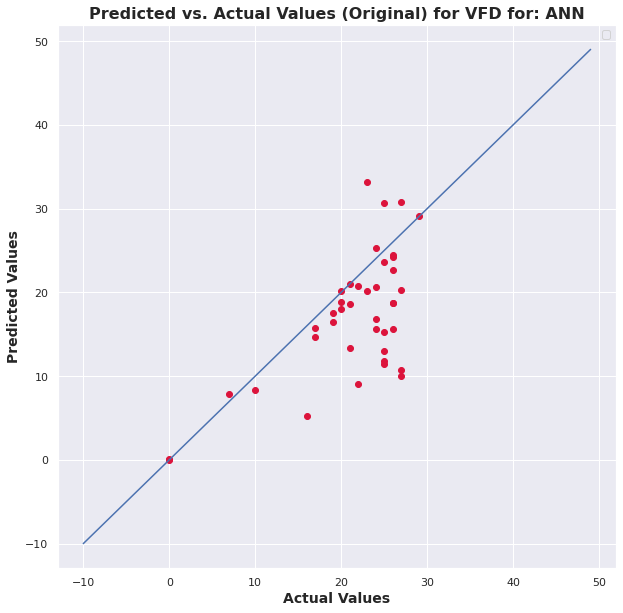

31


<ipython-input-638-0f79e873448e>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
r_index: 100%|##########| 8/8 [00:00<00:00, 177.51it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


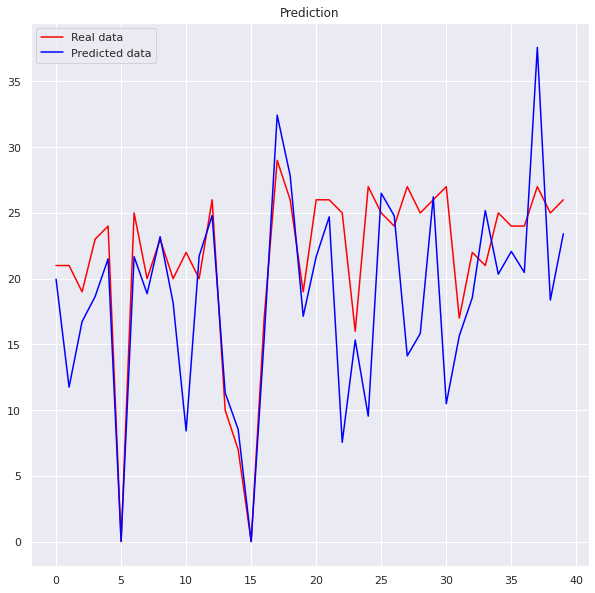

No handles with labels found to put in legend.


MSE: 			23.177122361084912
R-Squared Score: 	nan


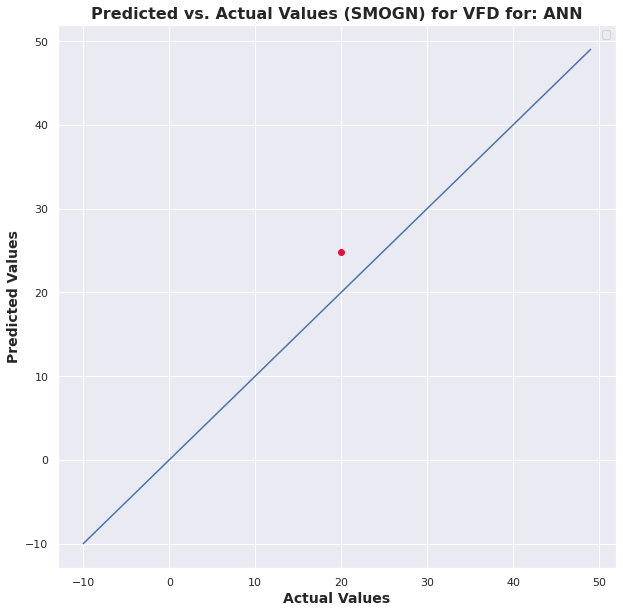

MSE: 			43.35487976336599
R-Squared Score: 	0.014535840925891108


No handles with labels found to put in legend.


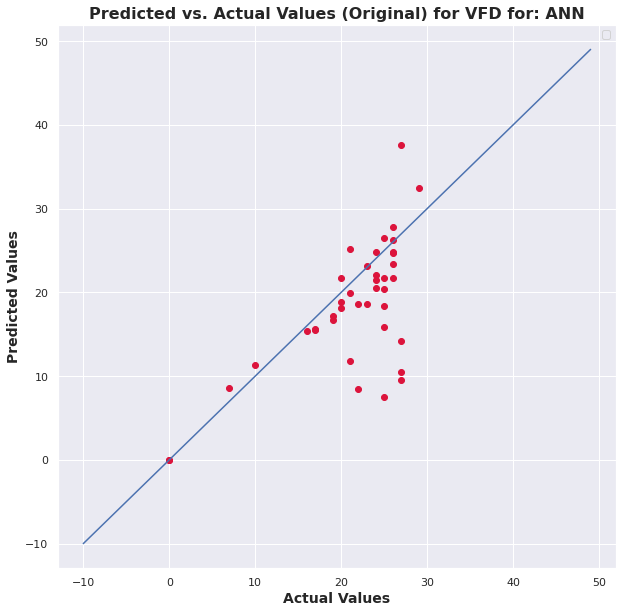

<ipython-input-638-0f79e873448e>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix:  92%|#########1| 11/12 [00:00<00:00, 103.86it/s]

32


r_index: 100%|##########| 8/8 [00:00<00:00, 172.58it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


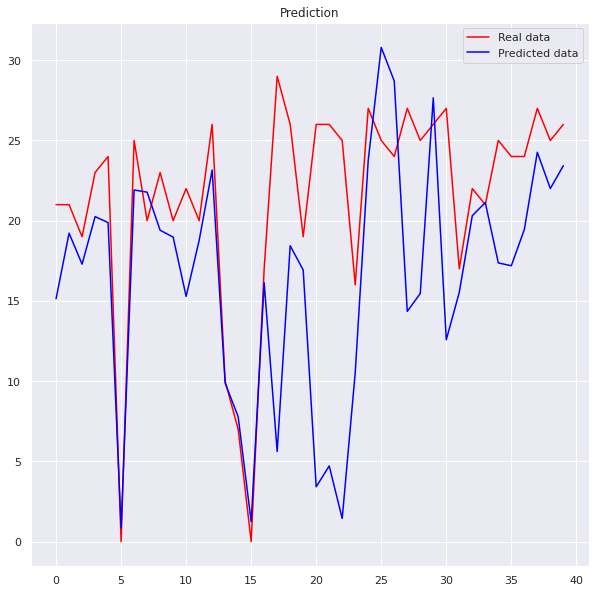

No handles with labels found to put in legend.


MSE: 			1.9362815286594923
R-Squared Score: 	nan


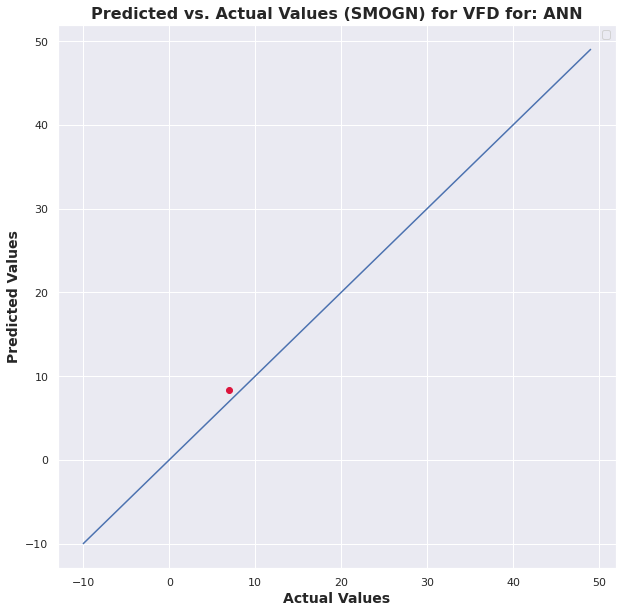

No handles with labels found to put in legend.


MSE: 			74.70034394169647
R-Squared Score: 	-0.6979521573313969


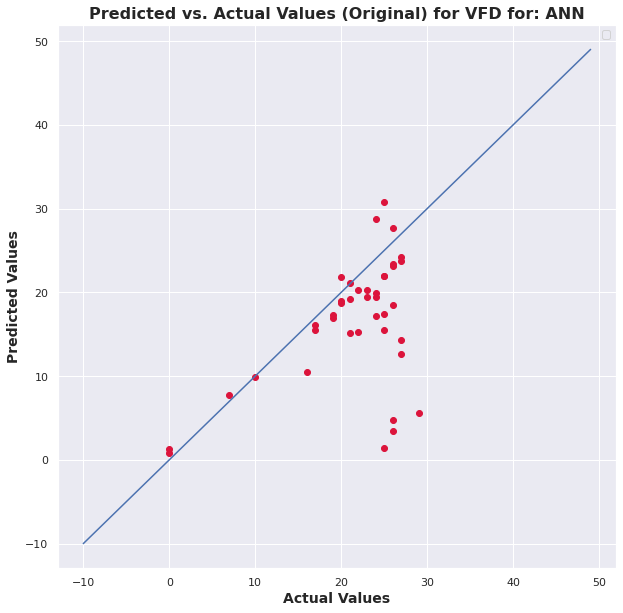

<ipython-input-638-0f79e873448e>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix:   0%|          | 0/12 [00:00<?, ?it/s]

33


r_index: 100%|##########| 8/8 [00:00<00:00, 159.00it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


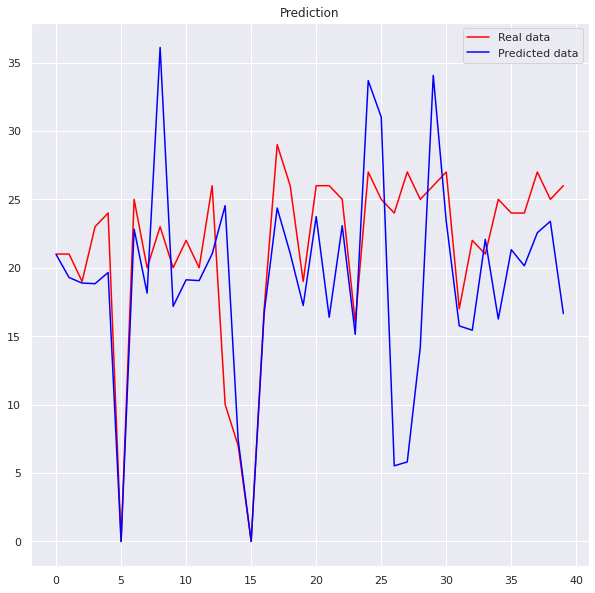

No handles with labels found to put in legend.


MSE: 			479.30167981632985
R-Squared Score: 	nan


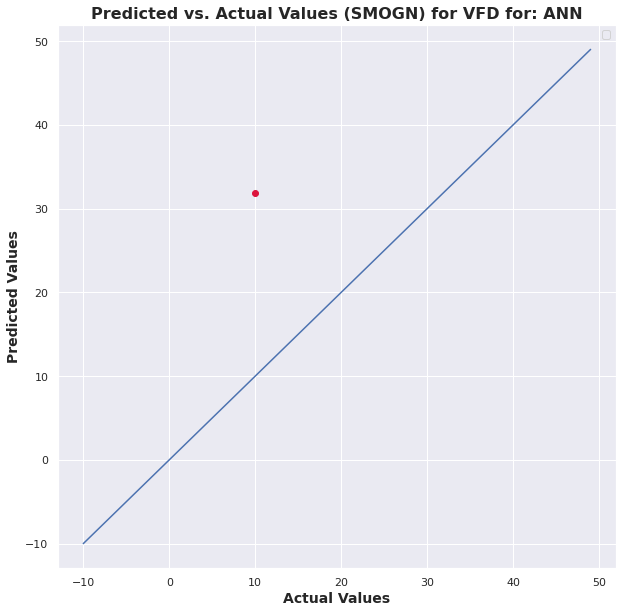

No handles with labels found to put in legend.


MSE: 			48.64582083674328
R-Squared Score: 	-0.10572819449630289


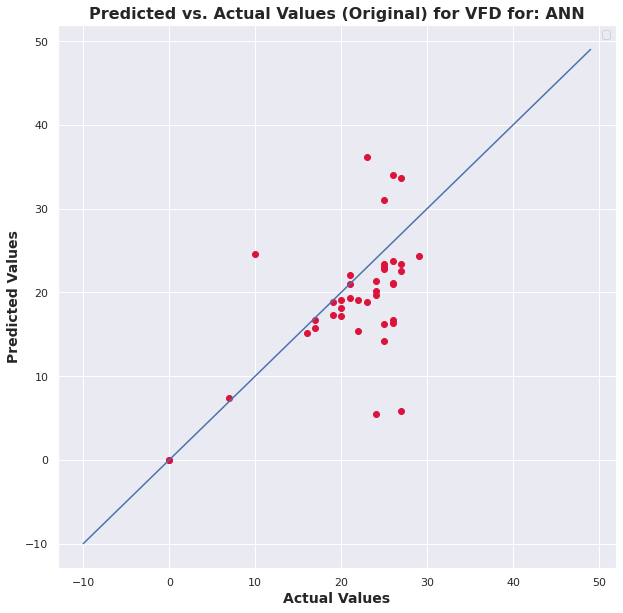

<ipython-input-638-0f79e873448e>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix:  75%|#######5  | 9/12 [00:00<00:00, 87.97it/s]

34


r_index: 100%|##########| 8/8 [00:00<00:00, 110.97it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


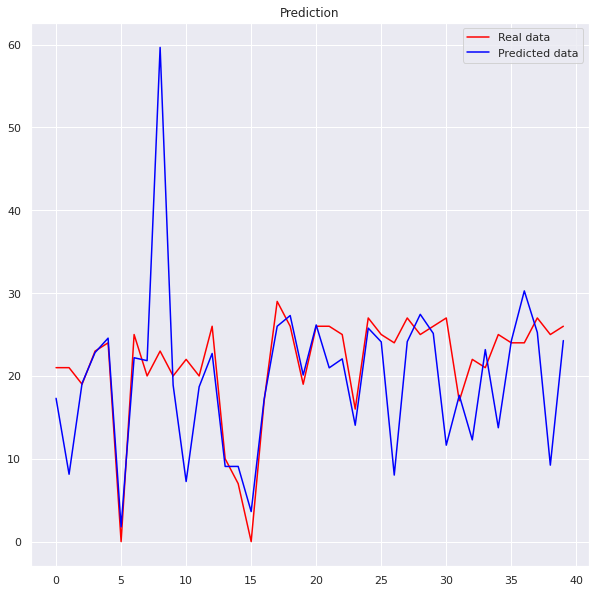

No handles with labels found to put in legend.


MSE: 			3.5638099120052544
R-Squared Score: 	nan


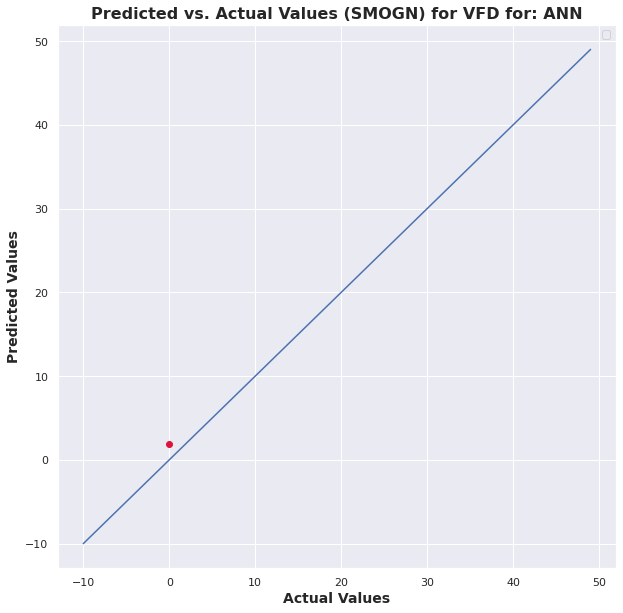

No handles with labels found to put in legend.


MSE: 			71.65316009576759
R-Squared Score: 	-0.6286891243657307


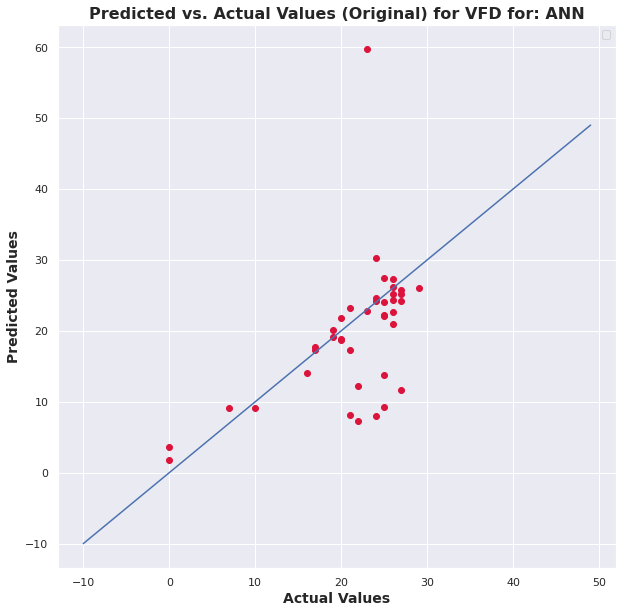

<ipython-input-638-0f79e873448e>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix:   0%|          | 0/12 [00:00<?, ?it/s]

35


r_index: 100%|##########| 8/8 [00:00<00:00, 83.39it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


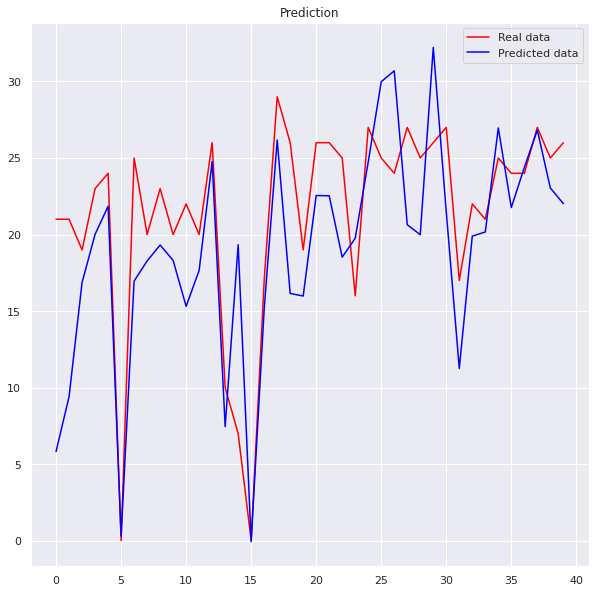

No handles with labels found to put in legend.


MSE: 			439.1930816417189
R-Squared Score: 	nan


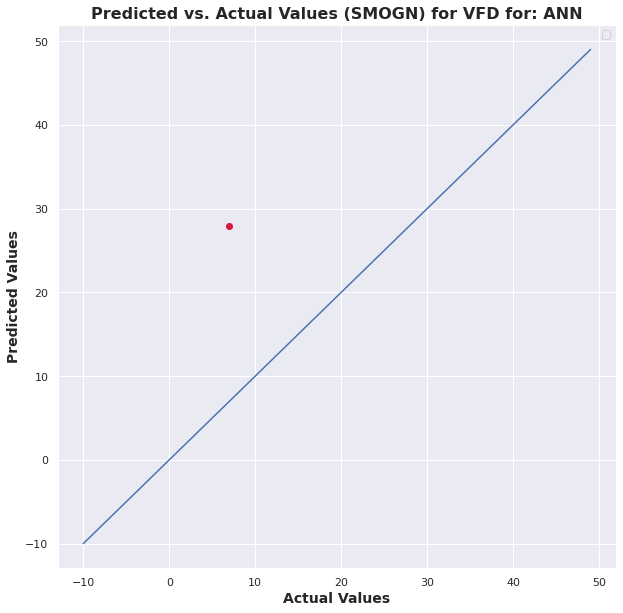

No handles with labels found to put in legend.


MSE: 			28.78665403664717
R-Squared Score: 	0.3456742132000472


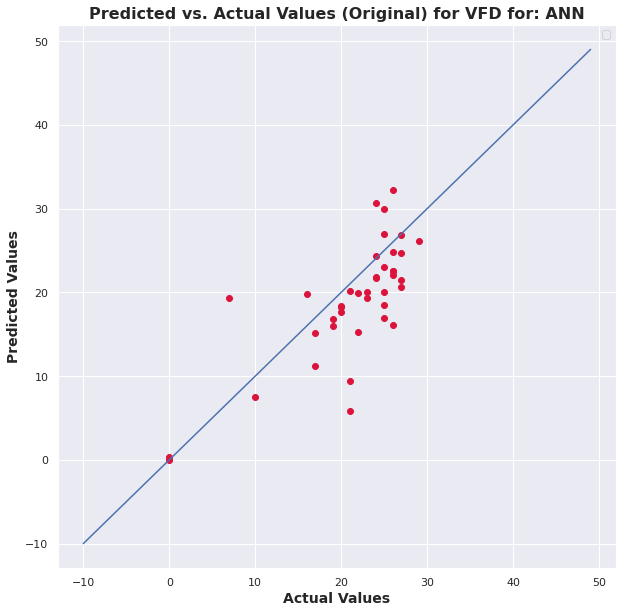

<ipython-input-638-0f79e873448e>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix:   0%|          | 0/12 [00:00<?, ?it/s]

36


r_index: 100%|##########| 8/8 [00:00<00:00, 77.60it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


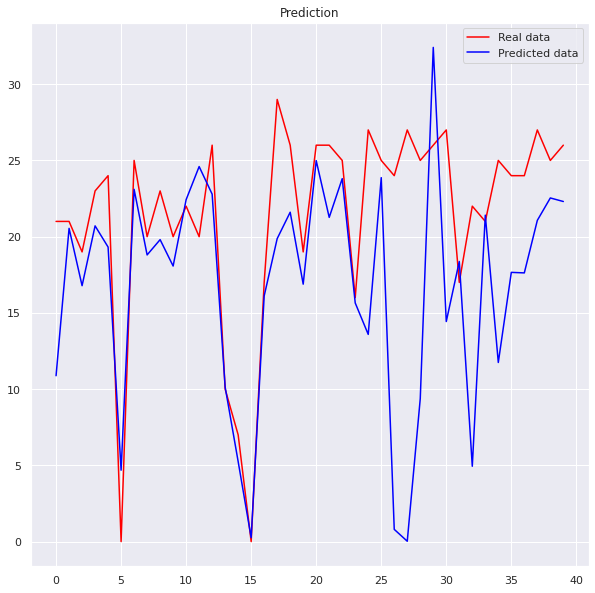

No handles with labels found to put in legend.


MSE: 			49.987161182798445
R-Squared Score: 	nan


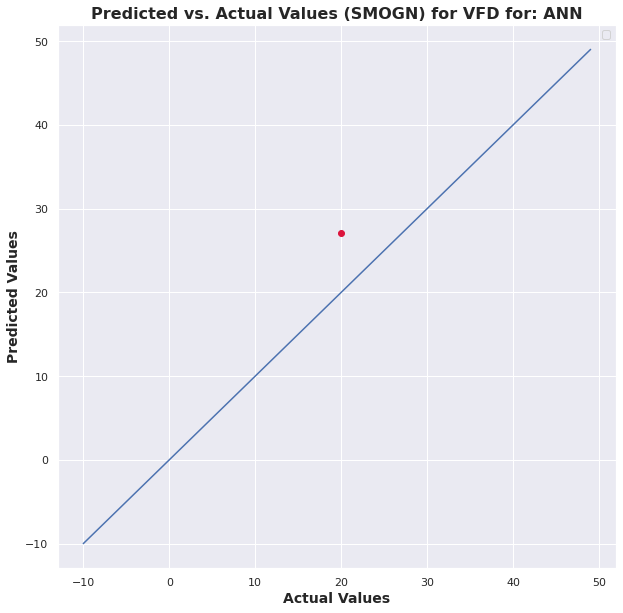

No handles with labels found to put in legend.


MSE: 			70.94760677362856
R-Squared Score: 	-0.6126517713600563


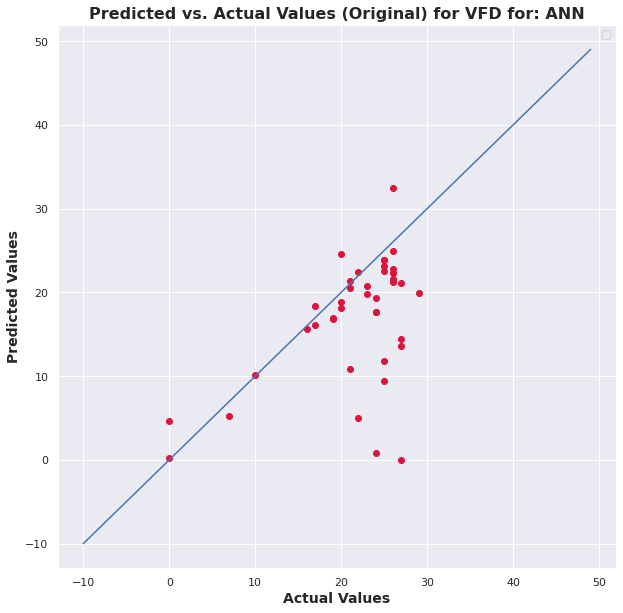

<ipython-input-638-0f79e873448e>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix:   0%|          | 0/12 [00:00<?, ?it/s]

37


r_index: 100%|##########| 8/8 [00:00<00:00, 92.61it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


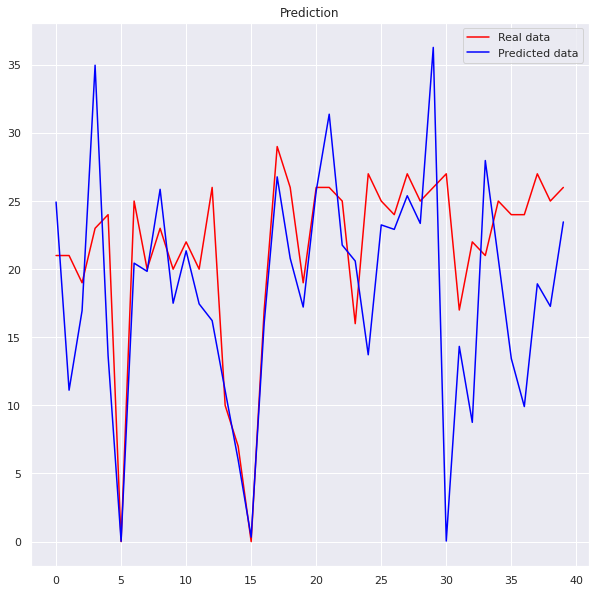

No handles with labels found to put in legend.


MSE: 			6.707180518006339e-05
R-Squared Score: 	nan


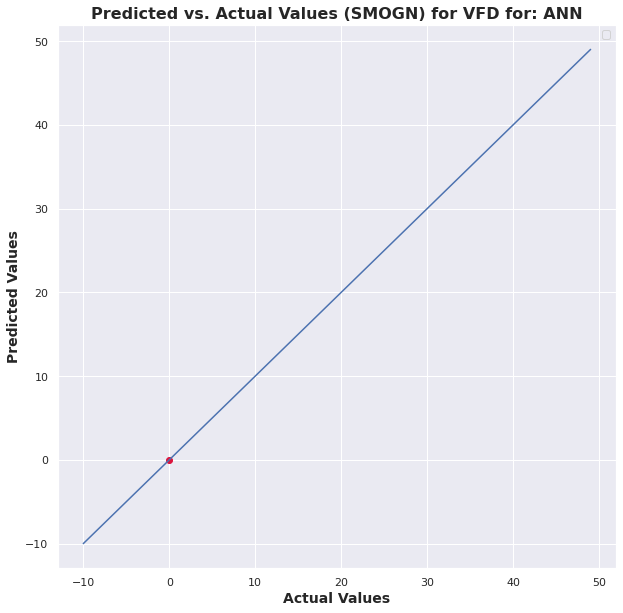

No handles with labels found to put in legend.


MSE: 			57.83775458193893
R-Squared Score: 	-0.31466248996465884


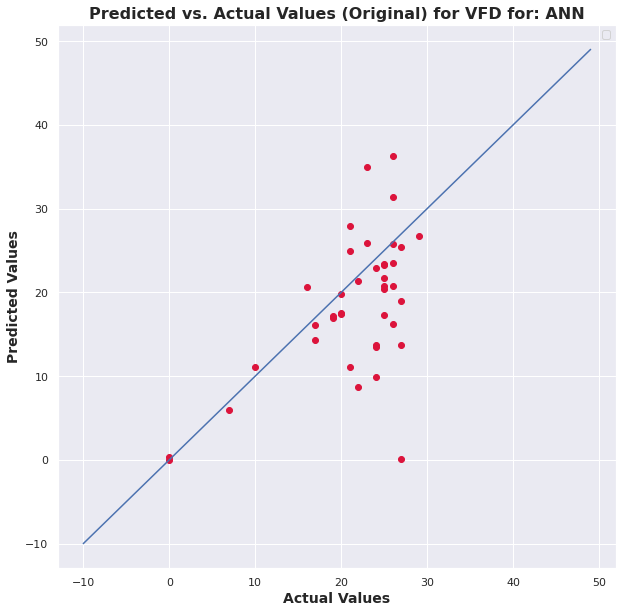

<ipython-input-638-0f79e873448e>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix:   0%|          | 0/12 [00:00<?, ?it/s]

38


r_index: 100%|##########| 8/8 [00:00<00:00, 92.73it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


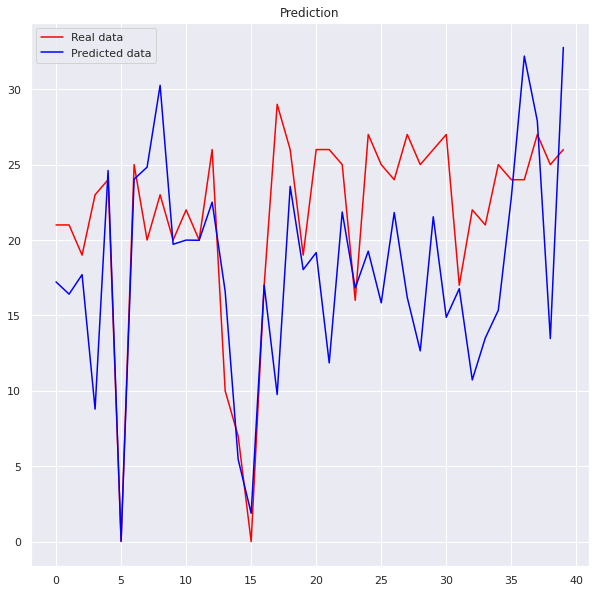

No handles with labels found to put in legend.


MSE: 			133.8180245602416
R-Squared Score: 	nan


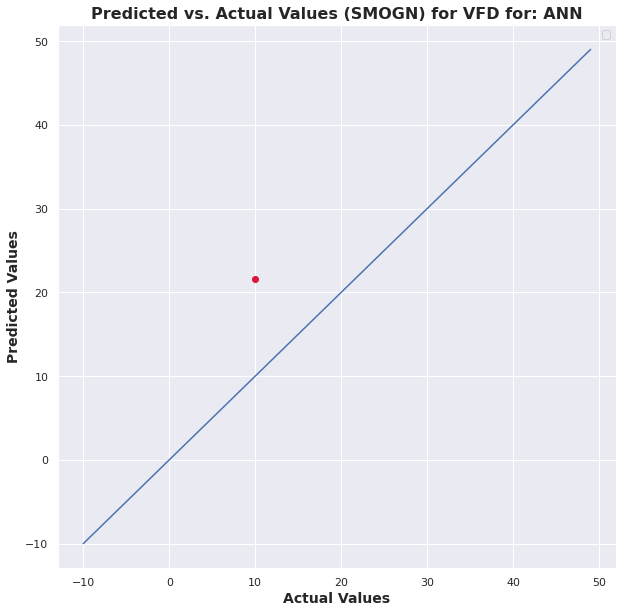

No handles with labels found to put in legend.


MSE: 			53.17802617300667
R-Squared Score: 	-0.2087460311234488


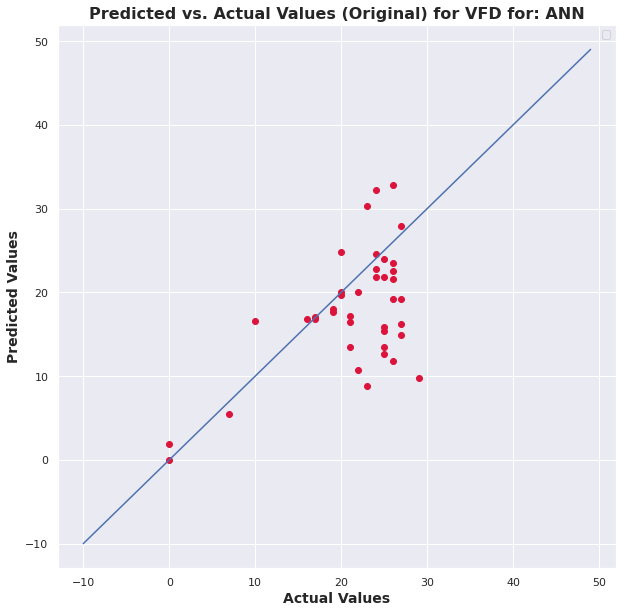

<ipython-input-638-0f79e873448e>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix:   0%|          | 0/12 [00:00<?, ?it/s]

39


r_index: 100%|##########| 8/8 [00:00<00:00, 85.55it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


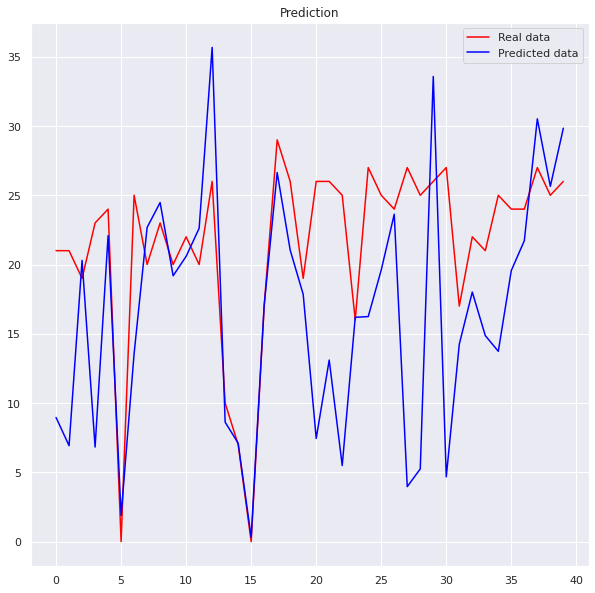

No handles with labels found to put in legend.


MSE: 			4.416240265972192
R-Squared Score: 	nan


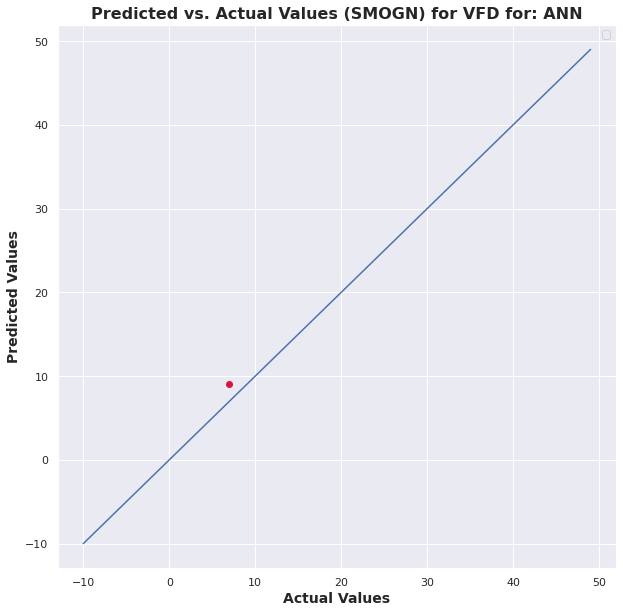

No handles with labels found to put in legend.


MSE: 			91.08789948411865
R-Squared Score: 	-1.0704442212014298


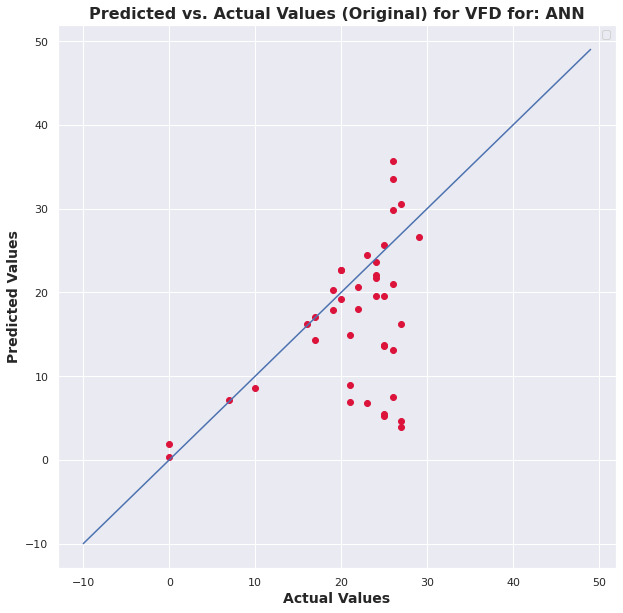

<ipython-input-638-0f79e873448e>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix:   0%|          | 0/12 [00:00<?, ?it/s]

40


r_index: 100%|##########| 8/8 [00:00<00:00, 99.44it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


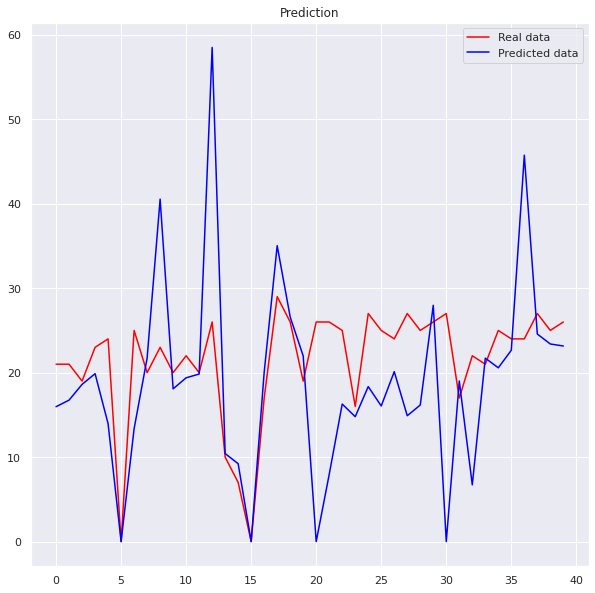

No handles with labels found to put in legend.


MSE: 			15.031401484480739
R-Squared Score: 	nan


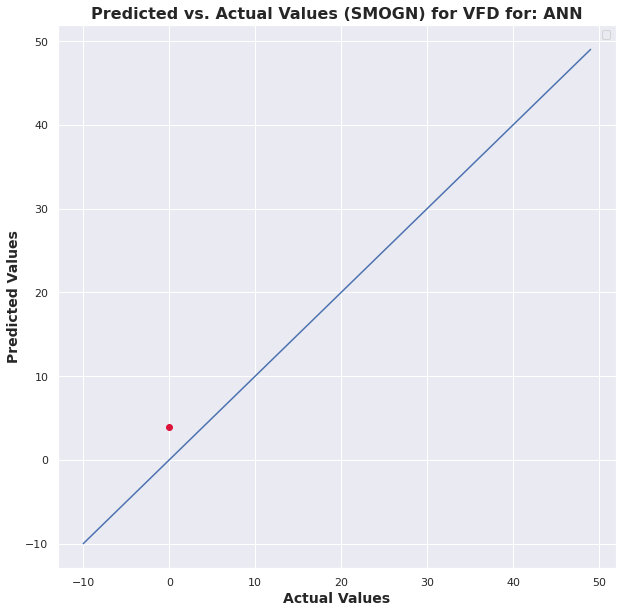

No handles with labels found to put in legend.


MSE: 			117.07966283303317
R-Squared Score: 	-1.6612416435745065


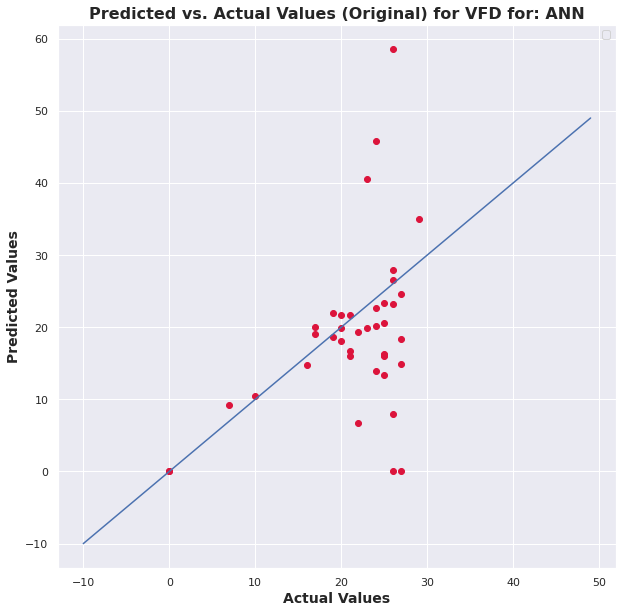

<ipython-input-638-0f79e873448e>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix:   0%|          | 0/12 [00:00<?, ?it/s]

41


r_index: 100%|##########| 8/8 [00:00<00:00, 85.29it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


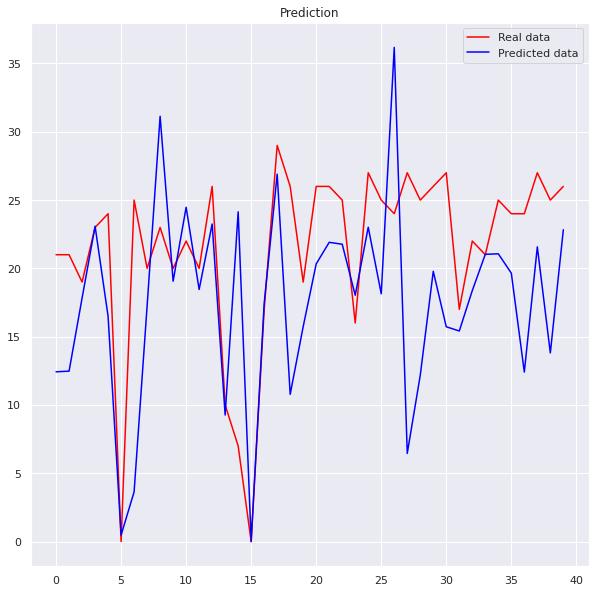

No handles with labels found to put in legend.


MSE: 			425.1845132690505
R-Squared Score: 	nan


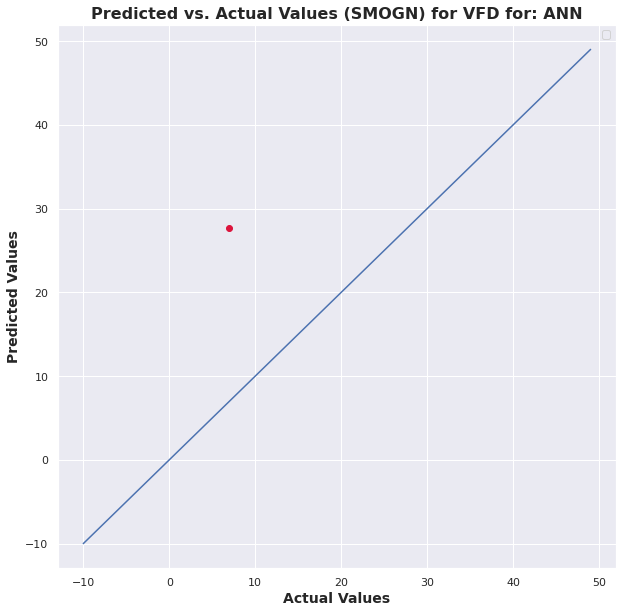

No handles with labels found to put in legend.


MSE: 			66.70221162610491
R-Squared Score: 	-0.5161531815397973


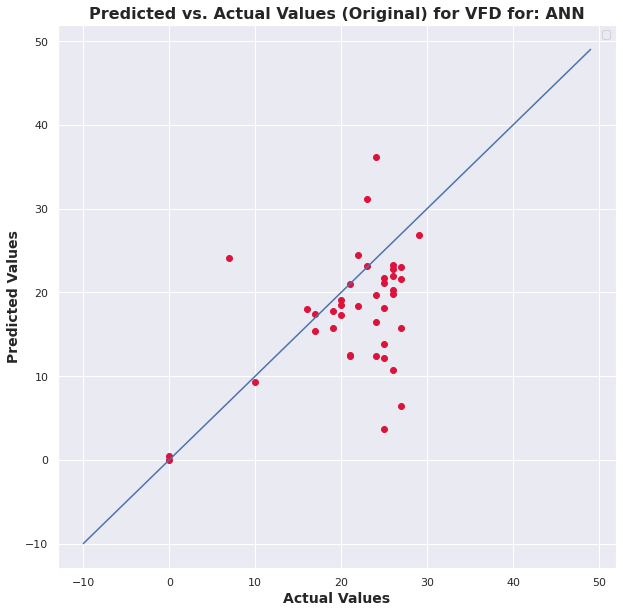

<ipython-input-638-0f79e873448e>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix:   0%|          | 0/12 [00:00<?, ?it/s]

42


r_index: 100%|##########| 8/8 [00:00<00:00, 97.14it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


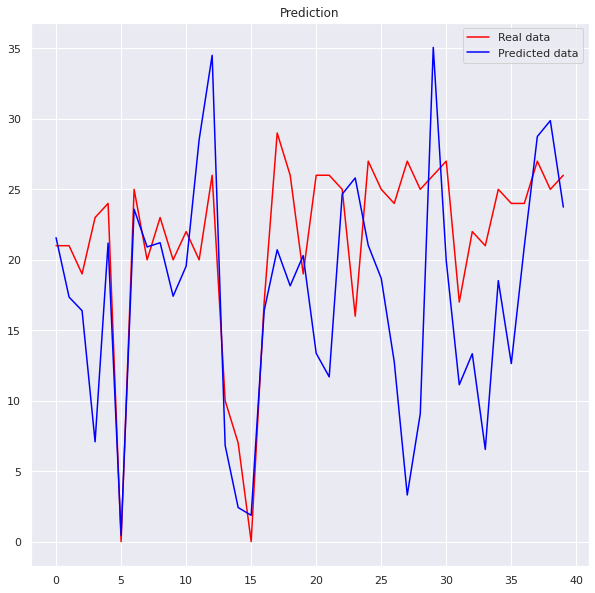

No handles with labels found to put in legend.


MSE: 			162.3704390705243
R-Squared Score: 	nan


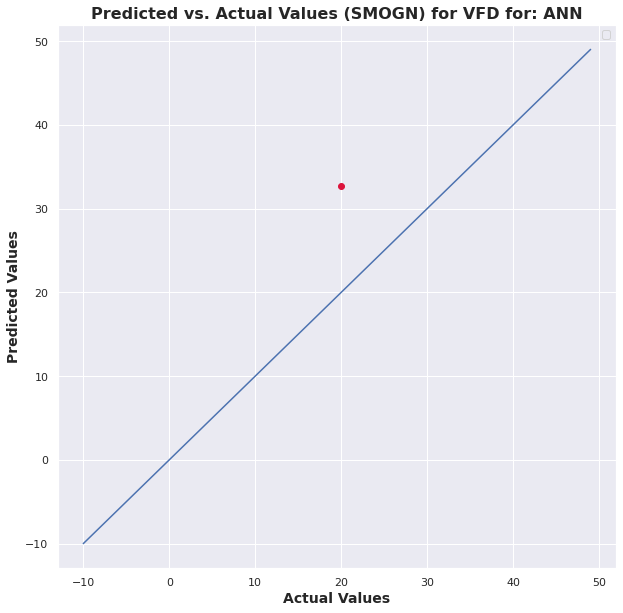

No handles with labels found to put in legend.


MSE: 			68.8478635159958
R-Squared Score: 	-0.5649242321545835


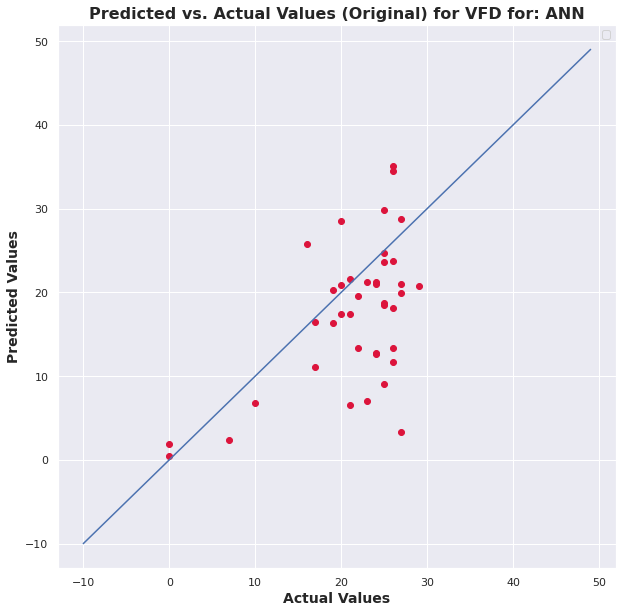

<ipython-input-638-0f79e873448e>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix:   0%|          | 0/12 [00:00<?, ?it/s]

43


r_index: 100%|##########| 8/8 [00:00<00:00, 101.02it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


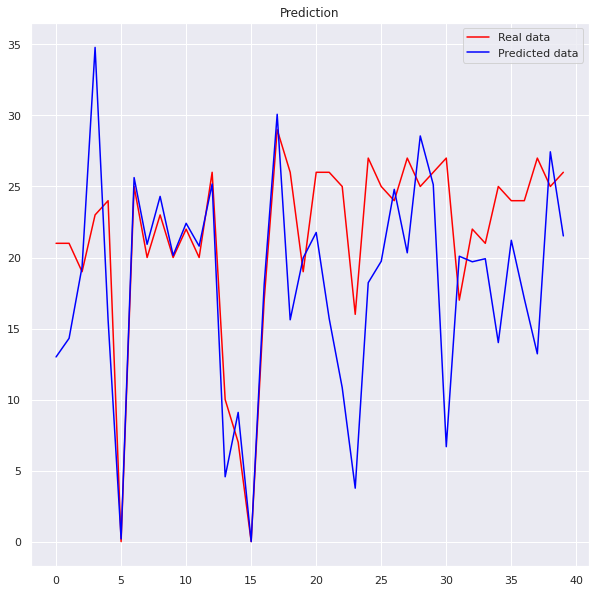

No handles with labels found to put in legend.


MSE: 			8.734876706788782
R-Squared Score: 	nan


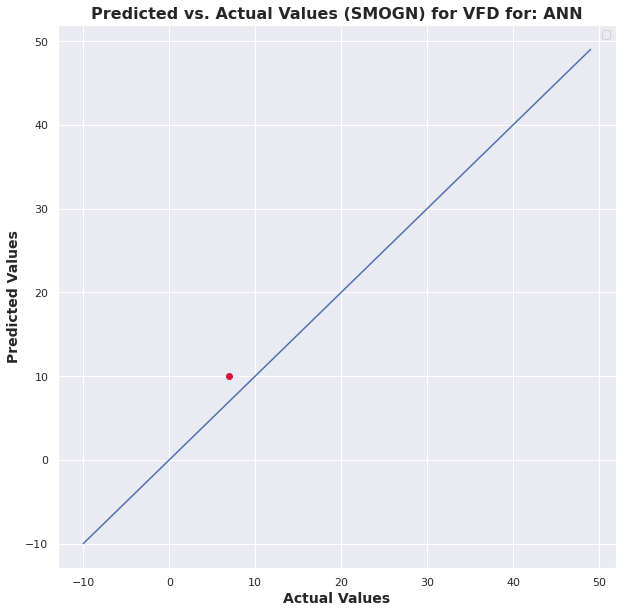

MSE: 			48.1637994796653
R-Squared Score: 	-0.09477176297345524


No handles with labels found to put in legend.


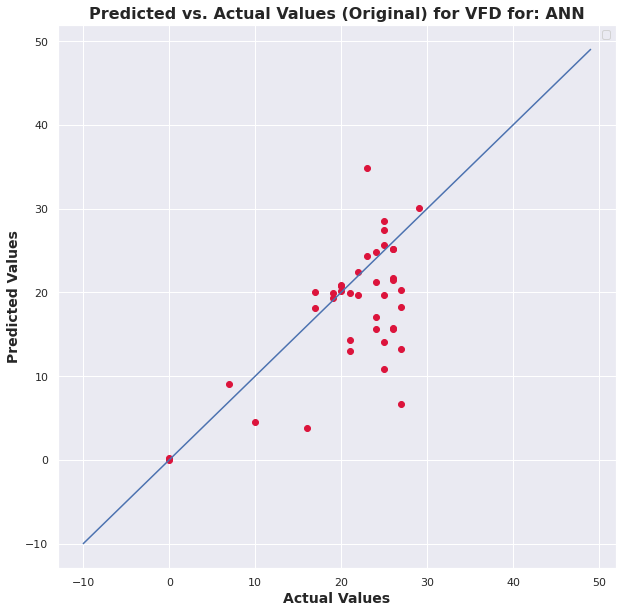

<ipython-input-638-0f79e873448e>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix:   0%|          | 0/12 [00:00<?, ?it/s]

44


r_index: 100%|##########| 8/8 [00:00<00:00, 81.39it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


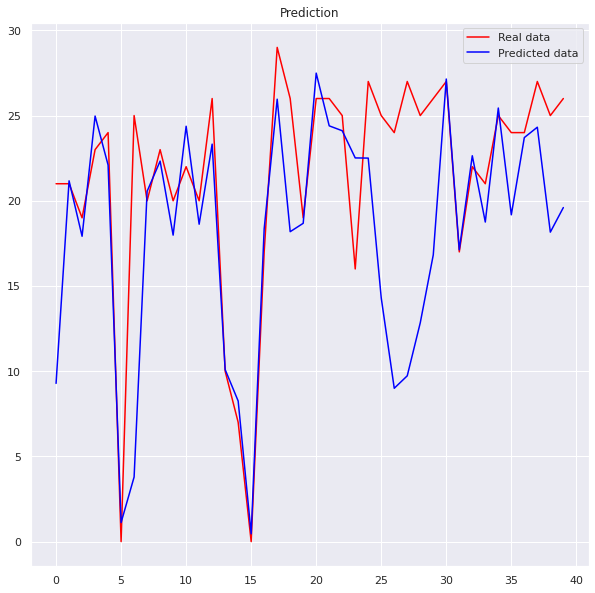

No handles with labels found to put in legend.


MSE: 			1.462891006675818
R-Squared Score: 	nan


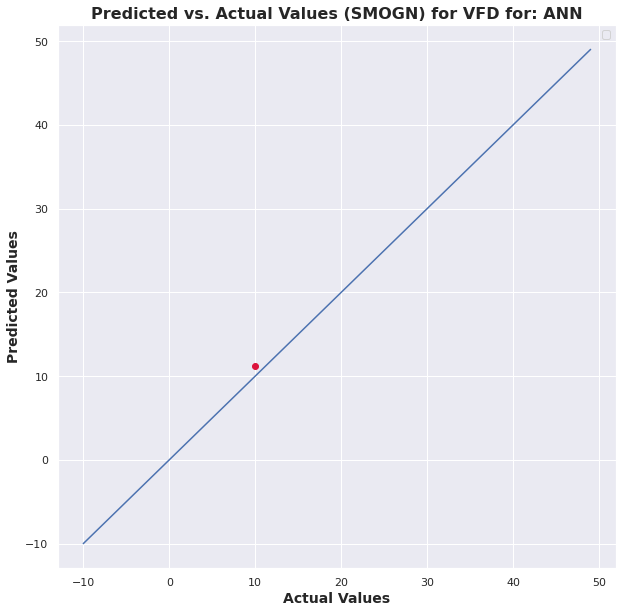

No handles with labels found to put in legend.


MSE: 			43.81993257679651
R-Squared Score: 	0.003965107430290549


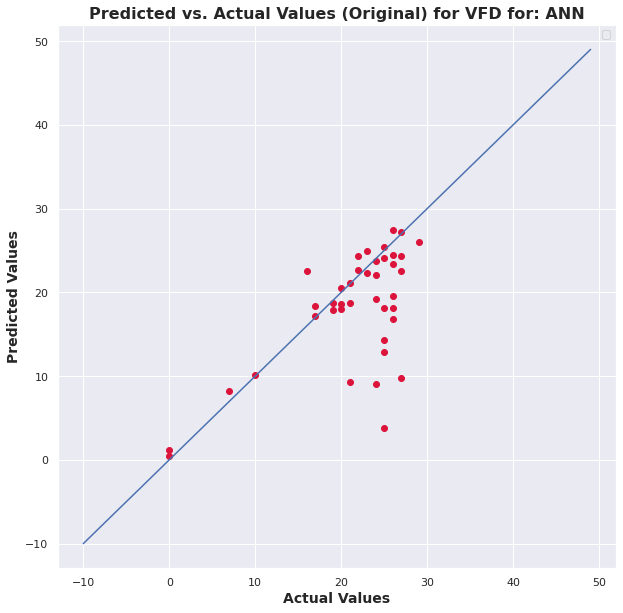

<ipython-input-638-0f79e873448e>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix:   0%|          | 0/12 [00:00<?, ?it/s]

45


r_index: 100%|##########| 8/8 [00:00<00:00, 87.44it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


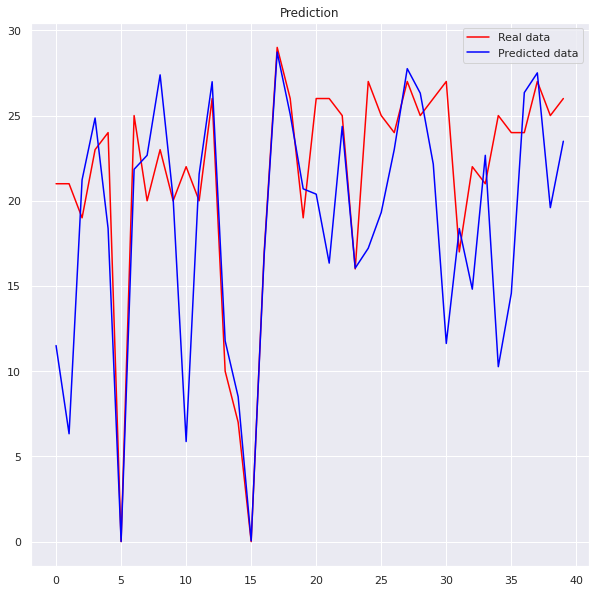

No handles with labels found to put in legend.


MSE: 			0.0006998946222580571
R-Squared Score: 	nan


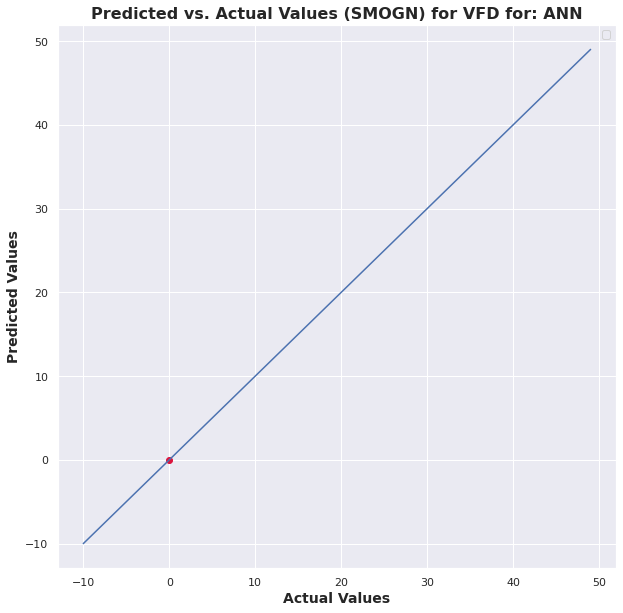

No handles with labels found to put in legend.


MSE: 			39.14636106310853
R-Squared Score: 	0.11019622251461614


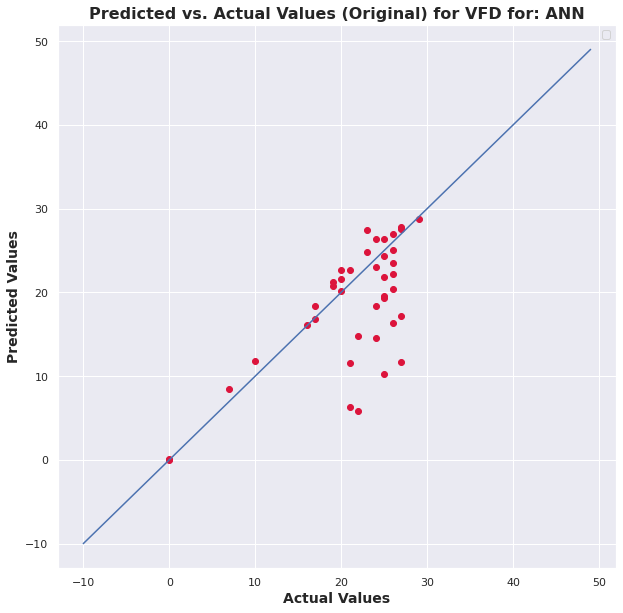

46


<ipython-input-638-0f79e873448e>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
r_index: 100%|##########| 8/8 [00:00<00:00, 123.97it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


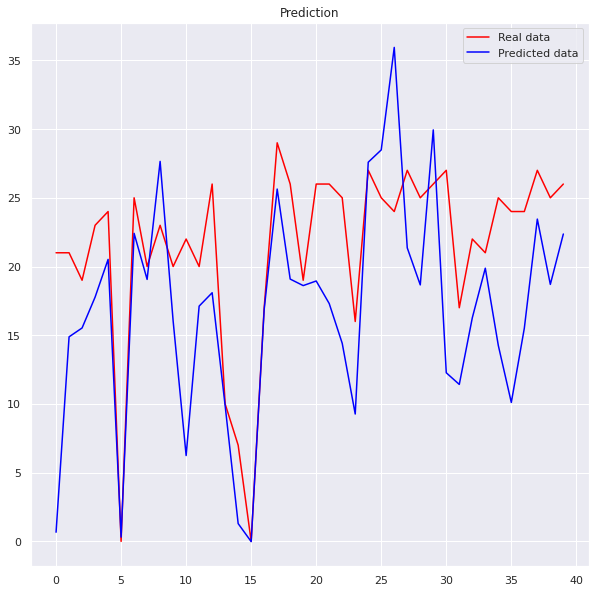

No handles with labels found to put in legend.


MSE: 			4.936258968551556
R-Squared Score: 	nan


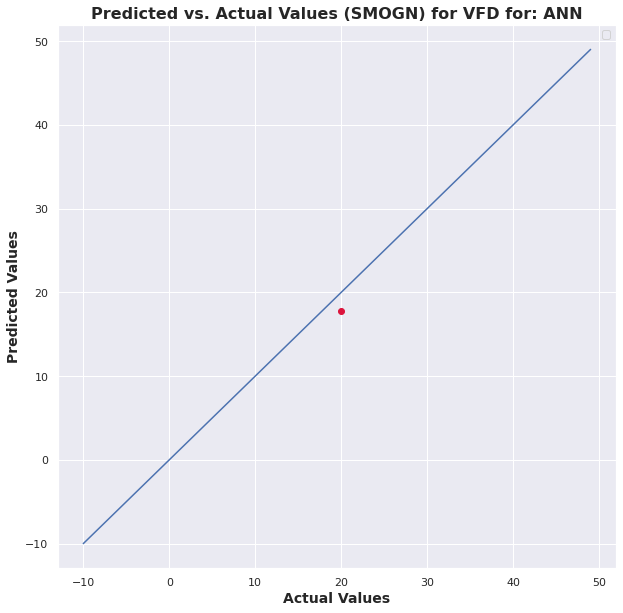

No handles with labels found to put in legend.


MSE: 			55.29685395801987
R-Squared Score: 	-0.25690736504427836


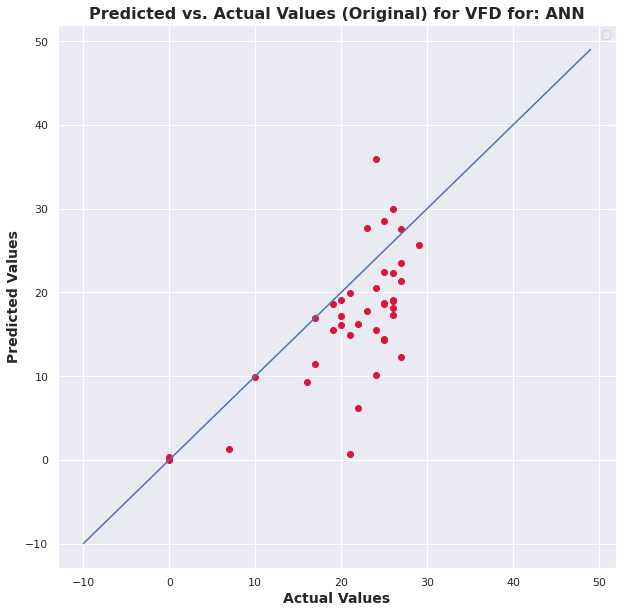

<ipython-input-638-0f79e873448e>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix:   0%|          | 0/12 [00:00<?, ?it/s]

47


r_index: 100%|##########| 8/8 [00:00<00:00, 86.69it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


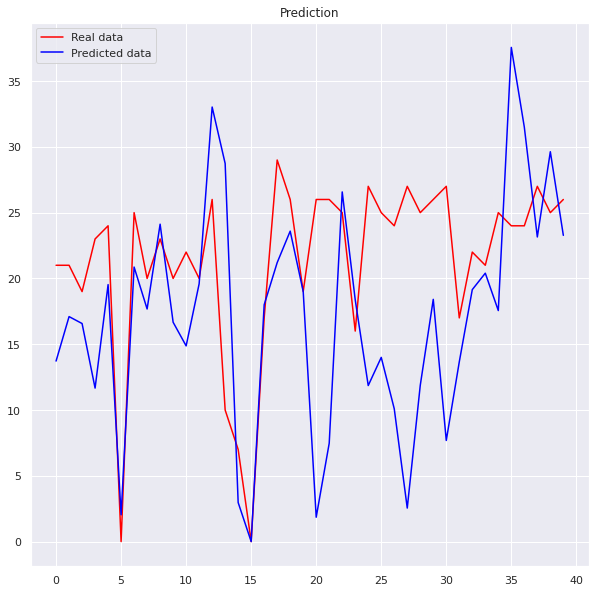

No handles with labels found to put in legend.


MSE: 			871.4793003930245
R-Squared Score: 	nan


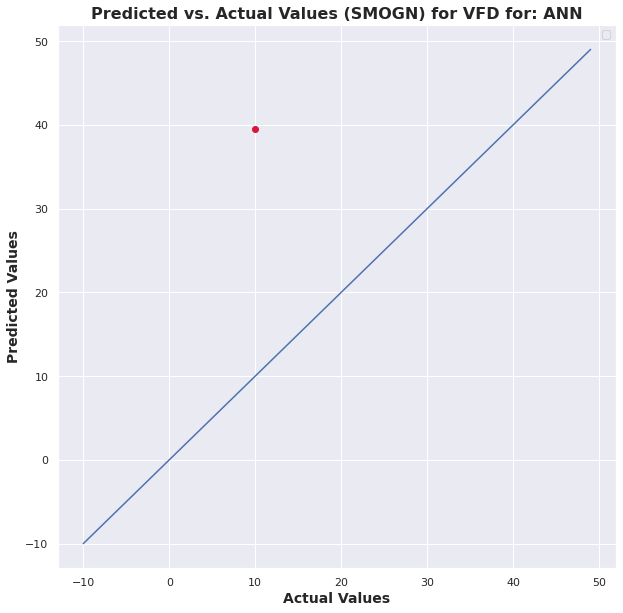

No handles with labels found to put in legend.


MSE: 			95.85960130634162
R-Squared Score: 	-1.1789058557222742


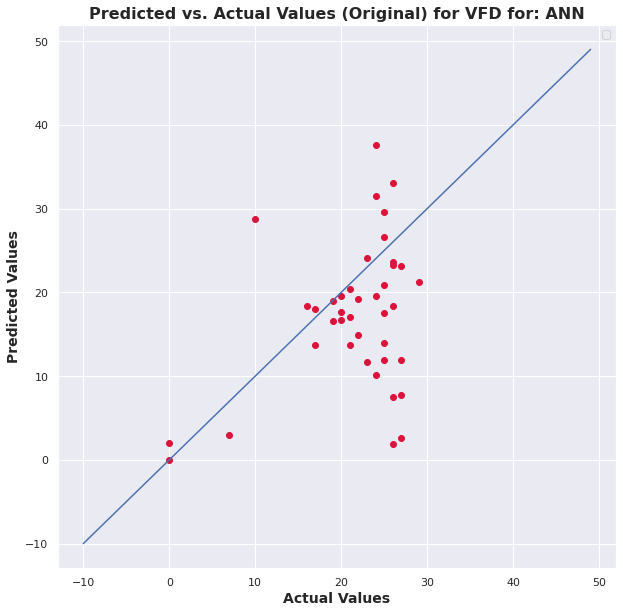

<ipython-input-638-0f79e873448e>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix:   0%|          | 0/12 [00:00<?, ?it/s]

48


r_index: 100%|##########| 8/8 [00:00<00:00, 89.50it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


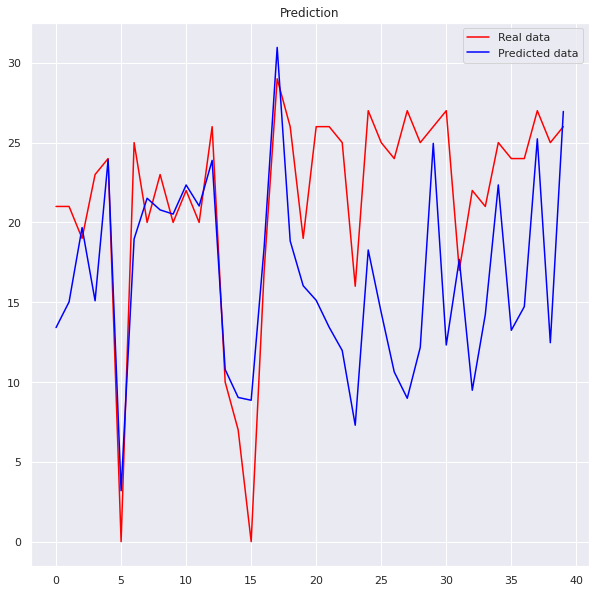

No handles with labels found to put in legend.


MSE: 			140.66307553569004
R-Squared Score: 	nan


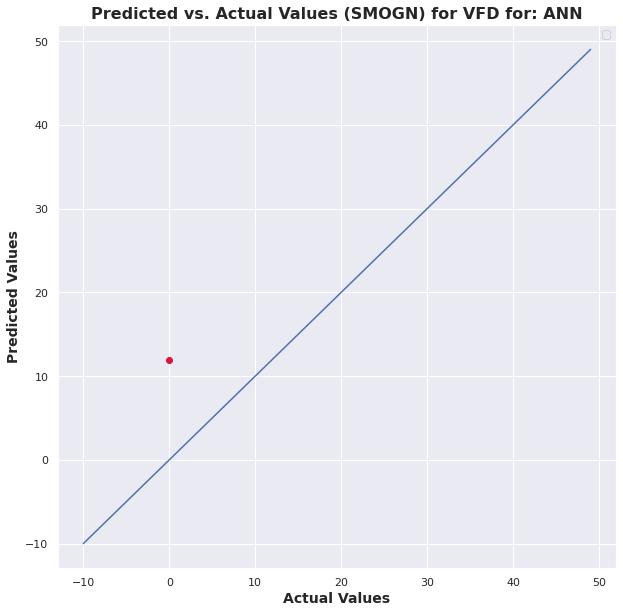

No handles with labels found to put in legend.


MSE: 			63.36962839088983
R-Squared Score: 	-0.44040296949075497


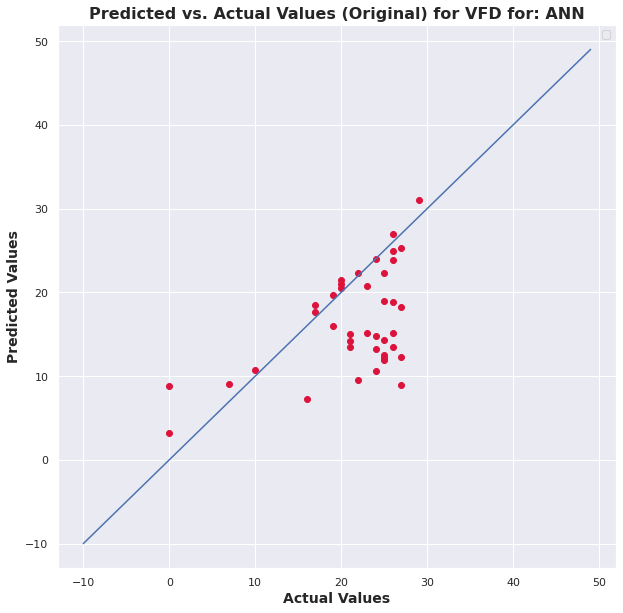

<ipython-input-638-0f79e873448e>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
dist_matrix:   0%|          | 0/12 [00:00<?, ?it/s]

49


r_index: 100%|##########| 8/8 [00:00<00:00, 73.18it/s]


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


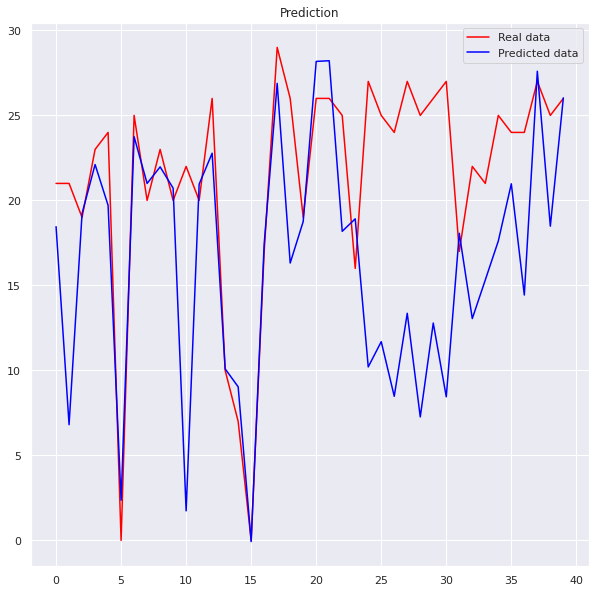

No handles with labels found to put in legend.


MSE: 			0.668131811654348
R-Squared Score: 	nan


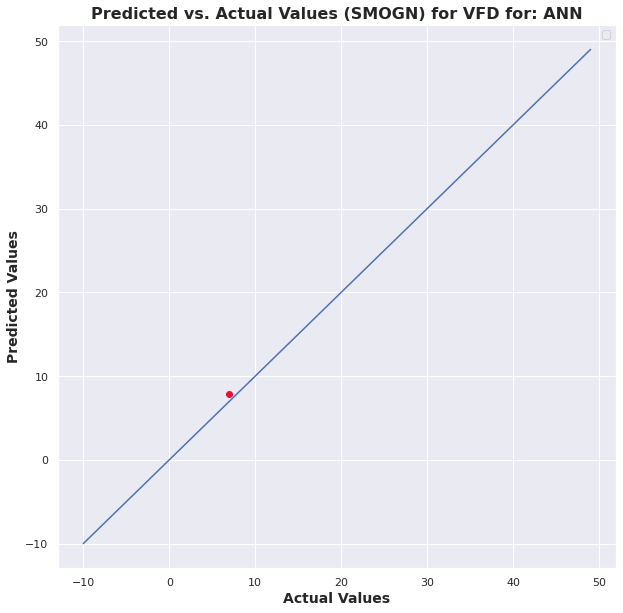

No handles with labels found to put in legend.


MSE: 			71.42524039462145
R-Squared Score: 	-0.6235084688581545


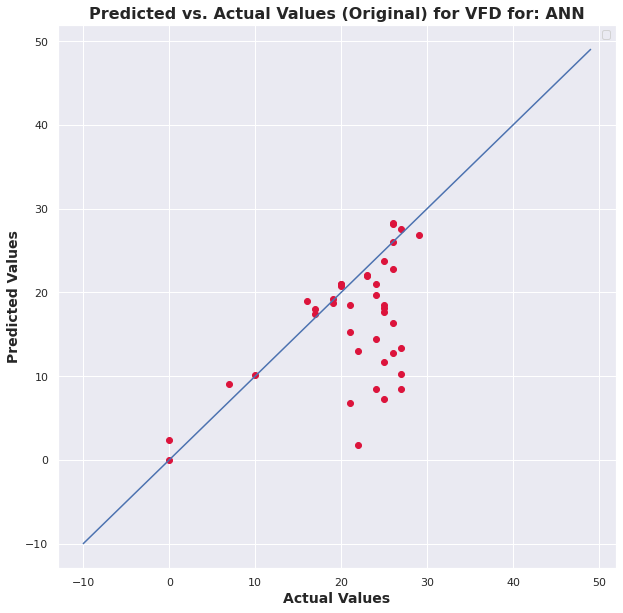

In [647]:
rSquared = {}
MSE = {}
for n in range(2,50):
    print('==================================================')
    print(n)
    combinedDfNormalized = pd.read_csv('data/processed/VFD/CombinedDataset/combinedDfNormalized.csv').set_index('Unnamed: 0')
    mse, rSqre = trainANN(combinedDfNormalized, selectedFeatures, n)
    
    rSquared[n] = rSqre
    MSE[n] = mse

In [649]:
MSE

{2: 320.92577153909394,
 3: 233.39372587666472,
 4: 70.00494950959721,
 5: 190.8492367971386,
 6: 122.41024270114269,
 7: 65.6593669122166,
 8: 115.73690966787254,
 9: 61.953140746429064,
 10: 47.21277106420184,
 11: 50.213936557908134,
 12: 51.500156326360226,
 13: 118.9999143692276,
 14: 51.240557287163504,
 15: 35.62584550365976,
 16: 81.4665117771137,
 17: 47.87571777226056,
 18: 44.35042701482185,
 19: 72.39215445571695,
 20: 61.00141498635268,
 21: 44.63917952321055,
 22: 55.34871113305019,
 23: 53.52551099125401,
 24: 53.53483297182477,
 25: 45.934488029044545,
 26: 42.47882107005633,
 27: 68.62381930124324,
 28: 36.80018933513527,
 29: 97.65069706453474,
 30: 52.207438679929076,
 31: 43.35487976336599,
 32: 74.70034394169647,
 33: 48.64582083674328,
 34: 71.65316009576759,
 35: 28.78665403664717,
 36: 70.94760677362856,
 37: 57.83775458193893,
 38: 53.17802617300667,
 39: 91.08789948411865,
 40: 117.07966283303317,
 41: 66.70221162610491,
 42: 68.8478635159958,
 43: 48.16379947

<ipython-input-13-85380e66bd6c>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD


2


r_index: 100%|##########| 8/8 [00:00<00:00, 182.35it/s]


(26, 3)


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


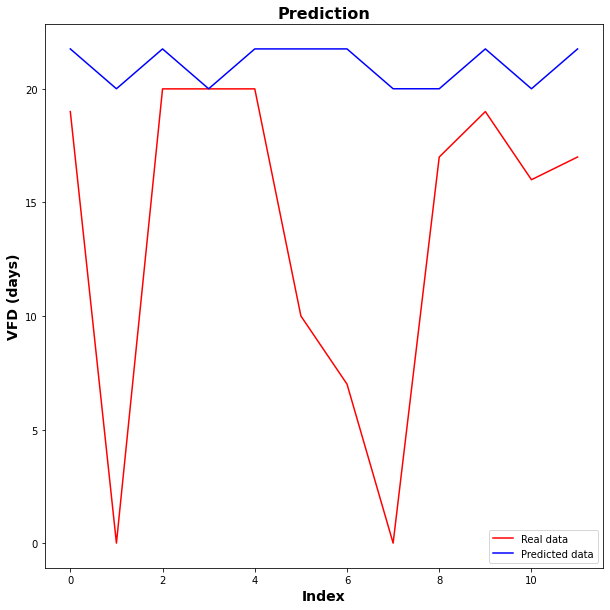

No handles with labels found to put in legend.


MSE: 			117.65468071460782
R-Squared Score: 	nan


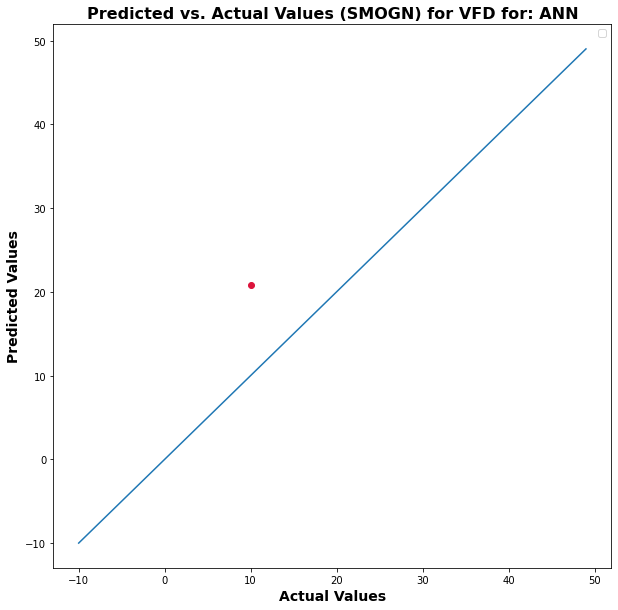

No handles with labels found to put in legend.


MSE: 			102.1386627765011
MAE: 	7.278473536173503
R-Squared Score: 	-0.9263873529556199


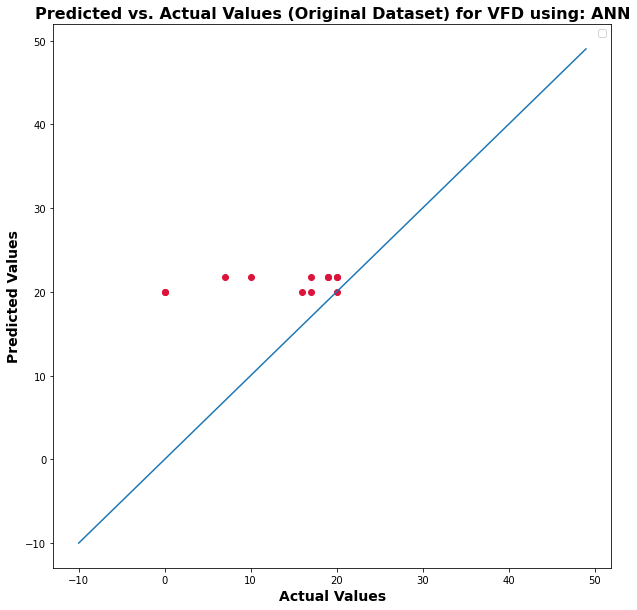

<ipython-input-13-85380e66bd6c>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD


3


r_index: 100%|##########| 8/8 [00:00<00:00, 306.95it/s]


(26, 4)


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


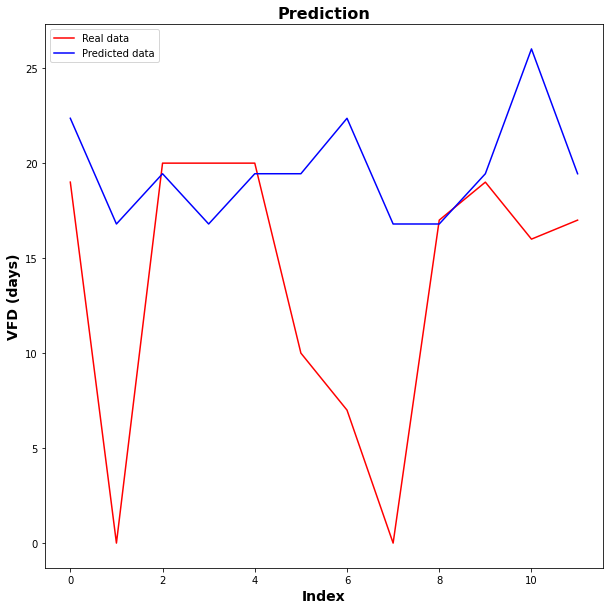

No handles with labels found to put in legend.


MSE: 			374.12797946426144
R-Squared Score: 	nan


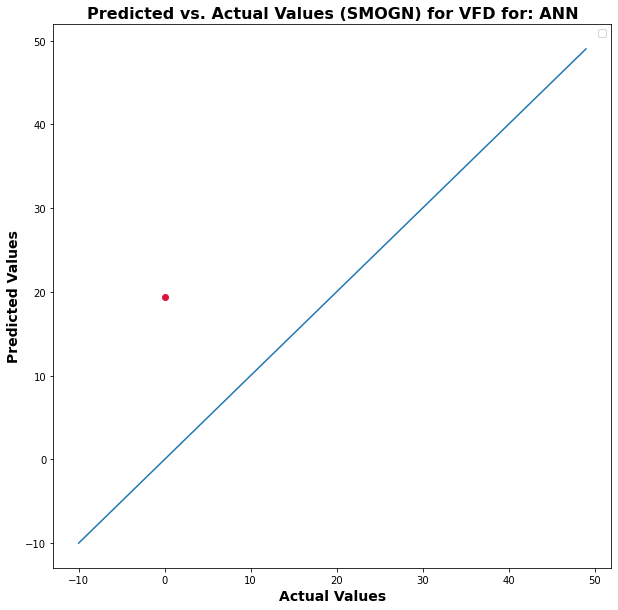

No handles with labels found to put in legend.


MSE: 			84.83592951619721
MAE: 	6.598120053609212
R-Squared Score: 	-0.6000489653349572


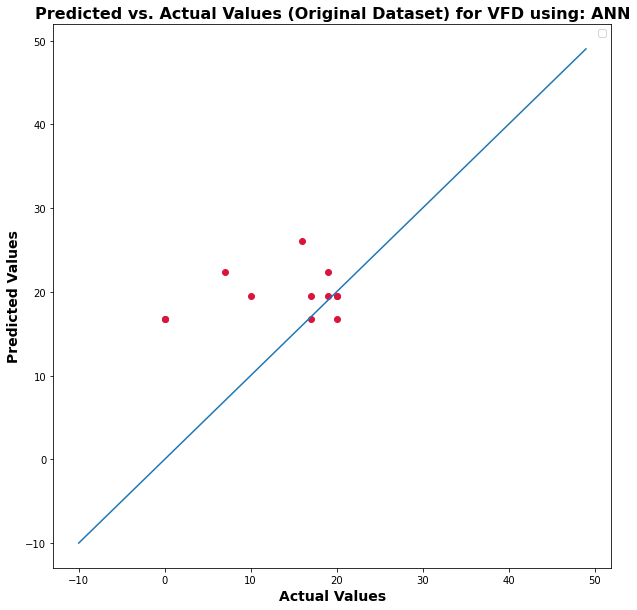

<ipython-input-13-85380e66bd6c>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD


4


r_index: 100%|##########| 8/8 [00:00<00:00, 158.57it/s]


(27, 5)


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


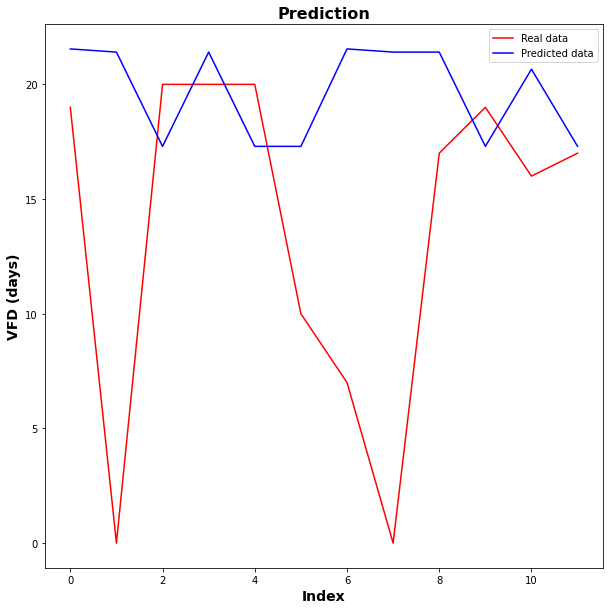

MSE: 			262.597942610013
R-Squared Score: 	nan


No handles with labels found to put in legend.


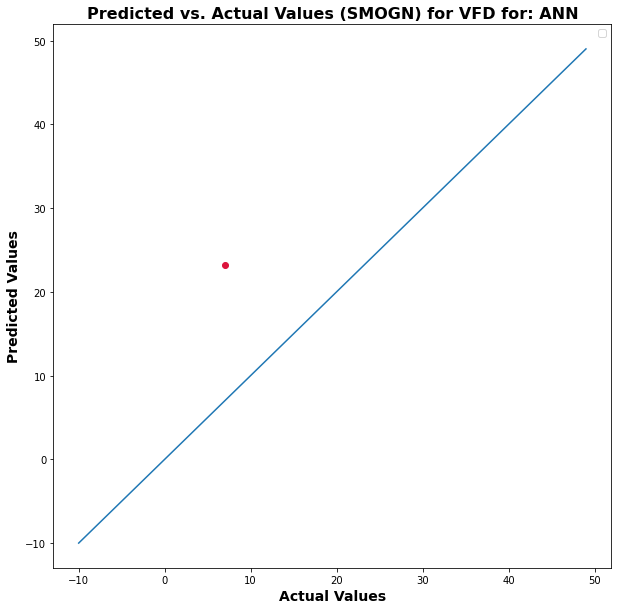

No handles with labels found to put in legend.


MSE: 			104.04279880172574
MAE: 	7.090162436167399
R-Squared Score: 	-0.9623003310345131


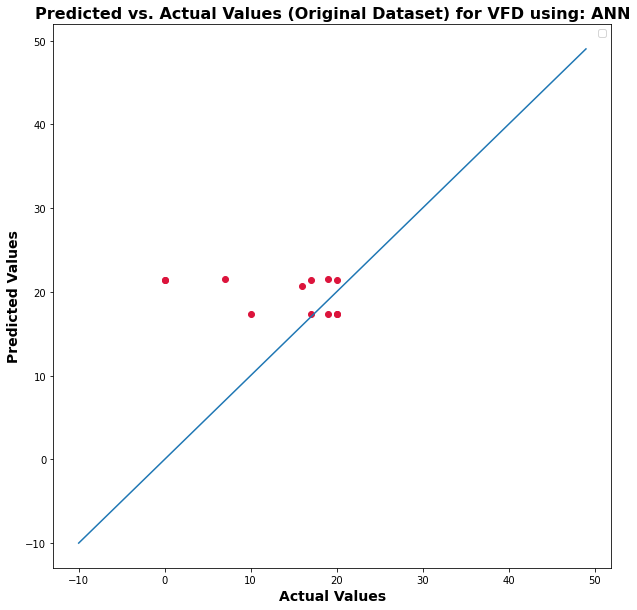

<ipython-input-13-85380e66bd6c>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD


5


r_index: 100%|##########| 8/8 [00:00<00:00, 262.87it/s]


(26, 6)


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


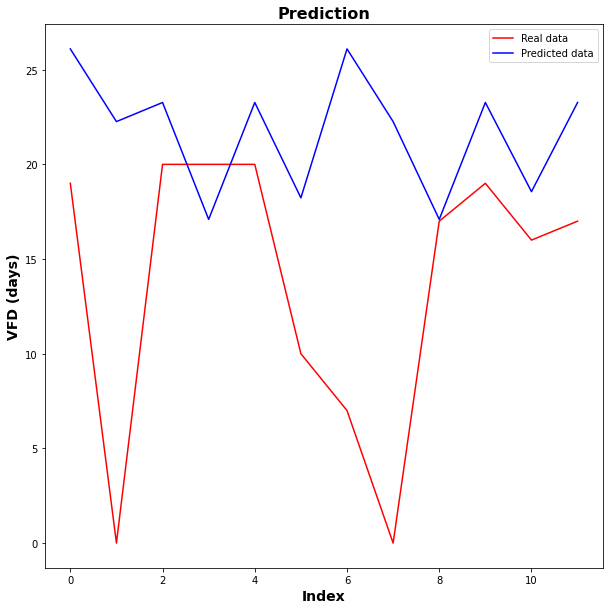

No handles with labels found to put in legend.


MSE: 			0.4433507238900347
R-Squared Score: 	nan


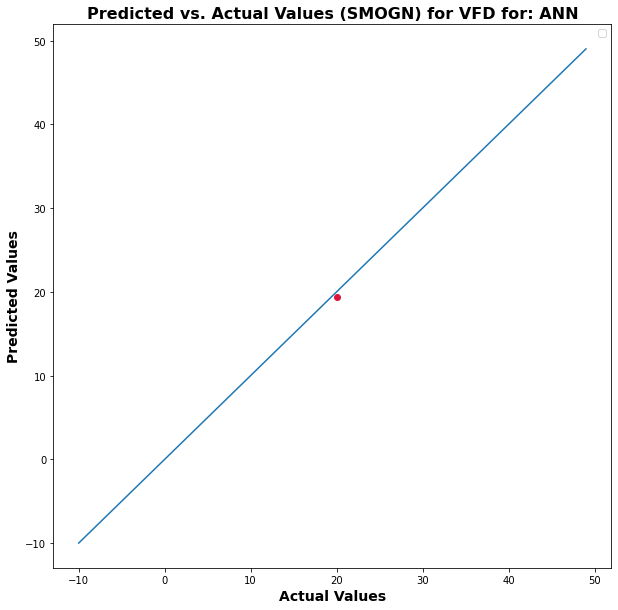

No handles with labels found to put in legend.


MSE: 			130.62402353323583
MAE: 	8.463895161946615
R-Squared Score: 	-1.4636358073066091


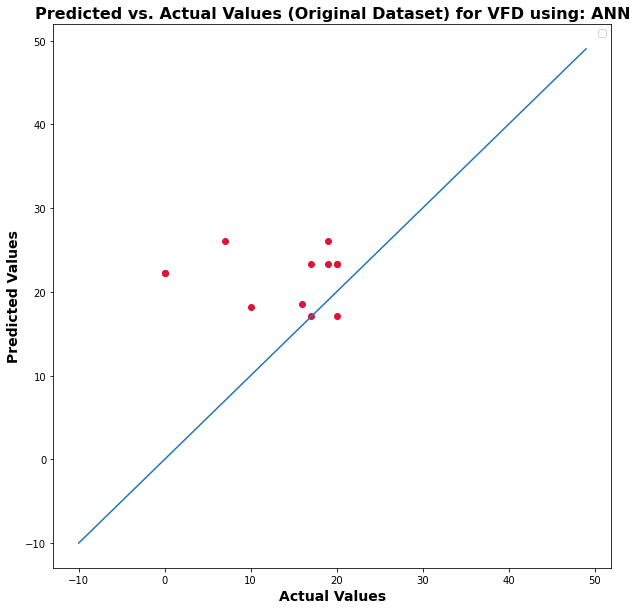

<ipython-input-13-85380e66bd6c>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD


6


r_index: 100%|##########| 8/8 [00:00<00:00, 531.18it/s]

(27, 7)


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


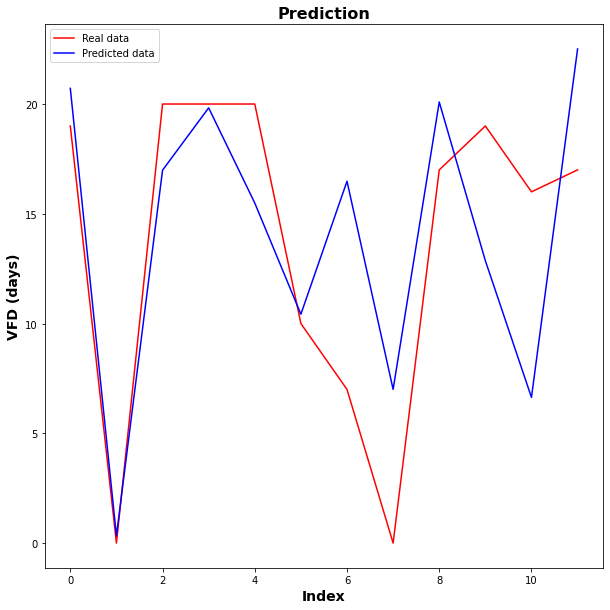

No handles with labels found to put in legend.


MSE: 			159.7448498111371
R-Squared Score: 	nan


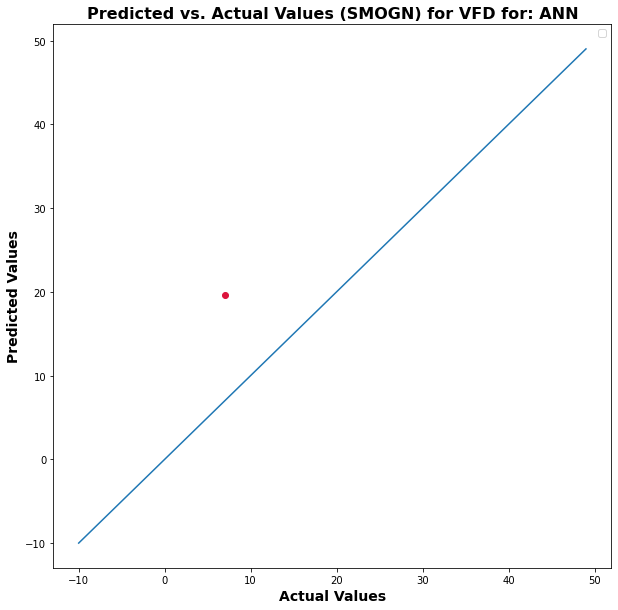

No handles with labels found to put in legend.


MSE: 			28.07762134735287
MAE: 	4.230004198849201
R-Squared Score: 	0.47044171918548616


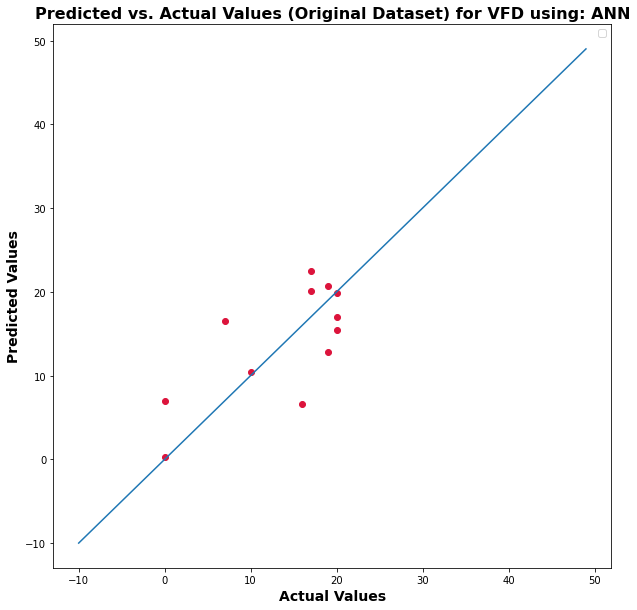

<ipython-input-13-85380e66bd6c>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD


7


r_index: 100%|##########| 8/8 [00:00<00:00, 378.41it/s]

(26, 8)


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


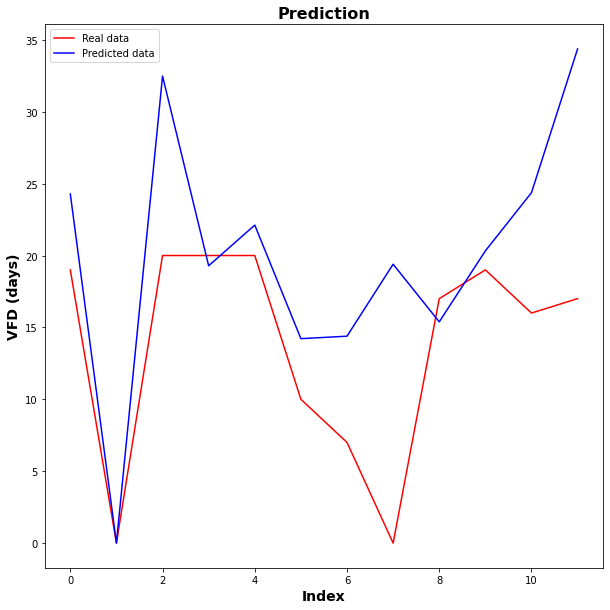

No handles with labels found to put in legend.


MSE: 			1.3520413572550751
R-Squared Score: 	nan


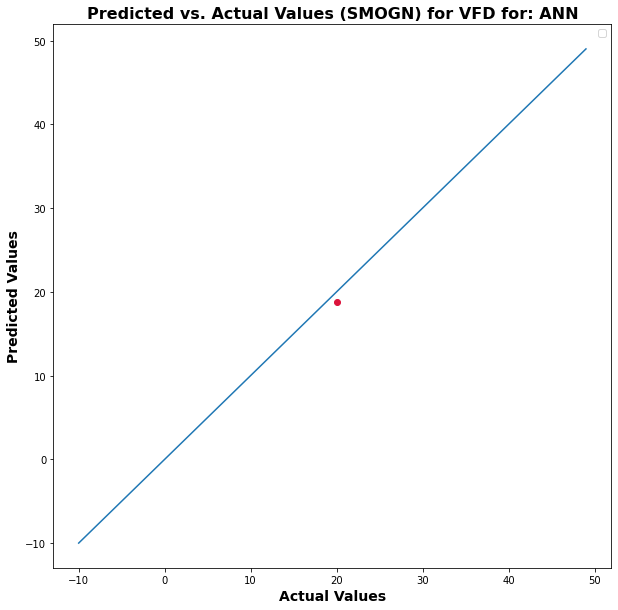

No handles with labels found to put in legend.


MSE: 			84.43506004894711
MAE: 	6.688495719320296
R-Squared Score: 	-0.5924883624162913


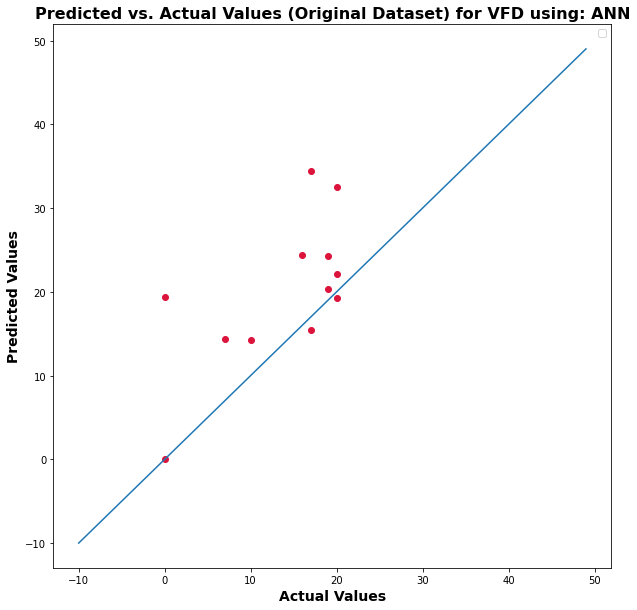

<ipython-input-13-85380e66bd6c>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD


8


r_index: 100%|##########| 8/8 [00:00<00:00, 448.12it/s]

(25, 9)


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


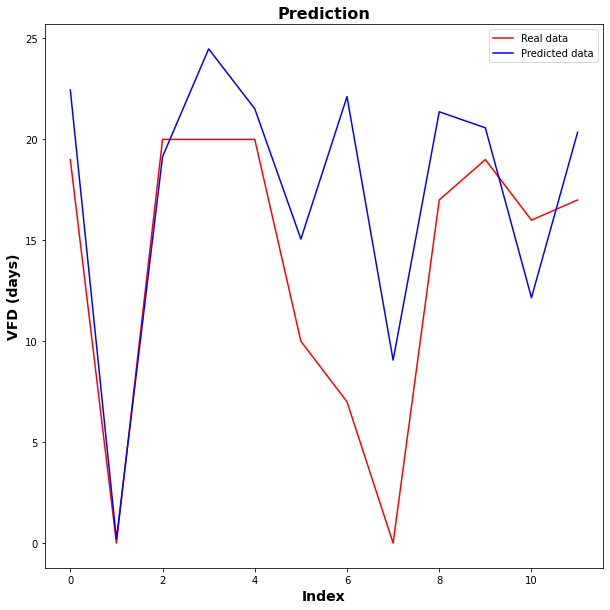

No handles with labels found to put in legend.


MSE: 			174.34900324862974
R-Squared Score: 	nan


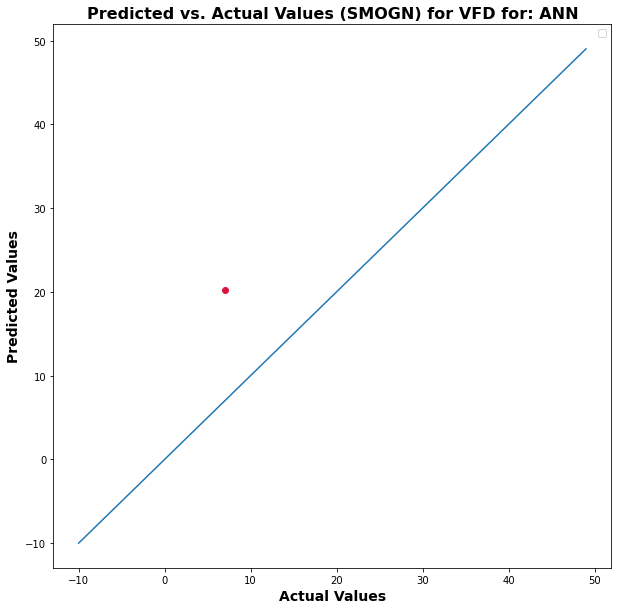

No handles with labels found to put in legend.


MSE: 			34.921472310731325
MAE: 	4.407483836015065
R-Squared Score: 	0.3413631941394485


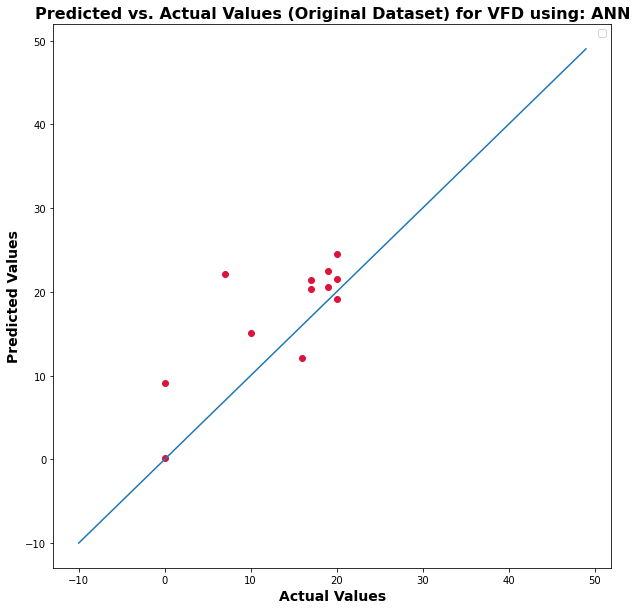

<ipython-input-13-85380e66bd6c>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD


9


r_index: 100%|##########| 8/8 [00:00<00:00, 415.34it/s]

(26, 10)


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


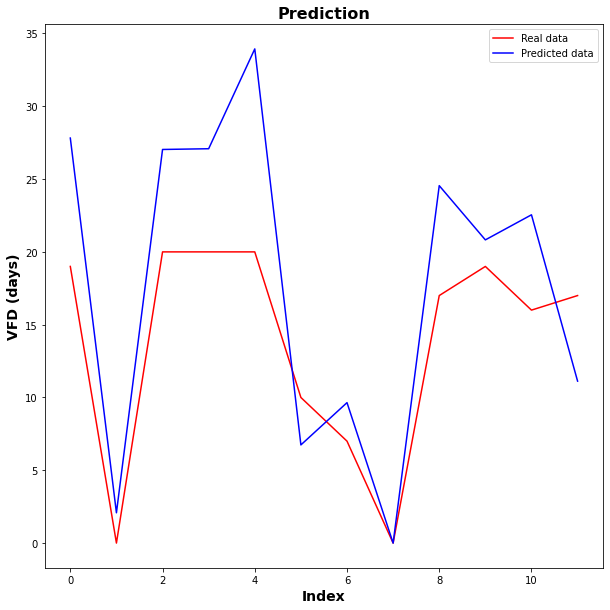

No handles with labels found to put in legend.


MSE: 			1.9297076486727747
R-Squared Score: 	nan


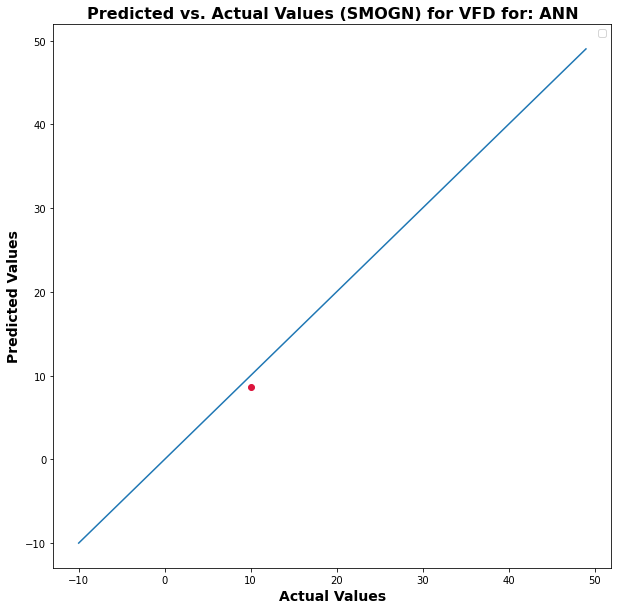

MSE: 			44.283894064774046
MAE: 	5.554793452145532
R-Squared Score: 	0.16478313748166828


No handles with labels found to put in legend.


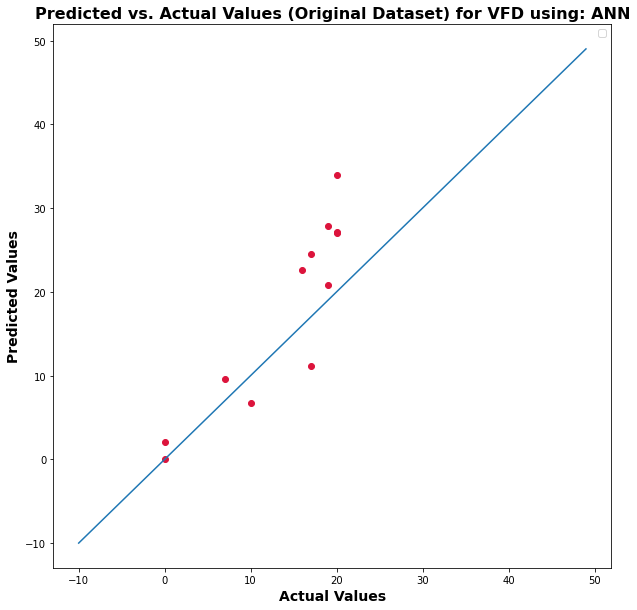

<ipython-input-13-85380e66bd6c>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD


10


r_index: 100%|##########| 8/8 [00:00<00:00, 431.89it/s]

(25, 11)


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


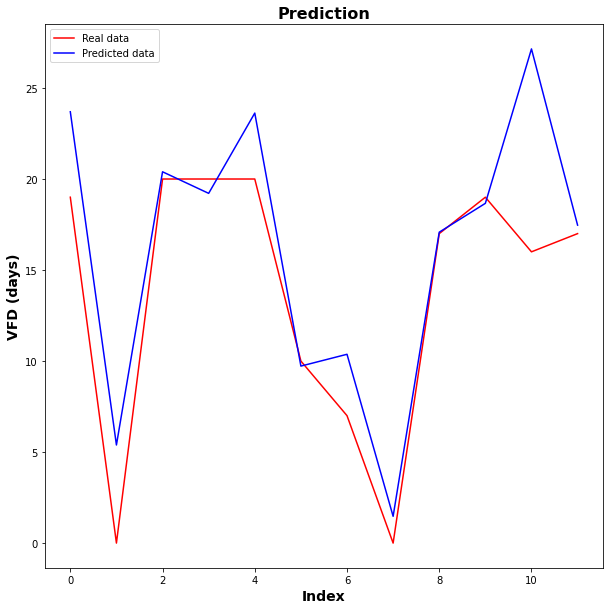

No handles with labels found to put in legend.


MSE: 			168.50692907768826
R-Squared Score: 	nan


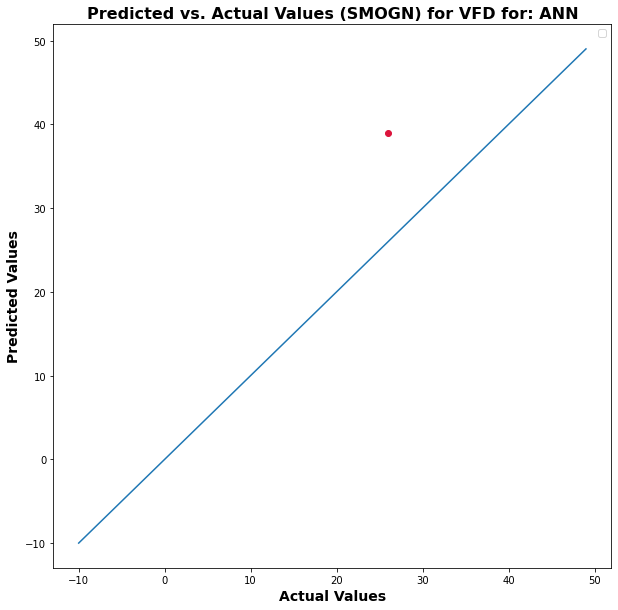

MSE: 			16.931058515566747
MAE: 	2.6698365211486816
R-Squared Score: 	0.680671587918584


No handles with labels found to put in legend.


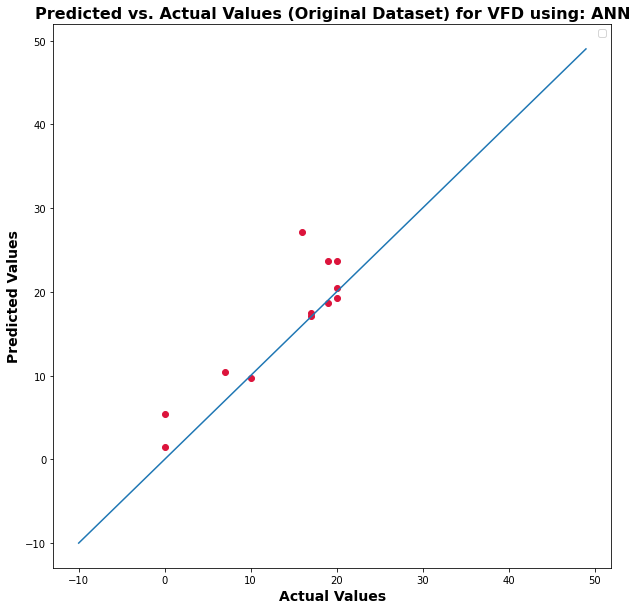

<ipython-input-13-85380e66bd6c>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD


11


r_index: 100%|##########| 8/8 [00:00<00:00, 311.43it/s]

(26, 12)


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


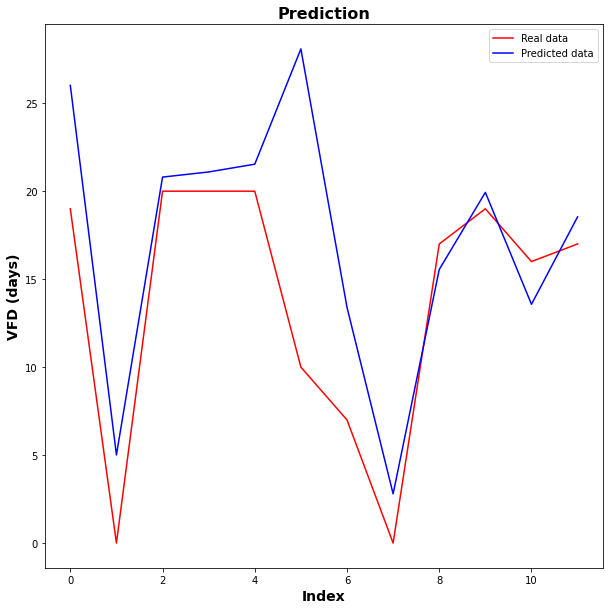

No handles with labels found to put in legend.


MSE: 			634.4962492585182
R-Squared Score: 	nan


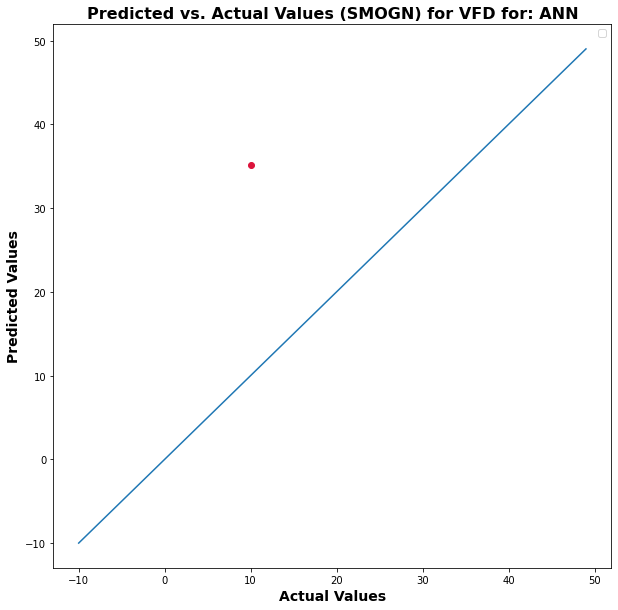

No handles with labels found to put in legend.


MSE: 			38.79698412283786
MAE: 	4.090397457281749
R-Squared Score: 	0.26826906173036635


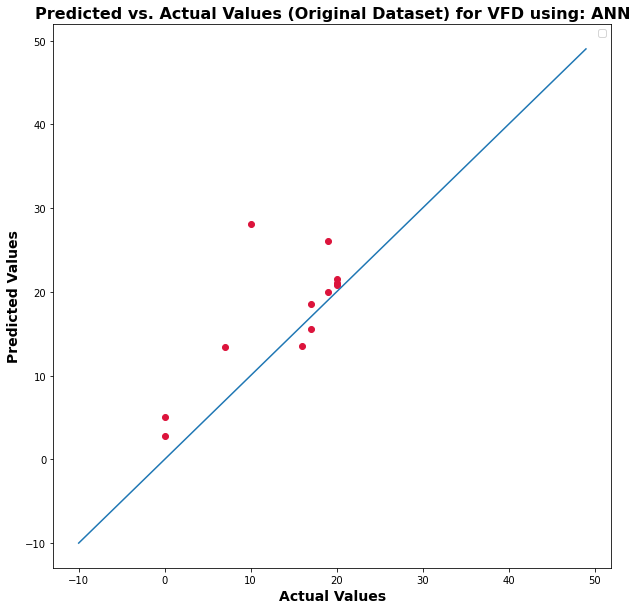

<ipython-input-13-85380e66bd6c>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD


12


r_index: 100%|##########| 8/8 [00:00<00:00, 266.20it/s]


(28, 13)


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


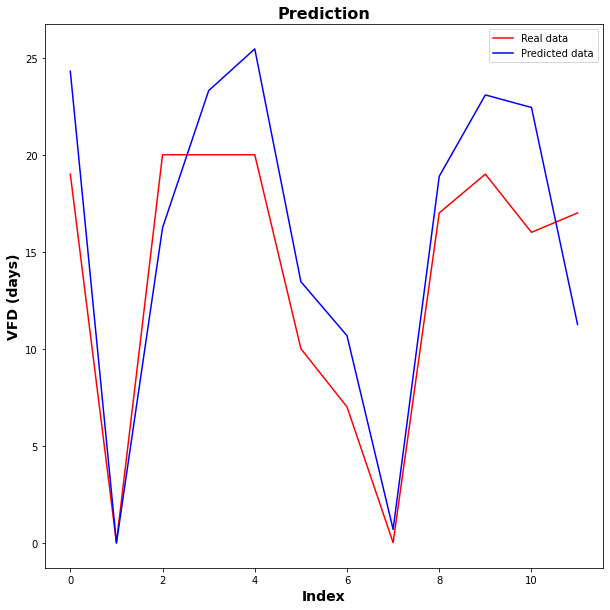

No handles with labels found to put in legend.


MSE: 			10.841865783754656
R-Squared Score: 	nan


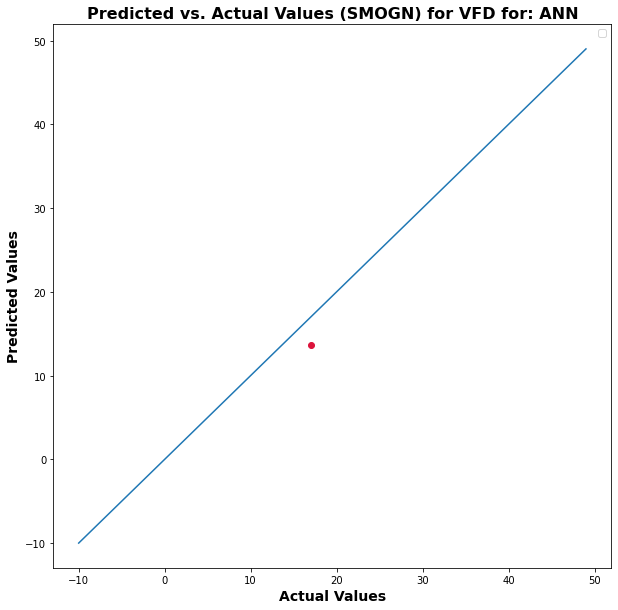

No handles with labels found to put in legend.


MSE: 			16.97355418563969
MAE: 	3.6522600036114454
R-Squared Score: 	0.6798700978739862


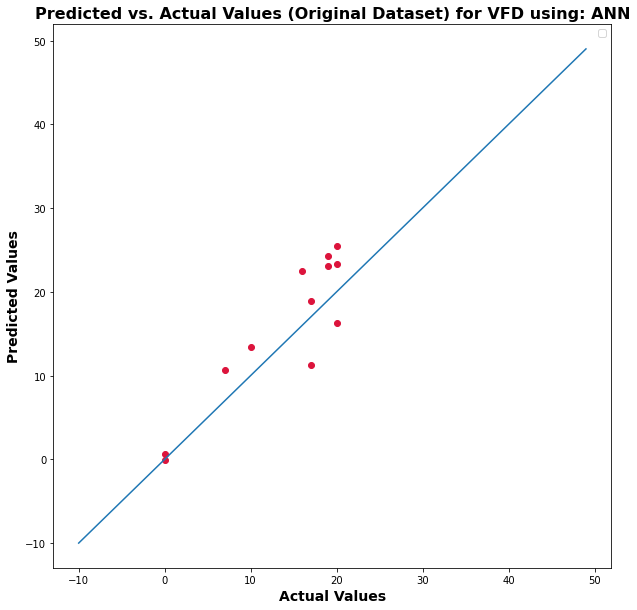

<ipython-input-13-85380e66bd6c>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD


13


r_index: 100%|##########| 8/8 [00:00<00:00, 336.87it/s]

(26, 14)


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


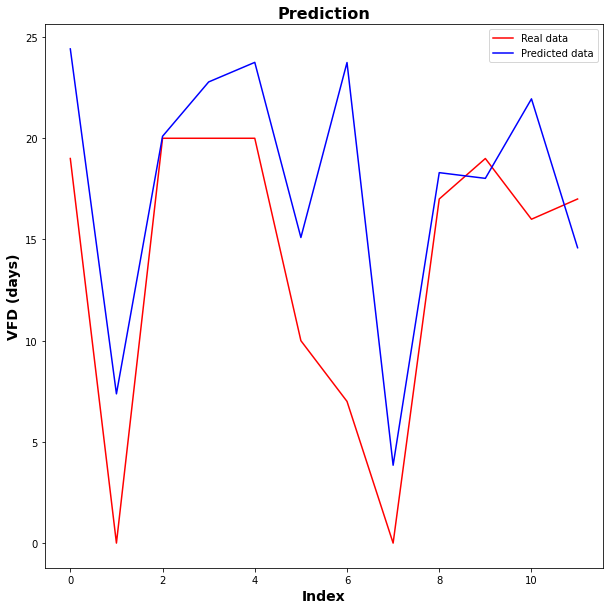

No handles with labels found to put in legend.


MSE: 			322.28305763170647
R-Squared Score: 	nan


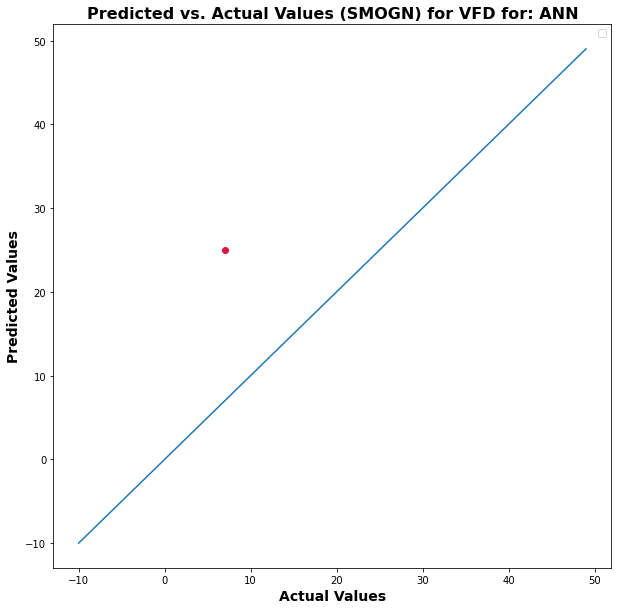

No handles with labels found to put in legend.


MSE: 			39.196417063378796
MAE: 	4.644859830538432
R-Squared Score: 	0.2607355524392211


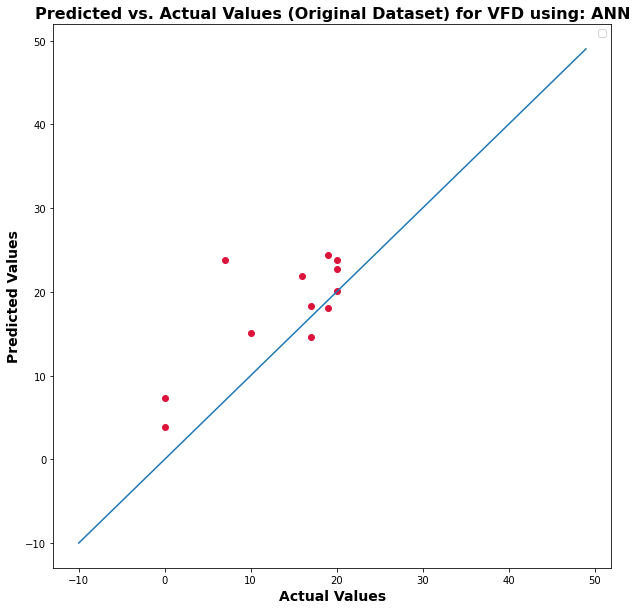

<ipython-input-13-85380e66bd6c>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD


14


r_index: 100%|##########| 8/8 [00:00<00:00, 245.25it/s]


(26, 15)


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


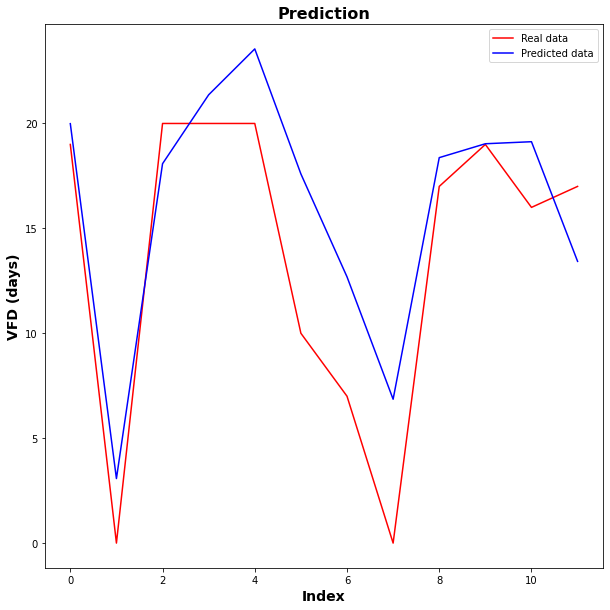

No handles with labels found to put in legend.


MSE: 			28.558660705024522
R-Squared Score: 	nan


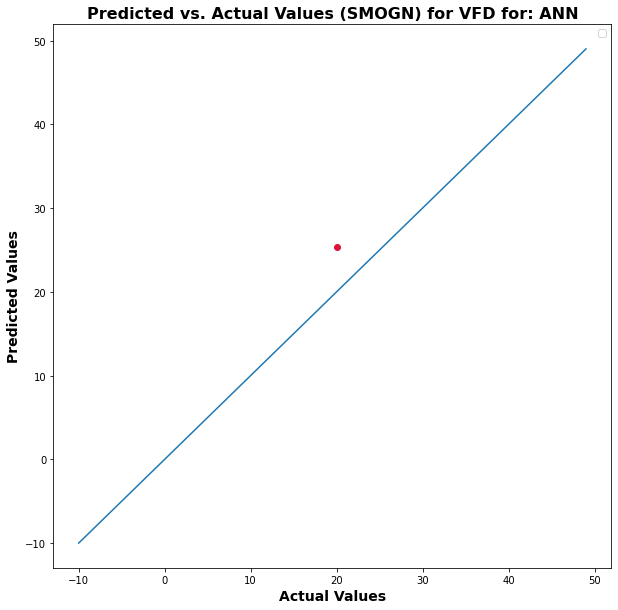

MSE: 			15.844979356738298
MAE: 	3.262881616751353
R-Squared Score: 	0.7011555956292974


No handles with labels found to put in legend.


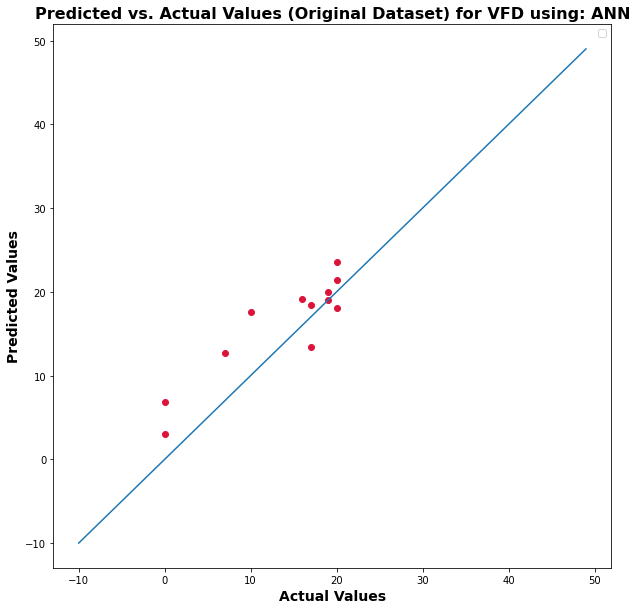

15


<ipython-input-13-85380e66bd6c>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
r_index: 100%|##########| 8/8 [00:00<00:00, 272.28it/s]


(27, 16)


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


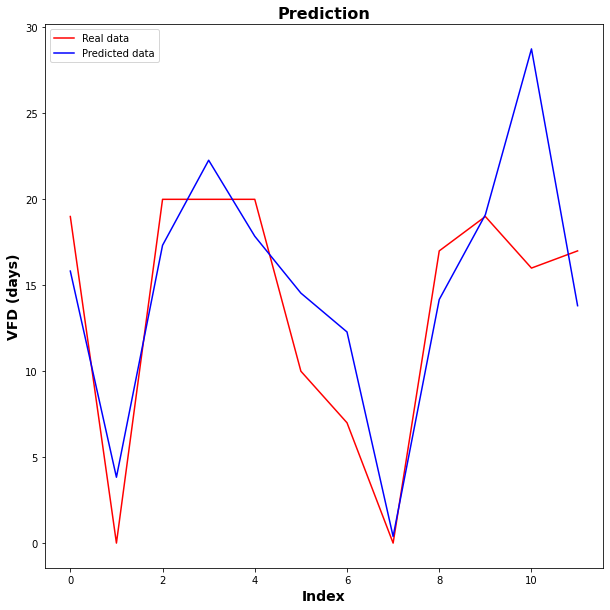

No handles with labels found to put in legend.


MSE: 			37.596312707829384
R-Squared Score: 	nan


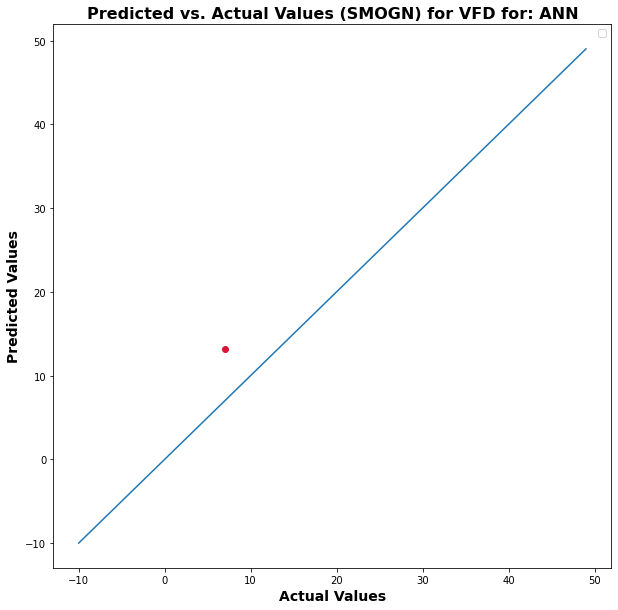

No handles with labels found to put in legend.


MSE: 			22.598213400700605
MAE: 	3.5989640206098557
R-Squared Score: 	0.5737861519710692


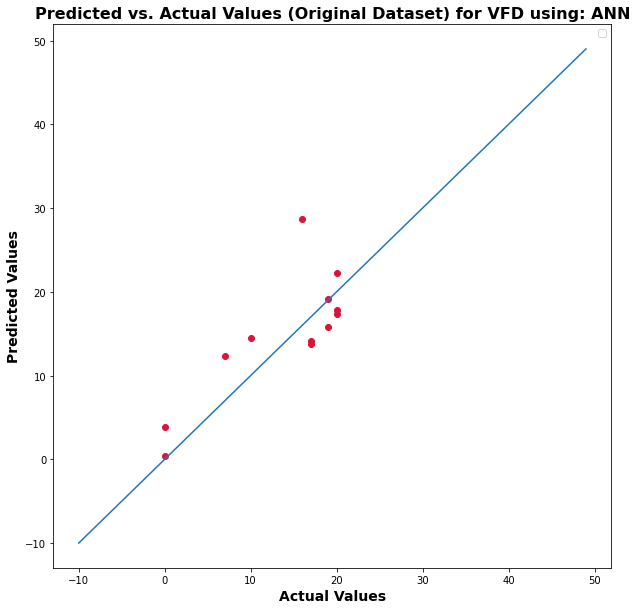

<ipython-input-13-85380e66bd6c>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD


16


r_index: 100%|##########| 8/8 [00:00<00:00, 274.27it/s]


(25, 17)


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


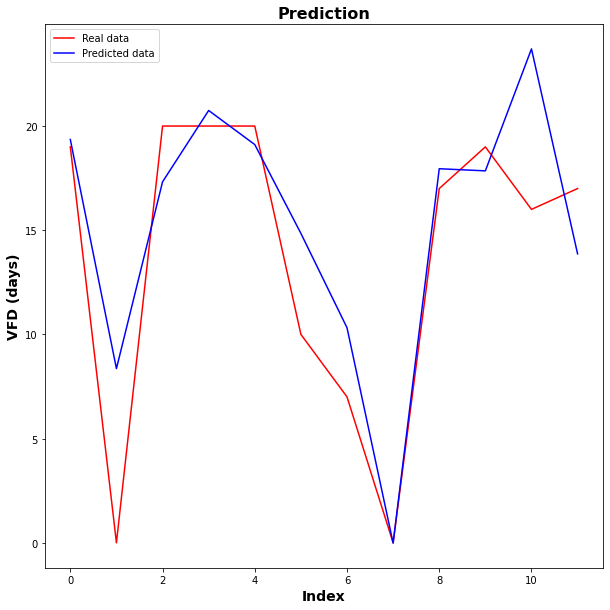

No handles with labels found to put in legend.


MSE: 			14.2772538393192
R-Squared Score: 	nan


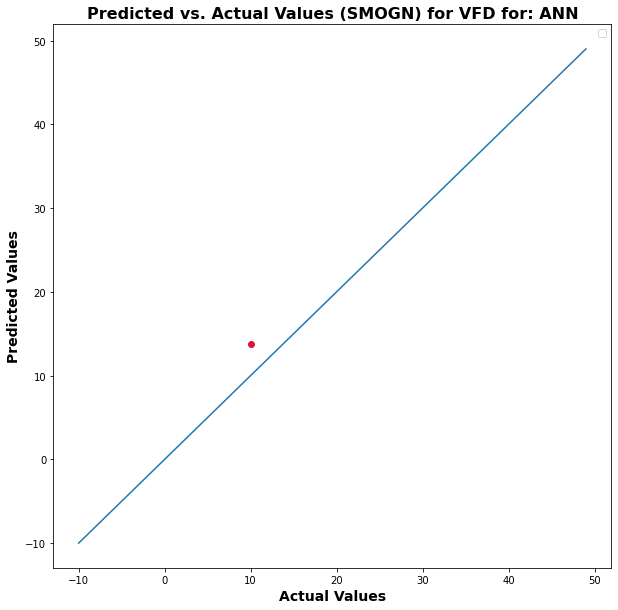

No handles with labels found to put in legend.


MSE: 			15.368127818042561
MAE: 	2.8457365731398263
R-Squared Score: 	0.7101492592274881


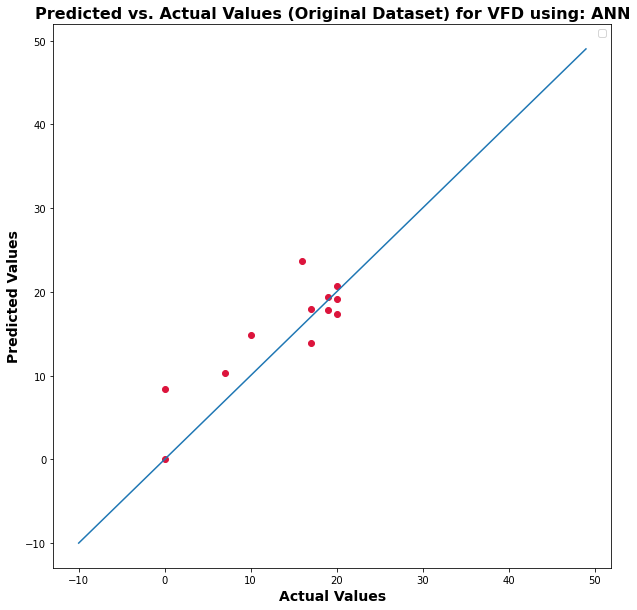

<ipython-input-13-85380e66bd6c>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD


17


r_index: 100%|##########| 8/8 [00:00<00:00, 296.89it/s]


(26, 18)


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


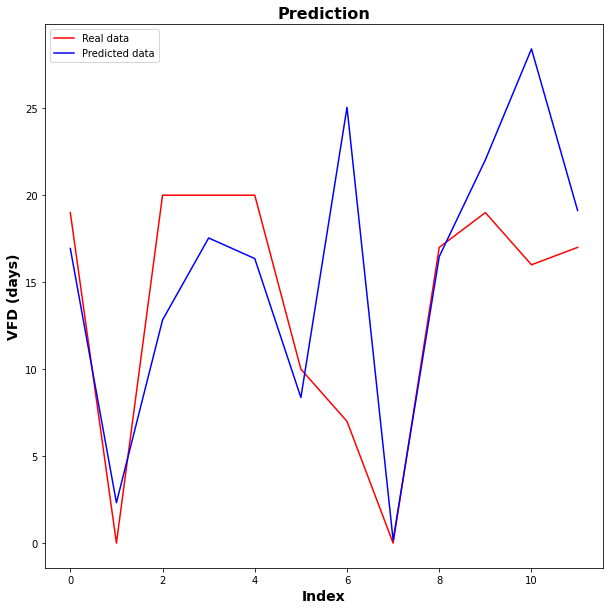

No handles with labels found to put in legend.


MSE: 			238.73093209048966
R-Squared Score: 	nan


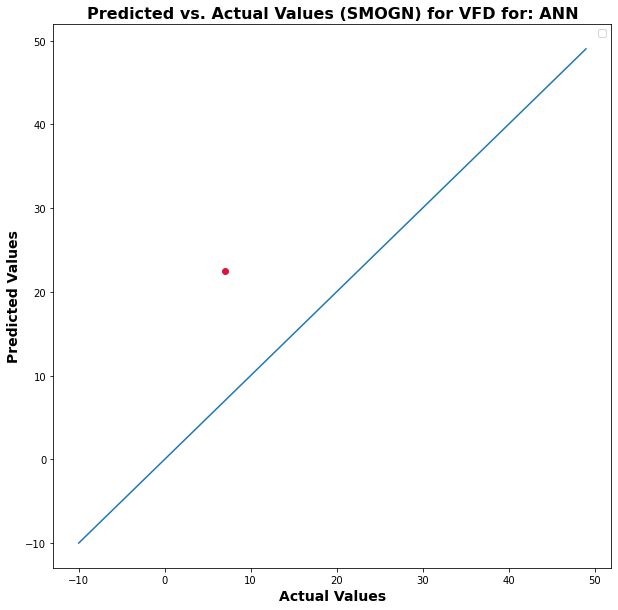

No handles with labels found to put in legend.


MSE: 			48.08444534447989
MAE: 	4.634063996374607
R-Squared Score: 	0.0931027990039156


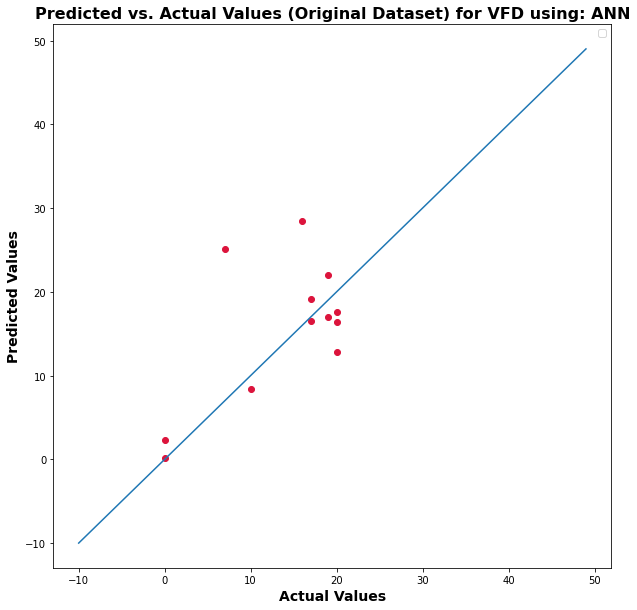

<ipython-input-13-85380e66bd6c>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD


18


r_index: 100%|##########| 8/8 [00:00<00:00, 205.35it/s]


(25, 19)


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


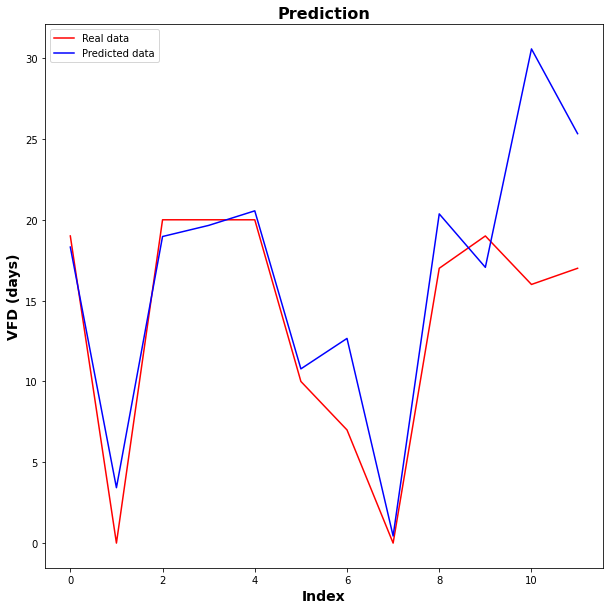

No handles with labels found to put in legend.


MSE: 			12.739772685472929
R-Squared Score: 	nan


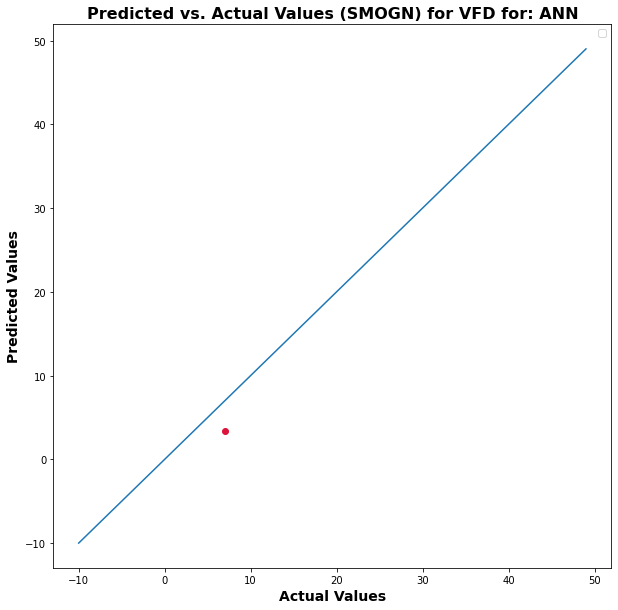

MSE: 			28.610966775666444
MAE: 	3.4278242141008377
R-Squared Score: 	0.4603825519717134


No handles with labels found to put in legend.


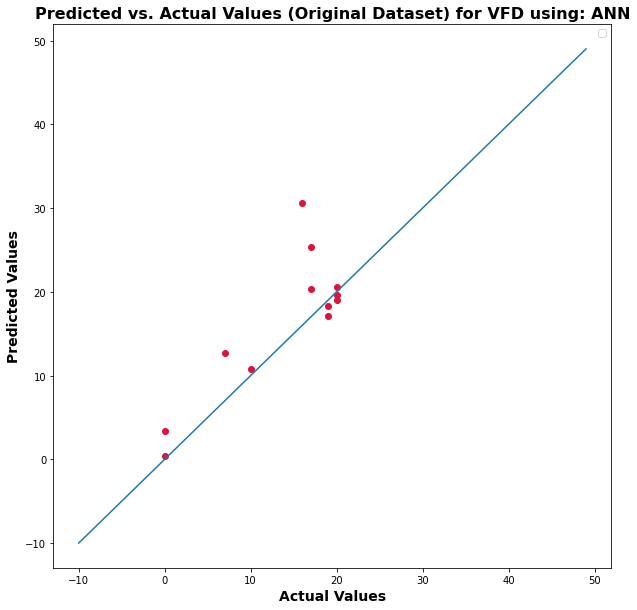

<ipython-input-13-85380e66bd6c>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD


19


r_index: 100%|##########| 8/8 [00:00<00:00, 288.29it/s]


(26, 20)


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


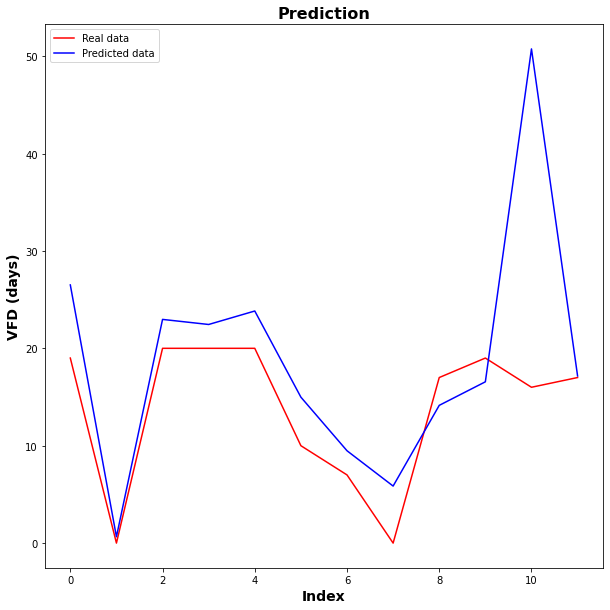

No handles with labels found to put in legend.


MSE: 			26.36801187787205
R-Squared Score: 	nan


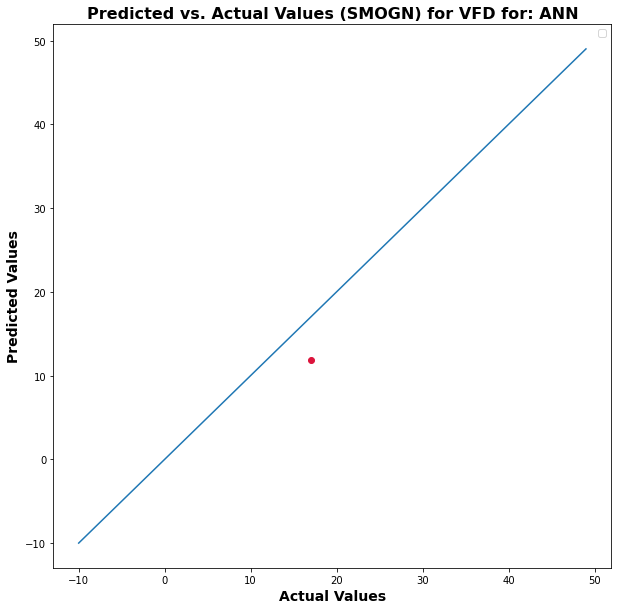

No handles with labels found to put in legend.


MSE: 			114.40385958762293
MAE: 	5.910970325271289
R-Squared Score: 	-1.1577152299433795


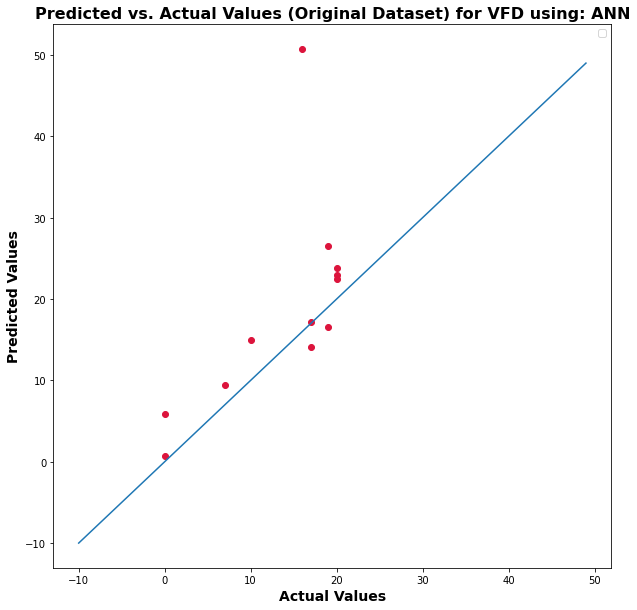

20


<ipython-input-13-85380e66bd6c>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
r_index: 100%|##########| 8/8 [00:00<00:00, 204.80it/s]


(27, 21)


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


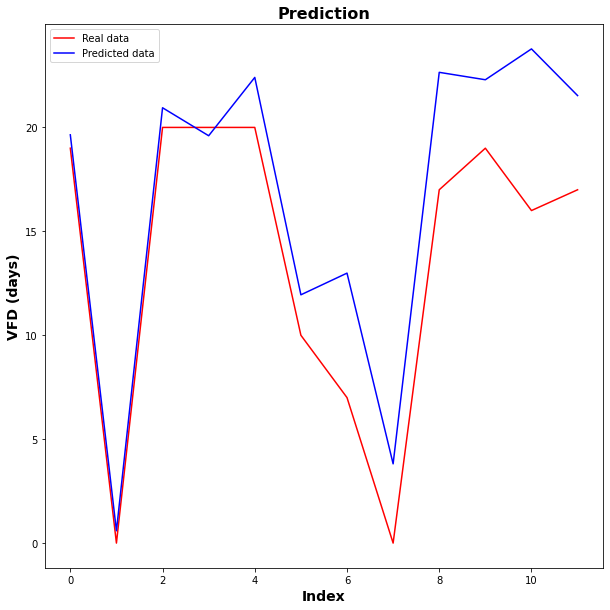

No handles with labels found to put in legend.


MSE: 			27.246142740841606
R-Squared Score: 	nan


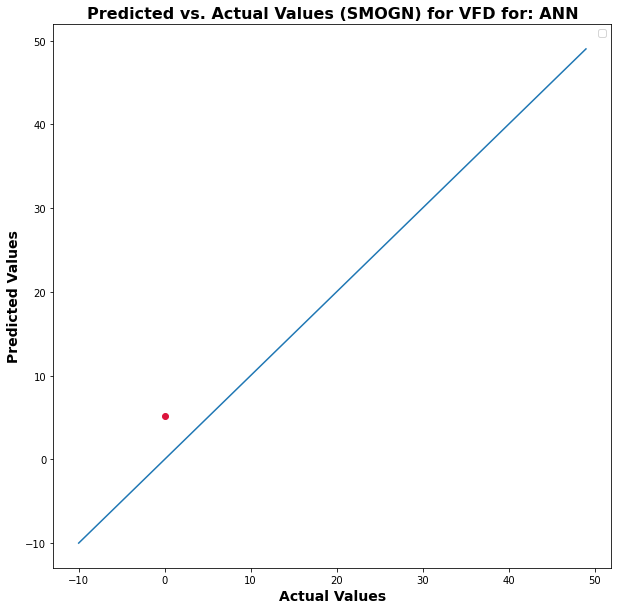

No handles with labels found to put in legend.


MSE: 			15.468219429824886
MAE: 	3.165959969162941
R-Squared Score: 	0.7082614803019275


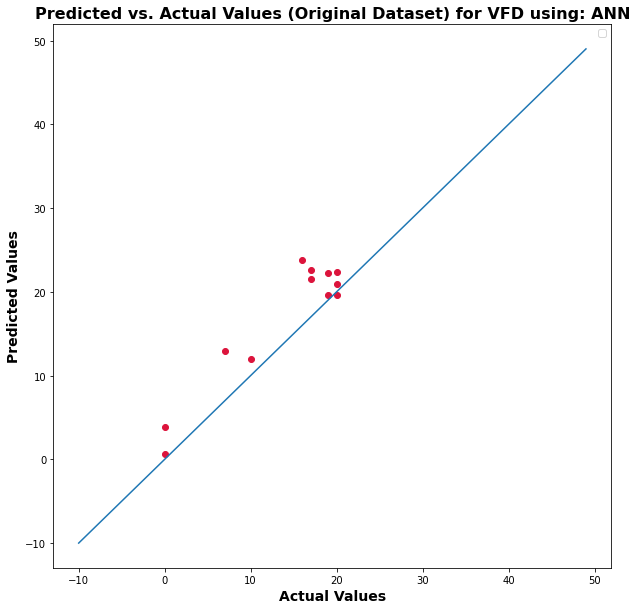

<ipython-input-13-85380e66bd6c>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD


21


r_index: 100%|##########| 8/8 [00:00<00:00, 223.19it/s]


(26, 22)


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


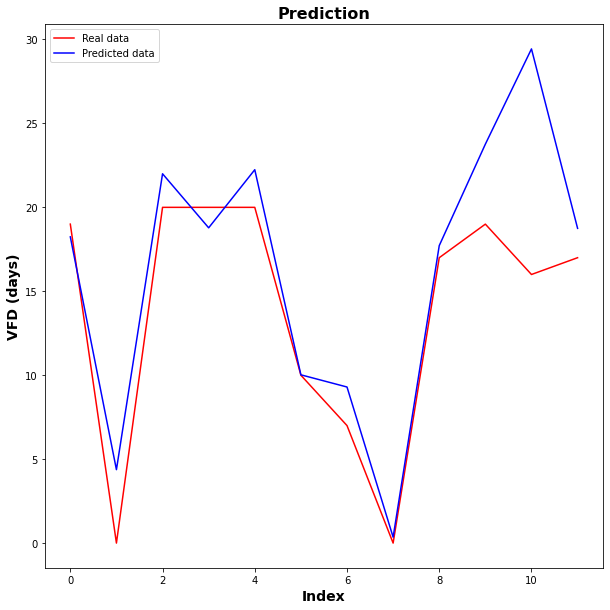

No handles with labels found to put in legend.


MSE: 			39.487030936885276
R-Squared Score: 	nan


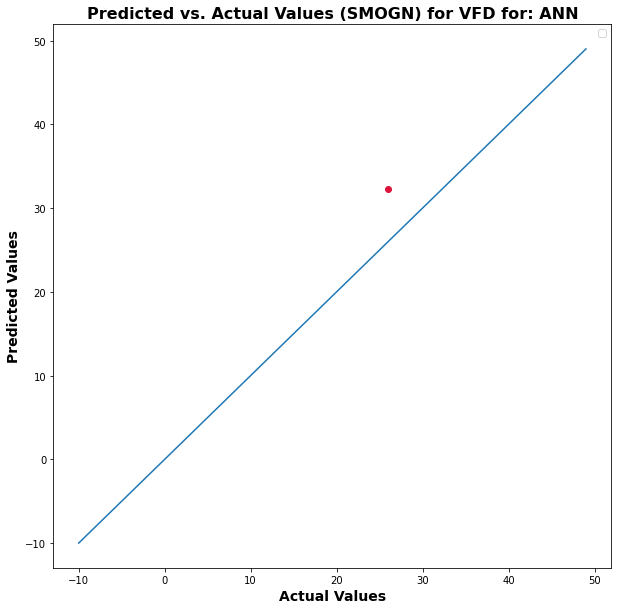

No handles with labels found to put in legend.


MSE: 			20.205638920272364
MAE: 	2.828202332059542
R-Squared Score: 	0.6189113288121519


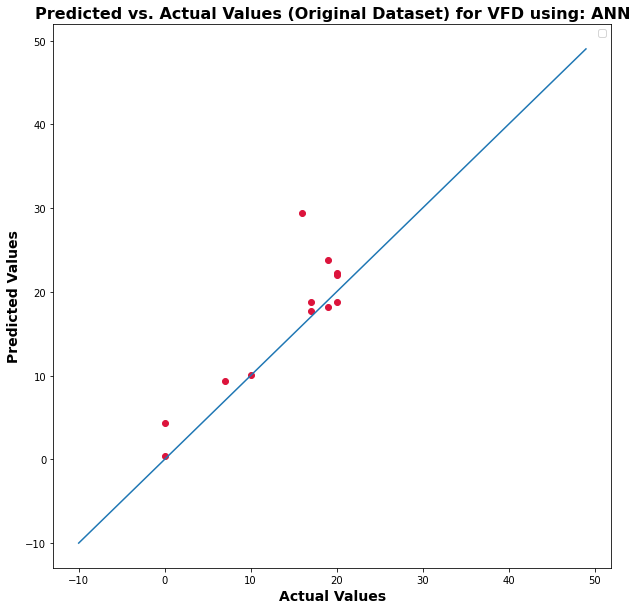

<ipython-input-13-85380e66bd6c>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD


22


r_index: 100%|##########| 8/8 [00:00<00:00, 274.26it/s]


(25, 23)


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


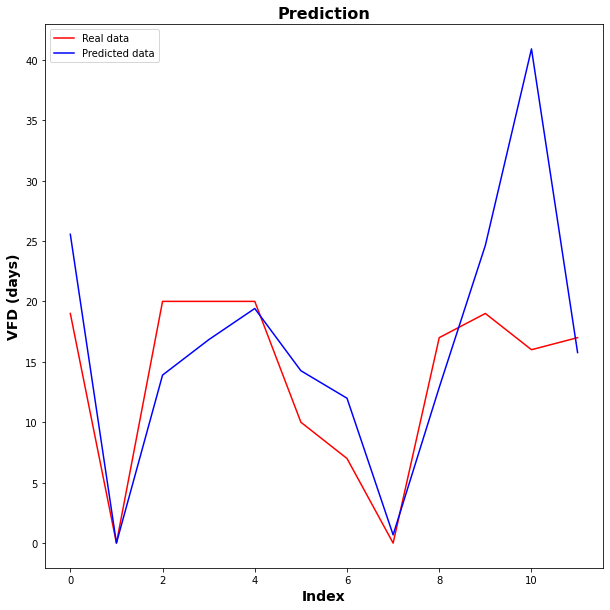

No handles with labels found to put in legend.


MSE: 			0.00015167659995740657
R-Squared Score: 	nan


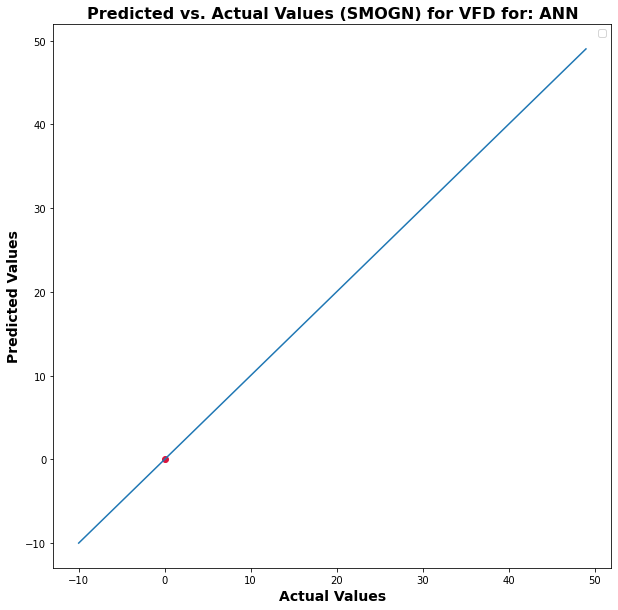

MSE: 			66.98177318740107
MAE: 	5.184596394499143
R-Squared Score: 	-0.2633104569725939


No handles with labels found to put in legend.


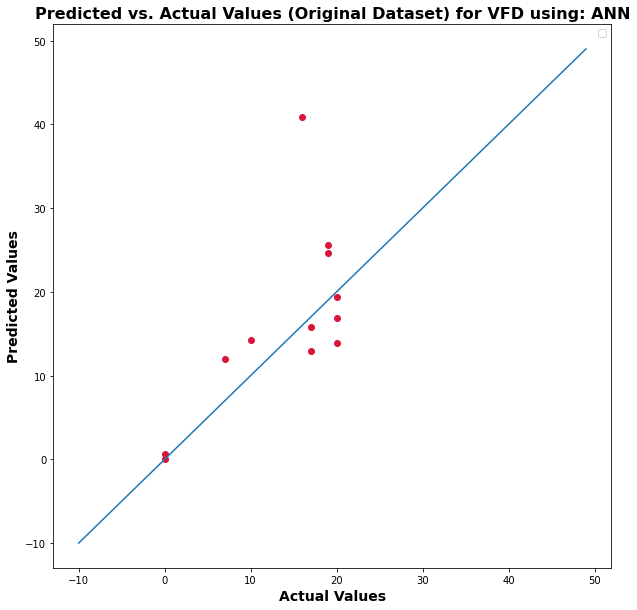

<ipython-input-13-85380e66bd6c>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD


23


r_index: 100%|##########| 8/8 [00:00<00:00, 208.90it/s]


(28, 24)


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


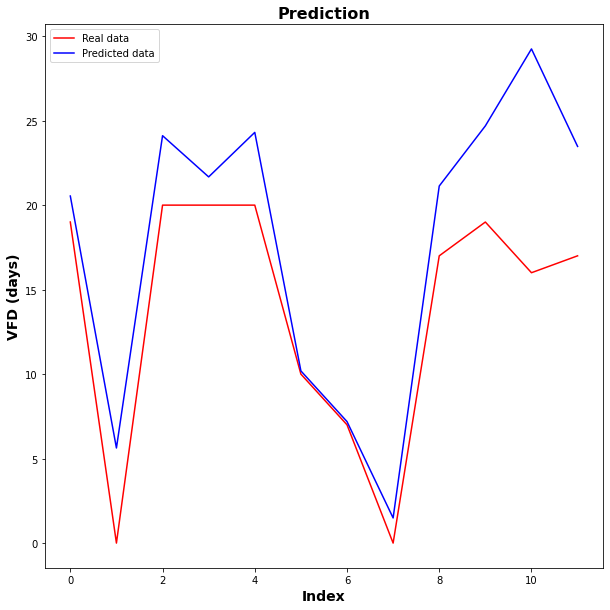

No handles with labels found to put in legend.


MSE: 			8.891814206159324
R-Squared Score: 	nan


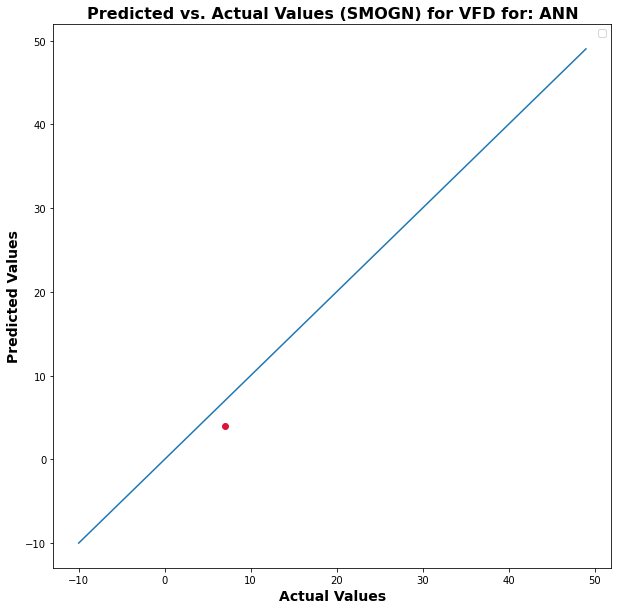

No handles with labels found to put in legend.


MSE: 			28.443960027401648
MAE: 	4.055025051037471
R-Squared Score: 	0.4635323845519532


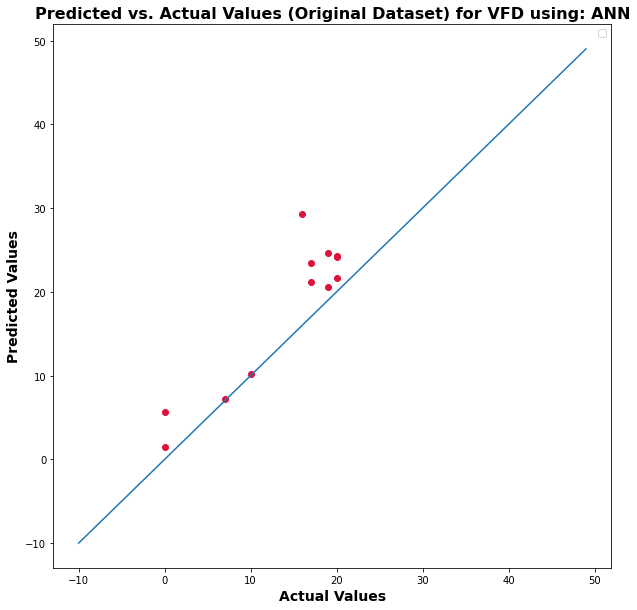

<ipython-input-13-85380e66bd6c>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD


24


r_index: 100%|##########| 8/8 [00:00<00:00, 207.52it/s]


(26, 25)


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


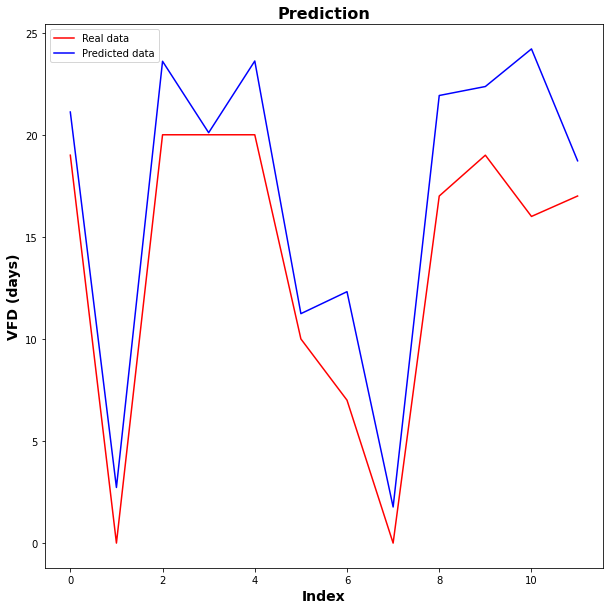

No handles with labels found to put in legend.


MSE: 			0.05639931938480913
R-Squared Score: 	nan


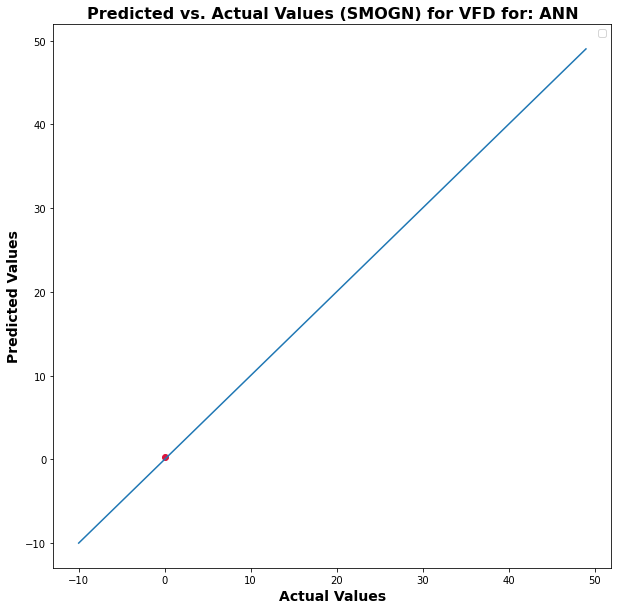

No handles with labels found to put in legend.


MSE: 			14.724362936110964
MAE: 	3.2244829734166465
R-Squared Score: 	0.722290993739361


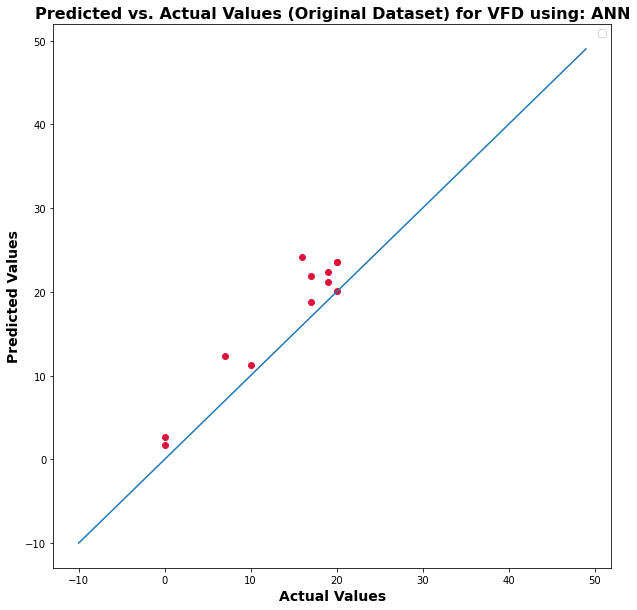

25


<ipython-input-13-85380e66bd6c>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
r_index: 100%|##########| 8/8 [00:00<00:00, 204.83it/s]


(25, 26)


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


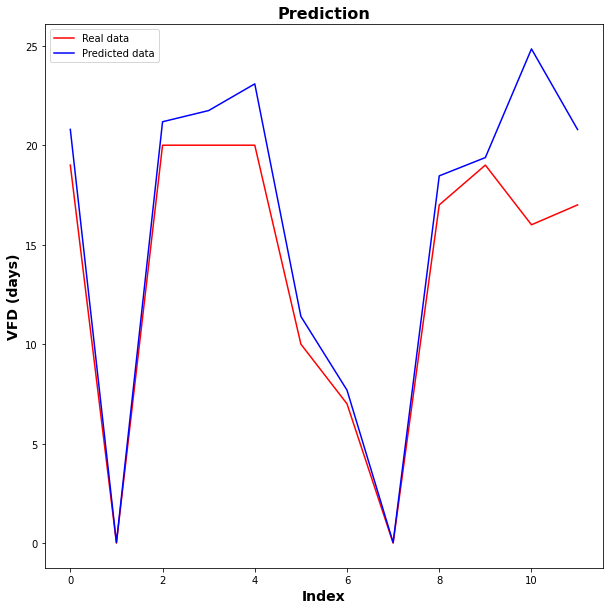

No handles with labels found to put in legend.


MSE: 			0.9713095980262096
R-Squared Score: 	nan


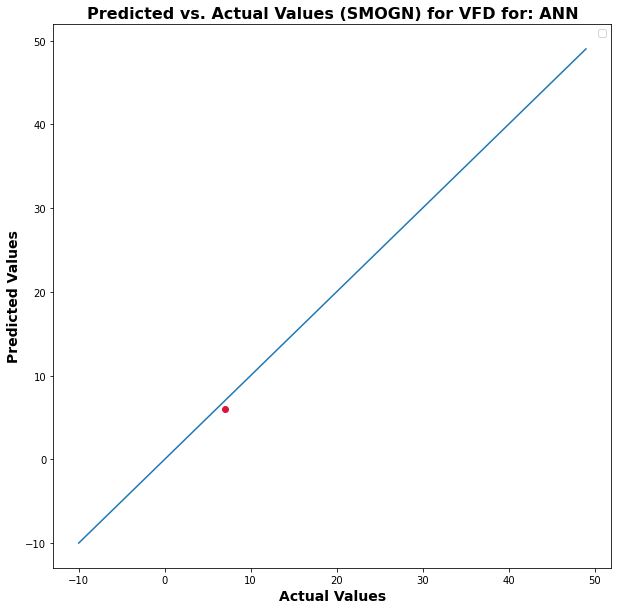

No handles with labels found to put in legend.


MSE: 			9.526507735929433
MAE: 	2.033354644974073
R-Squared Score: 	0.8203251979078142


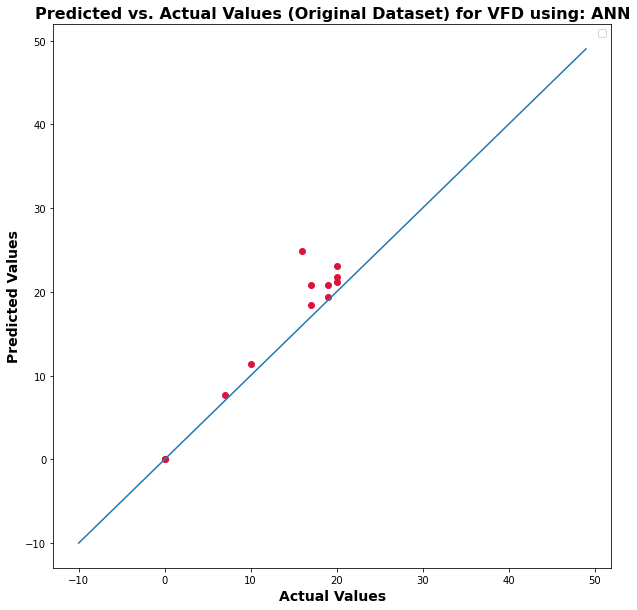

<ipython-input-13-85380e66bd6c>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD


26


r_index: 100%|##########| 8/8 [00:00<00:00, 195.23it/s]


(26, 27)


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


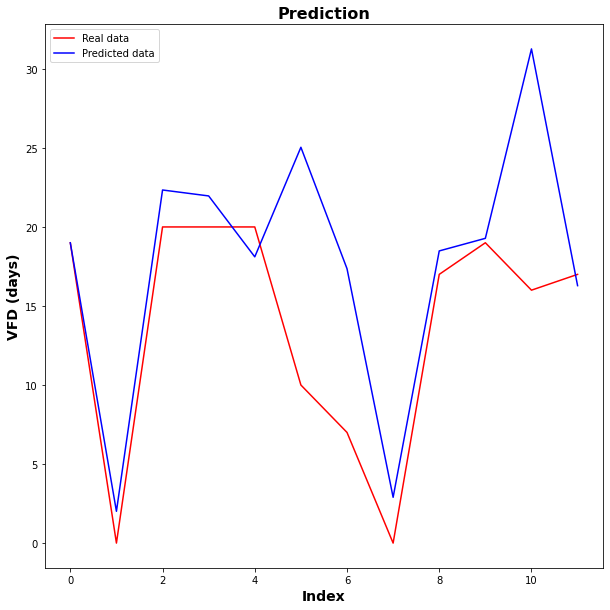

No handles with labels found to put in legend.


MSE: 			49.26225181762129
R-Squared Score: 	nan


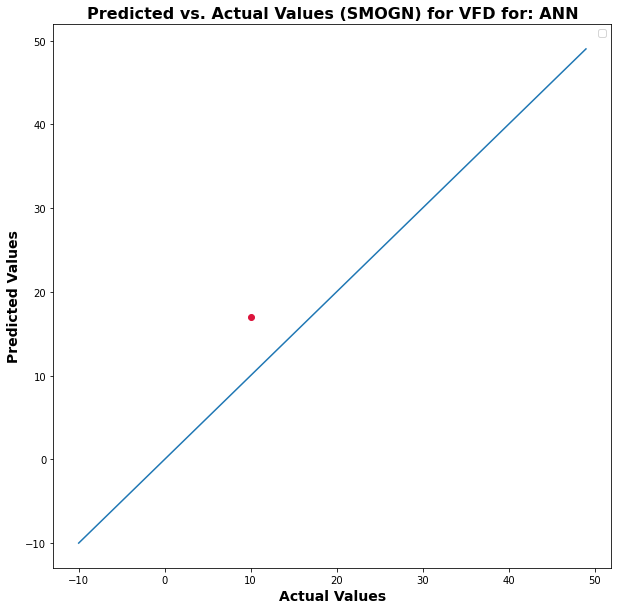

No handles with labels found to put in legend.


MSE: 			49.55107377216067
MAE: 	4.520296971003215
R-Squared Score: 	0.06544143769598731


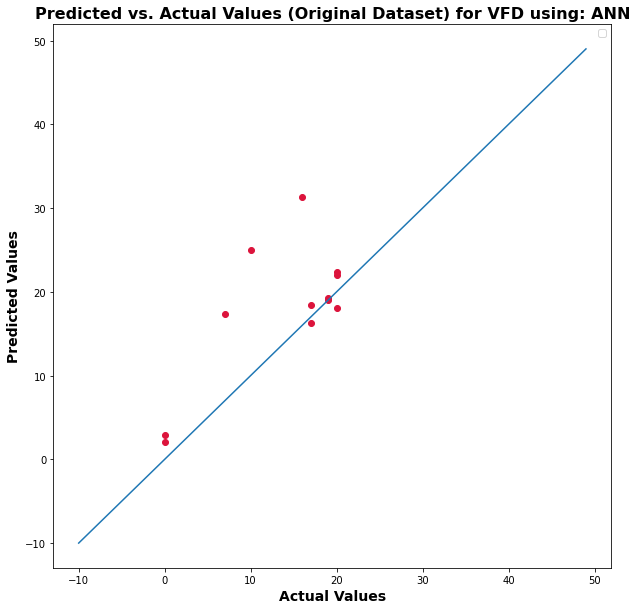

<ipython-input-13-85380e66bd6c>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD


27


r_index: 100%|##########| 8/8 [00:00<00:00, 177.06it/s]


(25, 28)


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


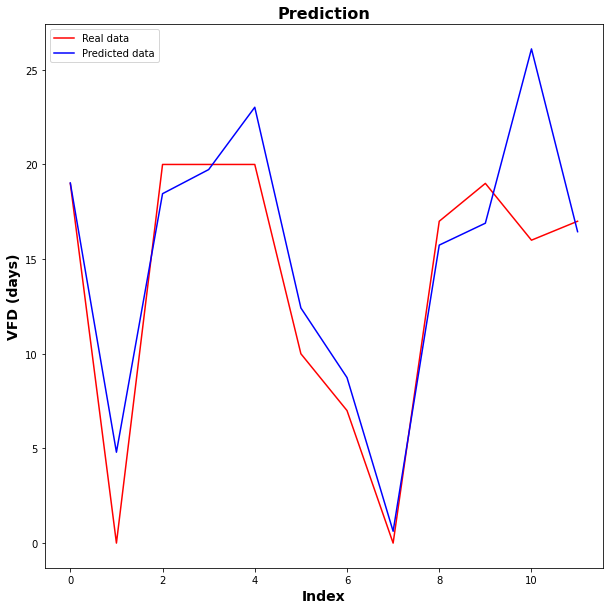

No handles with labels found to put in legend.


MSE: 			13.977670241296437
R-Squared Score: 	nan


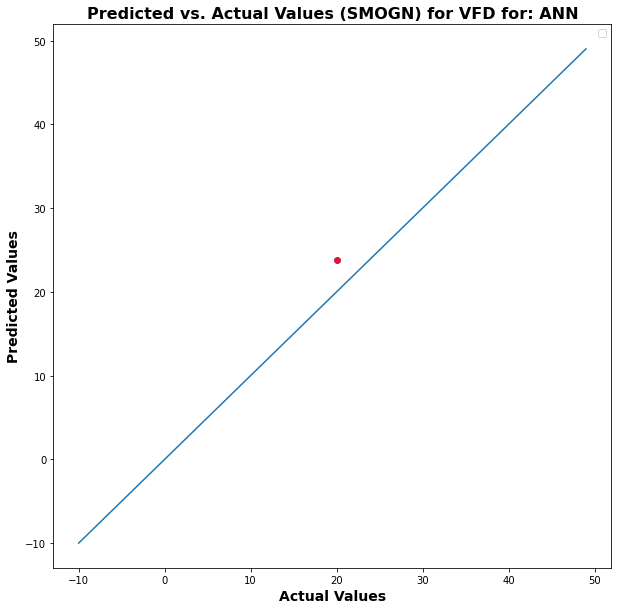

No handles with labels found to put in legend.


MSE: 			12.69172257369604
MAE: 	2.3716144959131875
R-Squared Score: 	0.7606276292583851


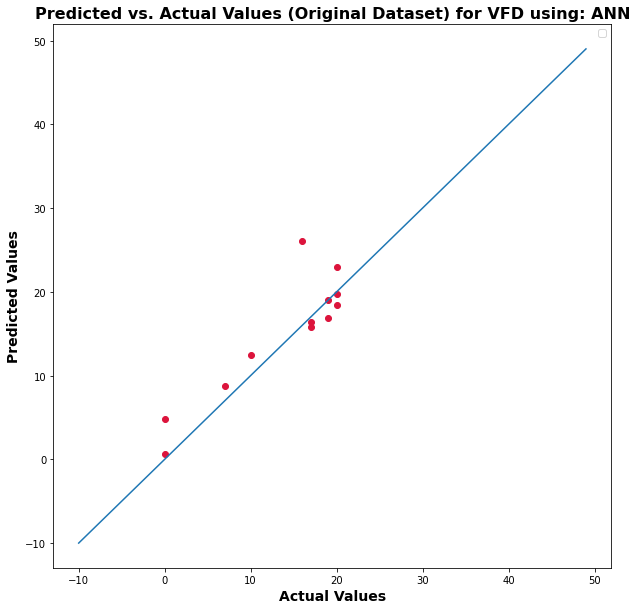

<ipython-input-13-85380e66bd6c>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD


28


r_index: 100%|##########| 8/8 [00:00<00:00, 189.91it/s]


(26, 29)


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


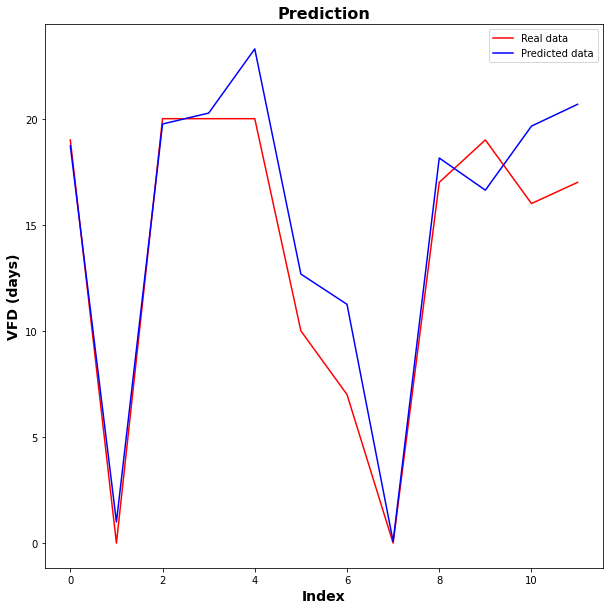

No handles with labels found to put in legend.


MSE: 			17.357386682855577
R-Squared Score: 	nan


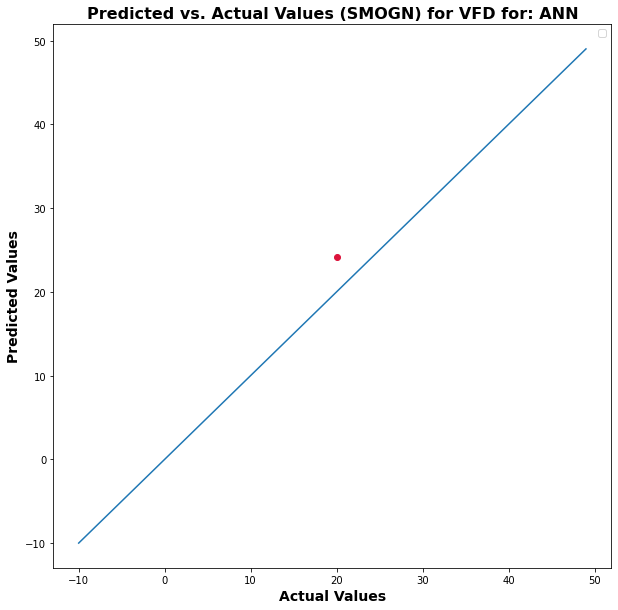

No handles with labels found to put in legend.


MSE: 			5.9205046362073235
MAE: 	1.9102839281161625
R-Squared Score: 	0.8883362583347931


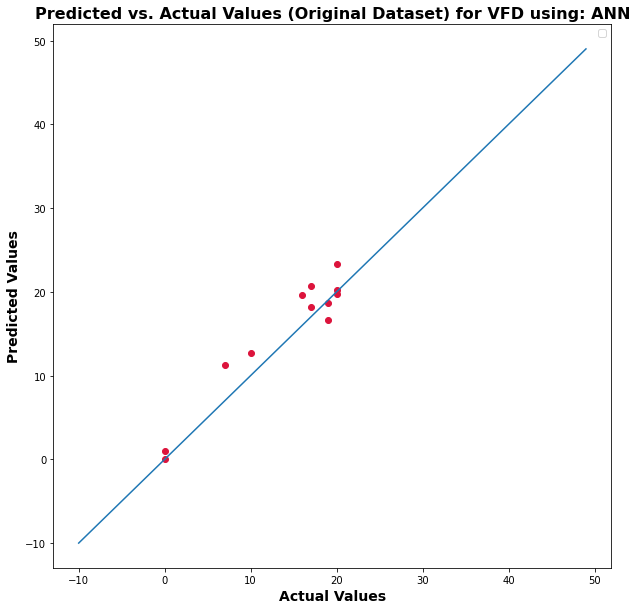

<ipython-input-13-85380e66bd6c>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD


29


r_index: 100%|##########| 8/8 [00:00<00:00, 208.72it/s]


(26, 30)


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


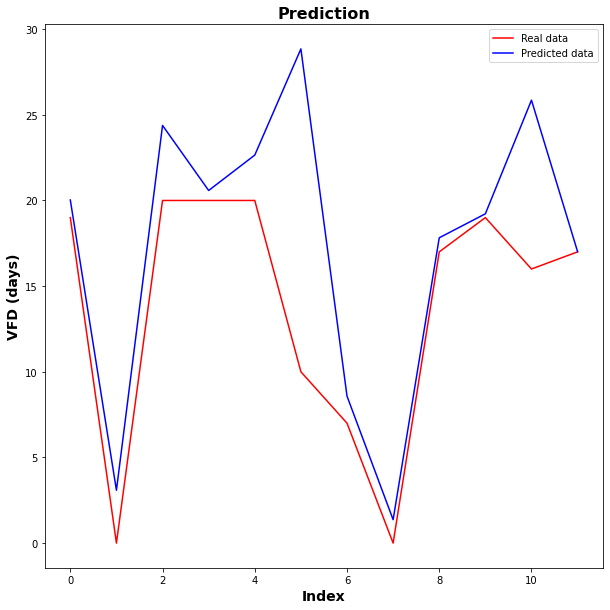

No handles with labels found to put in legend.


MSE: 			614.3639151473908
R-Squared Score: 	nan


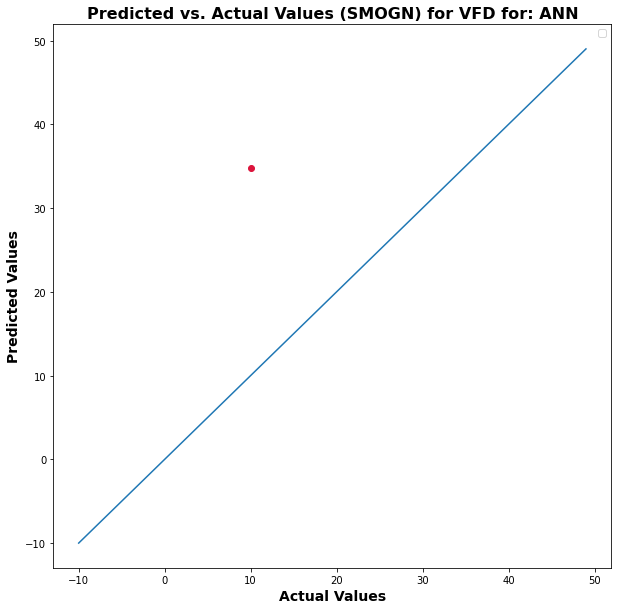

No handles with labels found to put in legend.


MSE: 			41.21110439697983
MAE: 	3.7024024625619254
R-Squared Score: 	0.22273752021413296


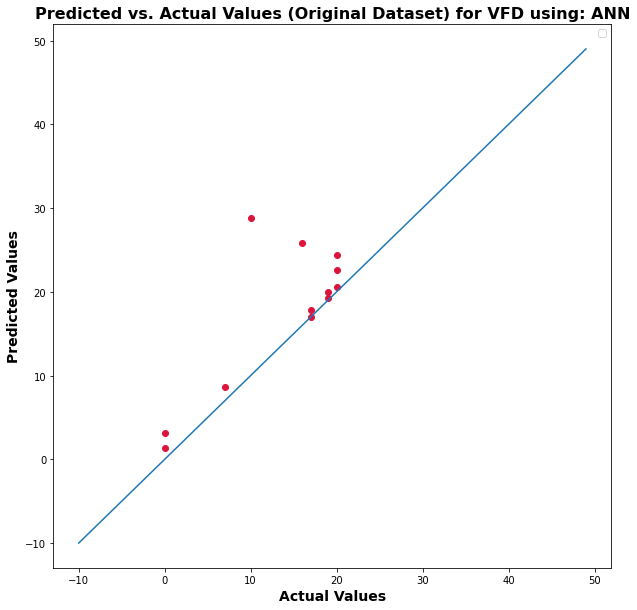

30


<ipython-input-13-85380e66bd6c>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
r_index: 100%|##########| 8/8 [00:00<00:00, 134.82it/s]


(27, 31)


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


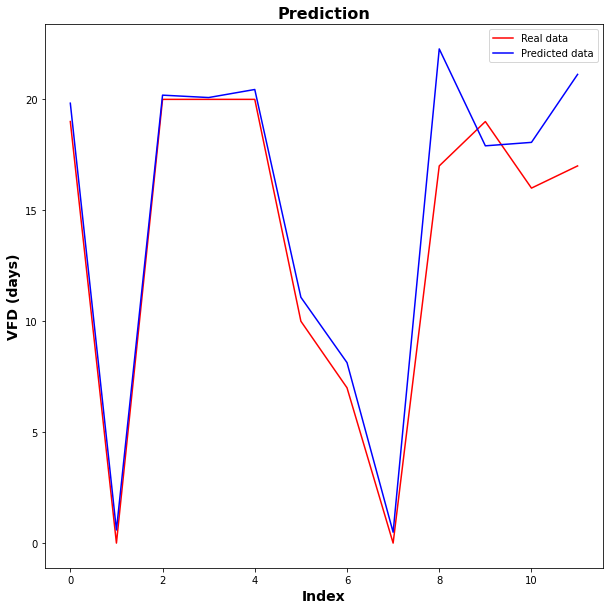

No handles with labels found to put in legend.


MSE: 			6.92920610422243
R-Squared Score: 	nan


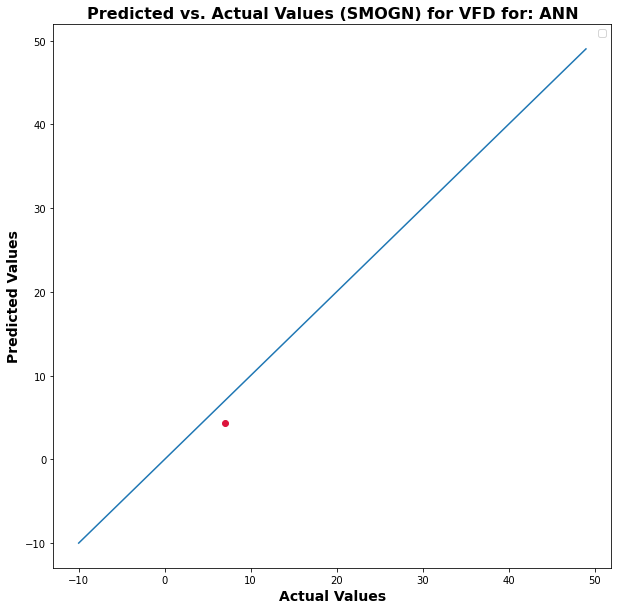

No handles with labels found to put in legend.


MSE: 			4.5207817004460535
MAE: 	1.4494641025861104
R-Squared Score: 	0.9147357478894261


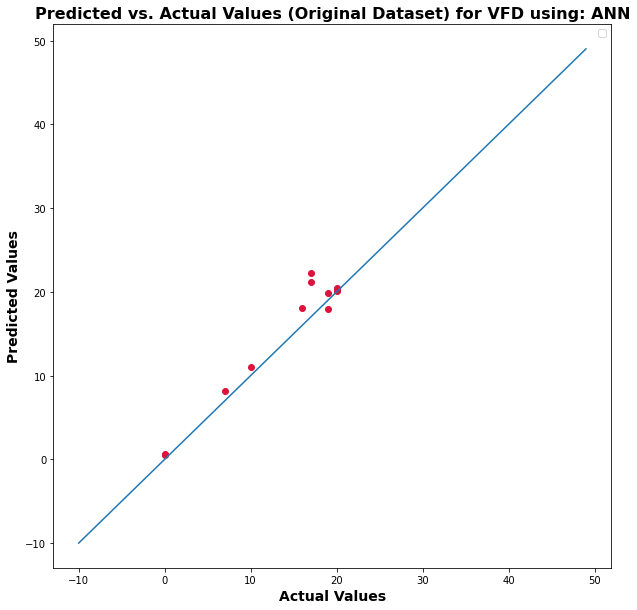

<ipython-input-13-85380e66bd6c>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD


31


r_index: 100%|##########| 8/8 [00:00<00:00, 168.71it/s]


(27, 32)


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


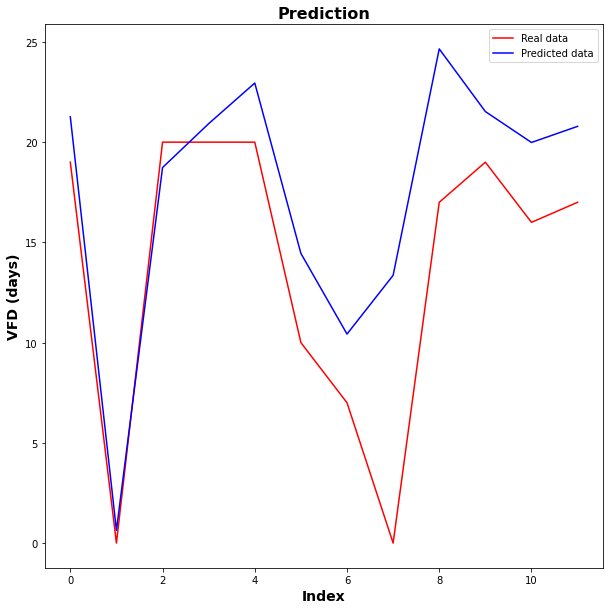

No handles with labels found to put in legend.


MSE: 			249.3226531797418
R-Squared Score: 	nan


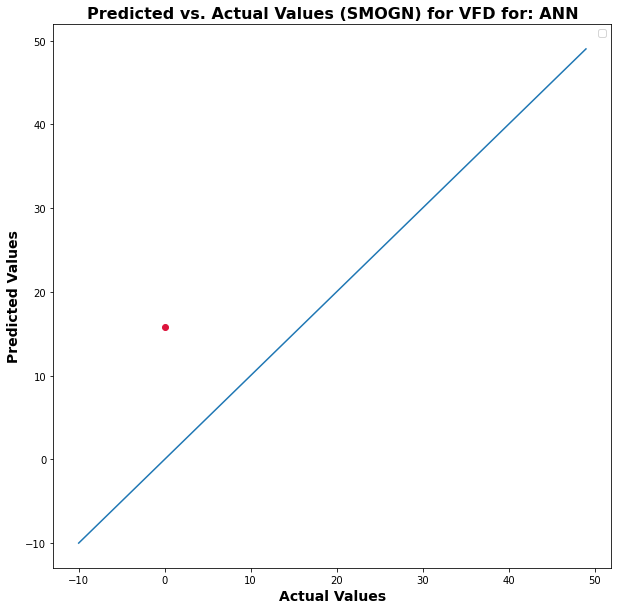

No handles with labels found to put in legend.


MSE: 			26.813622539517237
MAE: 	3.9351442456245422
R-Squared Score: 	0.4942813823588105


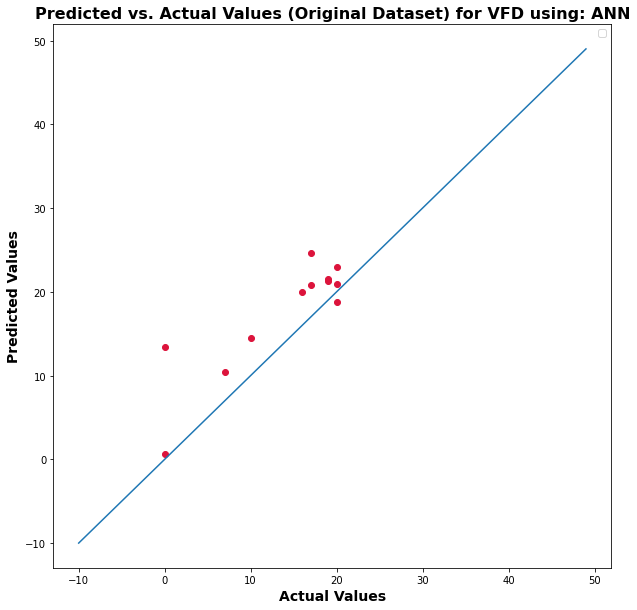

<ipython-input-13-85380e66bd6c>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD


32


r_index: 100%|##########| 8/8 [00:00<00:00, 179.64it/s]


(27, 33)


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


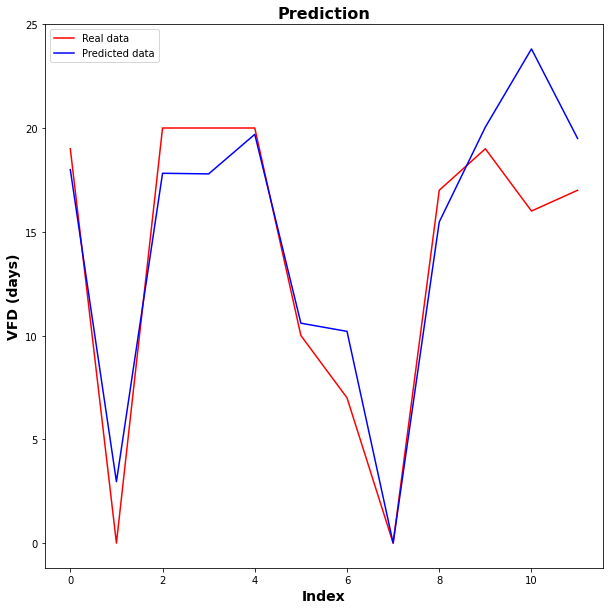

No handles with labels found to put in legend.


MSE: 			56.395090083184186
R-Squared Score: 	nan


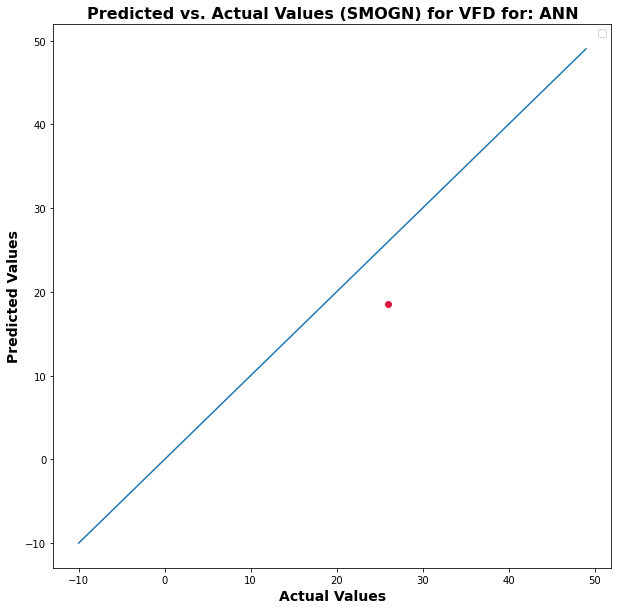

No handles with labels found to put in legend.


MSE: 			8.398476438852258
MAE: 	2.111736530593286
R-Squared Score: 	0.8416004443752816


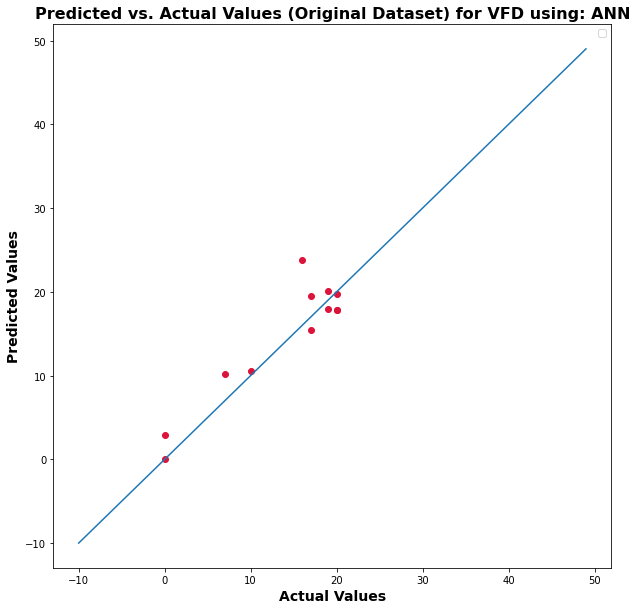

<ipython-input-13-85380e66bd6c>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD


33


r_index: 100%|##########| 8/8 [00:00<00:00, 179.22it/s]


(25, 34)


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


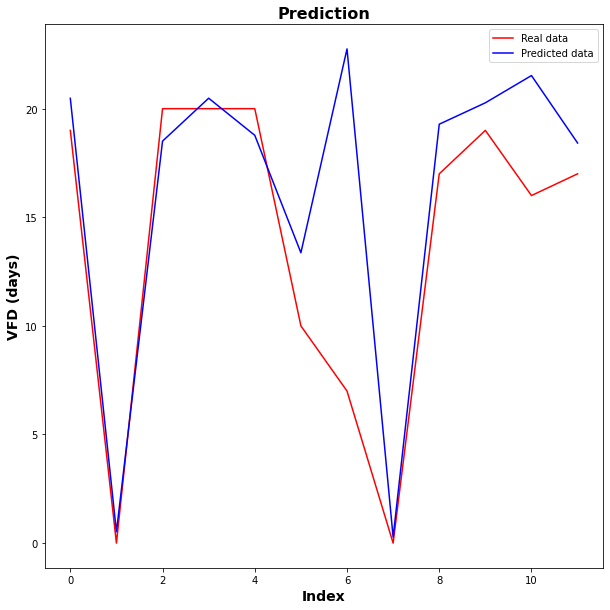

No handles with labels found to put in legend.


MSE: 			134.17040021486173
R-Squared Score: 	nan


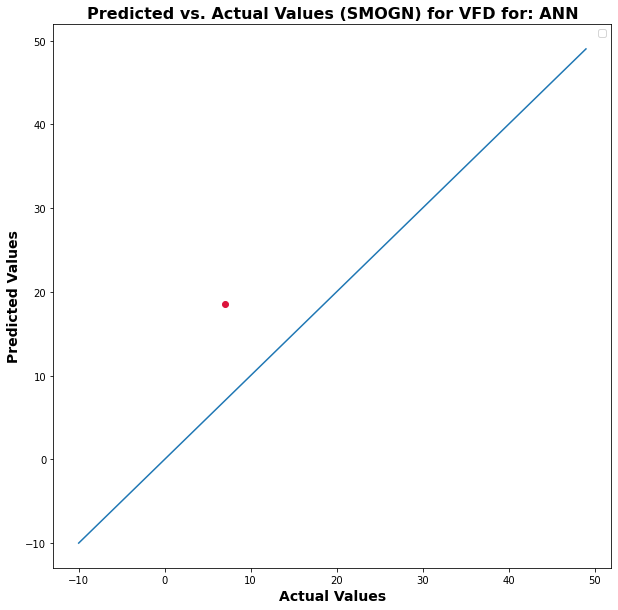

No handles with labels found to put in legend.


MSE: 			25.441454260827783
MAE: 	2.9242267732818923
R-Squared Score: 	0.5201611770059986


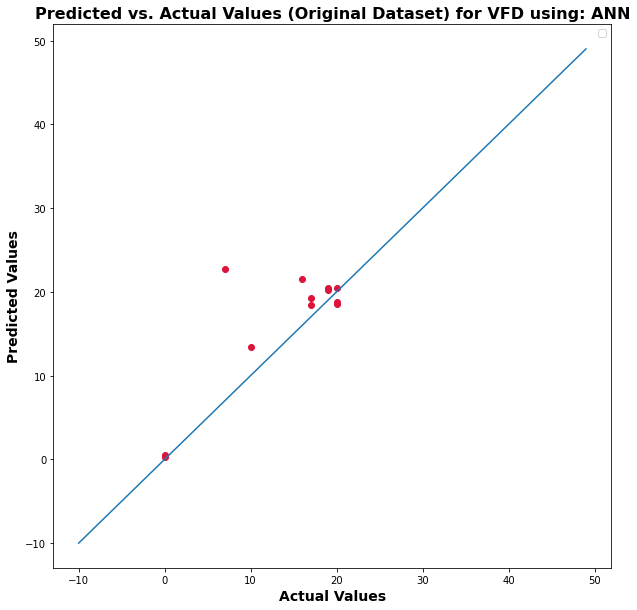

<ipython-input-13-85380e66bd6c>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD


34


r_index: 100%|##########| 8/8 [00:00<00:00, 169.51it/s]


(26, 35)


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


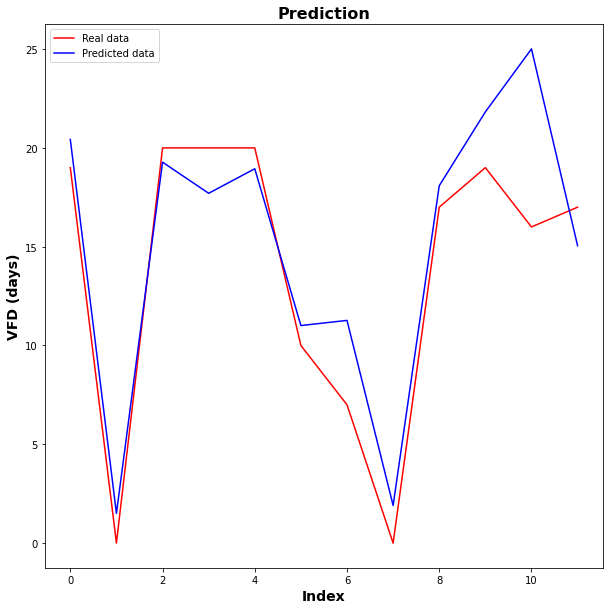

No handles with labels found to put in legend.


MSE: 			3.6925075569242836
R-Squared Score: 	nan


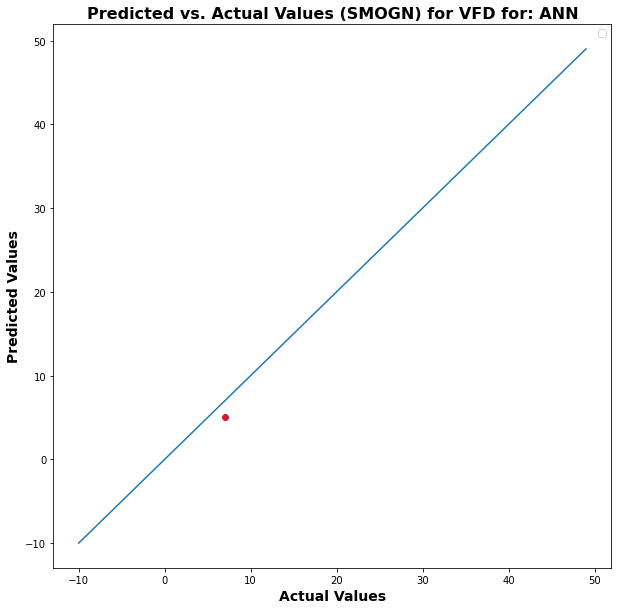

No handles with labels found to put in legend.


MSE: 			10.683397096388333
MAE: 	2.4212039411067963
R-Squared Score: 	0.7985056736241101


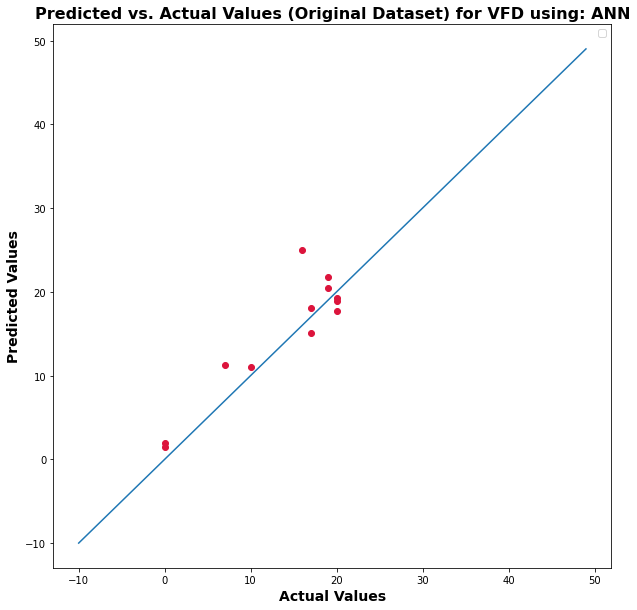

35


<ipython-input-13-85380e66bd6c>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
r_index: 100%|##########| 8/8 [00:00<00:00, 141.38it/s]


(27, 36)


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


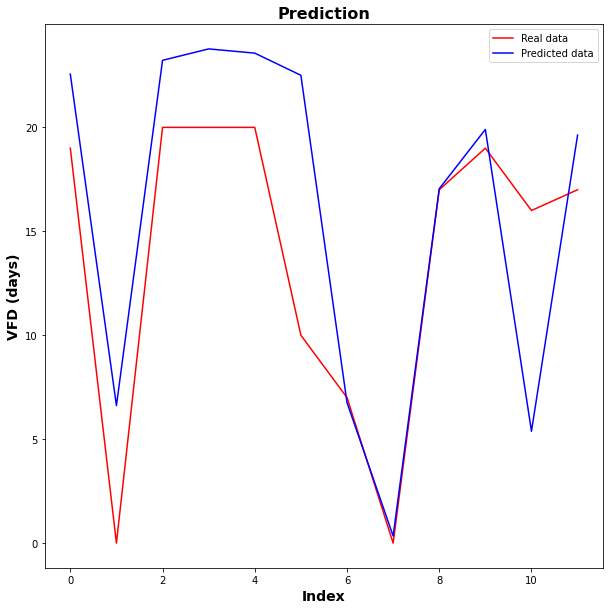

No handles with labels found to put in legend.


MSE: 			140.90475355181843
R-Squared Score: 	nan


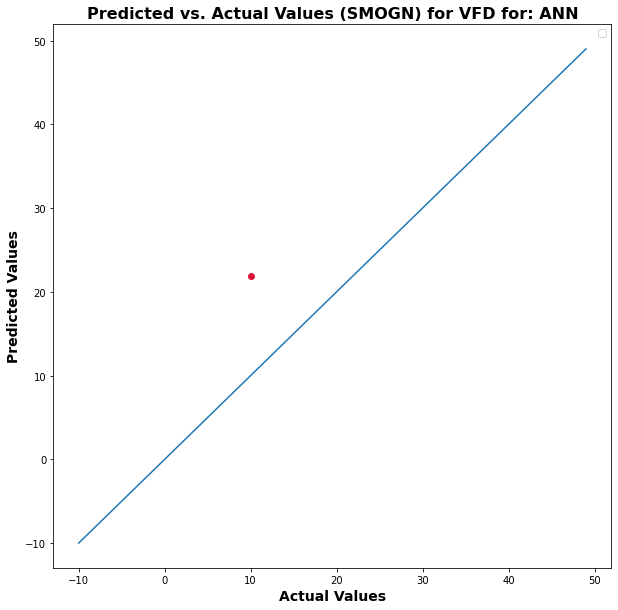

MSE: 			30.907748391437266
MAE: 	4.002551694711049
R-Squared Score: 	0.41706407748959184


No handles with labels found to put in legend.


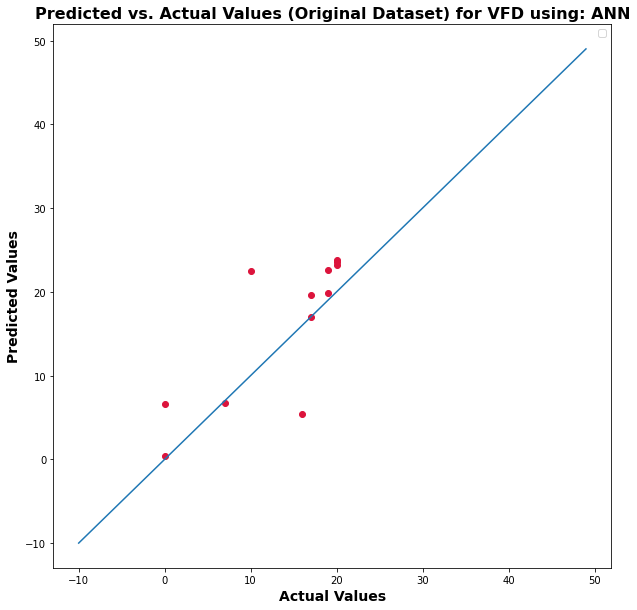

<ipython-input-13-85380e66bd6c>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD


36


r_index: 100%|##########| 8/8 [00:00<00:00, 73.93it/s]


(27, 37)


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


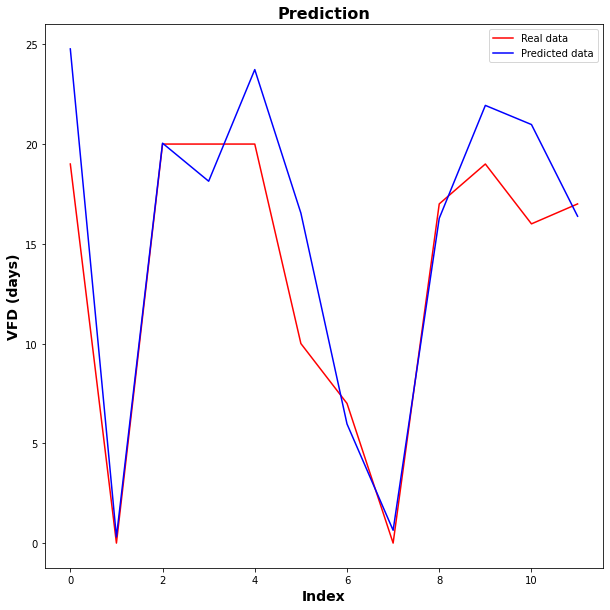

No handles with labels found to put in legend.


MSE: 			3.731508148226567
R-Squared Score: 	nan


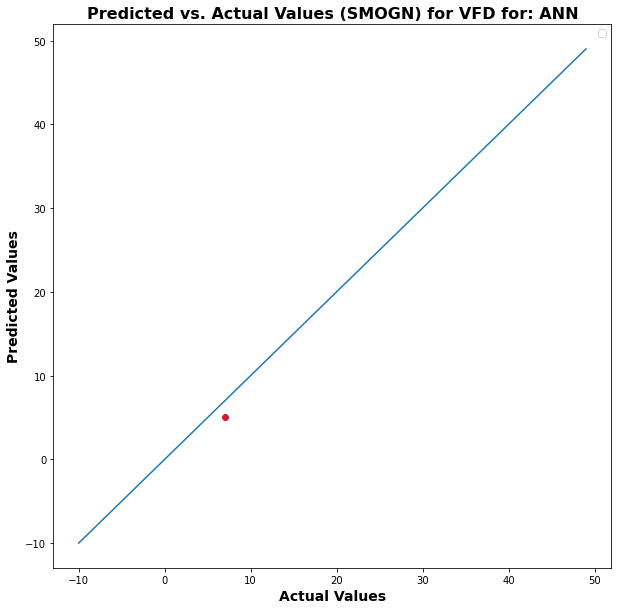

No handles with labels found to put in legend.


MSE: 			10.77508865797219
MAE: 	2.4315238098303475
R-Squared Score: 	0.7967763239360844


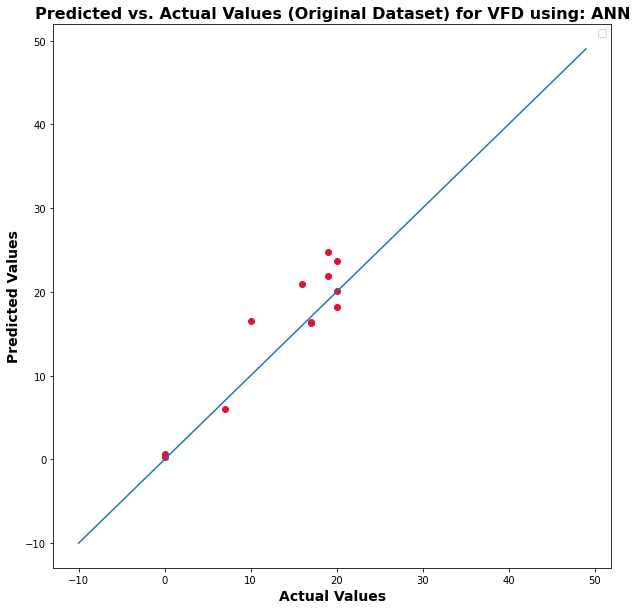

<ipython-input-13-85380e66bd6c>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD


37


r_index: 100%|##########| 8/8 [00:00<00:00, 77.85it/s]


(26, 38)


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


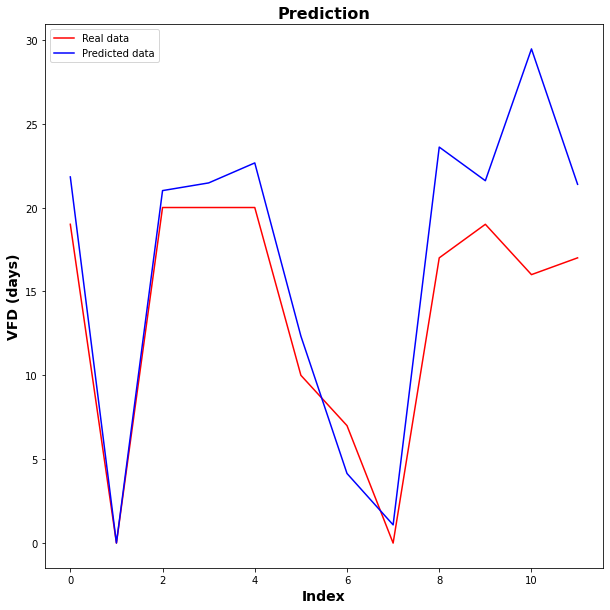

No handles with labels found to put in legend.


MSE: 			3.084854239431479
R-Squared Score: 	nan


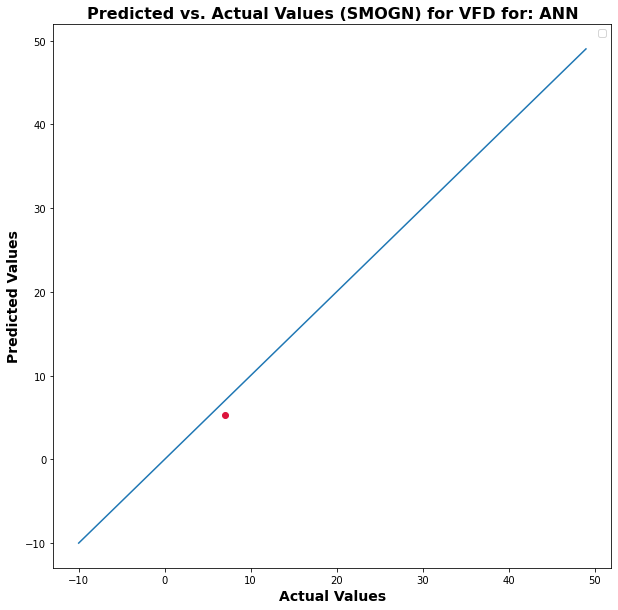

MSE: 			23.62318445638552
MAE: 	3.439181416955156
R-Squared Score: 	0.5544546742999981


No handles with labels found to put in legend.


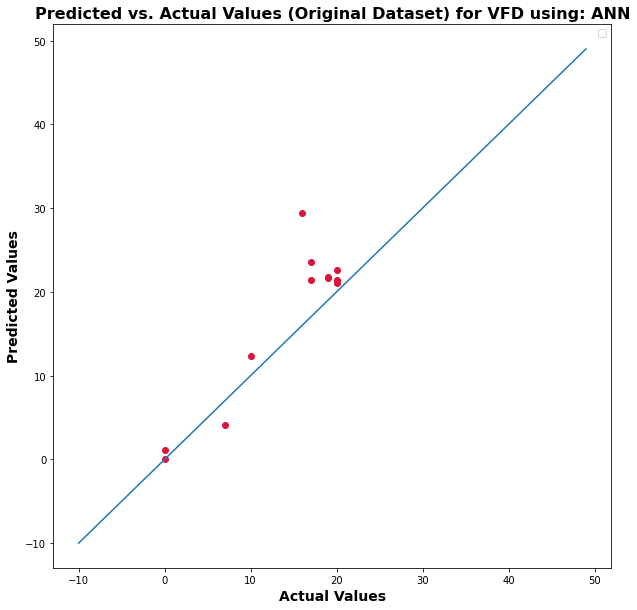

<ipython-input-13-85380e66bd6c>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD


38


r_index: 100%|##########| 8/8 [00:00<00:00, 121.24it/s]


(26, 39)


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


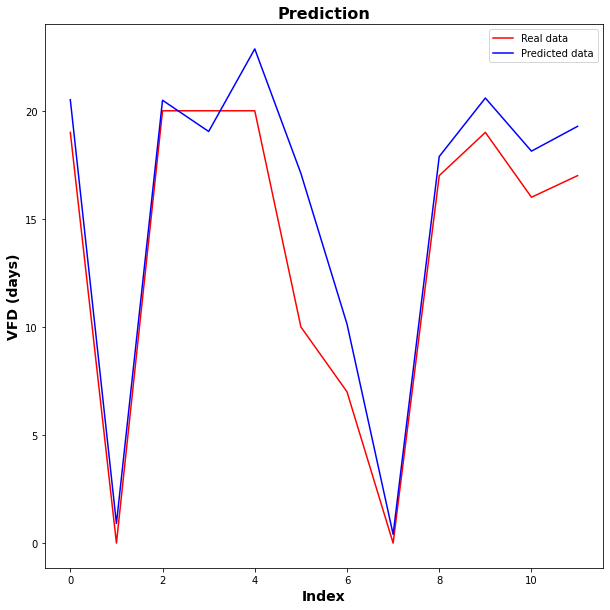

No handles with labels found to put in legend.


MSE: 			12.781735120082885
R-Squared Score: 	nan


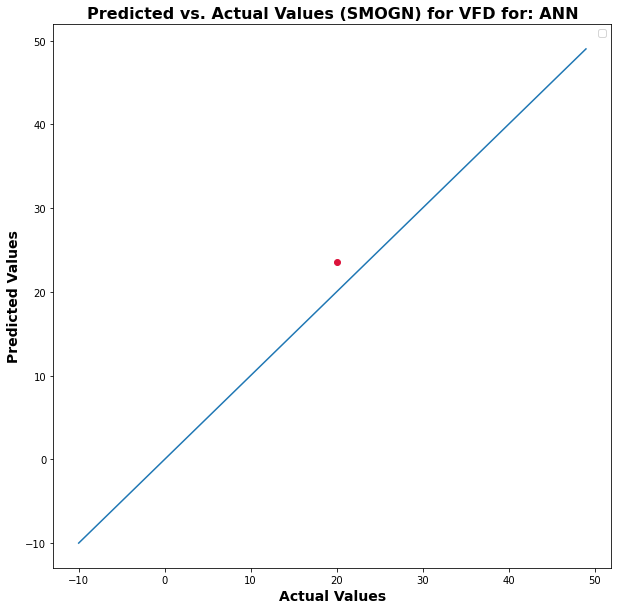

No handles with labels found to put in legend.


MSE: 			7.162512808446263
MAE: 	2.0211845437685647
R-Squared Score: 	0.8649113497817601


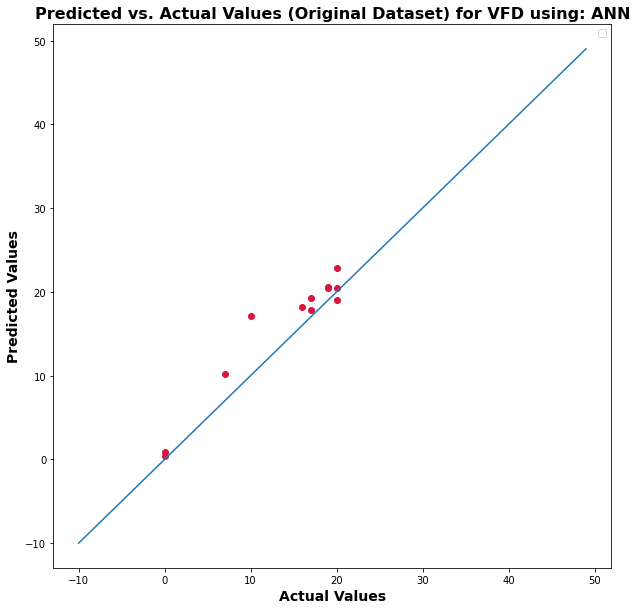

<ipython-input-13-85380e66bd6c>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD


39


r_index: 100%|##########| 8/8 [00:00<00:00, 147.79it/s]


(27, 40)


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


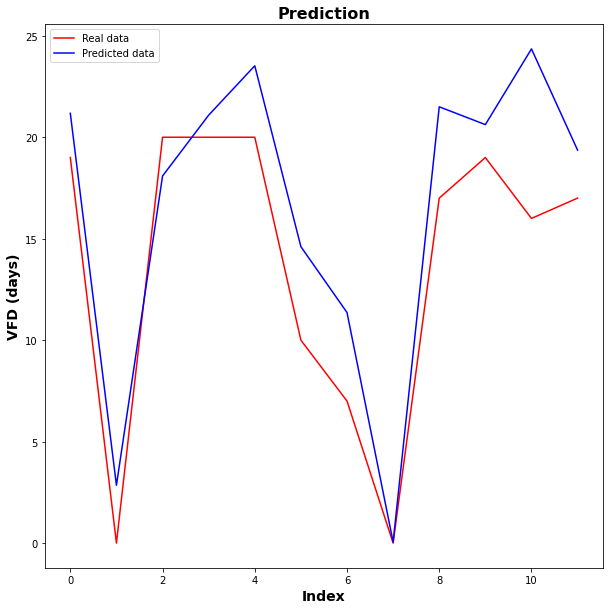

No handles with labels found to put in legend.


MSE: 			0.007875621770100594
R-Squared Score: 	nan


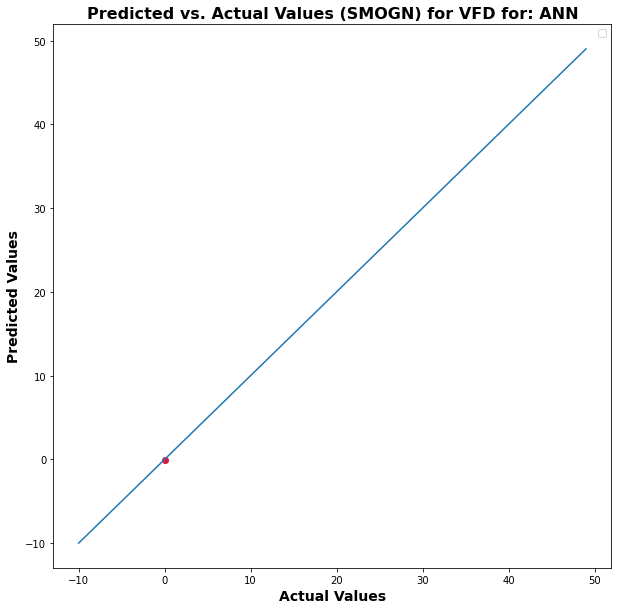

No handles with labels found to put in legend.


MSE: 			14.051724215215913
MAE: 	3.117657959461212
R-Squared Score: 	0.7349773036030005


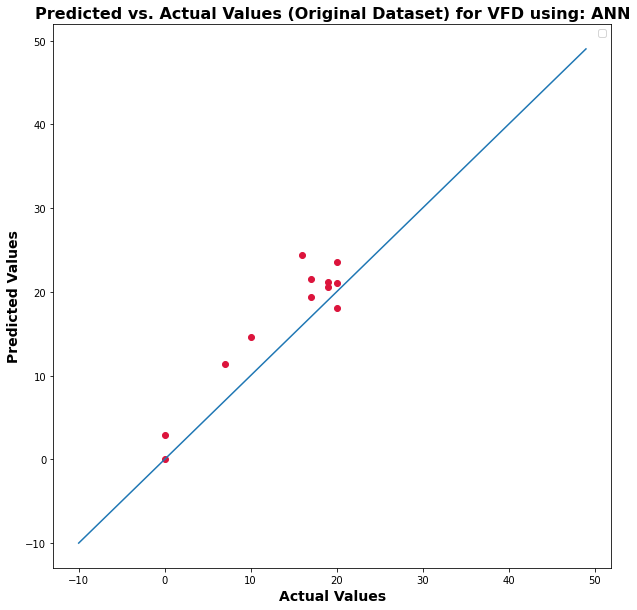

40


<ipython-input-13-85380e66bd6c>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
r_index: 100%|##########| 8/8 [00:00<00:00, 90.52it/s]


(25, 41)


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


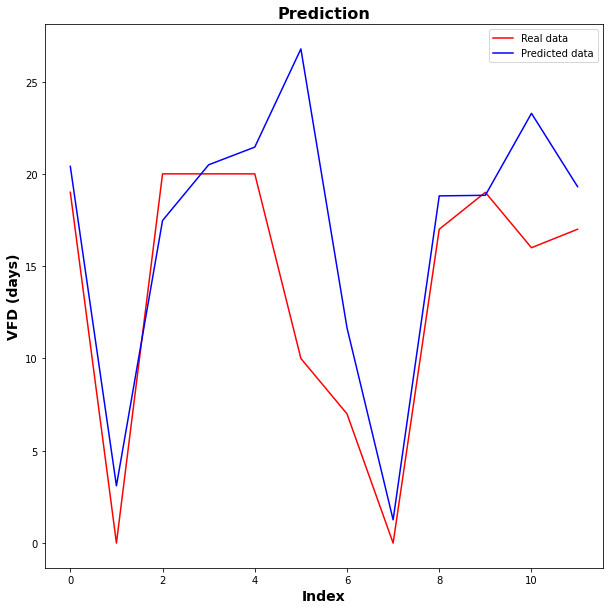

No handles with labels found to put in legend.


MSE: 			173.73151409998536
R-Squared Score: 	nan


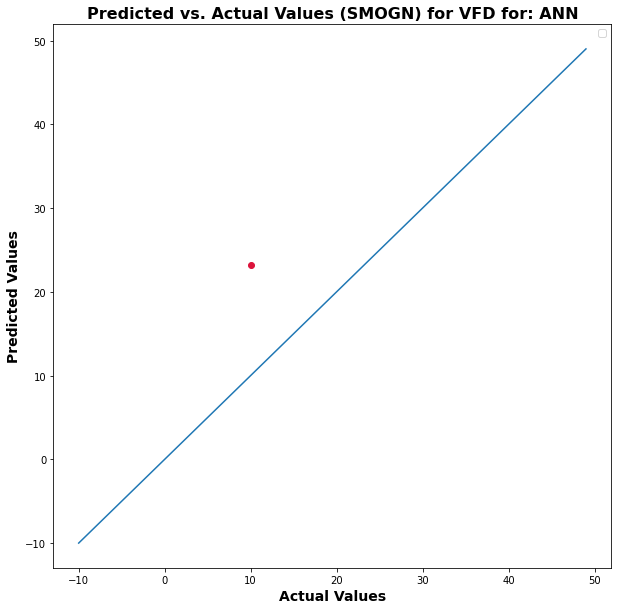

MSE: 			32.19981768829774
MAE: 	3.6014177401860556
R-Squared Score: 	0.3926949905546988


No handles with labels found to put in legend.


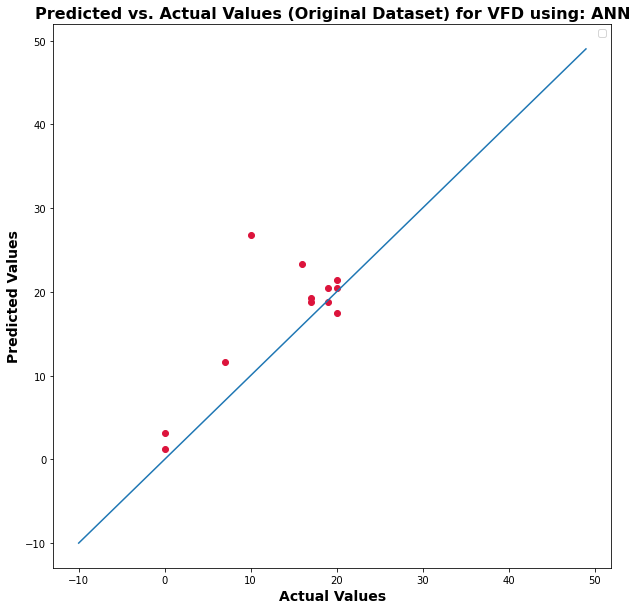

<ipython-input-13-85380e66bd6c>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD


41


r_index: 100%|##########| 8/8 [00:00<00:00, 110.36it/s]


(25, 42)


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


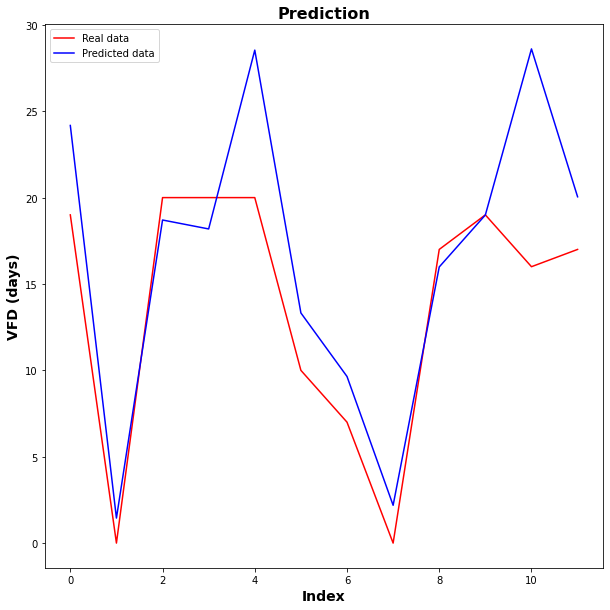

No handles with labels found to put in legend.


MSE: 			18.67609845395259
R-Squared Score: 	nan


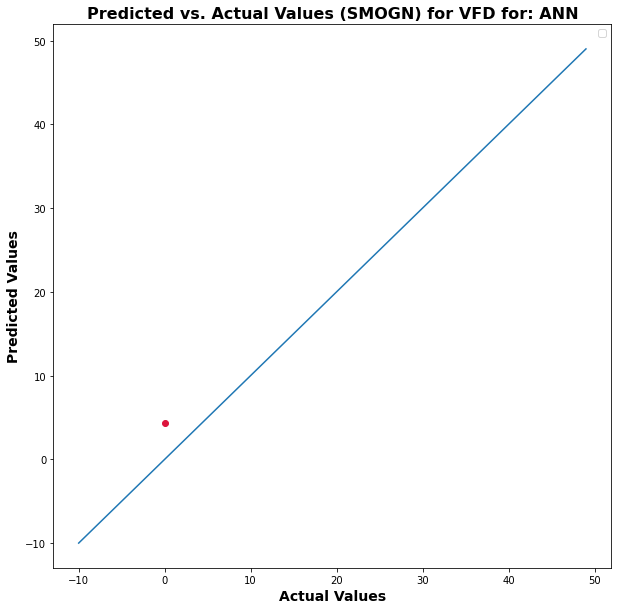

No handles with labels found to put in legend.


MSE: 			24.904915843769356
MAE: 	3.5921994845072427
R-Squared Score: 	0.5302805656184955


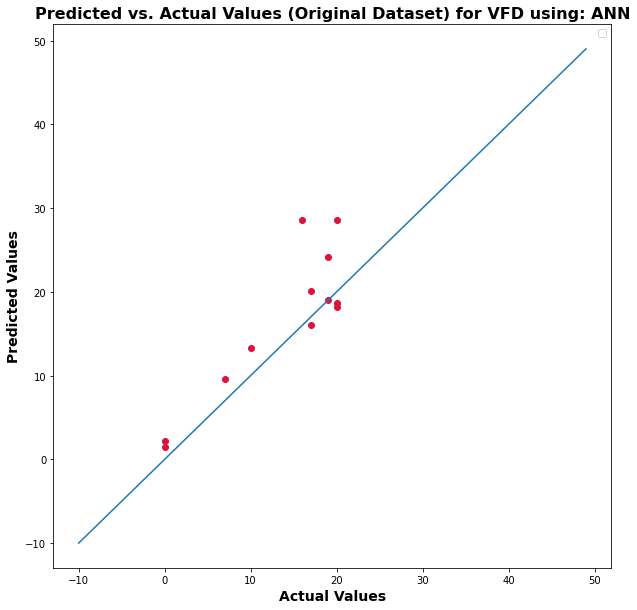

<ipython-input-13-85380e66bd6c>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD


42


r_index: 100%|##########| 8/8 [00:00<00:00, 61.68it/s]


(26, 43)


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


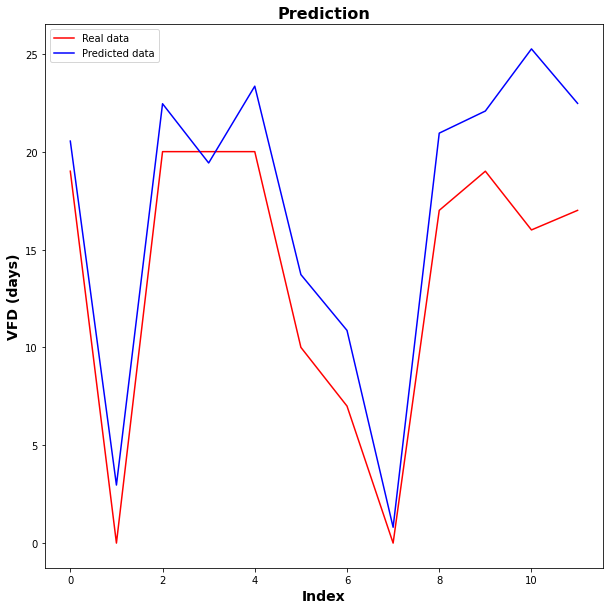

No handles with labels found to put in legend.


MSE: 			3.847043322421314
R-Squared Score: 	nan


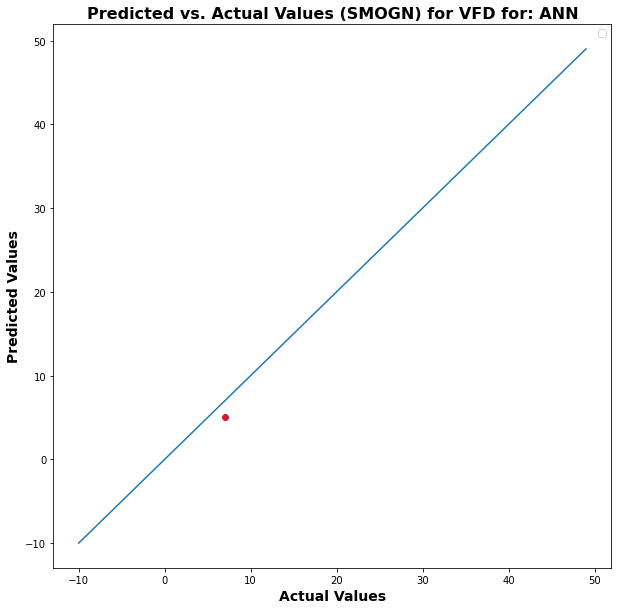

No handles with labels found to put in legend.


MSE: 			16.545394482136853
MAE: 	3.416959226131439
R-Squared Score: 	0.6879454085883816


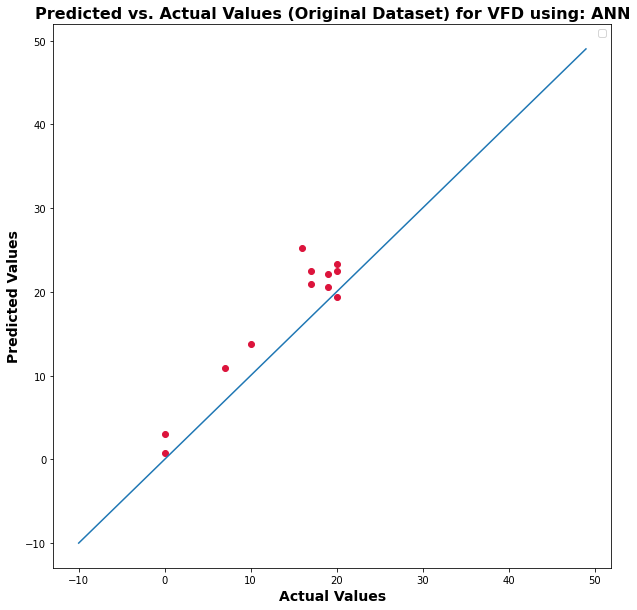

<ipython-input-13-85380e66bd6c>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD


43


r_index: 100%|##########| 8/8 [00:00<00:00, 119.02it/s]


(26, 44)


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


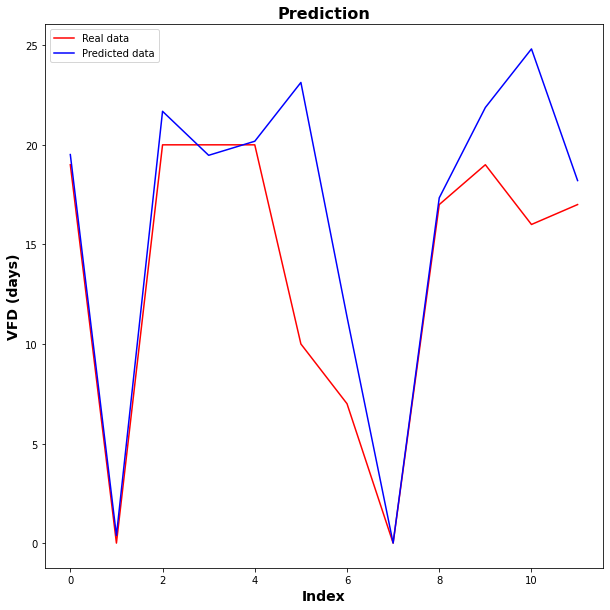

No handles with labels found to put in legend.


MSE: 			142.9099837871072
R-Squared Score: 	nan


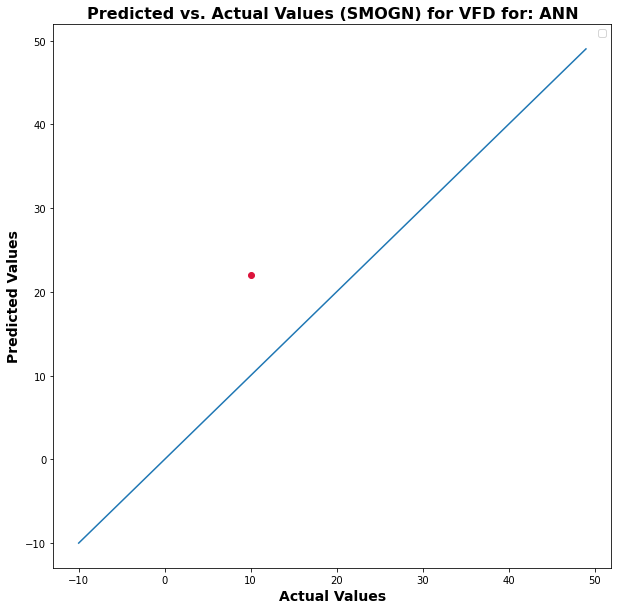

No handles with labels found to put in legend.


MSE: 			23.549872044162168
MAE: 	2.834447088340918
R-Squared Score: 	0.5558373838429139


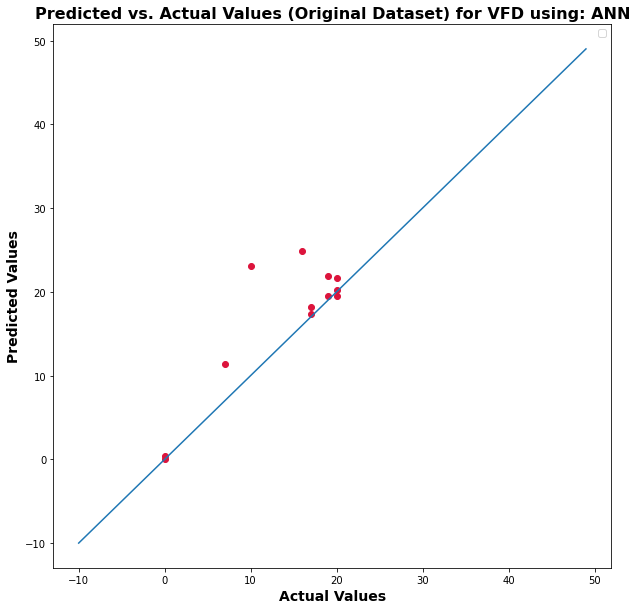

<ipython-input-13-85380e66bd6c>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD


44


r_index: 100%|##########| 8/8 [00:00<00:00, 144.99it/s]


(26, 45)


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


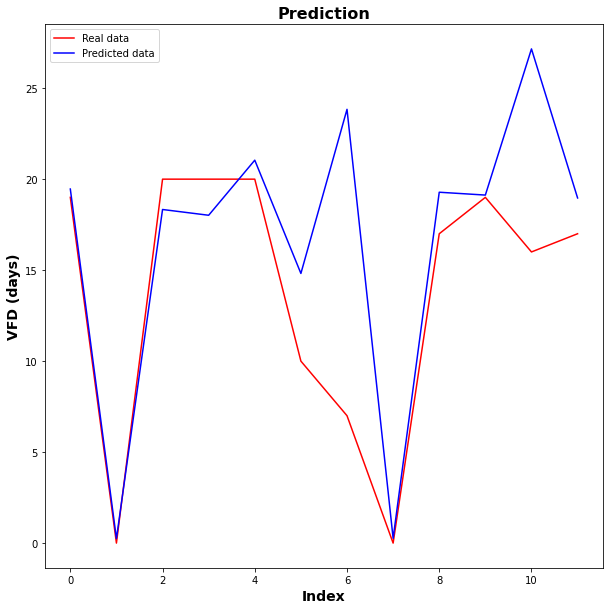

No handles with labels found to put in legend.


MSE: 			253.1535256613315
R-Squared Score: 	nan


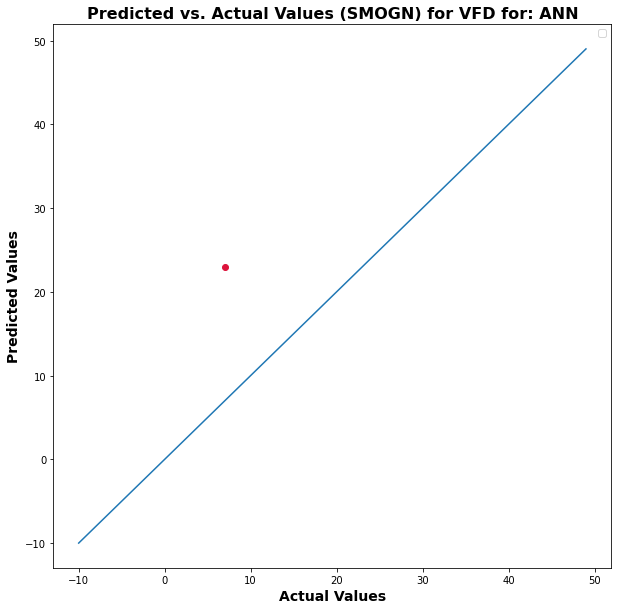

No handles with labels found to put in legend.


MSE: 			37.3688078578939
MAE: 	3.5705969942112765
R-Squared Score: 	0.29520519560750214


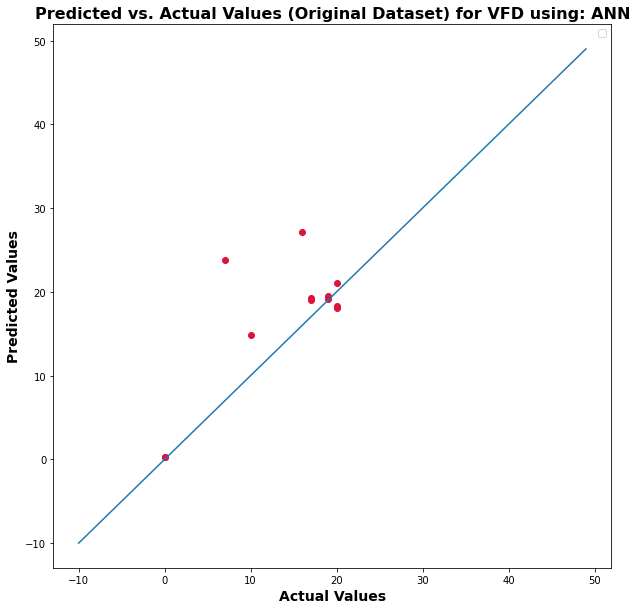

45


<ipython-input-13-85380e66bd6c>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD
r_index: 100%|##########| 8/8 [00:00<00:00, 133.43it/s]


(26, 46)


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


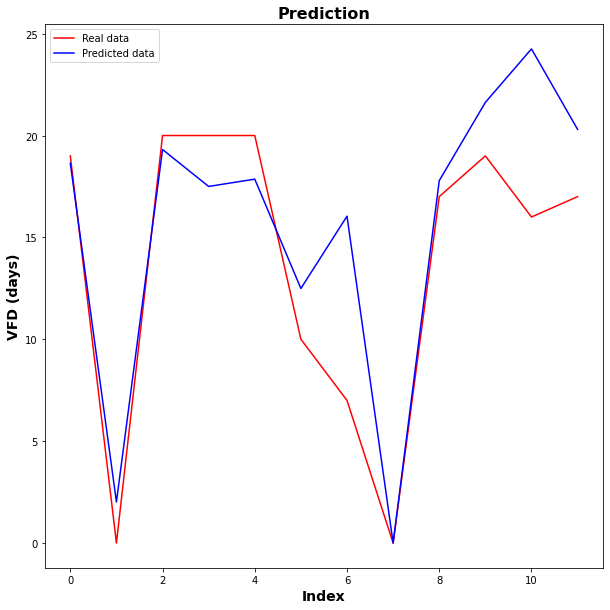

No handles with labels found to put in legend.


MSE: 			23.405370250708074
R-Squared Score: 	nan


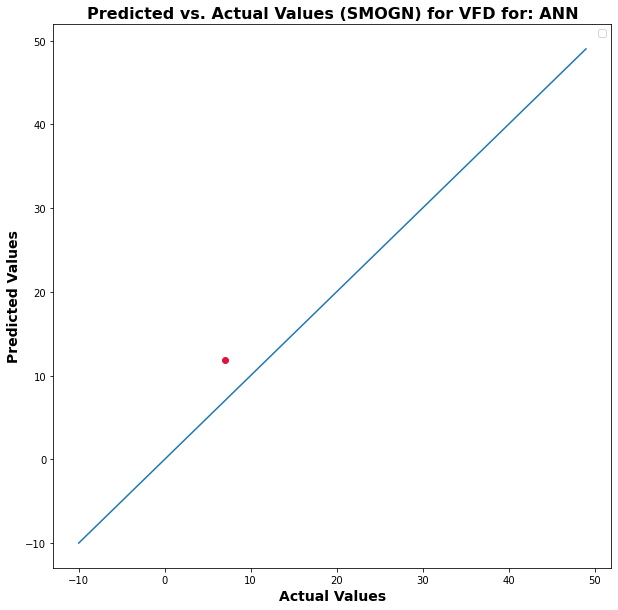

No handles with labels found to put in legend.


MSE: 			15.827318111748312
MAE: 	2.850280757091241
R-Squared Score: 	0.7014886957312696


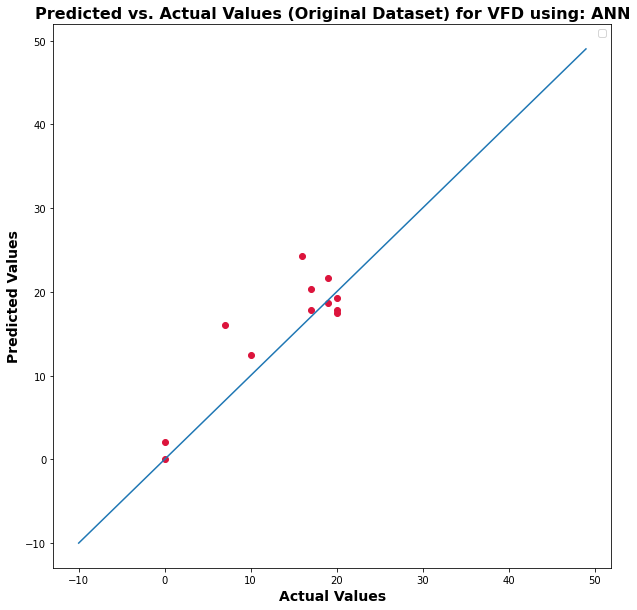

<ipython-input-13-85380e66bd6c>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD


46


r_index: 100%|##########| 8/8 [00:00<00:00, 119.48it/s]


(25, 47)


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


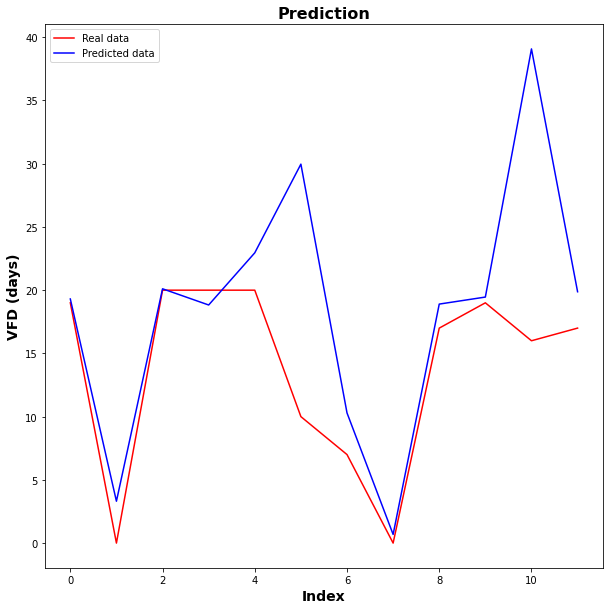

No handles with labels found to put in legend.


MSE: 			377.8828459382057
R-Squared Score: 	nan


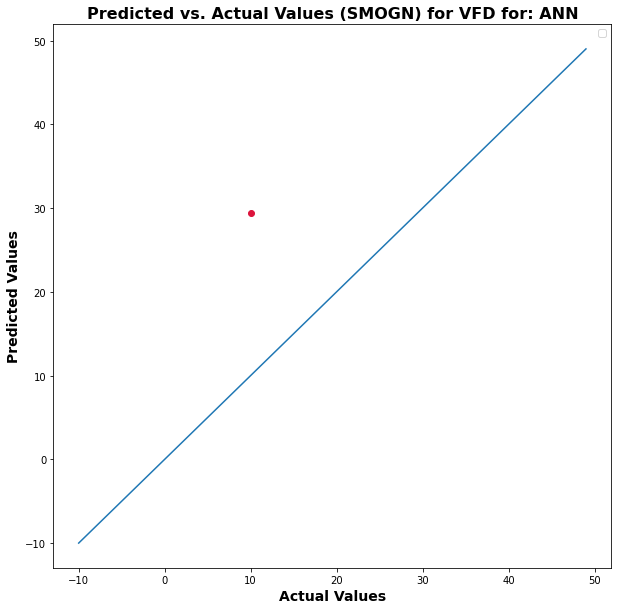

No handles with labels found to put in legend.


MSE: 			81.31896339675444
MAE: 	5.0085490345954895
R-Squared Score: 	-0.533717187836626


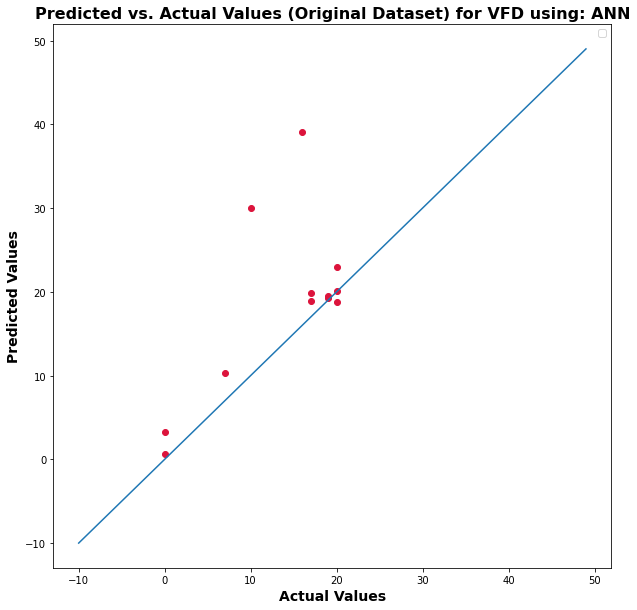

<ipython-input-13-85380e66bd6c>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD


47


r_index: 100%|##########| 8/8 [00:00<00:00, 103.31it/s]


(27, 48)


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


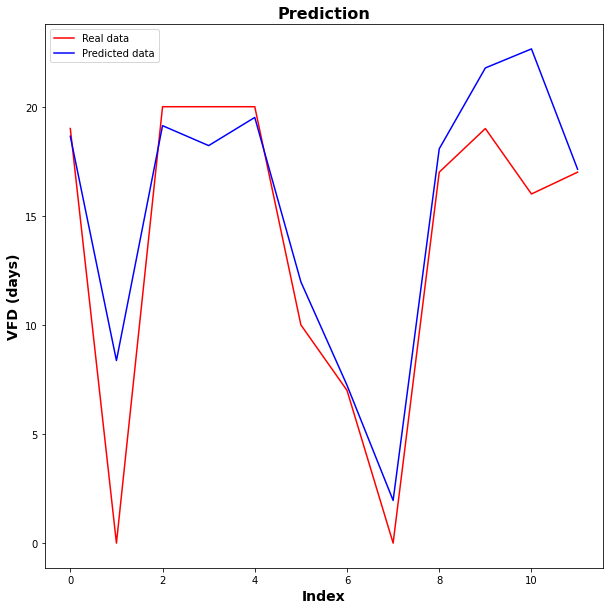

No handles with labels found to put in legend.


MSE: 			5.172959327697754
R-Squared Score: 	nan


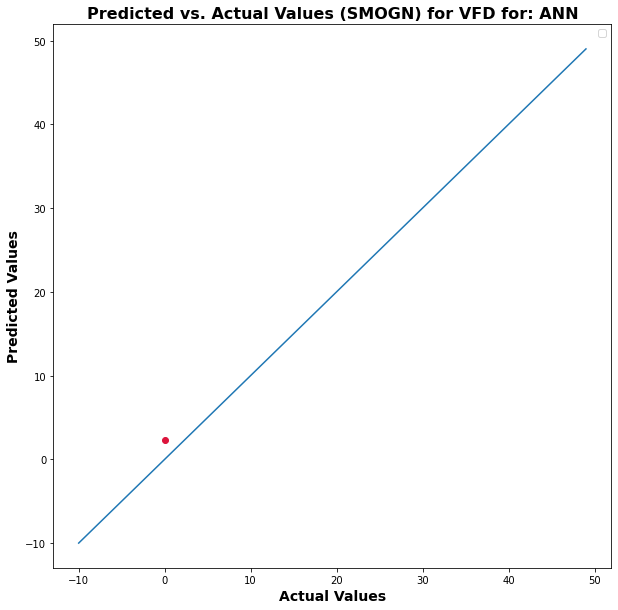

No handles with labels found to put in legend.


MSE: 			11.265121898134117
MAE: 	2.2216954827308655
R-Squared Score: 	0.7875340467149557


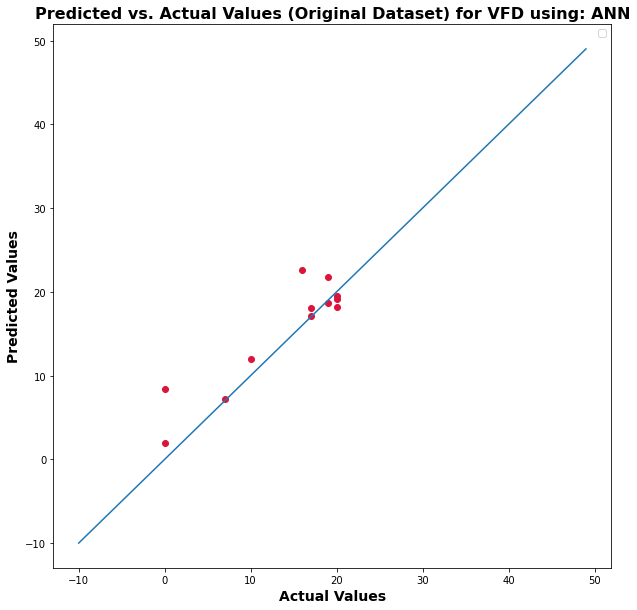

<ipython-input-13-85380e66bd6c>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD


48


r_index: 100%|##########| 8/8 [00:00<00:00, 130.77it/s]


(27, 49)


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


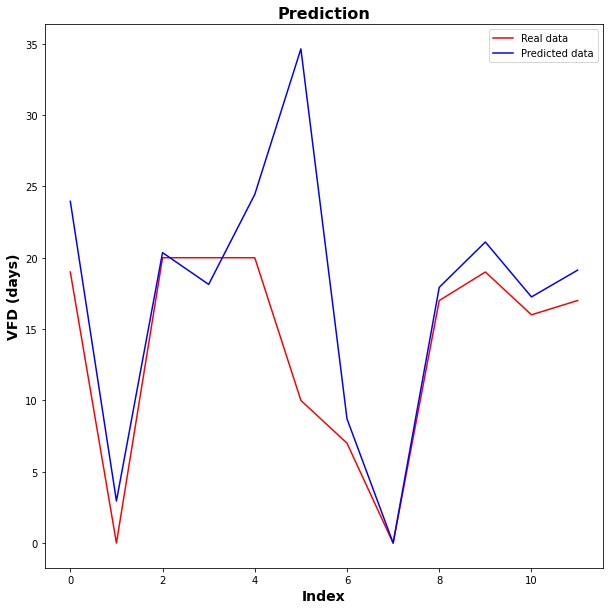

No handles with labels found to put in legend.


MSE: 			918.0802446243033
R-Squared Score: 	nan


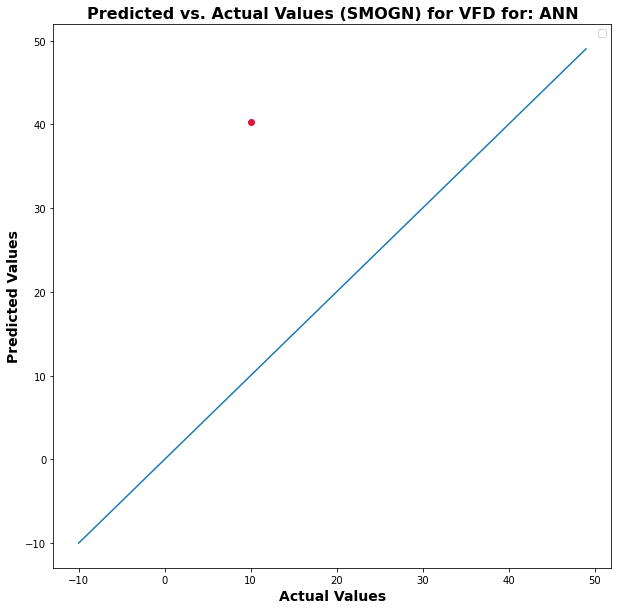

No handles with labels found to put in legend.


MSE: 			56.481029302851915
MAE: 	3.9440567245086036
R-Squared Score: 	-0.06526106347225613


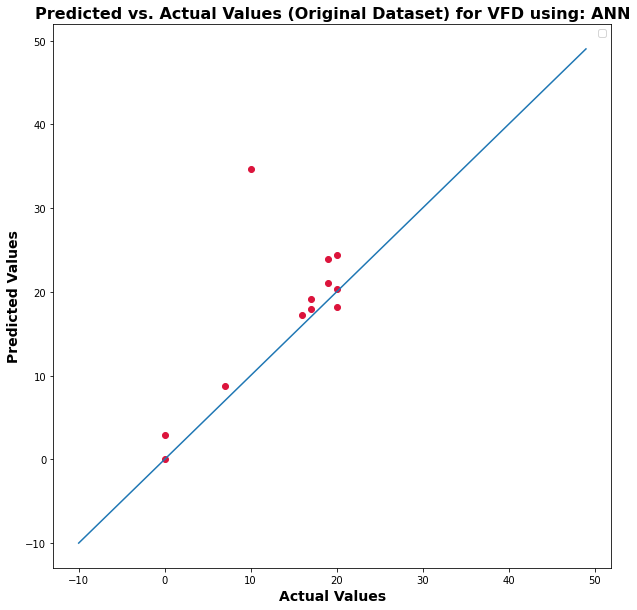

<ipython-input-13-85380e66bd6c>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selectedFeatureDF['VFD'] = df.VFD


49


r_index: 100%|##########| 8/8 [00:00<00:00, 112.22it/s]


(25, 50)


/opt/conda/lib/python3.8/site-packages/sklearn/metrics/_regression.py:682: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


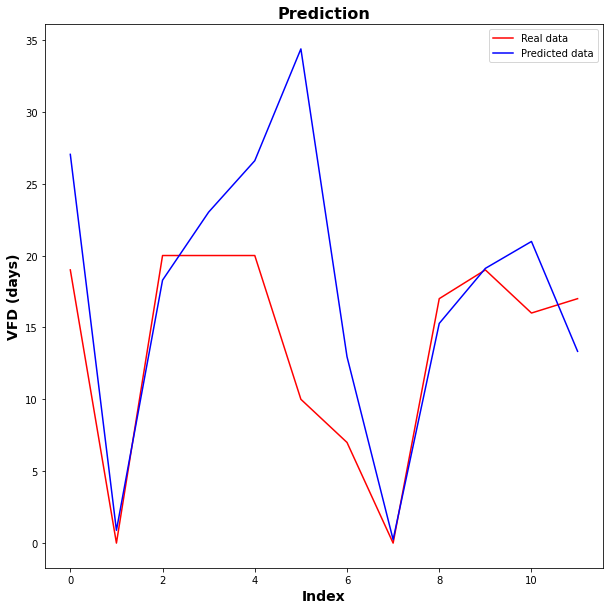

No handles with labels found to put in legend.


MSE: 			433.8310517650134
R-Squared Score: 	nan


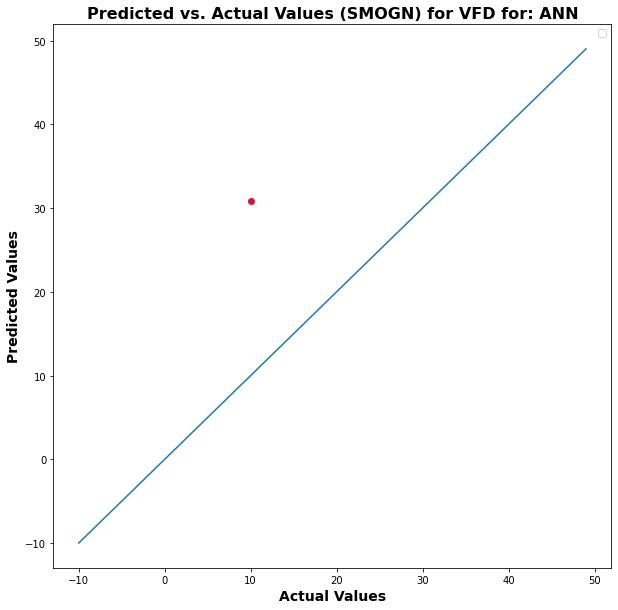

No handles with labels found to put in legend.


MSE: 			65.96510239311229
MAE: 	5.107994083315134
R-Squared Score: 	-0.244135526471273


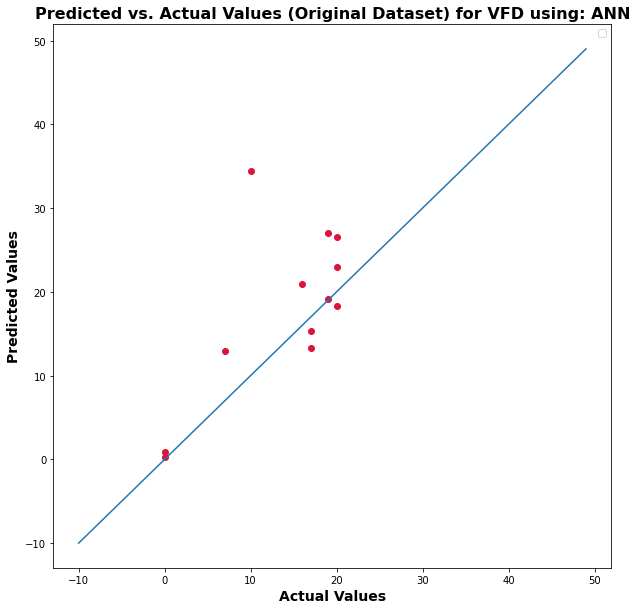

In [26]:
rSquared20 = {}
MSE20 = {}
MAE20 = {}
for n in range(2,50):
    print('==================================================')
    print(n)
    combinedDfNormalized = pd.read_csv('data/processed/VFD/CombinedDataset/combinedDfNormalized.csv').set_index('Unnamed: 0')
    mse, mae, rSqre = trainANN(combinedDfNormalized, selectedFeatures, n, 20)
    
    rSquared20[n] = rSqre
    MSE20[n] = mse
    MAE20[n] = mae
    

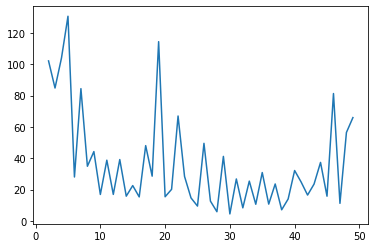

In [28]:
plt.plot(MSE20.keys(), MSE20.values())

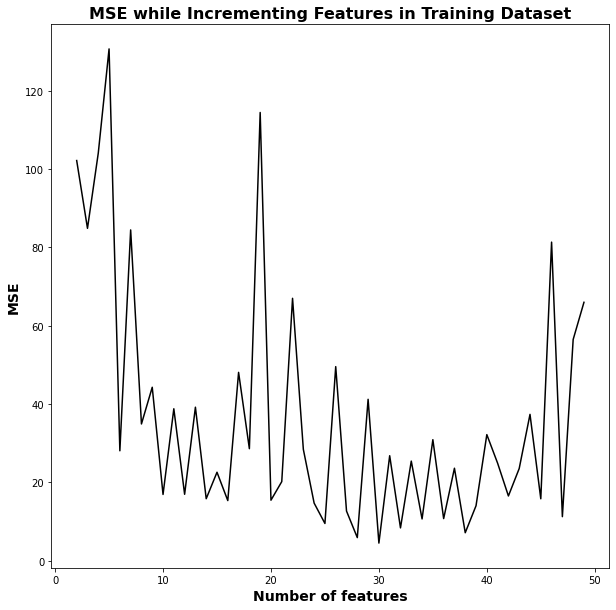

In [37]:
plt.figure(figsize=[10,10])
plt.plot(MSE20.keys(), MSE20.values(),'k')
plt.ylabel('MSE',fontweight="bold", fontsize=14)
plt.xlabel('Number of features',fontweight="bold", fontsize=14)
plt.title("MSE while Incrementing Features in Training Dataset",fontweight="bold", fontsize=16)
plt.show()